<a href="https://colab.research.google.com/github/1kaiser/GRAINet/blob/main/grainet_tpu_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Data preloading

In [ ]:
!wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
!unzip /content/GRAINet_demo_data.zip

--2025-04-04 18:47:10--  https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
Resolving share.phys.ethz.ch (share.phys.ethz.ch)... 129.132.80.27, 2001:67c:10ec:3dc4::39
Connecting to share.phys.ethz.ch (share.phys.ethz.ch)|129.132.80.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 840559012 (802M) [application/zip]
Saving to: ‘GRAINet_demo_data.zip’

GRAINet_demo_data.z 100%[===================>] 801.62M  19.8MB/s    in 32s     

2025-04-04 18:47:43 (25.2 MB/s) - ‘GRAINet_demo_data.zip’ saved [840559012/840559012]

Archive:  /content/GRAINet_demo_data.zip
   creating: data_GRAINet_demo/
  inflating: data_GRAINet_demo/data_KLEmme_1bank.npz  
  inflating: data_GRAINet_demo/orthophoto_KLEmme.tif  
  inflating: data_GRAINet_demo/mask_dm_pred.tif  



Contents of /content/data_GRAINet_demo/data_KLEmme_1bank.npz:

Arrays in this file:
--------------------------------------------------
• images
  Shape: (212, 500, 200, 3)
  Data type: float32
  Sample images will be displayed below
--------------------------------------------------
• histograms
  Shape: (212, 22)
  Data type: float32
  Array is multi-dimensional, showing shape only
--------------------------------------------------
• tile_names
  Shape: (212,)
  Data type: object
  First 3 values: ['KLEmme_Hasle_0001_0016_a' 'KLEmme_Hasle_0001_0016_b'
 'KLEmme_Hasle_0001_0017_a']
--------------------------------------------------
• dm
  Shape: (212,)
  Data type: float32
  First 3 values: [5.496338  5.4796576 5.326426 ]
--------------------------------------------------


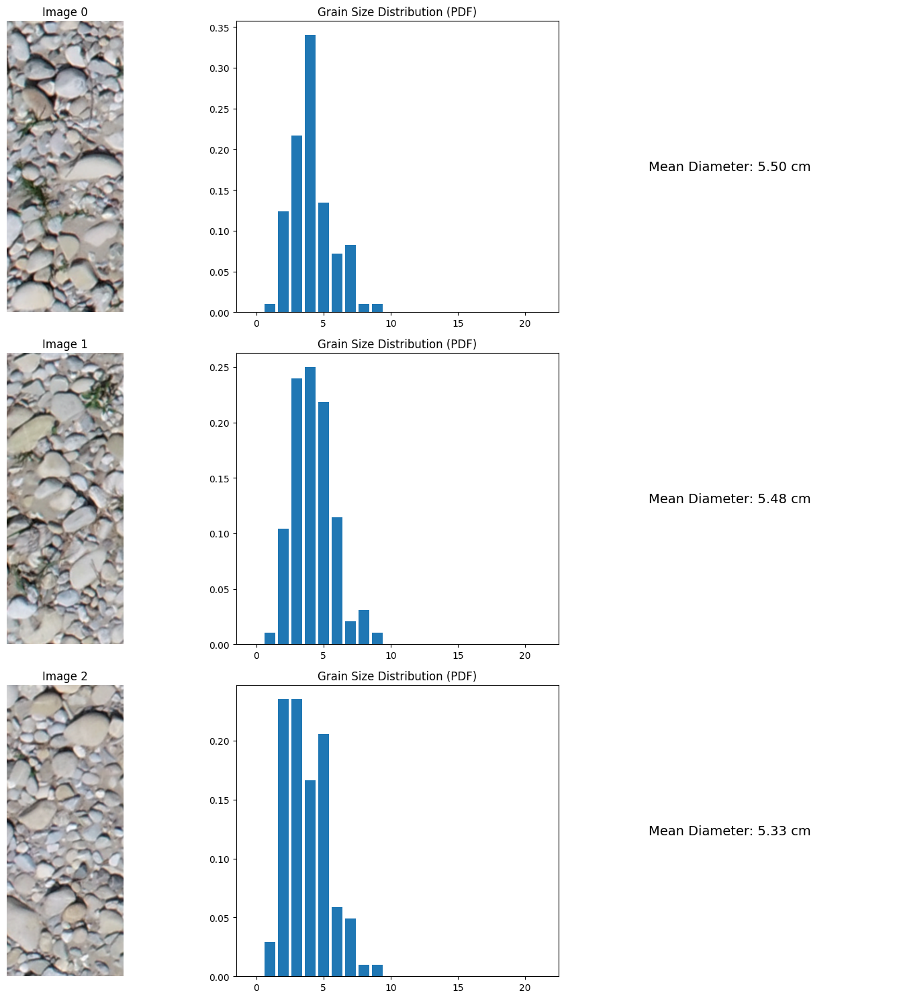

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import sys
import os

def view_npz_contents(npz_path, show_images=True, num_samples=3):
    """
    View the contents of a NumPy NPZ file.

    Parameters:
    npz_path (str): Path to the NPZ file
    show_images (bool): Whether to display sample images if present
    num_samples (int): Number of sample entries to display for each array
    """
    # Check if file exists
    if not os.path.exists(npz_path):
        print(f"Error: File '{npz_path}' not found.")
        return

    # Load NPZ file
    try:
        data = np.load(npz_path, allow_pickle=True)
        print(f"\nContents of {npz_path}:\n")

        # List all arrays in the file
        print("Arrays in this file:")
        print("-" * 50)
        for key in data.files:
            array = data[key]
            print(f"• {key}")
            print(f"  Shape: {array.shape}")
            print(f"  Data type: {array.dtype}")

            # For small arrays, print all values
            if array.size < 10:
                print(f"  Values: {array}")
            # For larger arrays, print sample values
            else:
                # Handle different array dimensions
                if array.ndim == 1:
                    sample_indices = min(num_samples, len(array))
                    print(f"  First {sample_indices} values: {array[:sample_indices]}")
                elif array.ndim >= 2:
                    # For images (assuming they are the 'images' key and have shape [N, H, W, C])
                    if key == 'images' and array.ndim == 4 and array.shape[-1] in [1, 3, 4] and show_images:
                        print(f"  Sample images will be displayed below")
                    else:
                        print(f"  Array is multi-dimensional, showing shape only")
            print("-" * 50)

        # Display sample images if available and requested
        if 'images' in data.files and show_images and data['images'].ndim == 4:
            images = data['images']
            num_to_show = min(num_samples, images.shape[0])

            # Display histograms alongside images if available
            has_histograms = 'histograms' in data.files
            has_dm = 'dm' in data.files

            plt.figure(figsize=(15, 5 * num_to_show))
            for i in range(num_to_show):
                img = images[i]

                # Determine number of subplots needed
                num_subplots = 1 + int(has_histograms) + int(has_dm)

                # Create subplots
                plt.subplot(num_to_show, num_subplots, i * num_subplots + 1)

                # Normalize image for display if needed
                if img.max() > 1.0 and img.dtype != np.uint8:
                    img = img / 255.0

                plt.imshow(img)
                plt.title(f"Image {i}")
                plt.axis('off')

                # Display histogram if available
                if has_histograms:
                    plt.subplot(num_to_show, num_subplots, i * num_subplots + 2)
                    histogram = data['histograms'][i]

                    # Check if it's a CDF (cumulative distribution function)
                    if len(histogram) > 1 and np.all(np.diff(histogram) >= 0) and np.max(histogram) <= 1.0:
                        # Convert to PDF if it's a CDF
                        pdf = np.diff(np.concatenate([[0], histogram]))
                        plt.bar(range(len(pdf)), pdf)
                        plt.title(f"Grain Size Distribution (PDF)")
                    else:
                        plt.bar(range(len(histogram)), histogram)
                        plt.title(f"Histogram {i}")

                # Display mean diameter if available
                if has_dm:
                    subplot_idx = i * num_subplots + 3 if has_histograms else i * num_subplots + 2
                    plt.subplot(num_to_show, num_subplots, subplot_idx)
                    plt.text(0.5, 0.5, f"Mean Diameter: {data['dm'][i]:.2f} cm",
                             horizontalalignment='center', verticalalignment='center', fontsize=14)
                    plt.axis('off')

            plt.tight_layout()
            plt.show()

    except Exception as e:
        print(f"Error reading NPZ file: {e}")

npz_path = f'/content/data_GRAINet_demo/data_KLEmme_1bank.npz'
view_npz_contents(npz_path)

## new code

### data extractor

In [ ]:
import os
import numpy as np
from PIL import Image
from skimage.transform import resize
from tqdm import tqdm
import json

def extract_data_to_folders(data_path, base_output_dir, target_size=(224, 224)):
    """
    Extract data from the NPZ file and organize it into separate folders:
    - images: contains the processed images
    - histograms: contains the grain size distributions
    - mean_diameters: contains the mean diameter values

    Args:
        data_path (str): Path to the data file (.npz)
        base_output_dir (str): Base directory to save extracted data
        target_size (tuple): Target size for resizing images (width, height)
    """
    # Create output directories
    images_dir = os.path.join(base_output_dir, "images")
    histograms_dir = os.path.join(base_output_dir, "histograms")
    dm_dir = os.path.join(base_output_dir, "mean_diameters")

    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(histograms_dir, exist_ok=True)
    os.makedirs(dm_dir, exist_ok=True)

    # Load data from npz file
    print(f"Loading data from {data_path}...")
    data = np.load(data_path, allow_pickle=True)

    # Extract data components
    images = data['images']
    histograms = data['histograms'] if 'histograms' in data else None
    mean_diameters = data['dm'] if 'dm' in data else None

    print(f"Found {len(images)} samples")

    # Create metadata to track relationships
    metadata = {
        "num_samples": len(images),
        "sample_mapping": {},
        "histogram_shape": histograms.shape[-1] if histograms is not None else None,
        "has_mean_diameters": mean_diameters is not None
    }

    # Process and save each sample
    for i in tqdm(range(len(images)), desc="Processing samples"):
        # 1. Process and save image
        img = images[i]

        # For unequal dimensions, center crop to make a square
        height, width = img.shape[:2]
        if width < height:
            start_h = (height - width) // 2
            img_cropped = img[start_h:start_h+width, :, :]
        else:
            start_w = (width - height) // 2
            img_cropped = img[:, start_w:start_w+height, :]

        # Resize to target size
        img_resized = resize(img_cropped, target_size, anti_aliasing=True, preserve_range=True)

        # Convert to PIL Image and save
        pil_img = Image.fromarray(img_resized.astype(np.uint8))
        image_path = os.path.join(images_dir, f"image_{i:04d}.png")
        pil_img.save(image_path)

        # 2. Save histogram data
        if histograms is not None:
            hist_data = histograms[i]
            hist_path = os.path.join(histograms_dir, f"hist_{i:04d}.npy")
            np.save(hist_path, hist_data)

        # 3. Save mean diameter data
        if mean_diameters is not None:
            dm_data = mean_diameters[i]
            dm_path = os.path.join(dm_dir, f"dm_{i:04d}.npy")
            np.save(dm_path, dm_data)

        # 4. Update metadata
        metadata["sample_mapping"][str(i)] = {
            "image": f"image_{i:04d}.png",
            "histogram": f"hist_{i:04d}.npy" if histograms is not None else None,
            "mean_diameter": f"dm_{i:04d}.npy" if mean_diameters is not None else None
        }

    # Save metadata
    with open(os.path.join(base_output_dir, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=2)

    print(f"Data extraction complete. Organized in {base_output_dir}")
    return metadata

if __name__ == "__main__":
    # Example usage
    data_path = "/content/data_GRAINet_demo/data_KLEmme_1bank.npz"
    base_output_dir = "./grainet_dataset"

    # Extract and organize data
    metadata = extract_data_to_folders(data_path, base_output_dir)
    print(f"Extracted {metadata['num_samples']} samples with associated attributes")

Loading data from /content/data_GRAINet_demo/data_KLEmme_1bank.npz...
Found 212 samples


Processing samples: 100%|██████████| 212/212 [00:06<00:00, 32.18it/s]

Data extraction complete. Organized in ./grainet_dataset
Extracted 212 samples with associated attributes


## new code test unified minimized

In [ ]:
import os, json, re, shutil
import numpy as np
from PIL import Image
from functools import partial

import jax, jax.numpy as jnp
from jax import random, pmap
from jax.tree_util import register_pytree_node_class

import flax
from flax import linen as nn
from flax.training import train_state, common_utils
import optax
from tqdm import tqdm
from transformers import FlaxViTModel, ViTImageProcessor
import orbax.checkpoint

# Print device information
print("JAX runtime:", jax.extend.backend.get_backend().platform)
print("JAX devices:", jax.devices())
print("JAX local device count:", jax.local_device_count())

# Unified checkpoint handler: works for both saving and restoring.
def handle_checkpoint(ckpt_dir, mode, state=None, step=None):
    ckpt_dir = os.path.abspath(ckpt_dir)
    os.makedirs(ckpt_dir, exist_ok=True)
    cp = orbax.checkpoint.PyTreeCheckpointer()

    if mode == "save":
        if state is None or step is None:
            raise ValueError("For saving, both state and step must be provided.")
        # Clean temporary checkpoint folders
        for d in os.listdir(ckpt_dir):
            if "orbax-checkpoint-tmp" in d:
                shutil.rmtree(os.path.join(ckpt_dir, d), ignore_errors=True)
        state_dict = {
            'decoder_state': state.decoder_state,
            'vit_params': state.vit_params,
            'step': state.step
        }
        cp_path = os.path.abspath(os.path.join(ckpt_dir, f"checkpoint_{step}"))
        if os.path.exists(cp_path):
            shutil.rmtree(cp_path)
        cp.save(cp_path, state_dict, force=True)
        print(f"Checkpoint saved at step {step}")
        return None

    elif mode == "restore":
        dirs = [d for d in os.listdir(ckpt_dir) if re.match(r"^checkpoint_\d+$", d)]
        if not dirs:
            print("No valid checkpoints found.")
            return None
        if step is None:
            step = max(int(d.split("_")[1]) for d in dirs)
        cp_path = os.path.abspath(os.path.join(ckpt_dir, f"checkpoint_{step}"))
        if not os.path.exists(cp_path):
            print(f"Checkpoint at step {step} not found.")
            return None
        state_dict = cp.restore(cp_path)
        print(f"Checkpoint restored from step {step}")
        return state_dict

    else:
        raise ValueError("Mode must be 'save' or 'restore'")

# Model: GrainSizeDecoder for dual outputs (histogram and mean diameter)
class GrainSizeDecoder(nn.Module):
    num_classes: int = 21
    layer_indices: tuple = (3, 6, 9, 11)

    @nn.compact
    def __call__(self, hidden_states, train=False):
        cls_token = hidden_states[self.layer_indices[3]][:, 0]
        x = nn.Dense(256, kernel_init=nn.initializers.normal(0.02))(cls_token)
        x = nn.gelu(x)
        hist_output = nn.softmax(nn.Dense(self.num_classes, kernel_init=nn.initializers.normal(0.02))(x))
        diameter_output = nn.Dense(1, kernel_init=nn.initializers.normal(0.02))(x)
        return {"histogram": hist_output, "diameter": diameter_output}

# Combined loss for dual outputs
def combined_loss(y_true, y_pred, hist_weight=1.0, diam_weight=1.0):
    hist_loss = -jnp.mean(jnp.sum(y_true["histogram"] * jnp.log(y_pred["histogram"] + 1e-9), axis=-1))
    diam_loss = jnp.mean((y_pred["diameter"] - y_true["diameter"]) ** 2)
    return hist_weight * hist_loss + diam_weight * diam_loss, (hist_loss, diam_loss)

# Combined train state for decoder and ViT parameters
@register_pytree_node_class
class CombinedTrainState:
    def __init__(self, decoder_state, vit_params):
        self.decoder_state = decoder_state
        self.vit_params = vit_params

    @property
    def step(self):
        return self.decoder_state.step

    def replace(self, **kwargs):
        return CombinedTrainState(kwargs.get('decoder_state', self.decoder_state),
                                  kwargs.get('vit_params', self.vit_params))

    def tree_flatten(self):
        return (self.decoder_state, self.vit_params), None

    @classmethod
    def tree_unflatten(cls, aux_data, children):
        return cls(*children)

# Create initial training state
def create_train_state(rng, lr, wd, num_classes):
    vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
    vit_params = vit_model.params
    decoder = GrainSizeDecoder(num_classes=num_classes)
    dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
    decoder_params = decoder.init(rng, dummy_hidden)
    tx = optax.adamw(learning_rate=lr, weight_decay=wd)
    decoder_state = train_state.TrainState.create(apply_fn=decoder.apply, params=decoder_params, tx=tx)
    return CombinedTrainState(decoder_state, vit_params)

# Load a batch of data (images + targets)
def load_batch(base_dir, processor, batch_size):
    metadata = json.load(open(os.path.join(base_dir, "metadata.json"), "r"))
    idxs = np.random.choice(range(metadata["num_samples"]), batch_size, replace=False)
    images = [Image.open(os.path.join(base_dir, "images", metadata["sample_mapping"][str(idx)]["image"])).convert("RGB") for idx in idxs]
    pixel_values = processor(images=images, return_tensors="np")["pixel_values"]
    histograms = np.array([np.load(os.path.join(base_dir, "histograms", metadata["sample_mapping"][str(idx)]["histogram"])) for idx in idxs])
    histograms = histograms / (np.sum(histograms, axis=1, keepdims=True) + 1e-9)
    diameters = np.array([np.load(os.path.join(base_dir, "mean_diameters", metadata["sample_mapping"][str(idx)]["mean_diameter"])) for idx in idxs])
    return pixel_values, {"histogram": histograms, "diameter": diameters}

# Detect histogram size (number of classes)
def detect_histogram_size(base_dir):
    metadata = json.load(open(os.path.join(base_dir, "metadata.json"), "r"))
    if metadata["num_samples"] > 0:
        first_hist = np.load(os.path.join(base_dir, "histograms", metadata["sample_mapping"]["0"]["histogram"]))
        num_bins = first_hist.shape[0]
        print(f"Detected histogram size: {num_bins} bins")
        return num_bins
    print("Warning: Using default histogram size of 21")
    return 21

# Forward pass combining ViT and decoder models
def forward_pass(state, images, targets, vit_model, hist_weight=1.0, diam_weight=1.0):
    vit_out = vit_model(pixel_values=images, params=state.vit_params, output_hidden_states=True)
    outputs = state.decoder_state.apply_fn(state.decoder_state.params, vit_out.hidden_states, train=True)
    loss, (hist_loss, diam_loss) = combined_loss(targets, outputs, hist_weight, diam_weight)
    return loss, outputs, hist_loss, diam_loss

# Single training step
def train_step(state, batch, vit_model, hist_weight=1.0, diam_weight=1.0):
    images, targets = batch
    def loss_fn(params):
        curr_state = state.replace(decoder_state=state.decoder_state.replace(params=params))
        loss, _, _, _ = forward_pass(curr_state, images, targets, vit_model, hist_weight, diam_weight)
        return loss
    loss, grads = jax.value_and_grad(loss_fn)(state.decoder_state.params)
    grads = jax.lax.pmean(grads, axis_name='batch')
    new_decoder_state = state.decoder_state.apply_gradients(grads=grads)
    new_state = state.replace(decoder_state=new_decoder_state)
    _, _, hist_loss, diam_loss = forward_pass(new_state, images, targets, vit_model, hist_weight, diam_weight)
    metrics = {'total_loss': loss, 'hist_loss': hist_loss, 'diam_loss': diam_loss}
    return new_state, metrics

# Main training function for dual outputs
def train_model(base_dir, output_dir, num_classes=21, batch_size=32, num_epochs=50,
                lr=1e-4, wd=1e-5, ckpt_every=5, hist_weight=1.0, diam_weight=1.0, seed=42):
    np.random.seed(seed)
    rng = random.PRNGKey(seed)
    os.makedirs(output_dir, exist_ok=True)
    ckpt_dir = os.path.join(output_dir, "checkpoints")
    os.makedirs(ckpt_dir, exist_ok=True)

    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
    metadata = json.load(open(os.path.join(base_dir, "metadata.json"), "r"))
    num_samples = metadata["num_samples"]
    print(f"Dataset contains {num_samples} samples")

    vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
    restored = handle_checkpoint(ckpt_dir, mode="restore")
    if restored is not None:
        state = CombinedTrainState(restored['decoder_state'], restored['vit_params'])
        start_epoch = restored['step'] // (num_samples // batch_size)
        print(f"Resuming training from epoch {start_epoch}")
    else:
        state = create_train_state(rng, lr, wd, num_classes)
        start_epoch = 0
        print("Starting training from scratch")

    p_train_step = jax.pmap(
        partial(train_step, vit_model=vit_model, hist_weight=hist_weight, diam_weight=diam_weight),
        axis_name='batch', donate_argnums=(0,)
    )
    state = flax.jax_utils.replicate(state)
    steps_per_epoch = num_samples // batch_size

    for epoch in range(start_epoch, num_epochs):
        metrics_list = []
        with tqdm(total=steps_per_epoch, desc=f"Epoch {epoch+1}/{num_epochs}") as pbar:
            for _ in range(steps_per_epoch):
                batch = load_batch(base_dir, processor, batch_size * jax.device_count())
                batch = common_utils.shard(batch)
                state, metrics = p_train_step(state, batch)
                metrics_list.append(metrics)
                avg_metrics = {k: jnp.mean(jnp.array([m[k] for m in metrics_list])) for k in metrics}
                pbar.update(1)
                pbar.set_postfix(**{k: f"{v:.4f}" for k, v in avg_metrics.items()})
        print(f"Epoch {epoch+1} metrics: {avg_metrics}")
        if (epoch + 1) % ckpt_every == 0:
            unrep_state = flax.jax_utils.unreplicate(state)
            handle_checkpoint(ckpt_dir, mode="save", state=unrep_state, step=(epoch+1) * steps_per_epoch)

    unrep_state = flax.jax_utils.unreplicate(state)
    handle_checkpoint(ckpt_dir, mode="save", state=unrep_state, step=num_epochs * steps_per_epoch)
    print(f"Training completed. Final model saved at epoch {num_epochs}.")
    return unrep_state

if __name__ == "__main__":
    base_dir = "./grainet_dataset"   # Dataset directory
    output_dir = "./grainet_model"     # Model output directory
    num_classes = detect_histogram_size(base_dir)
    train_model(
        base_dir=base_dir,
        output_dir=output_dir,
        num_classes=num_classes,
        batch_size=16,
        num_epochs=50,
        lr=1e-4,
        wd=1e-5,
        hist_weight=1.0,
        diam_weight=1.0
    )
    print("Training finished successfully!")


JAX runtime: tpu
JAX devices: [TpuDevice(id=0, process_index=0, coords=(0,0,0), core_on_chip=0), TpuDevice(id=1, process_index=0, coords=(0,0,0), core_on_chip=1), TpuDevice(id=2, process_index=0, coords=(1,0,0), core_on_chip=0), TpuDevice(id=3, process_index=0, coords=(1,0,0), core_on_chip=1), TpuDevice(id=4, process_index=0, coords=(0,1,0), core_on_chip=0), TpuDevice(id=5, process_index=0, coords=(0,1,0), core_on_chip=1), TpuDevice(id=6, process_index=0, coords=(1,1,0), core_on_chip=0), TpuDevice(id=7, process_index=0, coords=(1,1,0), core_on_chip=1)]
JAX local device count: 8
Detected histogram size: 22 bins


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Dataset contains 212 samples


config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

flax_model.msgpack:   0%|          | 0.00/346M [00:00<?, ?B/s]

No valid checkpoints found.
Starting training from scratch


Epoch 1/50: 100%|██████████| 13/13 [00:17<00:00,  1.32s/it, diam_loss=44.8010, hist_loss=3.1282, total_loss=51.9185]


Epoch 1 metrics: {'diam_loss': Array(44.800964, dtype=float32), 'hist_loss': Array(3.1282055, dtype=float32), 'total_loss': Array(51.91852, dtype=float32)}


Epoch 2/50: 100%|██████████| 13/13 [00:07<00:00,  1.81it/s, diam_loss=11.5626, hist_loss=3.0771, total_loss=15.8249]


Epoch 2 metrics: {'diam_loss': Array(11.562619, dtype=float32), 'hist_loss': Array(3.077054, dtype=float32), 'total_loss': Array(15.824935, dtype=float32)}


Epoch 3/50: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s, diam_loss=7.9693, hist_loss=2.9977, total_loss=10.9195]


Epoch 3 metrics: {'diam_loss': Array(7.9693284, dtype=float32), 'hist_loss': Array(2.9976938, dtype=float32), 'total_loss': Array(10.919454, dtype=float32)}


Epoch 4/50: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s, diam_loss=8.1303, hist_loss=2.9791, total_loss=11.1643]


Epoch 4 metrics: {'diam_loss': Array(8.130266, dtype=float32), 'hist_loss': Array(2.9790547, dtype=float32), 'total_loss': Array(11.164318, dtype=float32)}


Epoch 5/50: 100%|██████████| 13/13 [00:07<00:00,  1.79it/s, diam_loss=7.5117, hist_loss=2.9733, total_loss=10.4938]


Epoch 5 metrics: {'diam_loss': Array(7.5116825, dtype=float32), 'hist_loss': Array(2.973316, dtype=float32), 'total_loss': Array(10.493754, dtype=float32)}


Checkpoint saved at step 65


Epoch 6/50: 100%|██████████| 13/13 [00:06<00:00,  1.86it/s, diam_loss=7.6410, hist_loss=2.9695, total_loss=10.6225]


Epoch 6 metrics: {'diam_loss': Array(7.6410265, dtype=float32), 'hist_loss': Array(2.969455, dtype=float32), 'total_loss': Array(10.622506, dtype=float32)}


Epoch 7/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=7.0074, hist_loss=2.9695, total_loss=9.9864]


Epoch 7 metrics: {'diam_loss': Array(7.007357, dtype=float32), 'hist_loss': Array(2.9694586, dtype=float32), 'total_loss': Array(9.986418, dtype=float32)}


Epoch 8/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.3115, hist_loss=2.9673, total_loss=9.2868]


Epoch 8 metrics: {'diam_loss': Array(6.3115377, dtype=float32), 'hist_loss': Array(2.967331, dtype=float32), 'total_loss': Array(9.286779, dtype=float32)}


Epoch 9/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=7.4852, hist_loss=2.9663, total_loss=10.4550]


Epoch 9 metrics: {'diam_loss': Array(7.4852257, dtype=float32), 'hist_loss': Array(2.9662879, dtype=float32), 'total_loss': Array(10.454963, dtype=float32)}


Epoch 10/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=7.4308, hist_loss=2.9657, total_loss=10.3998]


Epoch 10 metrics: {'diam_loss': Array(7.4308004, dtype=float32), 'hist_loss': Array(2.965699, dtype=float32), 'total_loss': Array(10.399798, dtype=float32)}


Checkpoint saved at step 130


Epoch 11/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.8208, hist_loss=2.9637, total_loss=9.7904]


Epoch 11 metrics: {'diam_loss': Array(6.8207746, dtype=float32), 'hist_loss': Array(2.9637437, dtype=float32), 'total_loss': Array(9.790385, dtype=float32)}


Epoch 12/50: 100%|██████████| 13/13 [00:06<00:00,  1.88it/s, diam_loss=7.1372, hist_loss=2.9638, total_loss=10.1061]


Epoch 12 metrics: {'diam_loss': Array(7.1371675, dtype=float32), 'hist_loss': Array(2.9638112, dtype=float32), 'total_loss': Array(10.106087, dtype=float32)}


Epoch 13/50: 100%|██████████| 13/13 [00:07<00:00,  1.84it/s, diam_loss=7.4189, hist_loss=2.9621, total_loss=10.3838]


Epoch 13 metrics: {'diam_loss': Array(7.4189444, dtype=float32), 'hist_loss': Array(2.962114, dtype=float32), 'total_loss': Array(10.383759, dtype=float32)}


Epoch 14/50: 100%|██████████| 13/13 [00:06<00:00,  1.86it/s, diam_loss=7.2733, hist_loss=2.9618, total_loss=10.2373]


Epoch 14 metrics: {'diam_loss': Array(7.27331, dtype=float32), 'hist_loss': Array(2.961775, dtype=float32), 'total_loss': Array(10.237259, dtype=float32)}


Epoch 15/50: 100%|██████████| 13/13 [00:06<00:00,  1.88it/s, diam_loss=6.6542, hist_loss=2.9607, total_loss=9.6186]


Epoch 15 metrics: {'diam_loss': Array(6.654207, dtype=float32), 'hist_loss': Array(2.9607294, dtype=float32), 'total_loss': Array(9.618639, dtype=float32)}


Checkpoint saved at step 195


Epoch 16/50: 100%|██████████| 13/13 [00:07<00:00,  1.77it/s, diam_loss=7.6297, hist_loss=2.9598, total_loss=10.5916]


Epoch 16 metrics: {'diam_loss': Array(7.629656, dtype=float32), 'hist_loss': Array(2.9597802, dtype=float32), 'total_loss': Array(10.591572, dtype=float32)}


Epoch 17/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=6.9213, hist_loss=2.9614, total_loss=9.8867]


Epoch 17 metrics: {'diam_loss': Array(6.9212704, dtype=float32), 'hist_loss': Array(2.9614115, dtype=float32), 'total_loss': Array(9.886658, dtype=float32)}


Epoch 18/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=7.8142, hist_loss=2.9606, total_loss=10.7780]


Epoch 18 metrics: {'diam_loss': Array(7.8142385, dtype=float32), 'hist_loss': Array(2.9605987, dtype=float32), 'total_loss': Array(10.777977, dtype=float32)}


Epoch 19/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=7.4505, hist_loss=2.9603, total_loss=10.4138]


Epoch 19 metrics: {'diam_loss': Array(7.4504685, dtype=float32), 'hist_loss': Array(2.960272, dtype=float32), 'total_loss': Array(10.413757, dtype=float32)}


Epoch 20/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=6.8552, hist_loss=2.9602, total_loss=9.8179]


Epoch 20 metrics: {'diam_loss': Array(6.855239, dtype=float32), 'hist_loss': Array(2.9602008, dtype=float32), 'total_loss': Array(9.81792, dtype=float32)}


Checkpoint saved at step 260


Epoch 21/50: 100%|██████████| 13/13 [00:06<00:00,  1.86it/s, diam_loss=7.1329, hist_loss=2.9591, total_loss=10.1004]


Epoch 21 metrics: {'diam_loss': Array(7.1329064, dtype=float32), 'hist_loss': Array(2.9590683, dtype=float32), 'total_loss': Array(10.100377, dtype=float32)}


Epoch 22/50: 100%|██████████| 13/13 [00:06<00:00,  1.86it/s, diam_loss=7.1969, hist_loss=2.9591, total_loss=10.1588]


Epoch 22 metrics: {'diam_loss': Array(7.1969085, dtype=float32), 'hist_loss': Array(2.9590867, dtype=float32), 'total_loss': Array(10.15882, dtype=float32)}


Epoch 23/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.8693, hist_loss=2.9584, total_loss=9.8318]


Epoch 23 metrics: {'diam_loss': Array(6.869252, dtype=float32), 'hist_loss': Array(2.9584105, dtype=float32), 'total_loss': Array(9.831762, dtype=float32)}


Epoch 24/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=7.5634, hist_loss=2.9584, total_loss=10.5290]


Epoch 24 metrics: {'diam_loss': Array(7.563373, dtype=float32), 'hist_loss': Array(2.958432, dtype=float32), 'total_loss': Array(10.5290165, dtype=float32)}


Epoch 25/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=7.4978, hist_loss=2.9584, total_loss=10.4610]


Epoch 25 metrics: {'diam_loss': Array(7.497773, dtype=float32), 'hist_loss': Array(2.958423, dtype=float32), 'total_loss': Array(10.461011, dtype=float32)}


Checkpoint saved at step 325


Epoch 26/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.5804, hist_loss=2.9581, total_loss=9.5419]


Epoch 26 metrics: {'diam_loss': Array(6.5804176, dtype=float32), 'hist_loss': Array(2.958053, dtype=float32), 'total_loss': Array(9.541948, dtype=float32)}


Epoch 27/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=7.1137, hist_loss=2.9577, total_loss=10.0737]


Epoch 27 metrics: {'diam_loss': Array(7.1136727, dtype=float32), 'hist_loss': Array(2.9577332, dtype=float32), 'total_loss': Array(10.073732, dtype=float32)}


Epoch 28/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=7.6699, hist_loss=2.9568, total_loss=10.6301]


Epoch 28 metrics: {'diam_loss': Array(7.6699486, dtype=float32), 'hist_loss': Array(2.956829, dtype=float32), 'total_loss': Array(10.63006, dtype=float32)}


Epoch 29/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.4901, hist_loss=2.9568, total_loss=9.4496]


Epoch 29 metrics: {'diam_loss': Array(6.490108, dtype=float32), 'hist_loss': Array(2.9567807, dtype=float32), 'total_loss': Array(9.449601, dtype=float32)}


Epoch 30/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.5263, hist_loss=2.9564, total_loss=9.4872]


Epoch 30 metrics: {'diam_loss': Array(6.526348, dtype=float32), 'hist_loss': Array(2.9564047, dtype=float32), 'total_loss': Array(9.487197, dtype=float32)}


Checkpoint saved at step 390


Epoch 31/50: 100%|██████████| 13/13 [00:06<00:00,  1.88it/s, diam_loss=6.9417, hist_loss=2.9561, total_loss=9.9000]


Epoch 31 metrics: {'diam_loss': Array(6.941692, dtype=float32), 'hist_loss': Array(2.9561136, dtype=float32), 'total_loss': Array(9.900043, dtype=float32)}


Epoch 32/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.9977, hist_loss=2.9562, total_loss=9.9621]


Epoch 32 metrics: {'diam_loss': Array(6.997659, dtype=float32), 'hist_loss': Array(2.9562292, dtype=float32), 'total_loss': Array(9.962099, dtype=float32)}


Epoch 33/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.7458, hist_loss=2.9562, total_loss=9.7058]


Epoch 33 metrics: {'diam_loss': Array(6.745803, dtype=float32), 'hist_loss': Array(2.9562254, dtype=float32), 'total_loss': Array(9.705825, dtype=float32)}


Epoch 34/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.9800, hist_loss=2.9557, total_loss=9.9387]


Epoch 34 metrics: {'diam_loss': Array(6.9800487, dtype=float32), 'hist_loss': Array(2.9557245, dtype=float32), 'total_loss': Array(9.938744, dtype=float32)}


Epoch 35/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.8774, hist_loss=2.9563, total_loss=9.8371]


Epoch 35 metrics: {'diam_loss': Array(6.8773837, dtype=float32), 'hist_loss': Array(2.9563463, dtype=float32), 'total_loss': Array(9.837121, dtype=float32)}


Checkpoint saved at step 455


Epoch 36/50: 100%|██████████| 13/13 [00:06<00:00,  1.88it/s, diam_loss=6.1315, hist_loss=2.9557, total_loss=9.0910]


Epoch 36 metrics: {'diam_loss': Array(6.13151, dtype=float32), 'hist_loss': Array(2.955693, dtype=float32), 'total_loss': Array(9.091016, dtype=float32)}


Epoch 37/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=7.3158, hist_loss=2.9550, total_loss=10.2761]


Epoch 37 metrics: {'diam_loss': Array(7.315769, dtype=float32), 'hist_loss': Array(2.9550095, dtype=float32), 'total_loss': Array(10.276057, dtype=float32)}


Epoch 38/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=6.6120, hist_loss=2.9556, total_loss=9.5698]


Epoch 38 metrics: {'diam_loss': Array(6.6120434, dtype=float32), 'hist_loss': Array(2.955554, dtype=float32), 'total_loss': Array(9.569818, dtype=float32)}


Epoch 39/50: 100%|██████████| 13/13 [00:06<00:00,  1.88it/s, diam_loss=7.3772, hist_loss=2.9554, total_loss=10.3356]


Epoch 39 metrics: {'diam_loss': Array(7.3772182, dtype=float32), 'hist_loss': Array(2.9553547, dtype=float32), 'total_loss': Array(10.335648, dtype=float32)}


Epoch 40/50: 100%|██████████| 13/13 [00:07<00:00,  1.78it/s, diam_loss=7.1243, hist_loss=2.9550, total_loss=10.0838]


Epoch 40 metrics: {'diam_loss': Array(7.1242824, dtype=float32), 'hist_loss': Array(2.9550195, dtype=float32), 'total_loss': Array(10.083768, dtype=float32)}


Checkpoint saved at step 520


Epoch 41/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.8768, hist_loss=2.9546, total_loss=9.8375]


Epoch 41 metrics: {'diam_loss': Array(6.876839, dtype=float32), 'hist_loss': Array(2.954551, dtype=float32), 'total_loss': Array(9.837533, dtype=float32)}


Epoch 42/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.9607, hist_loss=2.9546, total_loss=9.9198]


Epoch 42 metrics: {'diam_loss': Array(6.9606633, dtype=float32), 'hist_loss': Array(2.9545643, dtype=float32), 'total_loss': Array(9.919812, dtype=float32)}


Epoch 43/50: 100%|██████████| 13/13 [00:06<00:00,  1.91it/s, diam_loss=6.5759, hist_loss=2.9548, total_loss=9.5334]


Epoch 43 metrics: {'diam_loss': Array(6.575867, dtype=float32), 'hist_loss': Array(2.954769, dtype=float32), 'total_loss': Array(9.533411, dtype=float32)}


Epoch 44/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.5366, hist_loss=2.9544, total_loss=9.4946]


Epoch 44 metrics: {'diam_loss': Array(6.5365953, dtype=float32), 'hist_loss': Array(2.9544122, dtype=float32), 'total_loss': Array(9.494639, dtype=float32)}


Epoch 45/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.6946, hist_loss=2.9539, total_loss=9.6590]


Epoch 45 metrics: {'diam_loss': Array(6.6946197, dtype=float32), 'hist_loss': Array(2.9539242, dtype=float32), 'total_loss': Array(9.659002, dtype=float32)}


Checkpoint saved at step 585


Epoch 46/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=6.4980, hist_loss=2.9548, total_loss=9.4547]


Epoch 46 metrics: {'diam_loss': Array(6.4980364, dtype=float32), 'hist_loss': Array(2.9547644, dtype=float32), 'total_loss': Array(9.454697, dtype=float32)}


Epoch 47/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.9601, hist_loss=2.9542, total_loss=9.9192]


Epoch 47 metrics: {'diam_loss': Array(6.960105, dtype=float32), 'hist_loss': Array(2.9542005, dtype=float32), 'total_loss': Array(9.919222, dtype=float32)}


Epoch 48/50: 100%|██████████| 13/13 [00:06<00:00,  1.89it/s, diam_loss=7.8764, hist_loss=2.9545, total_loss=10.8352]


Epoch 48 metrics: {'diam_loss': Array(7.8763924, dtype=float32), 'hist_loss': Array(2.95448, dtype=float32), 'total_loss': Array(10.835175, dtype=float32)}


Epoch 49/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.7135, hist_loss=2.9548, total_loss=9.6736]


Epoch 49 metrics: {'diam_loss': Array(6.7134843, dtype=float32), 'hist_loss': Array(2.9548206, dtype=float32), 'total_loss': Array(9.673575, dtype=float32)}


Epoch 50/50: 100%|██████████| 13/13 [00:06<00:00,  1.90it/s, diam_loss=6.9793, hist_loss=2.9543, total_loss=9.9382]


Epoch 50 metrics: {'diam_loss': Array(6.9793077, dtype=float32), 'hist_loss': Array(2.9543257, dtype=float32), 'total_loss': Array(9.938174, dtype=float32)}


Checkpoint saved at step 650


Checkpoint saved at step 650
Training completed. Final model saved at epoch 50.
Training finished successfully!


## inference

Checkpoint restored from step 650


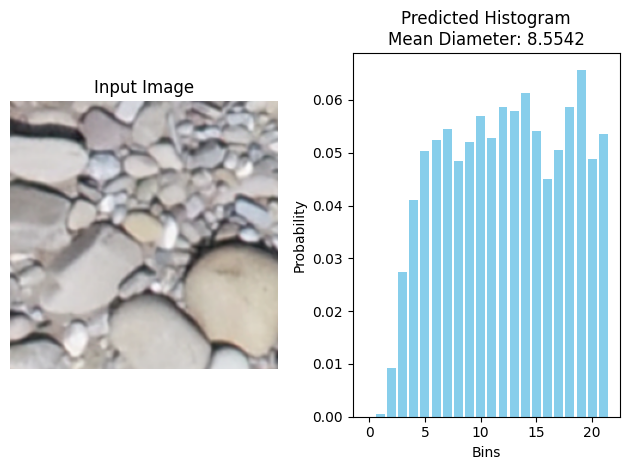

In [ ]:
import os, re, shutil
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import jax, jax.numpy as jnp
from flax import linen as nn
from transformers import FlaxViTModel, ViTImageProcessor
import orbax.checkpoint

# Unified checkpoint handler (same as used during training)
def handle_checkpoint(ckpt_dir, mode, state=None, step=None):
    ckpt_dir = os.path.abspath(ckpt_dir)
    os.makedirs(ckpt_dir, exist_ok=True)
    cp = orbax.checkpoint.PyTreeCheckpointer()

    if mode == "save":
        if state is None or step is None:
            raise ValueError("For saving, both state and step must be provided.")
        for d in os.listdir(ckpt_dir):
            if "orbax-checkpoint-tmp" in d:
                shutil.rmtree(os.path.join(ckpt_dir, d), ignore_errors=True)
        state_dict = {
            'decoder_state': state.decoder_state,
            'vit_params': state.vit_params,
            'step': state.step
        }
        cp_path = os.path.abspath(os.path.join(ckpt_dir, f"checkpoint_{step}"))
        if os.path.exists(cp_path):
            shutil.rmtree(cp_path)
        cp.save(cp_path, state_dict, force=True)
        print(f"Checkpoint saved at step {step}")
        return None

    elif mode == "restore":
        dirs = [d for d in os.listdir(ckpt_dir) if re.match(r"^checkpoint_\d+$", d)]
        if not dirs:
            print("No valid checkpoints found.")
            return None
        if step is None:
            step = max(int(d.split("_")[1]) for d in dirs)
        cp_path = os.path.abspath(os.path.join(ckpt_dir, f"checkpoint_{step}"))
        if not os.path.exists(cp_path):
            print(f"Checkpoint at step {step} not found.")
            return None
        state_dict = cp.restore(cp_path)
        print(f"Checkpoint restored from step {step}")
        return state_dict

    else:
        raise ValueError("Mode must be 'save' or 'restore'")

# Define the GrainSizeDecoder model
class GrainSizeDecoder(nn.Module):
    num_classes: int = 22  # Ensure this matches the training configuration
    layer_indices: tuple = (3, 6, 9, 11)

    @nn.compact
    def __call__(self, hidden_states, train=False):
        cls_token = hidden_states[self.layer_indices[3]][:, 0]
        x = nn.Dense(256, kernel_init=nn.initializers.normal(0.02))(cls_token)
        x = nn.gelu(x)
        hist_output = nn.softmax(nn.Dense(self.num_classes, kernel_init=nn.initializers.normal(0.02))(x))
        diameter_output = nn.Dense(1, kernel_init=nn.initializers.normal(0.02))(x)
        return {"histogram": hist_output, "diameter": diameter_output}

# Inference function: restores checkpoint, processes an image, and computes predictions.
def run_inference(image_path, ckpt_dir, num_classes=22):
    restored = handle_checkpoint(ckpt_dir, mode="restore")
    if restored is None:
        raise ValueError("No checkpoint found for inference.")
    restored_decoder = restored['decoder_state']
    restored_vit_params = restored['vit_params']

    vit_model = FlaxViTModel.from_pretrained(
        "google/vit-base-patch16-224-in21k", output_hidden_states=True
    )
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

    image = Image.open(image_path).convert("RGB")
    inputs = processor(images=image, return_tensors="np")["pixel_values"]

    vit_out = vit_model(pixel_values=inputs, params=restored_vit_params, output_hidden_states=True)
    hidden_states = vit_out.hidden_states

    decoder = GrainSizeDecoder(num_classes=num_classes)
    decoder_params = restored_decoder['params']
    outputs = decoder.apply(decoder_params, hidden_states, train=False)
    return image, outputs

# Plotting function: displays the input image, histogram prediction, and mean diameter.
def plot_results(image, outputs):
    # Convert outputs to numpy arrays
    histogram = np.array(outputs["histogram"])
    # If histogram is batched, take the first sample
    if histogram.ndim == 2:
        histogram = histogram[0]
    diameter = np.array(outputs["diameter"])
    # Similarly, extract scalar for diameter from batch if needed.
    if diameter.ndim > 1:
        diameter = diameter[0, 0]
    else:
        diameter = diameter.item()

    # Plot image and predictions
    fig, axs = plt.subplots(1, 2)

    # Display image
    axs[0].imshow(image)
    axs[0].axis("off")
    axs[0].set_title("Input Image")

    # Plot histogram as a bar chart
    x = np.arange(len(histogram))
    axs[1].bar(x, histogram, color='skyblue')
    axs[1].set_xlabel("Bins")
    axs[1].set_ylabel("Probability")
    axs[1].set_title(f"Predicted Histogram\nMean Diameter: {diameter:.4f}")

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    # Specify image and checkpoint paths
    image_path = "/content/grainet_dataset/images/image_0019.png"
    ckpt_dir = "./grainet_model/checkpoints"  # Ensure this matches your training checkpoint directory

    # Run inference and get image and predictions
    image, outputs = run_inference(image_path, ckpt_dir, num_classes=22)

    # Plot the results
    plot_results(image, outputs)


# new code for `grain net tpu trqaining

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 1: Setup TPU and Install Dependencies
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
# GRAINet Training on TPU (No CLS Tokens)

## First, enable TPU:
1. Runtime → Change runtime type
2. Hardware accelerator → TPU
3. Save

Then run this cell to install dependencies:
"""

# Install JAX with TPU support
!pip install --upgrade jax[tpu] -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --upgrade flax optax transformers pillow scikit-image matplotlib tqdm

# Setup TPU
import jax
try:
    import jax.tools.colab_tpu
    jax.tools.colab_tpu.setup_tpu()
except:
    pass

print(f"JAX version: {jax.__version__}")
print(f"Devices: {jax.devices()}")
print(f"Device count: {jax.local_device_count()}")

Looking in links: https://storage.googleapis.com/jax-releases/libtpu_releases.html
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 24.9 MB/s eta 0:00:00
  Attempting uninstall: libtpu
    Found existing installation: libtpu 0.0.7.1
    Uninstalling libtpu-0.0.7.1:
      Successfully uninstalled libtpu-0.0.7.1
  Attempting uninstall: jaxlib
    Found existing installation: jaxlib 0.5.1
    Uninstalling jaxlib-0.5.1:
      Successfully uninstalled jaxlib-0.5.1
  Attempting uninstall: jax
    Found existing installation: jax 0.5.2
    Uninstalling jax-0.5.2:
      Successfully uninstalled jax-0.5.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 90.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 75.4 MB/s eta 0:00

--2025-05-29 21:38:56--  https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
Resolving share.phys.ethz.ch (share.phys.ethz.ch)... 129.132.80.27, 2001:67c:10ec:3dc4::39
Connecting to share.phys.ethz.ch (share.phys.ethz.ch)|129.132.80.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 840559012 (802M) [application/zip]
Saving to: ‘GRAINet_demo_data.zip’

GRAINet_demo_data.z 100%[===================>] 801.62M  28.1MB/s    in 30s     

2025-05-29 21:39:26 (26.6 MB/s) - ‘GRAINet_demo_data.zip’ saved [840559012/840559012]

Contents of /content/data_GRAINet_demo/data_KLEmme_1bank.npz:
--------------------------------------------------
• images
  Shape: (212, 500, 200, 3)
  Data type: float32
• histograms
  Shape: (212, 22)
  Data type: float32
• tile_names
  Shape: (212,)
  Data type: object
• dm
  Shape: (212,)
  Data type: float32
--------------------------------------------------


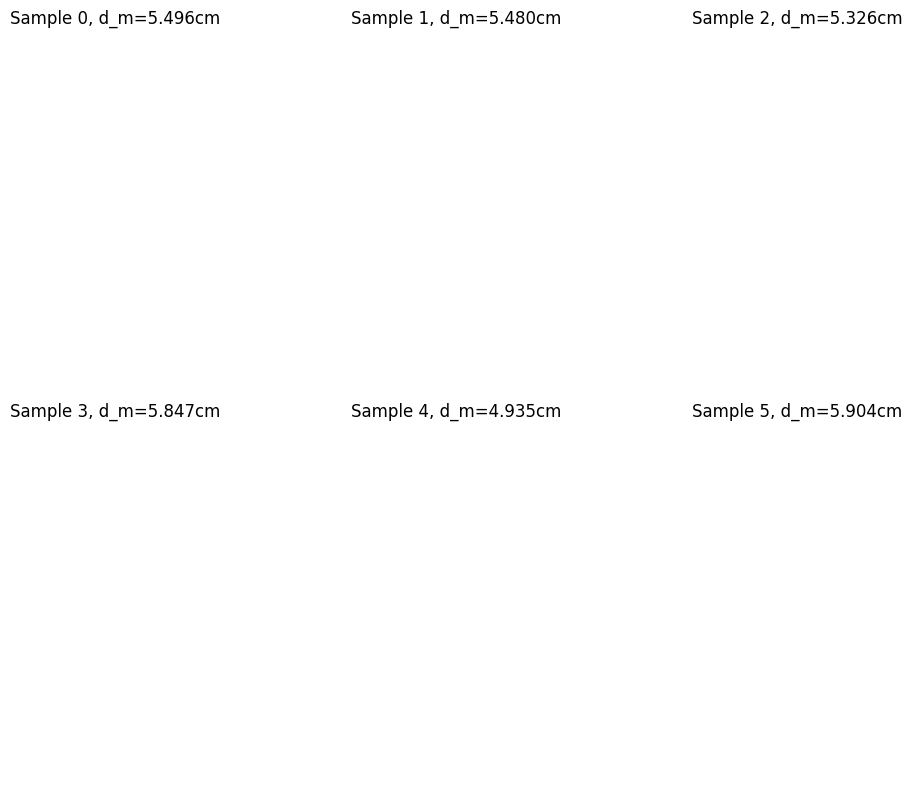

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 2: Download and Extract Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Download and prepare the GRAINet demo data:
"""

import os
import json
import numpy as np
from PIL import Image
from skimage.transform import resize
from tqdm import tqdm
import matplotlib.pyplot as plt

# Download the demo data
!wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
!unzip -q -o GRAINet_demo_data.zip

# View NPZ contents first
def inspect_npz(npz_path):
    """Inspect the NPZ file contents"""
    data = np.load(npz_path, allow_pickle=True)
    print(f"Contents of {npz_path}:")
    print("-" * 50)
    for key in data.files:
        array = data[key]
        print(f"• {key}")
        print(f"  Shape: {array.shape}")
        print(f"  Data type: {array.dtype}")
        if array.size < 10:
            print(f"  Values: {array}")
    print("-" * 50)
    return data

# Inspect the data
npz_path = "/content/data_GRAINet_demo/data_KLEmme_1bank.npz"
data = inspect_npz(npz_path)

# Visualize some samples
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i in range(6):
    ax = axes[i//3, i%3]
    ax.imshow(data['images'][i])
    ax.set_title(f"Sample {i}, d_m={data['dm'][i]:.3f}cm")
    ax.axis('off')
plt.tight_layout()
plt.show()


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 3: Extract and Organize Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Extract data into organized directories for training:
"""

def extract_and_organize_data(npz_path, output_dir, target_size=(224, 224)):
    """Extract data from NPZ and organize for training"""

    # Create directories
    os.makedirs(output_dir, exist_ok=True)
    for subdir in ["images", "histograms", "mean_diameters"]:
        os.makedirs(os.path.join(output_dir, subdir), exist_ok=True)

    # Load data
    print(f"Loading data from {npz_path}...")
    data = np.load(npz_path, allow_pickle=True)

    images = data['images']
    histograms = data['histograms'] if 'histograms' in data else None
    diameters = data['dm'] if 'dm' in data else None

    num_samples = len(images)
    print(f"Processing {num_samples} samples...")

    # Metadata
    metadata = {
        "num_samples": num_samples,
        "sample_mapping": {},
        "histogram_bins": histograms.shape[-1] if histograms is not None else None
    }

    # Process each sample
    for i in tqdm(range(num_samples), desc="Extracting"):
        # Process image
        img = images[i]
        h, w = img.shape[:2]

        # Center crop to square
        if w != h:
            size = min(w, h)
            start_w = (w - size) // 2
            start_h = (h - size) // 2
            img = img[start_h:start_h+size, start_w:start_w+size]

        # Resize to target size
        img_resized = resize(img, target_size, anti_aliasing=True, preserve_range=True)
        img_pil = Image.fromarray(img_resized.astype(np.uint8))

        # Save files
        img_name = f"image_{i:04d}.png"
        hist_name = f"hist_{i:04d}.npy"
        dm_name = f"dm_{i:04d}.npy"

        img_pil.save(os.path.join(output_dir, "images", img_name))

        if histograms is not None:
            np.save(os.path.join(output_dir, "histograms", hist_name), histograms[i])

        if diameters is not None:
            np.save(os.path.join(output_dir, "mean_diameters", dm_name), diameters[i])

        metadata["sample_mapping"][str(i)] = {
            "image": img_name,
            "histogram": hist_name,
            "mean_diameter": dm_name
        }

    # Save metadata
    with open(os.path.join(output_dir, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=2)

    print(f"✓ Data extracted to {output_dir}")
    return metadata

# Extract the data
output_dir = "./grainet_dataset"
metadata = extract_and_organize_data(npz_path, output_dir)

print(f"\nDataset ready:")
print(f"  Samples: {metadata['num_samples']}")
print(f"  Histogram bins: {metadata['histogram_bins']}")


Loading data from /content/data_GRAINet_demo/data_KLEmme_1bank.npz...
Processing 212 samples...


Extracting: 100%|██████████| 212/212 [00:06<00:00, 33.10it/s]

✓ Data extracted to ./grainet_dataset

Dataset ready:
  Samples: 212
  Histogram bins: 22


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 4: Define Model Architecture (No CLS Tokens)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define the GRAINet model that uses only patch tokens:
"""

import jax
import jax.numpy as jnp
import flax.linen as nn
from typing import Tuple, Dict, Optional

# Compatibility fix for JAX API changes
if not hasattr(jax, 'tree_map'):
    jax.tree_map = jax.tree_util.tree_map
if not hasattr(jax, 'tree_leaves'):
    jax.tree_leaves = jax.tree_util.tree_leaves

class SpatialAttentionPool(nn.Module):
    """Attention-based spatial pooling to aggregate patch features"""

    @nn.compact
    def __call__(self, x: jnp.ndarray) -> jnp.ndarray:
        B, H, W, C = x.shape

        # Flatten spatial dimensions
        x_flat = x.reshape(B, H * W, C)  # [B, HW, C]

        # Compute attention weights
        attn_logits = nn.Dense(1, name='attention')(x_flat)  # [B, HW, 1]
        attn_weights = nn.softmax(attn_logits, axis=1)

        # Weighted average pooling
        pooled = jnp.sum(x_flat * attn_weights, axis=1)  # [B, C]

        return pooled, attn_weights  # Return weights for visualization

class GRAINetDecoder(nn.Module):
    """Decoder using only patch tokens - no CLS tokens"""
    num_classes: int = 21
    feature_layers: Tuple[int, ...] = (3, 5, 7, 11)
    use_attention_pool: bool = True

    @nn.compact
    def __call__(self, hidden_states: list, train: bool = True) -> Dict[str, jnp.ndarray]:
        # Extract patch tokens from specified layers
        patch_features = []
        for layer_idx in self.feature_layers:
            features = hidden_states[layer_idx]  # [B, 197, 768]

            # Remove CLS token (position 0) - THIS IS KEY!
            patch_tokens = features[:, 1:, :]  # [B, 196, 768]

            # Reshape to spatial
            B = patch_tokens.shape[0]
            patches_2d = patch_tokens.reshape(B, 14, 14, 768)
            patch_features.append(patches_2d)

        # Concatenate features from all layers
        combined = jnp.concatenate(patch_features, axis=-1)  # [B, 14, 14, 3072]

        # Shared spatial processing
        x = nn.Conv(512, kernel_size=(3, 3), padding='SAME', name='shared_conv')(combined)
        x = nn.GroupNorm(num_groups=32, name='shared_gn')(x)
        x = nn.gelu(x)
        x = nn.Dropout(rate=0.1, deterministic=not train)(x)

        # Branch 1: Depth map
        depth = x

        # Additional processing
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv1')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn1')(depth)
        depth = nn.gelu(depth)

        # Upsample 14x14 -> 28x28
        depth = jax.image.resize(depth, (depth.shape[0], 28, 28, depth.shape[3]), method='bilinear')
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv2')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn2')(depth)
        depth = nn.gelu(depth)

        # Upsample 28x28 -> 56x56
        depth = jax.image.resize(depth, (depth.shape[0], 56, 56, depth.shape[3]), method='bilinear')
        depth = nn.Conv(128, kernel_size=(3, 3), padding='SAME', name='depth_conv3')(depth)
        depth = nn.GroupNorm(num_groups=8, name='depth_gn3')(depth)
        depth = nn.gelu(depth)

        # Final depth prediction
        depth_map = nn.Conv(1, kernel_size=(1, 1), name='depth_final')(depth)
        depth_map = nn.sigmoid(depth_map).squeeze(-1)  # [B, 56, 56]

        # Branch 2: Global predictions (histogram & diameter)
        # Additional conv for global features
        global_features = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='global_conv')(x)
        global_features = nn.GroupNorm(num_groups=16, name='global_gn')(global_features)
        global_features = nn.gelu(global_features)

        # Spatial aggregation
        if self.use_attention_pool:
            pooling = SpatialAttentionPool()
            pooled_features, attention_weights = pooling(global_features)
        else:
            # Global Average Pooling
            pooled_features = jnp.mean(global_features, axis=(1, 2))
            attention_weights = None

        # Shared MLP
        mlp = nn.Dense(512, name='mlp_fc1')(pooled_features)
        mlp = nn.gelu(mlp)
        mlp = nn.Dropout(rate=0.2, deterministic=not train)(mlp)
        mlp = nn.Dense(256, name='mlp_fc2')(mlp)
        mlp = nn.gelu(mlp)

        # Histogram head
        hist = nn.Dense(128, name='hist_fc1')(mlp)
        hist = nn.gelu(hist)
        histogram = nn.Dense(self.num_classes, name='hist_fc2')(hist)
        histogram = nn.softmax(histogram)

        # Diameter head
        diam = nn.Dense(64, name='diam_fc1')(mlp)
        diam = nn.gelu(diam)
        diameter = nn.Dense(1, name='diam_fc2')(diam)

        outputs = {
            "depth_map": depth_map,
            "histogram": histogram,
            "diameter": diameter
        }

        if attention_weights is not None:
            outputs["attention_weights"] = attention_weights

        return outputs

print("✓ Model architecture defined (No CLS tokens)")

# Test model creation
rng = jax.random.PRNGKey(0)
model = GRAINetDecoder(num_classes=21, use_attention_pool=True)
dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
params = model.init(rng, dummy_hidden, train=False)

param_count = sum(x.size for x in jax.tree_util.tree_leaves(params))
print(f"✓ Model parameters: {param_count:,}")

✓ Model architecture defined (No CLS tokens)
✓ Model parameters: 17,719,448


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 5: Setup Training Components
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Setup loss functions, data loading, and training utilities:
"""

from functools import partial
from pathlib import Path
import time

import flax
from flax.training import train_state
from flax import jax_utils
import optax
from transformers import FlaxViTModel, ViTImageProcessor

# Loss functions
def compute_losses(predictions: Dict[str, jnp.ndarray],
                   targets: Dict[str, jnp.ndarray],
                   weights: Dict[str, float]) -> Tuple[jnp.ndarray, Dict[str, jnp.ndarray]]:
    """Compute multi-task losses"""

    # Depth loss (MSE)
    depth_loss = jnp.mean((predictions["depth_map"] - targets["depth_map"]) ** 2)

    # Histogram loss (KL divergence)
    hist_loss = -jnp.mean(
        jnp.sum(targets["histogram"] * jnp.log(predictions["histogram"] + 1e-9), axis=-1)
    )

    # Diameter loss (MSE)
    diam_loss = jnp.mean((predictions["diameter"].squeeze() - targets["diameter"]) ** 2)

    # Weighted total
    total_loss = (
        weights["depth"] * depth_loss +
        weights["histogram"] * hist_loss +
        weights["diameter"] * diam_loss
    )

    metrics = {
        "total_loss": total_loss,
        "depth_loss": depth_loss,
        "hist_loss": hist_loss,
        "diam_loss": diam_loss
    }

    return total_loss, metrics

# Data loader
class GRAINetDataLoader:
    """Efficient data loader for training"""

    def __init__(self, data_dir: str, batch_size: int, processor):
        self.data_dir = Path(data_dir)
        self.batch_size = batch_size
        self.processor = processor

        # Load metadata
        with open(self.data_dir / "metadata.json", "r") as f:
            self.metadata = json.load(f)

        self.num_samples = self.metadata["num_samples"]
        self.indices = np.arange(self.num_samples)

    def generate_depth_map(self, idx: int) -> np.ndarray:
        """Generate synthetic depth map (placeholder - replace with real depth data)"""
        np.random.seed(idx)
        x = np.linspace(-1, 1, 56)
        y = np.linspace(-1, 1, 56)
        xx, yy = np.meshgrid(x, y)

        # Create some structure
        depth = 0.5 + 0.3 * np.exp(-(xx**2 + yy**2) / 0.5)
        depth += 0.1 * np.random.randn(56, 56)
        depth = np.clip(depth, 0, 1).astype(np.float32)

        return depth

    def get_batch(self) -> Tuple[np.ndarray, Dict[str, np.ndarray]]:
        """Get a random batch"""
        # Sample indices
        batch_idx = np.random.choice(self.indices, self.batch_size, replace=False)

        images = []
        targets = {
            "histogram": [],
            "diameter": [],
            "depth_map": []
        }

        for idx in batch_idx:
            mapping = self.metadata["sample_mapping"][str(idx)]

            # Load image
            img_path = self.data_dir / "images" / mapping["image"]
            image = Image.open(img_path).convert("RGB")
            images.append(image)

            # Load histogram
            hist_path = self.data_dir / "histograms" / mapping["histogram"]
            histogram = np.load(hist_path).astype(np.float32)
            histogram = histogram / (histogram.sum() + 1e-9)  # Normalize
            targets["histogram"].append(histogram)

            # Load diameter
            diam_path = self.data_dir / "mean_diameters" / mapping["mean_diameter"]
            diameter = np.load(diam_path).astype(np.float32)
            targets["diameter"].append(diameter)

            # Generate depth map (synthetic for demo)
            depth = self.generate_depth_map(idx)
            targets["depth_map"].append(depth)

        # Process images
        inputs = self.processor(images=images, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Stack targets
        for key in targets:
            targets[key] = np.stack(targets[key])

        return pixel_values, targets

print("✓ Training components ready")


✓ Training components ready


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 6: Training Step Functions
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define training and evaluation steps:
"""

# Create training step function with closed-over variables
def create_train_step(vit_model, loss_weights):
    """Create training step with static arguments"""

    @partial(jax.pmap, axis_name='batch', donate_argnums=(0,))
    def train_step(state, batch, dropout_rng, vit_params):
        """Single training step"""

        images, targets = batch
        dropout_rng, new_dropout_rng = jax.random.split(dropout_rng)

        def loss_fn(params):
            # Get ViT features
            vit_out = vit_model(
                pixel_values=images,
                params=vit_params,
                output_hidden_states=True
            )

            # Decoder predictions
            predictions = state.apply_fn(
                params,
                vit_out.hidden_states,
                train=True,
                rngs={'dropout': dropout_rng}
            )

            # Compute losses
            loss, metrics = compute_losses(predictions, targets, loss_weights)

            return loss, metrics

        # Compute gradients
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(state.params)

        # Average across devices
        grads = jax.lax.pmean(grads, axis_name='batch')
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        # Update state
        state = state.apply_gradients(grads=grads)

        return state, metrics, new_dropout_rng

    return train_step

# Create evaluation step function
def create_eval_step(vit_model, loss_weights):
    """Create evaluation step with static arguments"""

    @partial(jax.pmap, axis_name='batch')
    def eval_step(state, batch, vit_params):
        """Evaluation step"""

        images, targets = batch

        # Get ViT features
        vit_out = vit_model(
            pixel_values=images,
            params=vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = state.apply_fn(
            state.params,
            vit_out.hidden_states,
            train=False
        )

        # Compute metrics
        _, metrics = compute_losses(predictions, targets, loss_weights)

        # Average across devices
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        return metrics, predictions

    return eval_step

print("✓ Training functions defined")

✓ Training functions defined


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 7: Main Training Function
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Main training loop:
"""

def train_grainet(
    data_dir: str = "./grainet_dataset",
    output_dir: str = "./grainet_model",
    num_epochs: int = 50,
    batch_size: int = 32,
    learning_rate: float = 1e-4,
    use_attention_pool: bool = True,
    loss_weights: Optional[Dict[str, float]] = None,
    save_every: int = 10,
    eval_every: int = 5,
    seed: int = 42
):
    """Train GRAINet model"""

    # Setup
    np.random.seed(seed)
    rng = jax.random.PRNGKey(seed)

    if loss_weights is None:
        loss_weights = {"depth": 1.0, "histogram": 1.0, "diameter": 1.0}

    # Create output directory
    os.makedirs(output_dir, exist_ok=True)

    # Device setup
    num_devices = jax.local_device_count()
    print(f"Training on {num_devices} devices")

    # Adjust batch size for devices - ensure minimum batch size per device
    min_batch_per_device = 2  # Minimum samples per device
    if batch_size < num_devices * min_batch_per_device:
        batch_size = num_devices * min_batch_per_device
        print(f"Increased batch size to {batch_size} (minimum {min_batch_per_device} per device)")

    if batch_size % num_devices != 0:
        batch_size = (batch_size // num_devices) * num_devices
        print(f"Adjusted batch size to {batch_size} for {num_devices} devices")

    batch_size_per_device = batch_size // num_devices

    # Load ViT and processor
    print("Loading ViT model...")
    vit_model = FlaxViTModel.from_pretrained(
        "google/vit-base-patch16-224-in21k",
        output_hidden_states=True
    )
    vit_params = vit_model.params
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

    # Create data loader
    data_loader = GRAINetDataLoader(data_dir, batch_size, processor)

    # Detect number of classes
    sample_hist = np.load(Path(data_dir) / "histograms" / "hist_0000.npy")
    num_classes = len(sample_hist)
    print(f"Detected {num_classes} histogram bins")

    # Create model
    model = GRAINetDecoder(num_classes=num_classes, use_attention_pool=use_attention_pool)

    # Initialize parameters
    rng, init_rng = jax.random.split(rng)
    dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
    params = model.init(init_rng, dummy_hidden, train=False)

    # Create optimizer
    tx = optax.chain(
        optax.clip_by_global_norm(1.0),
        optax.adamw(learning_rate=learning_rate, weight_decay=1e-5)
    )

    # Create train state
    state = train_state.TrainState.create(
        apply_fn=model.apply,
        params=params,
        tx=tx
    )

    # Replicate across devices
    state = jax_utils.replicate(state)
    vit_params_replicated = jax_utils.replicate(vit_params)

    # Setup dropout RNG
    rng, dropout_rng = jax.random.split(rng)
    dropout_rngs = jax.random.split(dropout_rng, num_devices)

    # Training metrics
    steps_per_epoch = data_loader.num_samples // batch_size
    total_steps = num_epochs * steps_per_epoch

    print(f"\nTraining Configuration:")
    print(f"  Epochs: {num_epochs}")
    print(f"  Batch size: {batch_size} ({batch_size_per_device} per device)")
    print(f"  Steps per epoch: {steps_per_epoch}")
    print(f"  Total steps: {total_steps}")
    print(f"  Learning rate: {learning_rate}")
    print(f"  Pooling: {'Attention' if use_attention_pool else 'GAP'}")
    print(f"  Loss weights: {loss_weights}")

    # Create training and evaluation functions
    train_step = create_train_step(vit_model, loss_weights)
    eval_step = create_eval_step(vit_model, loss_weights)

    # Training history
    history = {
        "total_loss": [],
        "depth_loss": [],
        "hist_loss": [],
        "diam_loss": []
    }

    # Training loop
    print("\nStarting training...")
    step = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        # Training
        epoch_metrics = []
        pbar = tqdm(range(steps_per_epoch), desc="Training")

        for _ in pbar:
            # Get batch
            images, targets = data_loader.get_batch()

            # Reshape for devices
            images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
            targets = jax.tree_util.tree_map(
                lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                targets
            )

            batch = (images, targets)

            # Training step
            state, metrics, dropout_rngs = train_step(
                state, batch, dropout_rngs, vit_params_replicated
            )

            # Update metrics
            metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)  # Get from first device
            epoch_metrics.append(metrics)

            # Update progress bar
            avg_metrics = jax.tree_util.tree_map(
                lambda *xs: np.mean(xs),
                *epoch_metrics[-100:]  # Last 100 steps
            )
            pbar.set_postfix({
                "loss": f"{avg_metrics['total_loss']:.4f}",
                "depth": f"{avg_metrics['depth_loss']:.4f}",
                "hist": f"{avg_metrics['hist_loss']:.4f}",
                "diam": f"{avg_metrics['diam_loss']:.4f}"
            })

            step += 1

        # Record epoch metrics
        epoch_avg = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *epoch_metrics)
        for key in history:
            history[key].append(epoch_avg[key])

        # Evaluation
        if (epoch + 1) % eval_every == 0:
            print("\nEvaluating...")
            eval_metrics = []

            for _ in range(10):  # 10 eval batches
                images, targets = data_loader.get_batch()
                images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
                targets = jax.tree_util.tree_map(
                    lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                    targets
                )

                metrics, predictions = eval_step(
                    state, (images, targets), vit_params_replicated
                )
                metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)
                eval_metrics.append(metrics)

            avg_eval = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *eval_metrics)
            print(f"Eval - Loss: {avg_eval['total_loss']:.4f}, "
                  f"Depth: {avg_eval['depth_loss']:.4f}, "
                  f"Hist: {avg_eval['hist_loss']:.4f}, "
                  f"Diam: {avg_eval['diam_loss']:.4f}")

        # Save checkpoint
        if (epoch + 1) % save_every == 0:
            print(f"Saving checkpoint at epoch {epoch + 1}...")

            # Unreplicate state
            save_state = jax_utils.unreplicate(state)
            save_vit_params = jax_utils.unreplicate(vit_params_replicated)

            # Save
            ckpt_path = os.path.join(output_dir, f"checkpoint_{epoch + 1}.npz")
            np.savez(
                ckpt_path,
                params=save_state.params,
                vit_params=save_vit_params,
                config={
                    "num_classes": num_classes,
                    "use_attention_pool": use_attention_pool,
                    "loss_weights": loss_weights,
                    "epoch": epoch + 1
                },
                history=history
            )
            print(f"✓ Saved checkpoint: {ckpt_path}")

    print("\n✓ Training complete!")

    # Save final model
    final_state = jax_utils.unreplicate(state)
    final_vit_params = jax_utils.unreplicate(vit_params_replicated)

    final_path = os.path.join(output_dir, "final_model.npz")
    np.savez(
        final_path,
        params=final_state.params,
        vit_params=final_vit_params,
        config={
            "num_classes": num_classes,
            "use_attention_pool": use_attention_pool,
            "loss_weights": loss_weights,
            "epochs": num_epochs
        },
        history=history
    )
    print(f"✓ Saved final model: {final_path}")

    return final_state, history

Training on 8 devices
Loading ViT model...
Detected 22 histogram bins

Training Configuration:
  Epochs: 50
  Batch size: 64 (8 per device)
  Steps per epoch: 3
  Total steps: 150
  Learning rate: 0.0001
  Pooling: Attention
  Loss weights: {'depth': 1.0, 'histogram': 1.0, 'diameter': 1.0}

Starting training...

Epoch 1/50


Training: 100%|██████████| 3/3 [00:24<00:00,  8.28s/it, loss=81.6765, depth=0.0508, hist=3.0952, diam=78.5305]



Epoch 2/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=67.2998, depth=0.0260, hist=3.1009, diam=64.1729]



Epoch 3/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.00it/s, loss=57.0482, depth=0.0173, hist=3.1181, diam=53.9128]



Epoch 4/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=34.8203, depth=0.0166, hist=3.1529, diam=31.6509]



Epoch 5/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.93it/s, loss=16.7129, depth=0.0138, hist=3.2575, diam=13.4415]



Evaluating...
Eval - Loss: 9.9114, Depth: 0.0141, Hist: 3.3572, Diam: 6.5402

Epoch 6/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=11.5187, depth=0.0135, hist=3.4587, diam=8.0465]



Epoch 7/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.86it/s, loss=11.8960, depth=0.0151, hist=3.4259, diam=8.4549]



Epoch 8/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=10.1619, depth=0.0135, hist=3.2292, diam=6.9192]



Epoch 9/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=9.4323, depth=0.0137, hist=3.1359, diam=6.2827]



Epoch 10/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s, loss=8.2497, depth=0.0128, hist=3.1093, diam=5.1276]



Evaluating...
Eval - Loss: 8.0354, Depth: 0.0126, Hist: 3.0483, Diam: 4.9745
Saving checkpoint at epoch 10...
✓ Saved checkpoint: ./grainet_model/checkpoint_10.npz

Epoch 11/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=8.0163, depth=0.0125, hist=3.0981, diam=4.9057]



Epoch 12/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=7.6503, depth=0.0124, hist=3.0678, diam=4.5701]



Epoch 13/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=6.6282, depth=0.0124, hist=3.0537, diam=3.5621]



Epoch 14/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=6.7724, depth=0.0121, hist=3.0468, diam=3.7134]



Epoch 15/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=5.7137, depth=0.0122, hist=3.0344, diam=2.6672]



Evaluating...
Eval - Loss: 5.1704, Depth: 0.0119, Hist: 2.9899, Diam: 2.1686

Epoch 16/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=5.4423, depth=0.0120, hist=3.0264, diam=2.4039]



Epoch 17/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=4.9747, depth=0.0121, hist=3.0283, diam=1.9343]



Epoch 18/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=4.7689, depth=0.0122, hist=3.0237, diam=1.7330]



Epoch 19/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=4.3348, depth=0.0119, hist=3.0253, diam=1.2977]



Epoch 20/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=4.0387, depth=0.0118, hist=3.0239, diam=1.0030]



Evaluating...
Eval - Loss: 3.6424, Depth: 0.0116, Hist: 2.9818, Diam: 0.6490
Saving checkpoint at epoch 20...
✓ Saved checkpoint: ./grainet_model/checkpoint_20.npz

Epoch 21/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.9150, depth=0.0117, hist=3.0169, diam=0.8864]



Epoch 22/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.8390, depth=0.0116, hist=3.0160, diam=0.8114]



Epoch 23/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=3.8414, depth=0.0116, hist=3.0104, diam=0.8194]



Epoch 24/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.6641, depth=0.0116, hist=3.0134, diam=0.6392]



Epoch 25/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=3.6135, depth=0.0115, hist=3.0053, diam=0.5968]



Evaluating...
Eval - Loss: 3.2378, Depth: 0.0113, Hist: 2.9710, Diam: 0.2554

Epoch 26/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.4984, depth=0.0114, hist=3.0028, diam=0.4842]



Epoch 27/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.5277, depth=0.0114, hist=2.9983, diam=0.5180]



Epoch 28/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.5224, depth=0.0113, hist=2.9974, diam=0.5136]



Epoch 29/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=3.7022, depth=0.0116, hist=2.9961, diam=0.6945]



Epoch 30/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.18it/s, loss=3.5283, depth=0.0114, hist=2.9933, diam=0.5236]



Evaluating...
Eval - Loss: 3.1893, Depth: 0.0111, Hist: 2.9667, Diam: 0.2115
Saving checkpoint at epoch 30...
✓ Saved checkpoint: ./grainet_model/checkpoint_30.npz

Epoch 31/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.4367, depth=0.0112, hist=2.9959, diam=0.4296]



Epoch 32/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.4822, depth=0.0112, hist=2.9930, diam=0.4781]



Epoch 33/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=3.7171, depth=0.0113, hist=2.9947, diam=0.7112]



Epoch 34/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3713, depth=0.0113, hist=2.9905, diam=0.3694]



Epoch 35/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3203, depth=0.0112, hist=2.9891, diam=0.3200]



Evaluating...
Eval - Loss: 3.0696, Depth: 0.0111, Hist: 2.9640, Diam: 0.0946

Epoch 36/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.98it/s, loss=3.2826, depth=0.0112, hist=2.9889, diam=0.2826]



Epoch 37/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.2955, depth=0.0112, hist=2.9887, diam=0.2957]



Epoch 38/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.3093, depth=0.0110, hist=2.9840, diam=0.3143]



Epoch 39/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.3412, depth=0.0109, hist=2.9860, diam=0.3442]



Epoch 40/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.2312, depth=0.0108, hist=2.9835, diam=0.2369]



Evaluating...
Eval - Loss: 3.0791, Depth: 0.0107, Hist: 2.9614, Diam: 0.1070
Saving checkpoint at epoch 40...
✓ Saved checkpoint: ./grainet_model/checkpoint_40.npz

Epoch 41/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2969, depth=0.0108, hist=2.9865, diam=0.2996]



Epoch 42/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.2176, depth=0.0107, hist=2.9835, diam=0.2234]



Epoch 43/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.1867, depth=0.0108, hist=2.9813, diam=0.1946]



Epoch 44/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.2349, depth=0.0108, hist=2.9803, diam=0.2439]



Epoch 45/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.3414, depth=0.0108, hist=2.9820, diam=0.3487]



Evaluating...
Eval - Loss: 3.1965, Depth: 0.0106, Hist: 2.9610, Diam: 0.2248

Epoch 46/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2768, depth=0.0108, hist=2.9793, diam=0.2868]



Epoch 47/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2170, depth=0.0107, hist=2.9820, diam=0.2243]



Epoch 48/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2882, depth=0.0107, hist=2.9769, diam=0.3006]



Epoch 49/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.2143, depth=0.0107, hist=2.9786, diam=0.2250]



Epoch 50/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2039, depth=0.0106, hist=2.9788, diam=0.2145]



Evaluating...
Eval - Loss: 3.0236, Depth: 0.0105, Hist: 2.9599, Diam: 0.0532
Saving checkpoint at epoch 50...
✓ Saved checkpoint: ./grainet_model/checkpoint_50.npz

✓ Training complete!
✓ Saved final model: ./grainet_model/final_model.npz


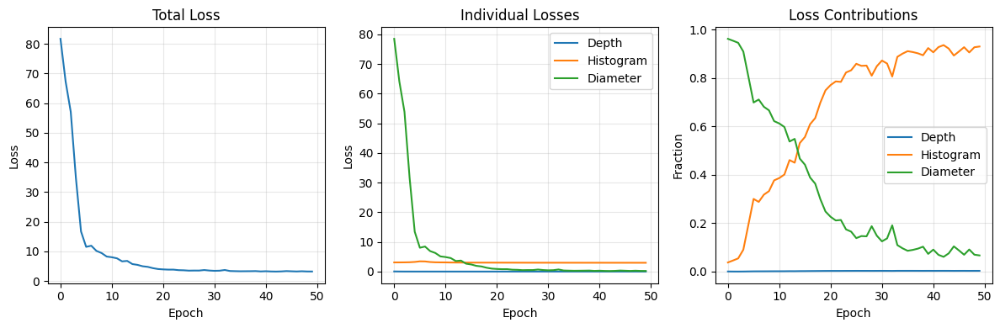

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 8: Run Training
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Start training! Adjust parameters as needed:
"""

# Train the model
final_state, history = train_grainet(
    data_dir="./grainet_dataset",
    output_dir="./grainet_model",
    num_epochs=50,
    batch_size=64,  # Increased for TPU (8 per device with 8 TPU cores)
    learning_rate=1e-4,
    use_attention_pool=True,  # Key: No CLS tokens, use attention!
    loss_weights={
        "depth": 1.0,
        "histogram": 1.0,
        "diameter": 1.0
    },
    save_every=10,
    eval_every=5
)

# Plot training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.plot(history['total_loss'])
plt.title('Total Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 2)
plt.plot(history['depth_loss'], label='Depth')
plt.plot(history['hist_loss'], label='Histogram')
plt.plot(history['diam_loss'], label='Diameter')
plt.title('Individual Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 3)
total = np.array(history['total_loss'])
plt.plot(np.array(history['depth_loss']) / total, label='Depth')
plt.plot(np.array(history['hist_loss']) / total, label='Histogram')
plt.plot(np.array(history['diam_loss']) / total, label='Diameter')
plt.title('Loss Contributions')
plt.xlabel('Epoch')
plt.ylabel('Fraction')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 9: Inference Class
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Create inference wrapper for easy predictions:
"""

class GRAINetPredictor:
    """Inference wrapper for trained model"""

    def __init__(self, checkpoint_path: str):
        """Load model from checkpoint"""
        print(f"Loading model from {checkpoint_path}")

        # Load checkpoint
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params = ckpt["params"].item()
        self.vit_params = ckpt["vit_params"].item()
        self.config = ckpt["config"].item()

        # Create model
        self.model = GRAINetDecoder(
            num_classes=self.config["num_classes"],
            use_attention_pool=self.config["use_attention_pool"]
        )

        # Load ViT
        self.vit_model = FlaxViTModel.from_pretrained(
            "google/vit-base-patch16-224-in21k",
            output_hidden_states=True
        )

        # Load processor
        self.processor = ViTImageProcessor.from_pretrained(
            "google/vit-base-patch16-224-in21k"
        )

        print(f"Model loaded: {self.config['num_classes']} classes, "
              f"{'Attention' if self.config['use_attention_pool'] else 'GAP'} pooling")

    def predict(self, image_path: str) -> Dict[str, np.ndarray]:
        """Predict on single image"""
        # Load and process image
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Get ViT features
        vit_out = self.vit_model(
            pixel_values=pixel_values,
            params=self.vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = self.model.apply(
            self.params,
            vit_out.hidden_states,
            train=False
        )

        # Convert to numpy
        results = {
            "image": image,
            "depth_map": np.array(predictions["depth_map"][0]),
            "histogram": np.array(predictions["histogram"][0]),
            "diameter": float(predictions["diameter"][0, 0])
        }

        if "attention_weights" in predictions:
            results["attention_weights"] = np.array(predictions["attention_weights"][0])

        return results

print("✓ Inference class ready")


✓ Inference class ready


Loading model from ./grainet_model/final_model.npz
Model loaded: 22 classes, Attention pooling

Testing on sample images...

Predicting on ./grainet_dataset/images/image_0000.png...
  Diameter: 5.546 cm
  Mode bin: 19
  Depth range: [0.500, 0.745]


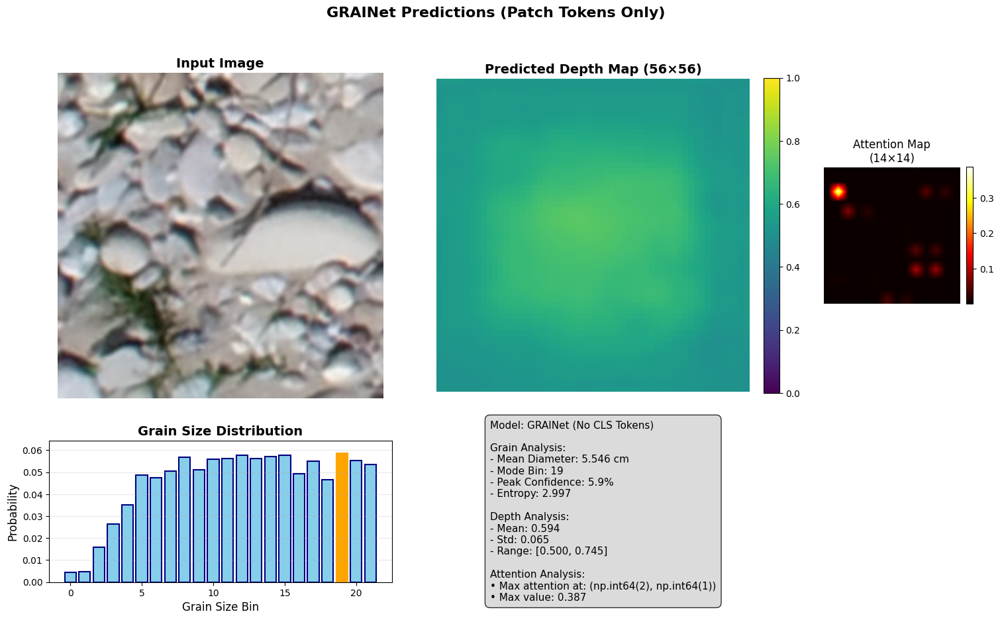


Predicting on ./grainet_dataset/images/image_0010.png...
  Diameter: 4.688 cm
  Mode bin: 19
  Depth range: [0.500, 0.749]


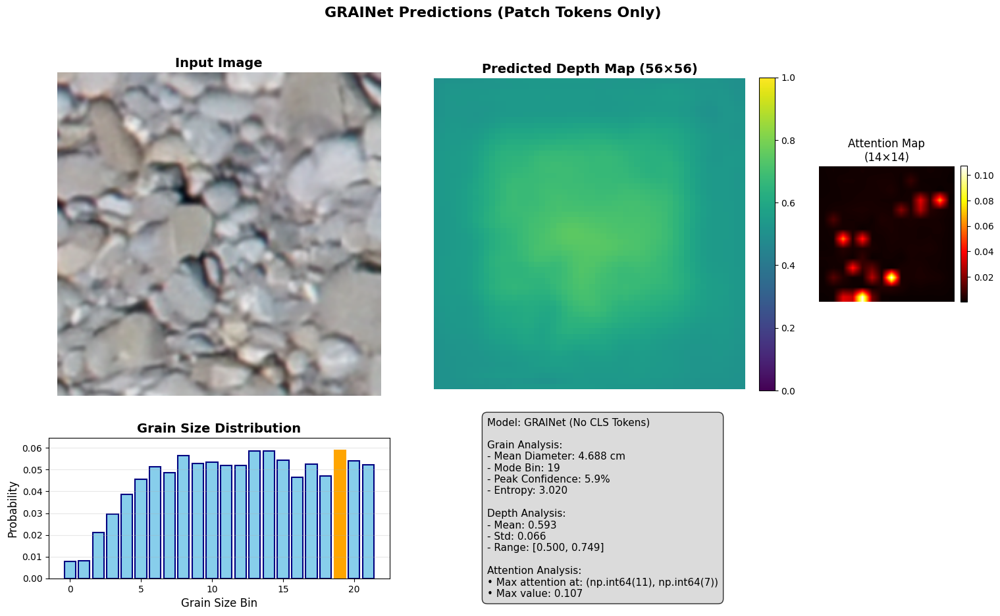


Predicting on ./grainet_dataset/images/image_0020.png...
  Diameter: 9.728 cm
  Mode bin: 13
  Depth range: [0.499, 0.724]


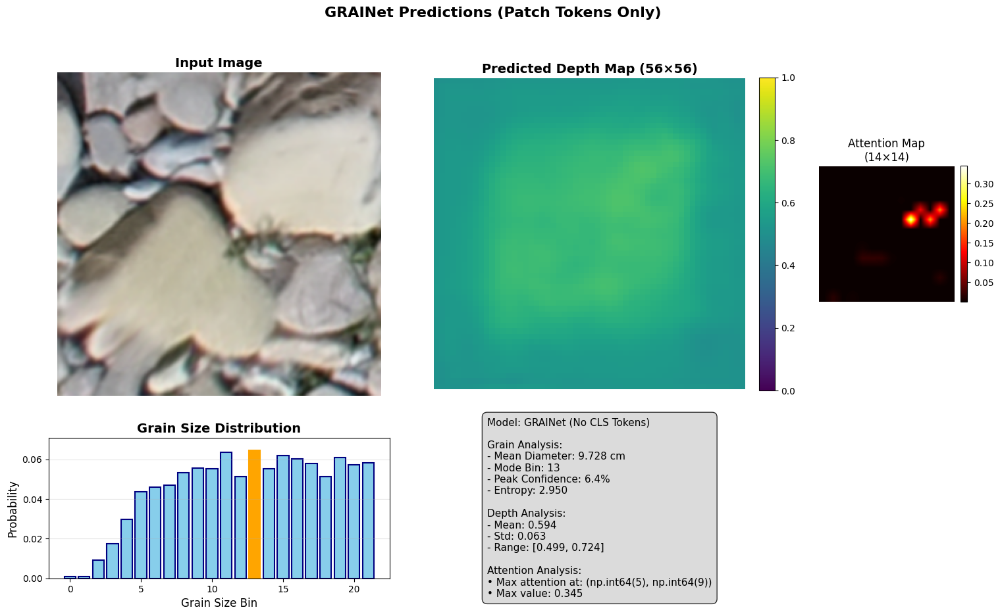

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 10: Test Inference and Visualize (FIXED)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Test the trained model on sample images:
"""

# Load the trained model
predictor = GRAINetPredictor("./grainet_model/final_model.npz")

# Function to visualize predictions
def visualize_prediction(result: Dict[str, np.ndarray], save_path: Optional[str] = None):
    """Comprehensive visualization of predictions"""

    # Check if attention weights are available
    has_attention = "attention_weights" in result

    # Create figure with appropriate layout
    if has_attention:
        fig = plt.figure(figsize=(18, 10))
        gs = fig.add_gridspec(3, 5, hspace=0.3, wspace=0.3)
    else:
        fig = plt.figure(figsize=(16, 10))
        gs = fig.add_gridspec(3, 4, hspace=0.3, wspace=0.3)

    # 1. Original image
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax1.imshow(result["image"])
    ax1.set_title("Input Image", fontsize=14, fontweight='bold')
    ax1.axis('off')

    # 2. Depth map
    ax2 = fig.add_subplot(gs[0:2, 2:4])
    im = ax2.imshow(result["depth_map"], cmap='viridis', vmin=0, vmax=1)
    ax2.set_title("Predicted Depth Map (56×56)", fontsize=14, fontweight='bold')
    ax2.axis('off')
    plt.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)

    # 3. Attention weights (if available)
    if has_attention:
        ax_att = fig.add_subplot(gs[0:2, 4])
        attention = result["attention_weights"].reshape(14, 14)
        im_att = ax_att.imshow(attention, cmap='hot', interpolation='bilinear')
        ax_att.set_title("Attention Map\n(14×14)", fontsize=12)
        ax_att.axis('off')
        plt.colorbar(im_att, ax=ax_att, fraction=0.046, pad=0.04)

    # 4. Histogram
    ax3 = fig.add_subplot(gs[2, 0:2])
    bins = np.arange(len(result["histogram"]))
    bars = ax3.bar(bins, result["histogram"], color='skyblue', edgecolor='navy', linewidth=1.5)

    # Highlight peak
    peak_idx = np.argmax(result["histogram"])
    bars[peak_idx].set_color('orange')

    ax3.set_xlabel("Grain Size Bin", fontsize=12)
    ax3.set_ylabel("Probability", fontsize=12)
    ax3.set_title("Grain Size Distribution", fontsize=14, fontweight='bold')
    ax3.grid(True, alpha=0.3, axis='y')
    ax3.set_ylim(0, max(result["histogram"]) * 1.1)

    # 5. Statistics
    ax4 = fig.add_subplot(gs[2, 2:])
    ax4.axis('off')

    # Calculate statistics
    entropy = -np.sum(result["histogram"] * np.log(result["histogram"] + 1e-9))
    mode_bin = np.argmax(result["histogram"])
    confidence = result["histogram"][mode_bin]

    # Depth statistics
    depth_mean = np.mean(result["depth_map"])
    depth_std = np.std(result["depth_map"])

    stats_text = f"""Model: GRAINet (No CLS Tokens)

Grain Analysis:
- Mean Diameter: {result['diameter']:.3f} cm
- Mode Bin: {mode_bin}
- Peak Confidence: {confidence:.1%}
- Entropy: {entropy:.3f}

Depth Analysis:
- Mean: {depth_mean:.3f}
- Std: {depth_std:.3f}
- Range: [{np.min(result['depth_map']):.3f}, {np.max(result['depth_map']):.3f}]"""

    if has_attention:
        # Add attention statistics
        attention_flat = result["attention_weights"].flatten()
        max_attention_idx = np.argmax(attention_flat)
        max_attention_pos = (max_attention_idx // 14, max_attention_idx % 14)
        stats_text += f"\n\nAttention Analysis:\n• Max attention at: {max_attention_pos}\n• Max value: {attention_flat[max_attention_idx]:.3f}"

    ax4.text(0.1, 0.5, stats_text, fontsize=11, verticalalignment='center',
             bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))

    plt.suptitle("GRAINet Predictions (Patch Tokens Only)", fontsize=16, fontweight='bold')

    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')

    plt.show()

# Test on multiple samples
print("\nTesting on sample images...")
sample_images = [
    "./grainet_dataset/images/image_0000.png",
    "./grainet_dataset/images/image_0010.png",
    "./grainet_dataset/images/image_0020.png"
]

for i, img_path in enumerate(sample_images[:3]):
    if os.path.exists(img_path):
        print(f"\nPredicting on {img_path}...")
        result = predictor.predict(img_path)

        print(f"  Diameter: {result['diameter']:.3f} cm")
        print(f"  Mode bin: {np.argmax(result['histogram'])}")
        print(f"  Depth range: [{result['depth_map'].min():.3f}, {result['depth_map'].max():.3f}]")

        visualize_prediction(result, save_path=f"prediction_{i}.png")

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 11: Summary and Next Steps
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
## Training Complete! 🎉

You've successfully trained GRAINet without CLS tokens on TPU.

### Key Points:
1. **No CLS Tokens**: All features come from spatial patch tokens
2. **Attention Pooling**: Learns which regions are important
3. **Multi-Output**: Predicts depth, histogram, and diameter
4. **TPU Optimized**: Efficient training on Google's TPUs

### Model Architecture:
```
Input → ViT → Extract Patches (No CLS) → Shared Conv →
    ├── Depth Branch → 56×56 depth map
    └── Attention Pool → Histogram & Diameter
```

### Next Steps:
1. **Adjust Loss Weights**: If one task dominates, modify weights
2. **Try GAP**: Set `use_attention_pool=False` for comparison
3. **Fine-tune ViT**: Unfreeze ViT params for better performance
4. **Real Depth Data**: Replace synthetic depth with real annotations
5. **Deploy Model**: Export for production use

### Files Created:
- `./grainet_dataset/`: Organized training data
- `./grainet_model/`: Saved checkpoints and final model
- `prediction_*.png`: Visualization of results

### Tips:
- For larger batches on TPU, increase `batch_size` to 64 or 128
- Monitor attention maps to understand model focus
- Use the predictor class for easy inference

Happy grain analysis! 🌾
"""

print("\n" + "="*60)
print("TRAINING COMPLETE!")
print("="*60)
print(f"\nFinal model saved to: ./grainet_model/final_model.npz")
print(f"Total epochs trained: {len(history['total_loss'])}")
print(f"Final total loss: {history['total_loss'][-1]:.4f}")
print(f"\nModel uses spatial features only (no CLS tokens)")
print(f"Pooling method: {'Attention' if final_state.apply_fn.keywords['use_attention_pool'] else 'GAP'}")
print("\n✓ Ready for inference!")


TRAINING COMPLETE!

Final model saved to: ./grainet_model/final_model.npz
Total epochs trained: 50
Final total loss: 3.2039

Model uses spatial features only (no CLS tokens)


AttributeError: 'function' object has no attribute 'keywords'

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 1: Setup TPU and Install Dependencies
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
# GRAINet Training on TPU (No CLS Tokens)

## First, enable TPU:
1. Runtime → Change runtime type
2. Hardware accelerator → TPU
3. Save

Then run this cell to install dependencies:
"""

# Install JAX with TPU support
!pip install --upgrade jax[tpu] -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --upgrade flax optax transformers pillow scikit-image matplotlib tqdm

# Setup TPU
import jax
try:
    import jax.tools.colab_tpu
    jax.tools.colab_tpu.setup_tpu()
except:
    pass

print(f"JAX version: {jax.__version__}")
print(f"Devices: {jax.devices()}")
print(f"Device count: {jax.local_device_count()}")

Looking in links: https://storage.googleapis.com/jax-releases/libtpu_releases.html
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 24.9 MB/s eta 0:00:00
  Attempting uninstall: libtpu
    Found existing installation: libtpu 0.0.7.1
    Uninstalling libtpu-0.0.7.1:
      Successfully uninstalled libtpu-0.0.7.1
  Attempting uninstall: jaxlib
    Found existing installation: jaxlib 0.5.1
    Uninstalling jaxlib-0.5.1:
      Successfully uninstalled jaxlib-0.5.1
  Attempting uninstall: jax
    Found existing installation: jax 0.5.2
    Uninstalling jax-0.5.2:
      Successfully uninstalled jax-0.5.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 90.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 75.4 MB/s eta 0:00

--2025-05-29 21:38:56--  https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
Resolving share.phys.ethz.ch (share.phys.ethz.ch)... 129.132.80.27, 2001:67c:10ec:3dc4::39
Connecting to share.phys.ethz.ch (share.phys.ethz.ch)|129.132.80.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 840559012 (802M) [application/zip]
Saving to: ‘GRAINet_demo_data.zip’

GRAINet_demo_data.z 100%[===================>] 801.62M  28.1MB/s    in 30s     

2025-05-29 21:39:26 (26.6 MB/s) - ‘GRAINet_demo_data.zip’ saved [840559012/840559012]

Contents of /content/data_GRAINet_demo/data_KLEmme_1bank.npz:
--------------------------------------------------
• images
  Shape: (212, 500, 200, 3)
  Data type: float32
• histograms
  Shape: (212, 22)
  Data type: float32
• tile_names
  Shape: (212,)
  Data type: object
• dm
  Shape: (212,)
  Data type: float32
--------------------------------------------------


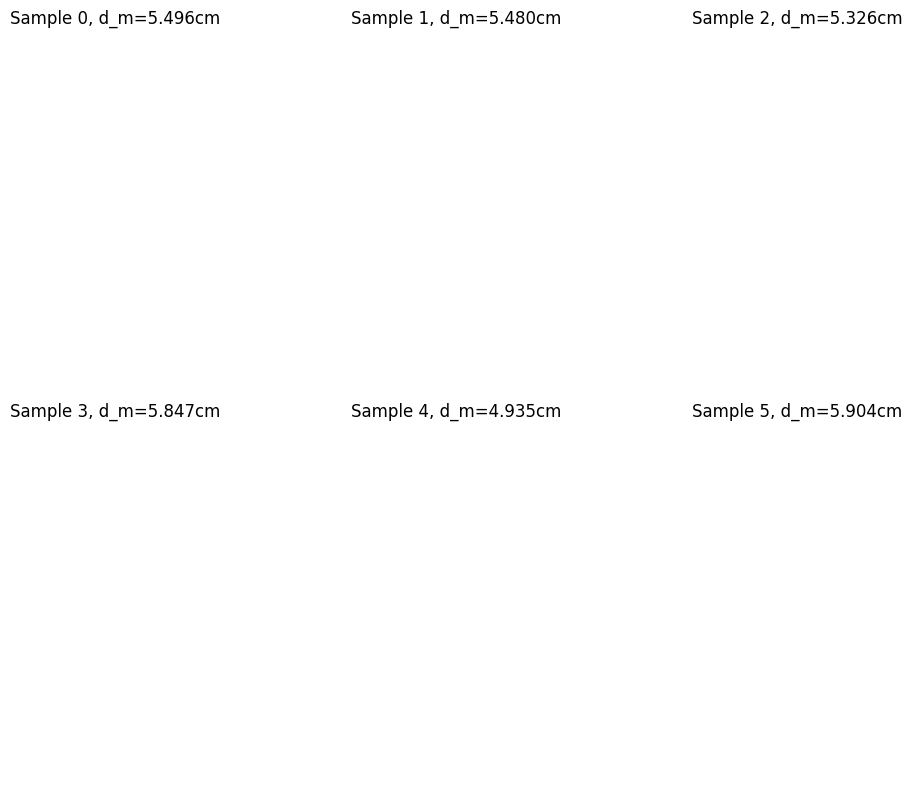

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 2: Download and Extract Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Download and prepare the GRAINet demo data:
"""

import os
import json
import numpy as np
from PIL import Image
from skimage.transform import resize
from tqdm import tqdm
import matplotlib.pyplot as plt

# Download the demo data
!wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
!unzip -q -o GRAINet_demo_data.zip

# View NPZ contents first
def inspect_npz(npz_path):
    """Inspect the NPZ file contents"""
    data = np.load(npz_path, allow_pickle=True)
    print(f"Contents of {npz_path}:")
    print("-" * 50)
    for key in data.files:
        array = data[key]
        print(f"• {key}")
        print(f"  Shape: {array.shape}")
        print(f"  Data type: {array.dtype}")
        if array.size < 10:
            print(f"  Values: {array}")
    print("-" * 50)
    return data

# Inspect the data
npz_path = "/content/data_GRAINet_demo/data_KLEmme_1bank.npz"
data = inspect_npz(npz_path)

# Visualize some samples
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i in range(6):
    ax = axes[i//3, i%3]
    ax.imshow(data['images'][i])
    ax.set_title(f"Sample {i}, d_m={data['dm'][i]:.3f}cm")
    ax.axis('off')
plt.tight_layout()
plt.show()


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 3: Extract and Organize Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Extract data into organized directories for training:
"""

def extract_and_organize_data(npz_path, output_dir, target_size=(224, 224)):
    """Extract data from NPZ and organize for training"""

    # Create directories
    os.makedirs(output_dir, exist_ok=True)
    for subdir in ["images", "histograms", "mean_diameters"]:
        os.makedirs(os.path.join(output_dir, subdir), exist_ok=True)

    # Load data
    print(f"Loading data from {npz_path}...")
    data = np.load(npz_path, allow_pickle=True)

    images = data['images']
    histograms = data['histograms'] if 'histograms' in data else None
    diameters = data['dm'] if 'dm' in data else None

    num_samples = len(images)
    print(f"Processing {num_samples} samples...")

    # Metadata
    metadata = {
        "num_samples": num_samples,
        "sample_mapping": {},
        "histogram_bins": histograms.shape[-1] if histograms is not None else None
    }

    # Process each sample
    for i in tqdm(range(num_samples), desc="Extracting"):
        # Process image
        img = images[i]
        h, w = img.shape[:2]

        # Center crop to square
        if w != h:
            size = min(w, h)
            start_w = (w - size) // 2
            start_h = (h - size) // 2
            img = img[start_h:start_h+size, start_w:start_w+size]

        # Resize to target size
        img_resized = resize(img, target_size, anti_aliasing=True, preserve_range=True)
        img_pil = Image.fromarray(img_resized.astype(np.uint8))

        # Save files
        img_name = f"image_{i:04d}.png"
        hist_name = f"hist_{i:04d}.npy"
        dm_name = f"dm_{i:04d}.npy"

        img_pil.save(os.path.join(output_dir, "images", img_name))

        if histograms is not None:
            np.save(os.path.join(output_dir, "histograms", hist_name), histograms[i])

        if diameters is not None:
            np.save(os.path.join(output_dir, "mean_diameters", dm_name), diameters[i])

        metadata["sample_mapping"][str(i)] = {
            "image": img_name,
            "histogram": hist_name,
            "mean_diameter": dm_name
        }

    # Save metadata
    with open(os.path.join(output_dir, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=2)

    print(f"✓ Data extracted to {output_dir}")
    return metadata

# Extract the data
output_dir = "./grainet_dataset"
metadata = extract_and_organize_data(npz_path, output_dir)

print(f"\nDataset ready:")
print(f"  Samples: {metadata['num_samples']}")
print(f"  Histogram bins: {metadata['histogram_bins']}")


Loading data from /content/data_GRAINet_demo/data_KLEmme_1bank.npz...
Processing 212 samples...


Extracting: 100%|██████████| 212/212 [00:06<00:00, 33.10it/s]

✓ Data extracted to ./grainet_dataset

Dataset ready:
  Samples: 212
  Histogram bins: 22


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 4: Define Model Architecture (No CLS Tokens)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define the GRAINet model that uses only patch tokens:
"""

import jax
import jax.numpy as jnp
import flax.linen as nn
from typing import Tuple, Dict, Optional

# Compatibility fix for JAX API changes
if not hasattr(jax, 'tree_map'):
    jax.tree_map = jax.tree_util.tree_map
if not hasattr(jax, 'tree_leaves'):
    jax.tree_leaves = jax.tree_util.tree_leaves

class SpatialAttentionPool(nn.Module):
    """Attention-based spatial pooling to aggregate patch features"""

    @nn.compact
    def __call__(self, x: jnp.ndarray) -> jnp.ndarray:
        B, H, W, C = x.shape

        # Flatten spatial dimensions
        x_flat = x.reshape(B, H * W, C)  # [B, HW, C]

        # Compute attention weights
        attn_logits = nn.Dense(1, name='attention')(x_flat)  # [B, HW, 1]
        attn_weights = nn.softmax(attn_logits, axis=1)

        # Weighted average pooling
        pooled = jnp.sum(x_flat * attn_weights, axis=1)  # [B, C]

        return pooled, attn_weights  # Return weights for visualization

class GRAINetDecoder(nn.Module):
    """Decoder using only patch tokens - no CLS tokens"""
    num_classes: int = 21
    feature_layers: Tuple[int, ...] = (3, 5, 7, 11)
    use_attention_pool: bool = True

    @nn.compact
    def __call__(self, hidden_states: list, train: bool = True) -> Dict[str, jnp.ndarray]:
        # Extract patch tokens from specified layers
        patch_features = []
        for layer_idx in self.feature_layers:
            features = hidden_states[layer_idx]  # [B, 197, 768]

            # Remove CLS token (position 0) - THIS IS KEY!
            patch_tokens = features[:, 1:, :]  # [B, 196, 768]

            # Reshape to spatial
            B = patch_tokens.shape[0]
            patches_2d = patch_tokens.reshape(B, 14, 14, 768)
            patch_features.append(patches_2d)

        # Concatenate features from all layers
        combined = jnp.concatenate(patch_features, axis=-1)  # [B, 14, 14, 3072]

        # Shared spatial processing
        x = nn.Conv(512, kernel_size=(3, 3), padding='SAME', name='shared_conv')(combined)
        x = nn.GroupNorm(num_groups=32, name='shared_gn')(x)
        x = nn.gelu(x)
        x = nn.Dropout(rate=0.1, deterministic=not train)(x)

        # Branch 1: Depth map
        depth = x

        # Additional processing
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv1')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn1')(depth)
        depth = nn.gelu(depth)

        # Upsample 14x14 -> 28x28
        depth = jax.image.resize(depth, (depth.shape[0], 28, 28, depth.shape[3]), method='bilinear')
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv2')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn2')(depth)
        depth = nn.gelu(depth)

        # Upsample 28x28 -> 56x56
        depth = jax.image.resize(depth, (depth.shape[0], 56, 56, depth.shape[3]), method='bilinear')
        depth = nn.Conv(128, kernel_size=(3, 3), padding='SAME', name='depth_conv3')(depth)
        depth = nn.GroupNorm(num_groups=8, name='depth_gn3')(depth)
        depth = nn.gelu(depth)

        # Final depth prediction
        depth_map = nn.Conv(1, kernel_size=(1, 1), name='depth_final')(depth)
        depth_map = nn.sigmoid(depth_map).squeeze(-1)  # [B, 56, 56]

        # Branch 2: Global predictions (histogram & diameter)
        # Additional conv for global features
        global_features = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='global_conv')(x)
        global_features = nn.GroupNorm(num_groups=16, name='global_gn')(global_features)
        global_features = nn.gelu(global_features)

        # Spatial aggregation
        if self.use_attention_pool:
            pooling = SpatialAttentionPool()
            pooled_features, attention_weights = pooling(global_features)
        else:
            # Global Average Pooling
            pooled_features = jnp.mean(global_features, axis=(1, 2))
            attention_weights = None

        # Shared MLP
        mlp = nn.Dense(512, name='mlp_fc1')(pooled_features)
        mlp = nn.gelu(mlp)
        mlp = nn.Dropout(rate=0.2, deterministic=not train)(mlp)
        mlp = nn.Dense(256, name='mlp_fc2')(mlp)
        mlp = nn.gelu(mlp)

        # Histogram head
        hist = nn.Dense(128, name='hist_fc1')(mlp)
        hist = nn.gelu(hist)
        histogram = nn.Dense(self.num_classes, name='hist_fc2')(hist)
        histogram = nn.softmax(histogram)

        # Diameter head
        diam = nn.Dense(64, name='diam_fc1')(mlp)
        diam = nn.gelu(diam)
        diameter = nn.Dense(1, name='diam_fc2')(diam)

        outputs = {
            "depth_map": depth_map,
            "histogram": histogram,
            "diameter": diameter
        }

        if attention_weights is not None:
            outputs["attention_weights"] = attention_weights

        return outputs

print("✓ Model architecture defined (No CLS tokens)")

# Test model creation
rng = jax.random.PRNGKey(0)
model = GRAINetDecoder(num_classes=21, use_attention_pool=True)
dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
params = model.init(rng, dummy_hidden, train=False)

param_count = sum(x.size for x in jax.tree_util.tree_leaves(params))
print(f"✓ Model parameters: {param_count:,}")

✓ Model architecture defined (No CLS tokens)
✓ Model parameters: 17,719,448


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 5: Setup Training Components
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Setup loss functions, data loading, and training utilities:
"""

from functools import partial
from pathlib import Path
import time

import flax
from flax.training import train_state
from flax import jax_utils
import optax
from transformers import FlaxViTModel, ViTImageProcessor

# Loss functions
def compute_losses(predictions: Dict[str, jnp.ndarray],
                   targets: Dict[str, jnp.ndarray],
                   weights: Dict[str, float]) -> Tuple[jnp.ndarray, Dict[str, jnp.ndarray]]:
    """Compute multi-task losses"""

    # Depth loss (MSE)
    depth_loss = jnp.mean((predictions["depth_map"] - targets["depth_map"]) ** 2)

    # Histogram loss (KL divergence)
    hist_loss = -jnp.mean(
        jnp.sum(targets["histogram"] * jnp.log(predictions["histogram"] + 1e-9), axis=-1)
    )

    # Diameter loss (MSE)
    diam_loss = jnp.mean((predictions["diameter"].squeeze() - targets["diameter"]) ** 2)

    # Weighted total
    total_loss = (
        weights["depth"] * depth_loss +
        weights["histogram"] * hist_loss +
        weights["diameter"] * diam_loss
    )

    metrics = {
        "total_loss": total_loss,
        "depth_loss": depth_loss,
        "hist_loss": hist_loss,
        "diam_loss": diam_loss
    }

    return total_loss, metrics

# Data loader
class GRAINetDataLoader:
    """Efficient data loader for training"""

    def __init__(self, data_dir: str, batch_size: int, processor):
        self.data_dir = Path(data_dir)
        self.batch_size = batch_size
        self.processor = processor

        # Load metadata
        with open(self.data_dir / "metadata.json", "r") as f:
            self.metadata = json.load(f)

        self.num_samples = self.metadata["num_samples"]
        self.indices = np.arange(self.num_samples)

    def generate_depth_map(self, idx: int) -> np.ndarray:
        """Generate synthetic depth map (placeholder - replace with real depth data)"""
        np.random.seed(idx)
        x = np.linspace(-1, 1, 56)
        y = np.linspace(-1, 1, 56)
        xx, yy = np.meshgrid(x, y)

        # Create some structure
        depth = 0.5 + 0.3 * np.exp(-(xx**2 + yy**2) / 0.5)
        depth += 0.1 * np.random.randn(56, 56)
        depth = np.clip(depth, 0, 1).astype(np.float32)

        return depth

    def get_batch(self) -> Tuple[np.ndarray, Dict[str, np.ndarray]]:
        """Get a random batch"""
        # Sample indices
        batch_idx = np.random.choice(self.indices, self.batch_size, replace=False)

        images = []
        targets = {
            "histogram": [],
            "diameter": [],
            "depth_map": []
        }

        for idx in batch_idx:
            mapping = self.metadata["sample_mapping"][str(idx)]

            # Load image
            img_path = self.data_dir / "images" / mapping["image"]
            image = Image.open(img_path).convert("RGB")
            images.append(image)

            # Load histogram
            hist_path = self.data_dir / "histograms" / mapping["histogram"]
            histogram = np.load(hist_path).astype(np.float32)
            histogram = histogram / (histogram.sum() + 1e-9)  # Normalize
            targets["histogram"].append(histogram)

            # Load diameter
            diam_path = self.data_dir / "mean_diameters" / mapping["mean_diameter"]
            diameter = np.load(diam_path).astype(np.float32)
            targets["diameter"].append(diameter)

            # Generate depth map (synthetic for demo)
            depth = self.generate_depth_map(idx)
            targets["depth_map"].append(depth)

        # Process images
        inputs = self.processor(images=images, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Stack targets
        for key in targets:
            targets[key] = np.stack(targets[key])

        return pixel_values, targets

print("✓ Training components ready")


✓ Training components ready


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 6: Training Step Functions
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define training and evaluation steps:
"""

# Create training step function with closed-over variables
def create_train_step(vit_model, loss_weights):
    """Create training step with static arguments"""

    @partial(jax.pmap, axis_name='batch', donate_argnums=(0,))
    def train_step(state, batch, dropout_rng, vit_params):
        """Single training step"""

        images, targets = batch
        dropout_rng, new_dropout_rng = jax.random.split(dropout_rng)

        def loss_fn(params):
            # Get ViT features
            vit_out = vit_model(
                pixel_values=images,
                params=vit_params,
                output_hidden_states=True
            )

            # Decoder predictions
            predictions = state.apply_fn(
                params,
                vit_out.hidden_states,
                train=True,
                rngs={'dropout': dropout_rng}
            )

            # Compute losses
            loss, metrics = compute_losses(predictions, targets, loss_weights)

            return loss, metrics

        # Compute gradients
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(state.params)

        # Average across devices
        grads = jax.lax.pmean(grads, axis_name='batch')
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        # Update state
        state = state.apply_gradients(grads=grads)

        return state, metrics, new_dropout_rng

    return train_step

# Create evaluation step function
def create_eval_step(vit_model, loss_weights):
    """Create evaluation step with static arguments"""

    @partial(jax.pmap, axis_name='batch')
    def eval_step(state, batch, vit_params):
        """Evaluation step"""

        images, targets = batch

        # Get ViT features
        vit_out = vit_model(
            pixel_values=images,
            params=vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = state.apply_fn(
            state.params,
            vit_out.hidden_states,
            train=False
        )

        # Compute metrics
        _, metrics = compute_losses(predictions, targets, loss_weights)

        # Average across devices
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        return metrics, predictions

    return eval_step

print("✓ Training functions defined")

✓ Training functions defined


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 7: Main Training Function
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Main training loop:
"""

def train_grainet(
    data_dir: str = "./grainet_dataset",
    output_dir: str = "./grainet_model",
    num_epochs: int = 50,
    batch_size: int = 32,
    learning_rate: float = 1e-4,
    use_attention_pool: bool = True,
    loss_weights: Optional[Dict[str, float]] = None,
    save_every: int = 10,
    eval_every: int = 5,
    seed: int = 42
):
    """Train GRAINet model"""

    # Setup
    np.random.seed(seed)
    rng = jax.random.PRNGKey(seed)

    if loss_weights is None:
        loss_weights = {"depth": 1.0, "histogram": 1.0, "diameter": 1.0}

    # Create output directory
    os.makedirs(output_dir, exist_ok=True)

    # Device setup
    num_devices = jax.local_device_count()
    print(f"Training on {num_devices} devices")

    # Adjust batch size for devices - ensure minimum batch size per device
    min_batch_per_device = 2  # Minimum samples per device
    if batch_size < num_devices * min_batch_per_device:
        batch_size = num_devices * min_batch_per_device
        print(f"Increased batch size to {batch_size} (minimum {min_batch_per_device} per device)")

    if batch_size % num_devices != 0:
        batch_size = (batch_size // num_devices) * num_devices
        print(f"Adjusted batch size to {batch_size} for {num_devices} devices")

    batch_size_per_device = batch_size // num_devices

    # Load ViT and processor
    print("Loading ViT model...")
    vit_model = FlaxViTModel.from_pretrained(
        "google/vit-base-patch16-224-in21k",
        output_hidden_states=True
    )
    vit_params = vit_model.params
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

    # Create data loader
    data_loader = GRAINetDataLoader(data_dir, batch_size, processor)

    # Detect number of classes
    sample_hist = np.load(Path(data_dir) / "histograms" / "hist_0000.npy")
    num_classes = len(sample_hist)
    print(f"Detected {num_classes} histogram bins")

    # Create model
    model = GRAINetDecoder(num_classes=num_classes, use_attention_pool=use_attention_pool)

    # Initialize parameters
    rng, init_rng = jax.random.split(rng)
    dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
    params = model.init(init_rng, dummy_hidden, train=False)

    # Create optimizer
    tx = optax.chain(
        optax.clip_by_global_norm(1.0),
        optax.adamw(learning_rate=learning_rate, weight_decay=1e-5)
    )

    # Create train state
    state = train_state.TrainState.create(
        apply_fn=model.apply,
        params=params,
        tx=tx
    )

    # Replicate across devices
    state = jax_utils.replicate(state)
    vit_params_replicated = jax_utils.replicate(vit_params)

    # Setup dropout RNG
    rng, dropout_rng = jax.random.split(rng)
    dropout_rngs = jax.random.split(dropout_rng, num_devices)

    # Training metrics
    steps_per_epoch = data_loader.num_samples // batch_size
    total_steps = num_epochs * steps_per_epoch

    print(f"\nTraining Configuration:")
    print(f"  Epochs: {num_epochs}")
    print(f"  Batch size: {batch_size} ({batch_size_per_device} per device)")
    print(f"  Steps per epoch: {steps_per_epoch}")
    print(f"  Total steps: {total_steps}")
    print(f"  Learning rate: {learning_rate}")
    print(f"  Pooling: {'Attention' if use_attention_pool else 'GAP'}")
    print(f"  Loss weights: {loss_weights}")

    # Create training and evaluation functions
    train_step = create_train_step(vit_model, loss_weights)
    eval_step = create_eval_step(vit_model, loss_weights)

    # Training history
    history = {
        "total_loss": [],
        "depth_loss": [],
        "hist_loss": [],
        "diam_loss": []
    }

    # Training loop
    print("\nStarting training...")
    step = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        # Training
        epoch_metrics = []
        pbar = tqdm(range(steps_per_epoch), desc="Training")

        for _ in pbar:
            # Get batch
            images, targets = data_loader.get_batch()

            # Reshape for devices
            images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
            targets = jax.tree_util.tree_map(
                lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                targets
            )

            batch = (images, targets)

            # Training step
            state, metrics, dropout_rngs = train_step(
                state, batch, dropout_rngs, vit_params_replicated
            )

            # Update metrics
            metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)  # Get from first device
            epoch_metrics.append(metrics)

            # Update progress bar
            avg_metrics = jax.tree_util.tree_map(
                lambda *xs: np.mean(xs),
                *epoch_metrics[-100:]  # Last 100 steps
            )
            pbar.set_postfix({
                "loss": f"{avg_metrics['total_loss']:.4f}",
                "depth": f"{avg_metrics['depth_loss']:.4f}",
                "hist": f"{avg_metrics['hist_loss']:.4f}",
                "diam": f"{avg_metrics['diam_loss']:.4f}"
            })

            step += 1

        # Record epoch metrics
        epoch_avg = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *epoch_metrics)
        for key in history:
            history[key].append(epoch_avg[key])

        # Evaluation
        if (epoch + 1) % eval_every == 0:
            print("\nEvaluating...")
            eval_metrics = []

            for _ in range(10):  # 10 eval batches
                images, targets = data_loader.get_batch()
                images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
                targets = jax.tree_util.tree_map(
                    lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                    targets
                )

                metrics, predictions = eval_step(
                    state, (images, targets), vit_params_replicated
                )
                metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)
                eval_metrics.append(metrics)

            avg_eval = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *eval_metrics)
            print(f"Eval - Loss: {avg_eval['total_loss']:.4f}, "
                  f"Depth: {avg_eval['depth_loss']:.4f}, "
                  f"Hist: {avg_eval['hist_loss']:.4f}, "
                  f"Diam: {avg_eval['diam_loss']:.4f}")

        # Save checkpoint
        if (epoch + 1) % save_every == 0:
            print(f"Saving checkpoint at epoch {epoch + 1}...")

            # Unreplicate state
            save_state = jax_utils.unreplicate(state)
            save_vit_params = jax_utils.unreplicate(vit_params_replicated)

            # Save
            ckpt_path = os.path.join(output_dir, f"checkpoint_{epoch + 1}.npz")
            np.savez(
                ckpt_path,
                params=save_state.params,
                vit_params=save_vit_params,
                config={
                    "num_classes": num_classes,
                    "use_attention_pool": use_attention_pool,
                    "loss_weights": loss_weights,
                    "epoch": epoch + 1
                },
                history=history
            )
            print(f"✓ Saved checkpoint: {ckpt_path}")

    print("\n✓ Training complete!")

    # Save final model
    final_state = jax_utils.unreplicate(state)
    final_vit_params = jax_utils.unreplicate(vit_params_replicated)

    final_path = os.path.join(output_dir, "final_model.npz")
    np.savez(
        final_path,
        params=final_state.params,
        vit_params=final_vit_params,
        config={
            "num_classes": num_classes,
            "use_attention_pool": use_attention_pool,
            "loss_weights": loss_weights,
            "epochs": num_epochs
        },
        history=history
    )
    print(f"✓ Saved final model: {final_path}")

    return final_state, history

Training on 8 devices
Loading ViT model...
Detected 22 histogram bins

Training Configuration:
  Epochs: 50
  Batch size: 64 (8 per device)
  Steps per epoch: 3
  Total steps: 150
  Learning rate: 0.0001
  Pooling: Attention
  Loss weights: {'depth': 1.0, 'histogram': 1.0, 'diameter': 1.0}

Starting training...

Epoch 1/50


Training: 100%|██████████| 3/3 [00:24<00:00,  8.28s/it, loss=81.6765, depth=0.0508, hist=3.0952, diam=78.5305]



Epoch 2/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=67.2998, depth=0.0260, hist=3.1009, diam=64.1729]



Epoch 3/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.00it/s, loss=57.0482, depth=0.0173, hist=3.1181, diam=53.9128]



Epoch 4/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=34.8203, depth=0.0166, hist=3.1529, diam=31.6509]



Epoch 5/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.93it/s, loss=16.7129, depth=0.0138, hist=3.2575, diam=13.4415]



Evaluating...
Eval - Loss: 9.9114, Depth: 0.0141, Hist: 3.3572, Diam: 6.5402

Epoch 6/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=11.5187, depth=0.0135, hist=3.4587, diam=8.0465]



Epoch 7/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.86it/s, loss=11.8960, depth=0.0151, hist=3.4259, diam=8.4549]



Epoch 8/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=10.1619, depth=0.0135, hist=3.2292, diam=6.9192]



Epoch 9/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=9.4323, depth=0.0137, hist=3.1359, diam=6.2827]



Epoch 10/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s, loss=8.2497, depth=0.0128, hist=3.1093, diam=5.1276]



Evaluating...
Eval - Loss: 8.0354, Depth: 0.0126, Hist: 3.0483, Diam: 4.9745
Saving checkpoint at epoch 10...
✓ Saved checkpoint: ./grainet_model/checkpoint_10.npz

Epoch 11/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=8.0163, depth=0.0125, hist=3.0981, diam=4.9057]



Epoch 12/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=7.6503, depth=0.0124, hist=3.0678, diam=4.5701]



Epoch 13/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=6.6282, depth=0.0124, hist=3.0537, diam=3.5621]



Epoch 14/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=6.7724, depth=0.0121, hist=3.0468, diam=3.7134]



Epoch 15/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=5.7137, depth=0.0122, hist=3.0344, diam=2.6672]



Evaluating...
Eval - Loss: 5.1704, Depth: 0.0119, Hist: 2.9899, Diam: 2.1686

Epoch 16/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=5.4423, depth=0.0120, hist=3.0264, diam=2.4039]



Epoch 17/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=4.9747, depth=0.0121, hist=3.0283, diam=1.9343]



Epoch 18/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=4.7689, depth=0.0122, hist=3.0237, diam=1.7330]



Epoch 19/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=4.3348, depth=0.0119, hist=3.0253, diam=1.2977]



Epoch 20/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=4.0387, depth=0.0118, hist=3.0239, diam=1.0030]



Evaluating...
Eval - Loss: 3.6424, Depth: 0.0116, Hist: 2.9818, Diam: 0.6490
Saving checkpoint at epoch 20...
✓ Saved checkpoint: ./grainet_model/checkpoint_20.npz

Epoch 21/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.9150, depth=0.0117, hist=3.0169, diam=0.8864]



Epoch 22/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.8390, depth=0.0116, hist=3.0160, diam=0.8114]



Epoch 23/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=3.8414, depth=0.0116, hist=3.0104, diam=0.8194]



Epoch 24/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.6641, depth=0.0116, hist=3.0134, diam=0.6392]



Epoch 25/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=3.6135, depth=0.0115, hist=3.0053, diam=0.5968]



Evaluating...
Eval - Loss: 3.2378, Depth: 0.0113, Hist: 2.9710, Diam: 0.2554

Epoch 26/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.4984, depth=0.0114, hist=3.0028, diam=0.4842]



Epoch 27/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.5277, depth=0.0114, hist=2.9983, diam=0.5180]



Epoch 28/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.5224, depth=0.0113, hist=2.9974, diam=0.5136]



Epoch 29/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=3.7022, depth=0.0116, hist=2.9961, diam=0.6945]



Epoch 30/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.18it/s, loss=3.5283, depth=0.0114, hist=2.9933, diam=0.5236]



Evaluating...
Eval - Loss: 3.1893, Depth: 0.0111, Hist: 2.9667, Diam: 0.2115
Saving checkpoint at epoch 30...
✓ Saved checkpoint: ./grainet_model/checkpoint_30.npz

Epoch 31/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.4367, depth=0.0112, hist=2.9959, diam=0.4296]



Epoch 32/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.4822, depth=0.0112, hist=2.9930, diam=0.4781]



Epoch 33/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=3.7171, depth=0.0113, hist=2.9947, diam=0.7112]



Epoch 34/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3713, depth=0.0113, hist=2.9905, diam=0.3694]



Epoch 35/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3203, depth=0.0112, hist=2.9891, diam=0.3200]



Evaluating...
Eval - Loss: 3.0696, Depth: 0.0111, Hist: 2.9640, Diam: 0.0946

Epoch 36/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.98it/s, loss=3.2826, depth=0.0112, hist=2.9889, diam=0.2826]



Epoch 37/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.2955, depth=0.0112, hist=2.9887, diam=0.2957]



Epoch 38/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.3093, depth=0.0110, hist=2.9840, diam=0.3143]



Epoch 39/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.3412, depth=0.0109, hist=2.9860, diam=0.3442]



Epoch 40/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.2312, depth=0.0108, hist=2.9835, diam=0.2369]



Evaluating...
Eval - Loss: 3.0791, Depth: 0.0107, Hist: 2.9614, Diam: 0.1070
Saving checkpoint at epoch 40...
✓ Saved checkpoint: ./grainet_model/checkpoint_40.npz

Epoch 41/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2969, depth=0.0108, hist=2.9865, diam=0.2996]



Epoch 42/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.2176, depth=0.0107, hist=2.9835, diam=0.2234]



Epoch 43/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.1867, depth=0.0108, hist=2.9813, diam=0.1946]



Epoch 44/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.2349, depth=0.0108, hist=2.9803, diam=0.2439]



Epoch 45/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.3414, depth=0.0108, hist=2.9820, diam=0.3487]



Evaluating...
Eval - Loss: 3.1965, Depth: 0.0106, Hist: 2.9610, Diam: 0.2248

Epoch 46/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2768, depth=0.0108, hist=2.9793, diam=0.2868]



Epoch 47/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2170, depth=0.0107, hist=2.9820, diam=0.2243]



Epoch 48/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2882, depth=0.0107, hist=2.9769, diam=0.3006]



Epoch 49/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.2143, depth=0.0107, hist=2.9786, diam=0.2250]



Epoch 50/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2039, depth=0.0106, hist=2.9788, diam=0.2145]



Evaluating...
Eval - Loss: 3.0236, Depth: 0.0105, Hist: 2.9599, Diam: 0.0532
Saving checkpoint at epoch 50...
✓ Saved checkpoint: ./grainet_model/checkpoint_50.npz

✓ Training complete!
✓ Saved final model: ./grainet_model/final_model.npz


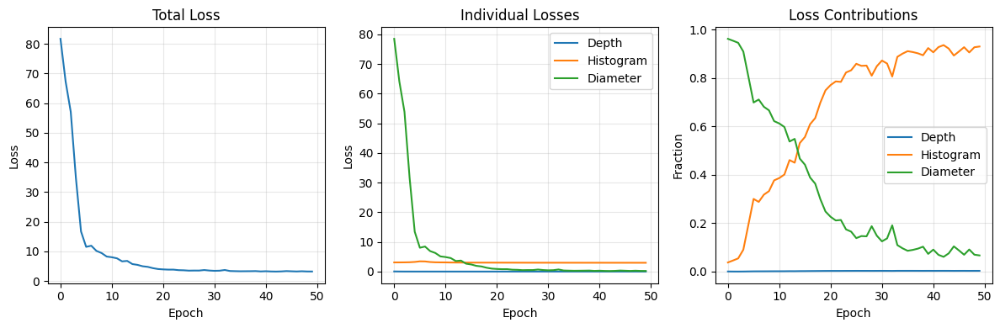

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 8: Run Training
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Start training! Adjust parameters as needed:
"""

# Train the model
final_state, history = train_grainet(
    data_dir="./grainet_dataset",
    output_dir="./grainet_model",
    num_epochs=50,
    batch_size=64,  # Increased for TPU (8 per device with 8 TPU cores)
    learning_rate=1e-4,
    use_attention_pool=True,  # Key: No CLS tokens, use attention!
    loss_weights={
        "depth": 1.0,
        "histogram": 1.0,
        "diameter": 1.0
    },
    save_every=10,
    eval_every=5
)

# Plot training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.plot(history['total_loss'])
plt.title('Total Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 2)
plt.plot(history['depth_loss'], label='Depth')
plt.plot(history['hist_loss'], label='Histogram')
plt.plot(history['diam_loss'], label='Diameter')
plt.title('Individual Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 3)
total = np.array(history['total_loss'])
plt.plot(np.array(history['depth_loss']) / total, label='Depth')
plt.plot(np.array(history['hist_loss']) / total, label='Histogram')
plt.plot(np.array(history['diam_loss']) / total, label='Diameter')
plt.title('Loss Contributions')
plt.xlabel('Epoch')
plt.ylabel('Fraction')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 9: Inference Class
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Create inference wrapper for easy predictions:
"""

class GRAINetPredictor:
    """Inference wrapper for trained model"""

    def __init__(self, checkpoint_path: str):
        """Load model from checkpoint"""
        print(f"Loading model from {checkpoint_path}")

        # Load checkpoint
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params = ckpt["params"].item()
        self.vit_params = ckpt["vit_params"].item()
        self.config = ckpt["config"].item()

        # Create model
        self.model = GRAINetDecoder(
            num_classes=self.config["num_classes"],
            use_attention_pool=self.config["use_attention_pool"]
        )

        # Load ViT
        self.vit_model = FlaxViTModel.from_pretrained(
            "google/vit-base-patch16-224-in21k",
            output_hidden_states=True
        )

        # Load processor
        self.processor = ViTImageProcessor.from_pretrained(
            "google/vit-base-patch16-224-in21k"
        )

        print(f"Model loaded: {self.config['num_classes']} classes, "
              f"{'Attention' if self.config['use_attention_pool'] else 'GAP'} pooling")

    def predict(self, image_path: str) -> Dict[str, np.ndarray]:
        """Predict on single image"""
        # Load and process image
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Get ViT features
        vit_out = self.vit_model(
            pixel_values=pixel_values,
            params=self.vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = self.model.apply(
            self.params,
            vit_out.hidden_states,
            train=False
        )

        # Convert to numpy
        results = {
            "image": image,
            "depth_map": np.array(predictions["depth_map"][0]),
            "histogram": np.array(predictions["histogram"][0]),
            "diameter": float(predictions["diameter"][0, 0])
        }

        if "attention_weights" in predictions:
            results["attention_weights"] = np.array(predictions["attention_weights"][0])

        return results

print("✓ Inference class ready")


✓ Inference class ready


Loading model from ./grainet_model/final_model.npz
Model loaded: 22 classes, Attention pooling

Testing on sample images...

Predicting on ./grainet_dataset/images/image_0000.png...
  Diameter: 5.546 cm
  Mode bin: 19
  Depth range: [0.500, 0.745]


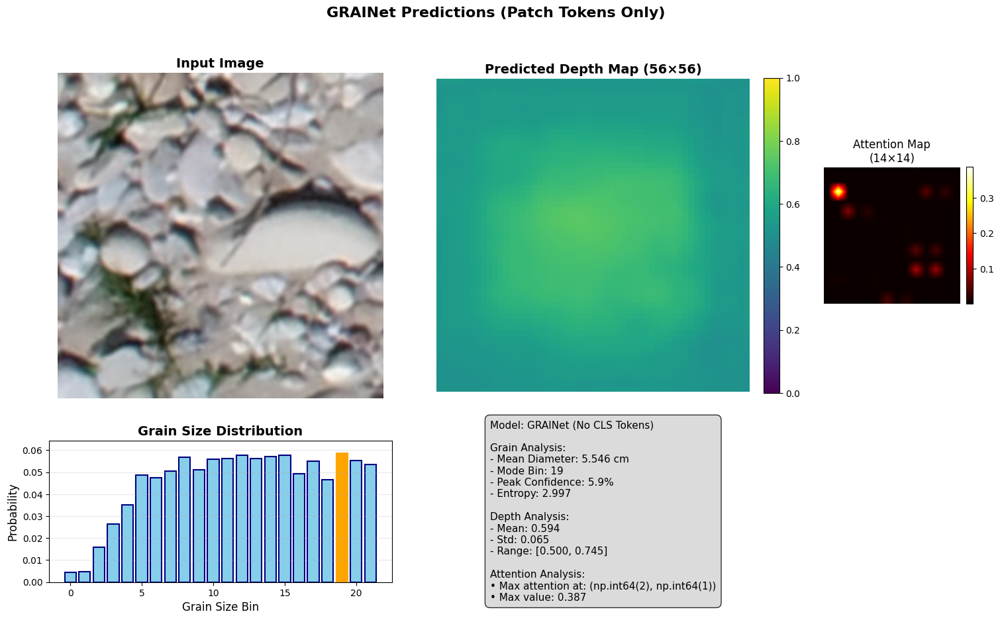


Predicting on ./grainet_dataset/images/image_0010.png...
  Diameter: 4.688 cm
  Mode bin: 19
  Depth range: [0.500, 0.749]


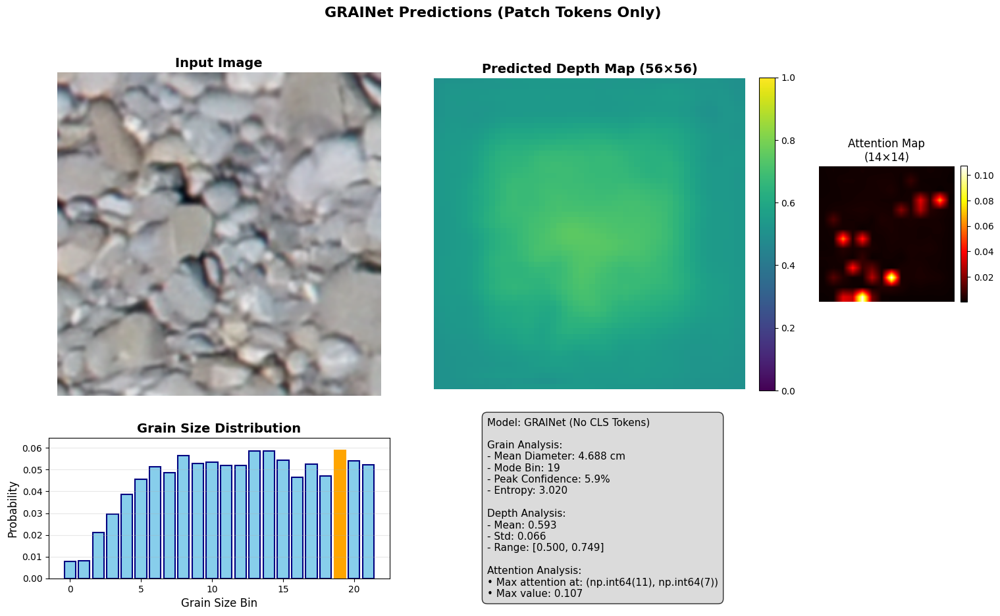


Predicting on ./grainet_dataset/images/image_0020.png...
  Diameter: 9.728 cm
  Mode bin: 13
  Depth range: [0.499, 0.724]


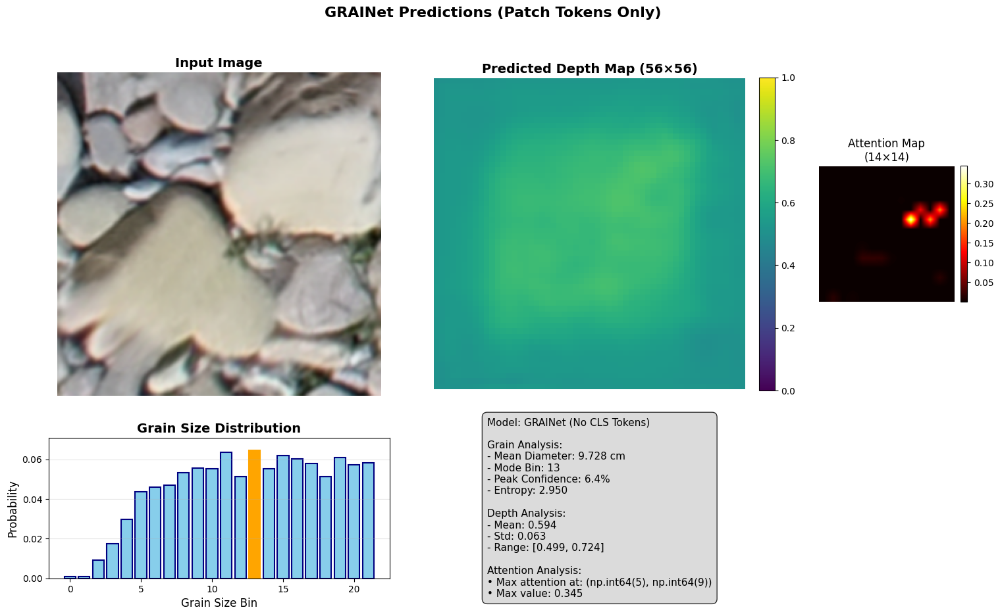

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 10: Test Inference and Visualize (FIXED)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Test the trained model on sample images:
"""

# Load the trained model
predictor = GRAINetPredictor("./grainet_model/final_model.npz")

# Function to visualize predictions
def visualize_prediction(result: Dict[str, np.ndarray], save_path: Optional[str] = None):
    """Comprehensive visualization of predictions"""

    # Check if attention weights are available
    has_attention = "attention_weights" in result

    # Create figure with appropriate layout
    if has_attention:
        fig = plt.figure(figsize=(18, 10))
        gs = fig.add_gridspec(3, 5, hspace=0.3, wspace=0.3)
    else:
        fig = plt.figure(figsize=(16, 10))
        gs = fig.add_gridspec(3, 4, hspace=0.3, wspace=0.3)

    # 1. Original image
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax1.imshow(result["image"])
    ax1.set_title("Input Image", fontsize=14, fontweight='bold')
    ax1.axis('off')

    # 2. Depth map
    ax2 = fig.add_subplot(gs[0:2, 2:4])
    im = ax2.imshow(result["depth_map"], cmap='viridis', vmin=0, vmax=1)
    ax2.set_title("Predicted Depth Map (56×56)", fontsize=14, fontweight='bold')
    ax2.axis('off')
    plt.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)

    # 3. Attention weights (if available)
    if has_attention:
        ax_att = fig.add_subplot(gs[0:2, 4])
        attention = result["attention_weights"].reshape(14, 14)
        im_att = ax_att.imshow(attention, cmap='hot', interpolation='bilinear')
        ax_att.set_title("Attention Map\n(14×14)", fontsize=12)
        ax_att.axis('off')
        plt.colorbar(im_att, ax=ax_att, fraction=0.046, pad=0.04)

    # 4. Histogram
    ax3 = fig.add_subplot(gs[2, 0:2])
    bins = np.arange(len(result["histogram"]))
    bars = ax3.bar(bins, result["histogram"], color='skyblue', edgecolor='navy', linewidth=1.5)

    # Highlight peak
    peak_idx = np.argmax(result["histogram"])
    bars[peak_idx].set_color('orange')

    ax3.set_xlabel("Grain Size Bin", fontsize=12)
    ax3.set_ylabel("Probability", fontsize=12)
    ax3.set_title("Grain Size Distribution", fontsize=14, fontweight='bold')
    ax3.grid(True, alpha=0.3, axis='y')
    ax3.set_ylim(0, max(result["histogram"]) * 1.1)

    # 5. Statistics
    ax4 = fig.add_subplot(gs[2, 2:])
    ax4.axis('off')

    # Calculate statistics
    entropy = -np.sum(result["histogram"] * np.log(result["histogram"] + 1e-9))
    mode_bin = np.argmax(result["histogram"])
    confidence = result["histogram"][mode_bin]

    # Depth statistics
    depth_mean = np.mean(result["depth_map"])
    depth_std = np.std(result["depth_map"])

    stats_text = f"""Model: GRAINet (No CLS Tokens)

Grain Analysis:
- Mean Diameter: {result['diameter']:.3f} cm
- Mode Bin: {mode_bin}
- Peak Confidence: {confidence:.1%}
- Entropy: {entropy:.3f}

Depth Analysis:
- Mean: {depth_mean:.3f}
- Std: {depth_std:.3f}
- Range: [{np.min(result['depth_map']):.3f}, {np.max(result['depth_map']):.3f}]"""

    if has_attention:
        # Add attention statistics
        attention_flat = result["attention_weights"].flatten()
        max_attention_idx = np.argmax(attention_flat)
        max_attention_pos = (max_attention_idx // 14, max_attention_idx % 14)
        stats_text += f"\n\nAttention Analysis:\n• Max attention at: {max_attention_pos}\n• Max value: {attention_flat[max_attention_idx]:.3f}"

    ax4.text(0.1, 0.5, stats_text, fontsize=11, verticalalignment='center',
             bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))

    plt.suptitle("GRAINet Predictions (Patch Tokens Only)", fontsize=16, fontweight='bold')

    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')

    plt.show()

# Test on multiple samples
print("\nTesting on sample images...")
sample_images = [
    "./grainet_dataset/images/image_0000.png",
    "./grainet_dataset/images/image_0010.png",
    "./grainet_dataset/images/image_0020.png"
]

for i, img_path in enumerate(sample_images[:3]):
    if os.path.exists(img_path):
        print(f"\nPredicting on {img_path}...")
        result = predictor.predict(img_path)

        print(f"  Diameter: {result['diameter']:.3f} cm")
        print(f"  Mode bin: {np.argmax(result['histogram'])}")
        print(f"  Depth range: [{result['depth_map'].min():.3f}, {result['depth_map'].max():.3f}]")

        visualize_prediction(result, save_path=f"prediction_{i}.png")

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 11: Summary and Next Steps
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
## Training Complete! 🎉

You've successfully trained GRAINet without CLS tokens on TPU.

### Key Points:
1. **No CLS Tokens**: All features come from spatial patch tokens
2. **Attention Pooling**: Learns which regions are important
3. **Multi-Output**: Predicts depth, histogram, and diameter
4. **TPU Optimized**: Efficient training on Google's TPUs

### Model Architecture:
```
Input → ViT → Extract Patches (No CLS) → Shared Conv →
    ├── Depth Branch → 56×56 depth map
    └── Attention Pool → Histogram & Diameter
```

### Next Steps:
1. **Adjust Loss Weights**: If one task dominates, modify weights
2. **Try GAP**: Set `use_attention_pool=False` for comparison
3. **Fine-tune ViT**: Unfreeze ViT params for better performance
4. **Real Depth Data**: Replace synthetic depth with real annotations
5. **Deploy Model**: Export for production use

### Files Created:
- `./grainet_dataset/`: Organized training data
- `./grainet_model/`: Saved checkpoints and final model
- `prediction_*.png`: Visualization of results

### Tips:
- For larger batches on TPU, increase `batch_size` to 64 or 128
- Monitor attention maps to understand model focus
- Use the predictor class for easy inference

Happy grain analysis! 🌾
"""

print("\n" + "="*60)
print("TRAINING COMPLETE!")
print("="*60)
print(f"\nFinal model saved to: ./grainet_model/final_model.npz")
print(f"Total epochs trained: {len(history['total_loss'])}")
print(f"Final total loss: {history['total_loss'][-1]:.4f}")
print(f"\nModel uses spatial features only (no CLS tokens)")
print(f"Pooling method: {'Attention' if final_state.apply_fn.keywords['use_attention_pool'] else 'GAP'}")
print("\n✓ Ready for inference!")


TRAINING COMPLETE!

Final model saved to: ./grainet_model/final_model.npz
Total epochs trained: 50
Final total loss: 3.2039

Model uses spatial features only (no CLS tokens)


AttributeError: 'function' object has no attribute 'keywords'

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 1: Setup TPU and Install Dependencies
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
# GRAINet Training on TPU (No CLS Tokens)

## First, enable TPU:
1. Runtime → Change runtime type
2. Hardware accelerator → TPU
3. Save

Then run this cell to install dependencies:
"""

# Install JAX with TPU support
!pip install --upgrade jax[tpu] -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --upgrade flax optax transformers pillow scikit-image matplotlib tqdm

# Setup TPU
import jax
try:
    import jax.tools.colab_tpu
    jax.tools.colab_tpu.setup_tpu()
except:
    pass

print(f"JAX version: {jax.__version__}")
print(f"Devices: {jax.devices()}")
print(f"Device count: {jax.local_device_count()}")

Looking in links: https://storage.googleapis.com/jax-releases/libtpu_releases.html
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 24.9 MB/s eta 0:00:00
  Attempting uninstall: libtpu
    Found existing installation: libtpu 0.0.7.1
    Uninstalling libtpu-0.0.7.1:
      Successfully uninstalled libtpu-0.0.7.1
  Attempting uninstall: jaxlib
    Found existing installation: jaxlib 0.5.1
    Uninstalling jaxlib-0.5.1:
      Successfully uninstalled jaxlib-0.5.1
  Attempting uninstall: jax
    Found existing installation: jax 0.5.2
    Uninstalling jax-0.5.2:
      Successfully uninstalled jax-0.5.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 90.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 75.4 MB/s eta 0:00

--2025-05-29 21:38:56--  https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
Resolving share.phys.ethz.ch (share.phys.ethz.ch)... 129.132.80.27, 2001:67c:10ec:3dc4::39
Connecting to share.phys.ethz.ch (share.phys.ethz.ch)|129.132.80.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 840559012 (802M) [application/zip]
Saving to: ‘GRAINet_demo_data.zip’

GRAINet_demo_data.z 100%[===================>] 801.62M  28.1MB/s    in 30s     

2025-05-29 21:39:26 (26.6 MB/s) - ‘GRAINet_demo_data.zip’ saved [840559012/840559012]

Contents of /content/data_GRAINet_demo/data_KLEmme_1bank.npz:
--------------------------------------------------
• images
  Shape: (212, 500, 200, 3)
  Data type: float32
• histograms
  Shape: (212, 22)
  Data type: float32
• tile_names
  Shape: (212,)
  Data type: object
• dm
  Shape: (212,)
  Data type: float32
--------------------------------------------------


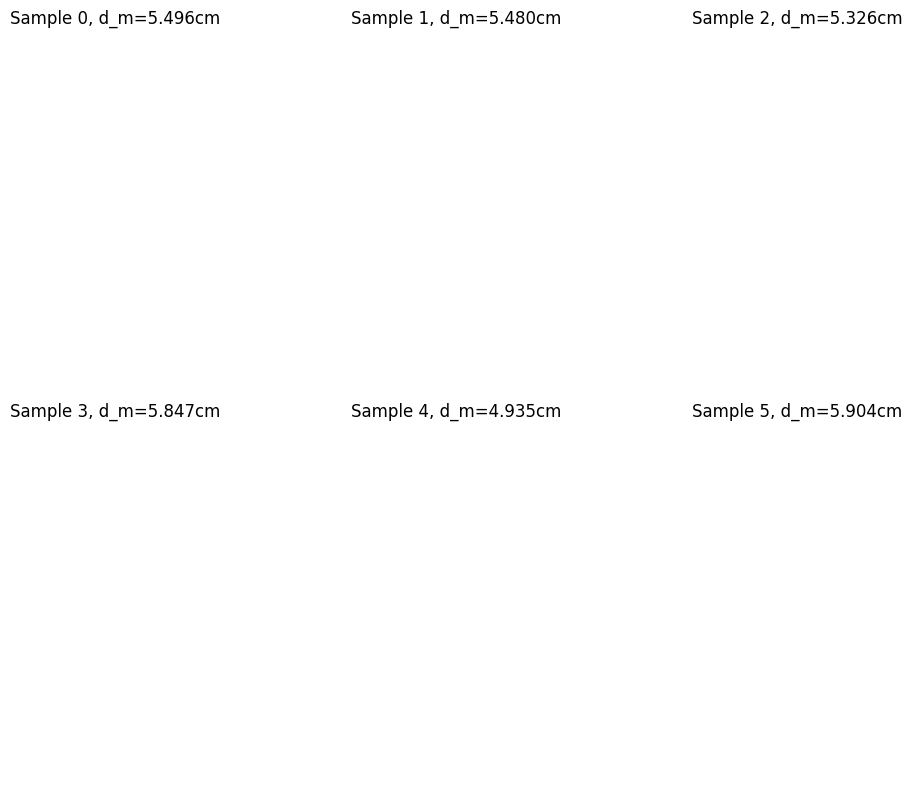

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 2: Download and Extract Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Download and prepare the GRAINet demo data:
"""

import os
import json
import numpy as np
from PIL import Image
from skimage.transform import resize
from tqdm import tqdm
import matplotlib.pyplot as plt

# Download the demo data
!wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
!unzip -q -o GRAINet_demo_data.zip

# View NPZ contents first
def inspect_npz(npz_path):
    """Inspect the NPZ file contents"""
    data = np.load(npz_path, allow_pickle=True)
    print(f"Contents of {npz_path}:")
    print("-" * 50)
    for key in data.files:
        array = data[key]
        print(f"• {key}")
        print(f"  Shape: {array.shape}")
        print(f"  Data type: {array.dtype}")
        if array.size < 10:
            print(f"  Values: {array}")
    print("-" * 50)
    return data

# Inspect the data
npz_path = "/content/data_GRAINet_demo/data_KLEmme_1bank.npz"
data = inspect_npz(npz_path)

# Visualize some samples
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i in range(6):
    ax = axes[i//3, i%3]
    ax.imshow(data['images'][i])
    ax.set_title(f"Sample {i}, d_m={data['dm'][i]:.3f}cm")
    ax.axis('off')
plt.tight_layout()
plt.show()


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 3: Extract and Organize Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Extract data into organized directories for training:
"""

def extract_and_organize_data(npz_path, output_dir, target_size=(224, 224)):
    """Extract data from NPZ and organize for training"""

    # Create directories
    os.makedirs(output_dir, exist_ok=True)
    for subdir in ["images", "histograms", "mean_diameters"]:
        os.makedirs(os.path.join(output_dir, subdir), exist_ok=True)

    # Load data
    print(f"Loading data from {npz_path}...")
    data = np.load(npz_path, allow_pickle=True)

    images = data['images']
    histograms = data['histograms'] if 'histograms' in data else None
    diameters = data['dm'] if 'dm' in data else None

    num_samples = len(images)
    print(f"Processing {num_samples} samples...")

    # Metadata
    metadata = {
        "num_samples": num_samples,
        "sample_mapping": {},
        "histogram_bins": histograms.shape[-1] if histograms is not None else None
    }

    # Process each sample
    for i in tqdm(range(num_samples), desc="Extracting"):
        # Process image
        img = images[i]
        h, w = img.shape[:2]

        # Center crop to square
        if w != h:
            size = min(w, h)
            start_w = (w - size) // 2
            start_h = (h - size) // 2
            img = img[start_h:start_h+size, start_w:start_w+size]

        # Resize to target size
        img_resized = resize(img, target_size, anti_aliasing=True, preserve_range=True)
        img_pil = Image.fromarray(img_resized.astype(np.uint8))

        # Save files
        img_name = f"image_{i:04d}.png"
        hist_name = f"hist_{i:04d}.npy"
        dm_name = f"dm_{i:04d}.npy"

        img_pil.save(os.path.join(output_dir, "images", img_name))

        if histograms is not None:
            np.save(os.path.join(output_dir, "histograms", hist_name), histograms[i])

        if diameters is not None:
            np.save(os.path.join(output_dir, "mean_diameters", dm_name), diameters[i])

        metadata["sample_mapping"][str(i)] = {
            "image": img_name,
            "histogram": hist_name,
            "mean_diameter": dm_name
        }

    # Save metadata
    with open(os.path.join(output_dir, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=2)

    print(f"✓ Data extracted to {output_dir}")
    return metadata

# Extract the data
output_dir = "./grainet_dataset"
metadata = extract_and_organize_data(npz_path, output_dir)

print(f"\nDataset ready:")
print(f"  Samples: {metadata['num_samples']}")
print(f"  Histogram bins: {metadata['histogram_bins']}")


Loading data from /content/data_GRAINet_demo/data_KLEmme_1bank.npz...
Processing 212 samples...


Extracting: 100%|██████████| 212/212 [00:06<00:00, 33.10it/s]

✓ Data extracted to ./grainet_dataset

Dataset ready:
  Samples: 212
  Histogram bins: 22


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 4: Define Model Architecture (No CLS Tokens)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define the GRAINet model that uses only patch tokens:
"""

import jax
import jax.numpy as jnp
import flax.linen as nn
from typing import Tuple, Dict, Optional

# Compatibility fix for JAX API changes
if not hasattr(jax, 'tree_map'):
    jax.tree_map = jax.tree_util.tree_map
if not hasattr(jax, 'tree_leaves'):
    jax.tree_leaves = jax.tree_util.tree_leaves

class SpatialAttentionPool(nn.Module):
    """Attention-based spatial pooling to aggregate patch features"""

    @nn.compact
    def __call__(self, x: jnp.ndarray) -> jnp.ndarray:
        B, H, W, C = x.shape

        # Flatten spatial dimensions
        x_flat = x.reshape(B, H * W, C)  # [B, HW, C]

        # Compute attention weights
        attn_logits = nn.Dense(1, name='attention')(x_flat)  # [B, HW, 1]
        attn_weights = nn.softmax(attn_logits, axis=1)

        # Weighted average pooling
        pooled = jnp.sum(x_flat * attn_weights, axis=1)  # [B, C]

        return pooled, attn_weights  # Return weights for visualization

class GRAINetDecoder(nn.Module):
    """Decoder using only patch tokens - no CLS tokens"""
    num_classes: int = 21
    feature_layers: Tuple[int, ...] = (3, 5, 7, 11)
    use_attention_pool: bool = True

    @nn.compact
    def __call__(self, hidden_states: list, train: bool = True) -> Dict[str, jnp.ndarray]:
        # Extract patch tokens from specified layers
        patch_features = []
        for layer_idx in self.feature_layers:
            features = hidden_states[layer_idx]  # [B, 197, 768]

            # Remove CLS token (position 0) - THIS IS KEY!
            patch_tokens = features[:, 1:, :]  # [B, 196, 768]

            # Reshape to spatial
            B = patch_tokens.shape[0]
            patches_2d = patch_tokens.reshape(B, 14, 14, 768)
            patch_features.append(patches_2d)

        # Concatenate features from all layers
        combined = jnp.concatenate(patch_features, axis=-1)  # [B, 14, 14, 3072]

        # Shared spatial processing
        x = nn.Conv(512, kernel_size=(3, 3), padding='SAME', name='shared_conv')(combined)
        x = nn.GroupNorm(num_groups=32, name='shared_gn')(x)
        x = nn.gelu(x)
        x = nn.Dropout(rate=0.1, deterministic=not train)(x)

        # Branch 1: Depth map
        depth = x

        # Additional processing
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv1')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn1')(depth)
        depth = nn.gelu(depth)

        # Upsample 14x14 -> 28x28
        depth = jax.image.resize(depth, (depth.shape[0], 28, 28, depth.shape[3]), method='bilinear')
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv2')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn2')(depth)
        depth = nn.gelu(depth)

        # Upsample 28x28 -> 56x56
        depth = jax.image.resize(depth, (depth.shape[0], 56, 56, depth.shape[3]), method='bilinear')
        depth = nn.Conv(128, kernel_size=(3, 3), padding='SAME', name='depth_conv3')(depth)
        depth = nn.GroupNorm(num_groups=8, name='depth_gn3')(depth)
        depth = nn.gelu(depth)

        # Final depth prediction
        depth_map = nn.Conv(1, kernel_size=(1, 1), name='depth_final')(depth)
        depth_map = nn.sigmoid(depth_map).squeeze(-1)  # [B, 56, 56]

        # Branch 2: Global predictions (histogram & diameter)
        # Additional conv for global features
        global_features = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='global_conv')(x)
        global_features = nn.GroupNorm(num_groups=16, name='global_gn')(global_features)
        global_features = nn.gelu(global_features)

        # Spatial aggregation
        if self.use_attention_pool:
            pooling = SpatialAttentionPool()
            pooled_features, attention_weights = pooling(global_features)
        else:
            # Global Average Pooling
            pooled_features = jnp.mean(global_features, axis=(1, 2))
            attention_weights = None

        # Shared MLP
        mlp = nn.Dense(512, name='mlp_fc1')(pooled_features)
        mlp = nn.gelu(mlp)
        mlp = nn.Dropout(rate=0.2, deterministic=not train)(mlp)
        mlp = nn.Dense(256, name='mlp_fc2')(mlp)
        mlp = nn.gelu(mlp)

        # Histogram head
        hist = nn.Dense(128, name='hist_fc1')(mlp)
        hist = nn.gelu(hist)
        histogram = nn.Dense(self.num_classes, name='hist_fc2')(hist)
        histogram = nn.softmax(histogram)

        # Diameter head
        diam = nn.Dense(64, name='diam_fc1')(mlp)
        diam = nn.gelu(diam)
        diameter = nn.Dense(1, name='diam_fc2')(diam)

        outputs = {
            "depth_map": depth_map,
            "histogram": histogram,
            "diameter": diameter
        }

        if attention_weights is not None:
            outputs["attention_weights"] = attention_weights

        return outputs

print("✓ Model architecture defined (No CLS tokens)")

# Test model creation
rng = jax.random.PRNGKey(0)
model = GRAINetDecoder(num_classes=21, use_attention_pool=True)
dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
params = model.init(rng, dummy_hidden, train=False)

param_count = sum(x.size for x in jax.tree_util.tree_leaves(params))
print(f"✓ Model parameters: {param_count:,}")

✓ Model architecture defined (No CLS tokens)
✓ Model parameters: 17,719,448


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 5: Setup Training Components
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Setup loss functions, data loading, and training utilities:
"""

from functools import partial
from pathlib import Path
import time

import flax
from flax.training import train_state
from flax import jax_utils
import optax
from transformers import FlaxViTModel, ViTImageProcessor

# Loss functions
def compute_losses(predictions: Dict[str, jnp.ndarray],
                   targets: Dict[str, jnp.ndarray],
                   weights: Dict[str, float]) -> Tuple[jnp.ndarray, Dict[str, jnp.ndarray]]:
    """Compute multi-task losses"""

    # Depth loss (MSE)
    depth_loss = jnp.mean((predictions["depth_map"] - targets["depth_map"]) ** 2)

    # Histogram loss (KL divergence)
    hist_loss = -jnp.mean(
        jnp.sum(targets["histogram"] * jnp.log(predictions["histogram"] + 1e-9), axis=-1)
    )

    # Diameter loss (MSE)
    diam_loss = jnp.mean((predictions["diameter"].squeeze() - targets["diameter"]) ** 2)

    # Weighted total
    total_loss = (
        weights["depth"] * depth_loss +
        weights["histogram"] * hist_loss +
        weights["diameter"] * diam_loss
    )

    metrics = {
        "total_loss": total_loss,
        "depth_loss": depth_loss,
        "hist_loss": hist_loss,
        "diam_loss": diam_loss
    }

    return total_loss, metrics

# Data loader
class GRAINetDataLoader:
    """Efficient data loader for training"""

    def __init__(self, data_dir: str, batch_size: int, processor):
        self.data_dir = Path(data_dir)
        self.batch_size = batch_size
        self.processor = processor

        # Load metadata
        with open(self.data_dir / "metadata.json", "r") as f:
            self.metadata = json.load(f)

        self.num_samples = self.metadata["num_samples"]
        self.indices = np.arange(self.num_samples)

    def generate_depth_map(self, idx: int) -> np.ndarray:
        """Generate synthetic depth map (placeholder - replace with real depth data)"""
        np.random.seed(idx)
        x = np.linspace(-1, 1, 56)
        y = np.linspace(-1, 1, 56)
        xx, yy = np.meshgrid(x, y)

        # Create some structure
        depth = 0.5 + 0.3 * np.exp(-(xx**2 + yy**2) / 0.5)
        depth += 0.1 * np.random.randn(56, 56)
        depth = np.clip(depth, 0, 1).astype(np.float32)

        return depth

    def get_batch(self) -> Tuple[np.ndarray, Dict[str, np.ndarray]]:
        """Get a random batch"""
        # Sample indices
        batch_idx = np.random.choice(self.indices, self.batch_size, replace=False)

        images = []
        targets = {
            "histogram": [],
            "diameter": [],
            "depth_map": []
        }

        for idx in batch_idx:
            mapping = self.metadata["sample_mapping"][str(idx)]

            # Load image
            img_path = self.data_dir / "images" / mapping["image"]
            image = Image.open(img_path).convert("RGB")
            images.append(image)

            # Load histogram
            hist_path = self.data_dir / "histograms" / mapping["histogram"]
            histogram = np.load(hist_path).astype(np.float32)
            histogram = histogram / (histogram.sum() + 1e-9)  # Normalize
            targets["histogram"].append(histogram)

            # Load diameter
            diam_path = self.data_dir / "mean_diameters" / mapping["mean_diameter"]
            diameter = np.load(diam_path).astype(np.float32)
            targets["diameter"].append(diameter)

            # Generate depth map (synthetic for demo)
            depth = self.generate_depth_map(idx)
            targets["depth_map"].append(depth)

        # Process images
        inputs = self.processor(images=images, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Stack targets
        for key in targets:
            targets[key] = np.stack(targets[key])

        return pixel_values, targets

print("✓ Training components ready")


✓ Training components ready


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 6: Training Step Functions
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define training and evaluation steps:
"""

# Create training step function with closed-over variables
def create_train_step(vit_model, loss_weights):
    """Create training step with static arguments"""

    @partial(jax.pmap, axis_name='batch', donate_argnums=(0,))
    def train_step(state, batch, dropout_rng, vit_params):
        """Single training step"""

        images, targets = batch
        dropout_rng, new_dropout_rng = jax.random.split(dropout_rng)

        def loss_fn(params):
            # Get ViT features
            vit_out = vit_model(
                pixel_values=images,
                params=vit_params,
                output_hidden_states=True
            )

            # Decoder predictions
            predictions = state.apply_fn(
                params,
                vit_out.hidden_states,
                train=True,
                rngs={'dropout': dropout_rng}
            )

            # Compute losses
            loss, metrics = compute_losses(predictions, targets, loss_weights)

            return loss, metrics

        # Compute gradients
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(state.params)

        # Average across devices
        grads = jax.lax.pmean(grads, axis_name='batch')
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        # Update state
        state = state.apply_gradients(grads=grads)

        return state, metrics, new_dropout_rng

    return train_step

# Create evaluation step function
def create_eval_step(vit_model, loss_weights):
    """Create evaluation step with static arguments"""

    @partial(jax.pmap, axis_name='batch')
    def eval_step(state, batch, vit_params):
        """Evaluation step"""

        images, targets = batch

        # Get ViT features
        vit_out = vit_model(
            pixel_values=images,
            params=vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = state.apply_fn(
            state.params,
            vit_out.hidden_states,
            train=False
        )

        # Compute metrics
        _, metrics = compute_losses(predictions, targets, loss_weights)

        # Average across devices
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        return metrics, predictions

    return eval_step

print("✓ Training functions defined")

✓ Training functions defined


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 7: Main Training Function
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Main training loop:
"""

def train_grainet(
    data_dir: str = "./grainet_dataset",
    output_dir: str = "./grainet_model",
    num_epochs: int = 50,
    batch_size: int = 32,
    learning_rate: float = 1e-4,
    use_attention_pool: bool = True,
    loss_weights: Optional[Dict[str, float]] = None,
    save_every: int = 10,
    eval_every: int = 5,
    seed: int = 42
):
    """Train GRAINet model"""

    # Setup
    np.random.seed(seed)
    rng = jax.random.PRNGKey(seed)

    if loss_weights is None:
        loss_weights = {"depth": 1.0, "histogram": 1.0, "diameter": 1.0}

    # Create output directory
    os.makedirs(output_dir, exist_ok=True)

    # Device setup
    num_devices = jax.local_device_count()
    print(f"Training on {num_devices} devices")

    # Adjust batch size for devices - ensure minimum batch size per device
    min_batch_per_device = 2  # Minimum samples per device
    if batch_size < num_devices * min_batch_per_device:
        batch_size = num_devices * min_batch_per_device
        print(f"Increased batch size to {batch_size} (minimum {min_batch_per_device} per device)")

    if batch_size % num_devices != 0:
        batch_size = (batch_size // num_devices) * num_devices
        print(f"Adjusted batch size to {batch_size} for {num_devices} devices")

    batch_size_per_device = batch_size // num_devices

    # Load ViT and processor
    print("Loading ViT model...")
    vit_model = FlaxViTModel.from_pretrained(
        "google/vit-base-patch16-224-in21k",
        output_hidden_states=True
    )
    vit_params = vit_model.params
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

    # Create data loader
    data_loader = GRAINetDataLoader(data_dir, batch_size, processor)

    # Detect number of classes
    sample_hist = np.load(Path(data_dir) / "histograms" / "hist_0000.npy")
    num_classes = len(sample_hist)
    print(f"Detected {num_classes} histogram bins")

    # Create model
    model = GRAINetDecoder(num_classes=num_classes, use_attention_pool=use_attention_pool)

    # Initialize parameters
    rng, init_rng = jax.random.split(rng)
    dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
    params = model.init(init_rng, dummy_hidden, train=False)

    # Create optimizer
    tx = optax.chain(
        optax.clip_by_global_norm(1.0),
        optax.adamw(learning_rate=learning_rate, weight_decay=1e-5)
    )

    # Create train state
    state = train_state.TrainState.create(
        apply_fn=model.apply,
        params=params,
        tx=tx
    )

    # Replicate across devices
    state = jax_utils.replicate(state)
    vit_params_replicated = jax_utils.replicate(vit_params)

    # Setup dropout RNG
    rng, dropout_rng = jax.random.split(rng)
    dropout_rngs = jax.random.split(dropout_rng, num_devices)

    # Training metrics
    steps_per_epoch = data_loader.num_samples // batch_size
    total_steps = num_epochs * steps_per_epoch

    print(f"\nTraining Configuration:")
    print(f"  Epochs: {num_epochs}")
    print(f"  Batch size: {batch_size} ({batch_size_per_device} per device)")
    print(f"  Steps per epoch: {steps_per_epoch}")
    print(f"  Total steps: {total_steps}")
    print(f"  Learning rate: {learning_rate}")
    print(f"  Pooling: {'Attention' if use_attention_pool else 'GAP'}")
    print(f"  Loss weights: {loss_weights}")

    # Create training and evaluation functions
    train_step = create_train_step(vit_model, loss_weights)
    eval_step = create_eval_step(vit_model, loss_weights)

    # Training history
    history = {
        "total_loss": [],
        "depth_loss": [],
        "hist_loss": [],
        "diam_loss": []
    }

    # Training loop
    print("\nStarting training...")
    step = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        # Training
        epoch_metrics = []
        pbar = tqdm(range(steps_per_epoch), desc="Training")

        for _ in pbar:
            # Get batch
            images, targets = data_loader.get_batch()

            # Reshape for devices
            images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
            targets = jax.tree_util.tree_map(
                lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                targets
            )

            batch = (images, targets)

            # Training step
            state, metrics, dropout_rngs = train_step(
                state, batch, dropout_rngs, vit_params_replicated
            )

            # Update metrics
            metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)  # Get from first device
            epoch_metrics.append(metrics)

            # Update progress bar
            avg_metrics = jax.tree_util.tree_map(
                lambda *xs: np.mean(xs),
                *epoch_metrics[-100:]  # Last 100 steps
            )
            pbar.set_postfix({
                "loss": f"{avg_metrics['total_loss']:.4f}",
                "depth": f"{avg_metrics['depth_loss']:.4f}",
                "hist": f"{avg_metrics['hist_loss']:.4f}",
                "diam": f"{avg_metrics['diam_loss']:.4f}"
            })

            step += 1

        # Record epoch metrics
        epoch_avg = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *epoch_metrics)
        for key in history:
            history[key].append(epoch_avg[key])

        # Evaluation
        if (epoch + 1) % eval_every == 0:
            print("\nEvaluating...")
            eval_metrics = []

            for _ in range(10):  # 10 eval batches
                images, targets = data_loader.get_batch()
                images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
                targets = jax.tree_util.tree_map(
                    lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                    targets
                )

                metrics, predictions = eval_step(
                    state, (images, targets), vit_params_replicated
                )
                metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)
                eval_metrics.append(metrics)

            avg_eval = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *eval_metrics)
            print(f"Eval - Loss: {avg_eval['total_loss']:.4f}, "
                  f"Depth: {avg_eval['depth_loss']:.4f}, "
                  f"Hist: {avg_eval['hist_loss']:.4f}, "
                  f"Diam: {avg_eval['diam_loss']:.4f}")

        # Save checkpoint
        if (epoch + 1) % save_every == 0:
            print(f"Saving checkpoint at epoch {epoch + 1}...")

            # Unreplicate state
            save_state = jax_utils.unreplicate(state)
            save_vit_params = jax_utils.unreplicate(vit_params_replicated)

            # Save
            ckpt_path = os.path.join(output_dir, f"checkpoint_{epoch + 1}.npz")
            np.savez(
                ckpt_path,
                params=save_state.params,
                vit_params=save_vit_params,
                config={
                    "num_classes": num_classes,
                    "use_attention_pool": use_attention_pool,
                    "loss_weights": loss_weights,
                    "epoch": epoch + 1
                },
                history=history
            )
            print(f"✓ Saved checkpoint: {ckpt_path}")

    print("\n✓ Training complete!")

    # Save final model
    final_state = jax_utils.unreplicate(state)
    final_vit_params = jax_utils.unreplicate(vit_params_replicated)

    final_path = os.path.join(output_dir, "final_model.npz")
    np.savez(
        final_path,
        params=final_state.params,
        vit_params=final_vit_params,
        config={
            "num_classes": num_classes,
            "use_attention_pool": use_attention_pool,
            "loss_weights": loss_weights,
            "epochs": num_epochs
        },
        history=history
    )
    print(f"✓ Saved final model: {final_path}")

    return final_state, history

Training on 8 devices
Loading ViT model...
Detected 22 histogram bins

Training Configuration:
  Epochs: 50
  Batch size: 64 (8 per device)
  Steps per epoch: 3
  Total steps: 150
  Learning rate: 0.0001
  Pooling: Attention
  Loss weights: {'depth': 1.0, 'histogram': 1.0, 'diameter': 1.0}

Starting training...

Epoch 1/50


Training: 100%|██████████| 3/3 [00:24<00:00,  8.28s/it, loss=81.6765, depth=0.0508, hist=3.0952, diam=78.5305]



Epoch 2/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=67.2998, depth=0.0260, hist=3.1009, diam=64.1729]



Epoch 3/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.00it/s, loss=57.0482, depth=0.0173, hist=3.1181, diam=53.9128]



Epoch 4/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=34.8203, depth=0.0166, hist=3.1529, diam=31.6509]



Epoch 5/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.93it/s, loss=16.7129, depth=0.0138, hist=3.2575, diam=13.4415]



Evaluating...
Eval - Loss: 9.9114, Depth: 0.0141, Hist: 3.3572, Diam: 6.5402

Epoch 6/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=11.5187, depth=0.0135, hist=3.4587, diam=8.0465]



Epoch 7/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.86it/s, loss=11.8960, depth=0.0151, hist=3.4259, diam=8.4549]



Epoch 8/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=10.1619, depth=0.0135, hist=3.2292, diam=6.9192]



Epoch 9/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=9.4323, depth=0.0137, hist=3.1359, diam=6.2827]



Epoch 10/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s, loss=8.2497, depth=0.0128, hist=3.1093, diam=5.1276]



Evaluating...
Eval - Loss: 8.0354, Depth: 0.0126, Hist: 3.0483, Diam: 4.9745
Saving checkpoint at epoch 10...
✓ Saved checkpoint: ./grainet_model/checkpoint_10.npz

Epoch 11/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=8.0163, depth=0.0125, hist=3.0981, diam=4.9057]



Epoch 12/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=7.6503, depth=0.0124, hist=3.0678, diam=4.5701]



Epoch 13/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=6.6282, depth=0.0124, hist=3.0537, diam=3.5621]



Epoch 14/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=6.7724, depth=0.0121, hist=3.0468, diam=3.7134]



Epoch 15/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=5.7137, depth=0.0122, hist=3.0344, diam=2.6672]



Evaluating...
Eval - Loss: 5.1704, Depth: 0.0119, Hist: 2.9899, Diam: 2.1686

Epoch 16/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=5.4423, depth=0.0120, hist=3.0264, diam=2.4039]



Epoch 17/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=4.9747, depth=0.0121, hist=3.0283, diam=1.9343]



Epoch 18/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=4.7689, depth=0.0122, hist=3.0237, diam=1.7330]



Epoch 19/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=4.3348, depth=0.0119, hist=3.0253, diam=1.2977]



Epoch 20/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=4.0387, depth=0.0118, hist=3.0239, diam=1.0030]



Evaluating...
Eval - Loss: 3.6424, Depth: 0.0116, Hist: 2.9818, Diam: 0.6490
Saving checkpoint at epoch 20...
✓ Saved checkpoint: ./grainet_model/checkpoint_20.npz

Epoch 21/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.9150, depth=0.0117, hist=3.0169, diam=0.8864]



Epoch 22/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.8390, depth=0.0116, hist=3.0160, diam=0.8114]



Epoch 23/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=3.8414, depth=0.0116, hist=3.0104, diam=0.8194]



Epoch 24/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.6641, depth=0.0116, hist=3.0134, diam=0.6392]



Epoch 25/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=3.6135, depth=0.0115, hist=3.0053, diam=0.5968]



Evaluating...
Eval - Loss: 3.2378, Depth: 0.0113, Hist: 2.9710, Diam: 0.2554

Epoch 26/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.4984, depth=0.0114, hist=3.0028, diam=0.4842]



Epoch 27/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.5277, depth=0.0114, hist=2.9983, diam=0.5180]



Epoch 28/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.5224, depth=0.0113, hist=2.9974, diam=0.5136]



Epoch 29/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=3.7022, depth=0.0116, hist=2.9961, diam=0.6945]



Epoch 30/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.18it/s, loss=3.5283, depth=0.0114, hist=2.9933, diam=0.5236]



Evaluating...
Eval - Loss: 3.1893, Depth: 0.0111, Hist: 2.9667, Diam: 0.2115
Saving checkpoint at epoch 30...
✓ Saved checkpoint: ./grainet_model/checkpoint_30.npz

Epoch 31/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.4367, depth=0.0112, hist=2.9959, diam=0.4296]



Epoch 32/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.4822, depth=0.0112, hist=2.9930, diam=0.4781]



Epoch 33/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=3.7171, depth=0.0113, hist=2.9947, diam=0.7112]



Epoch 34/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3713, depth=0.0113, hist=2.9905, diam=0.3694]



Epoch 35/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3203, depth=0.0112, hist=2.9891, diam=0.3200]



Evaluating...
Eval - Loss: 3.0696, Depth: 0.0111, Hist: 2.9640, Diam: 0.0946

Epoch 36/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.98it/s, loss=3.2826, depth=0.0112, hist=2.9889, diam=0.2826]



Epoch 37/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.2955, depth=0.0112, hist=2.9887, diam=0.2957]



Epoch 38/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.3093, depth=0.0110, hist=2.9840, diam=0.3143]



Epoch 39/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.3412, depth=0.0109, hist=2.9860, diam=0.3442]



Epoch 40/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.2312, depth=0.0108, hist=2.9835, diam=0.2369]



Evaluating...
Eval - Loss: 3.0791, Depth: 0.0107, Hist: 2.9614, Diam: 0.1070
Saving checkpoint at epoch 40...
✓ Saved checkpoint: ./grainet_model/checkpoint_40.npz

Epoch 41/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2969, depth=0.0108, hist=2.9865, diam=0.2996]



Epoch 42/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.2176, depth=0.0107, hist=2.9835, diam=0.2234]



Epoch 43/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.1867, depth=0.0108, hist=2.9813, diam=0.1946]



Epoch 44/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.2349, depth=0.0108, hist=2.9803, diam=0.2439]



Epoch 45/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.3414, depth=0.0108, hist=2.9820, diam=0.3487]



Evaluating...
Eval - Loss: 3.1965, Depth: 0.0106, Hist: 2.9610, Diam: 0.2248

Epoch 46/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2768, depth=0.0108, hist=2.9793, diam=0.2868]



Epoch 47/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2170, depth=0.0107, hist=2.9820, diam=0.2243]



Epoch 48/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2882, depth=0.0107, hist=2.9769, diam=0.3006]



Epoch 49/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.2143, depth=0.0107, hist=2.9786, diam=0.2250]



Epoch 50/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2039, depth=0.0106, hist=2.9788, diam=0.2145]



Evaluating...
Eval - Loss: 3.0236, Depth: 0.0105, Hist: 2.9599, Diam: 0.0532
Saving checkpoint at epoch 50...
✓ Saved checkpoint: ./grainet_model/checkpoint_50.npz

✓ Training complete!
✓ Saved final model: ./grainet_model/final_model.npz


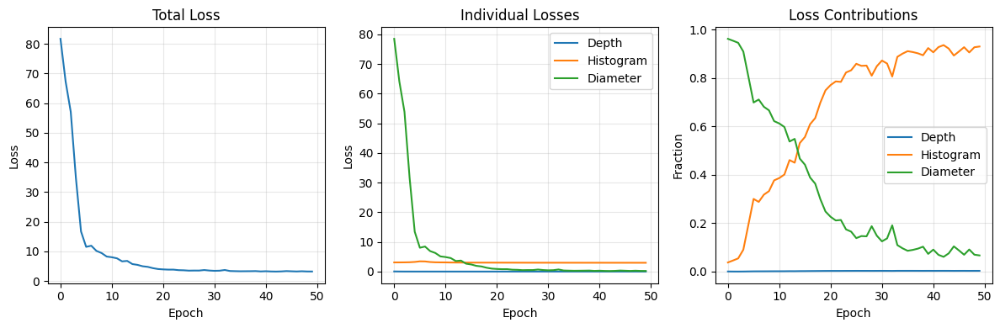

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 8: Run Training
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Start training! Adjust parameters as needed:
"""

# Train the model
final_state, history = train_grainet(
    data_dir="./grainet_dataset",
    output_dir="./grainet_model",
    num_epochs=50,
    batch_size=64,  # Increased for TPU (8 per device with 8 TPU cores)
    learning_rate=1e-4,
    use_attention_pool=True,  # Key: No CLS tokens, use attention!
    loss_weights={
        "depth": 1.0,
        "histogram": 1.0,
        "diameter": 1.0
    },
    save_every=10,
    eval_every=5
)

# Plot training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.plot(history['total_loss'])
plt.title('Total Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 2)
plt.plot(history['depth_loss'], label='Depth')
plt.plot(history['hist_loss'], label='Histogram')
plt.plot(history['diam_loss'], label='Diameter')
plt.title('Individual Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 3)
total = np.array(history['total_loss'])
plt.plot(np.array(history['depth_loss']) / total, label='Depth')
plt.plot(np.array(history['hist_loss']) / total, label='Histogram')
plt.plot(np.array(history['diam_loss']) / total, label='Diameter')
plt.title('Loss Contributions')
plt.xlabel('Epoch')
plt.ylabel('Fraction')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 9: Inference Class
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Create inference wrapper for easy predictions:
"""

class GRAINetPredictor:
    """Inference wrapper for trained model"""

    def __init__(self, checkpoint_path: str):
        """Load model from checkpoint"""
        print(f"Loading model from {checkpoint_path}")

        # Load checkpoint
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params = ckpt["params"].item()
        self.vit_params = ckpt["vit_params"].item()
        self.config = ckpt["config"].item()

        # Create model
        self.model = GRAINetDecoder(
            num_classes=self.config["num_classes"],
            use_attention_pool=self.config["use_attention_pool"]
        )

        # Load ViT
        self.vit_model = FlaxViTModel.from_pretrained(
            "google/vit-base-patch16-224-in21k",
            output_hidden_states=True
        )

        # Load processor
        self.processor = ViTImageProcessor.from_pretrained(
            "google/vit-base-patch16-224-in21k"
        )

        print(f"Model loaded: {self.config['num_classes']} classes, "
              f"{'Attention' if self.config['use_attention_pool'] else 'GAP'} pooling")

    def predict(self, image_path: str) -> Dict[str, np.ndarray]:
        """Predict on single image"""
        # Load and process image
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Get ViT features
        vit_out = self.vit_model(
            pixel_values=pixel_values,
            params=self.vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = self.model.apply(
            self.params,
            vit_out.hidden_states,
            train=False
        )

        # Convert to numpy
        results = {
            "image": image,
            "depth_map": np.array(predictions["depth_map"][0]),
            "histogram": np.array(predictions["histogram"][0]),
            "diameter": float(predictions["diameter"][0, 0])
        }

        if "attention_weights" in predictions:
            results["attention_weights"] = np.array(predictions["attention_weights"][0])

        return results

print("✓ Inference class ready")


✓ Inference class ready


Loading model from ./grainet_model/final_model.npz
Model loaded: 22 classes, Attention pooling

Testing on sample images...

Predicting on ./grainet_dataset/images/image_0000.png...
  Diameter: 5.546 cm
  Mode bin: 19
  Depth range: [0.500, 0.745]


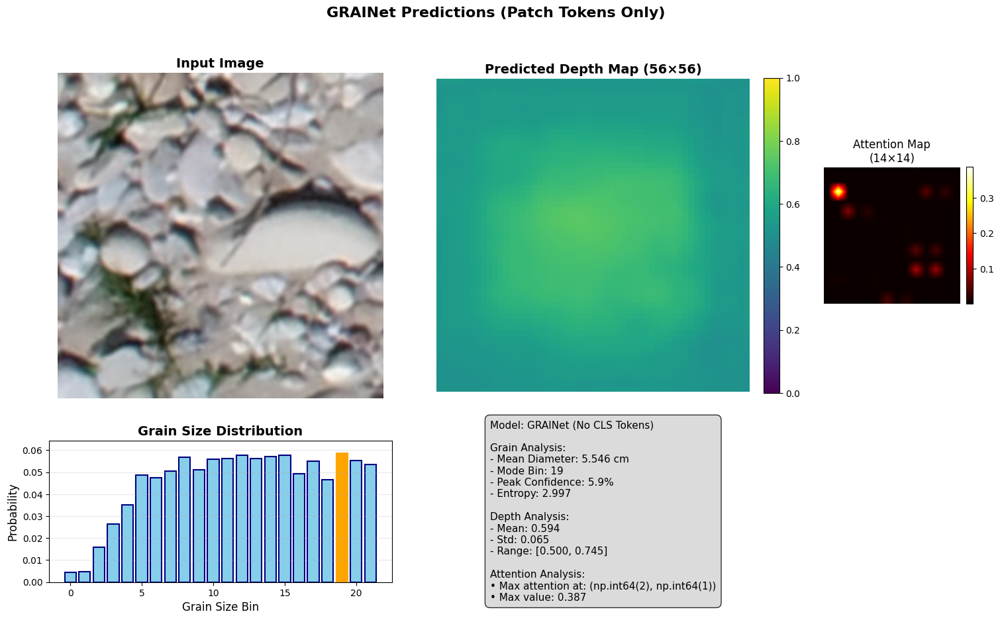


Predicting on ./grainet_dataset/images/image_0010.png...
  Diameter: 4.688 cm
  Mode bin: 19
  Depth range: [0.500, 0.749]


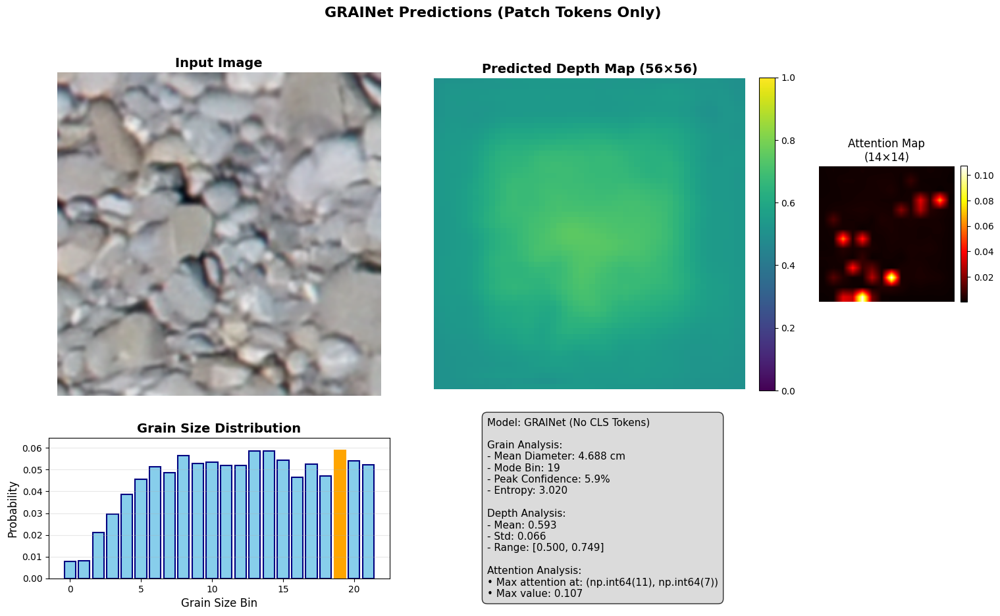


Predicting on ./grainet_dataset/images/image_0020.png...
  Diameter: 9.728 cm
  Mode bin: 13
  Depth range: [0.499, 0.724]


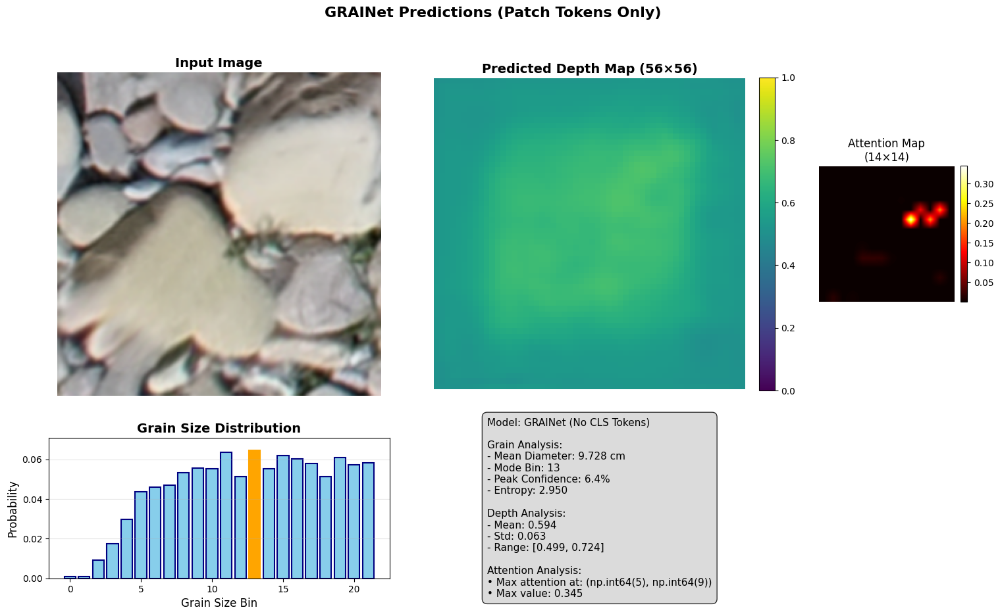

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 10: Test Inference and Visualize (FIXED)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Test the trained model on sample images:
"""

# Load the trained model
predictor = GRAINetPredictor("./grainet_model/final_model.npz")

# Function to visualize predictions
def visualize_prediction(result: Dict[str, np.ndarray], save_path: Optional[str] = None):
    """Comprehensive visualization of predictions"""

    # Check if attention weights are available
    has_attention = "attention_weights" in result

    # Create figure with appropriate layout
    if has_attention:
        fig = plt.figure(figsize=(18, 10))
        gs = fig.add_gridspec(3, 5, hspace=0.3, wspace=0.3)
    else:
        fig = plt.figure(figsize=(16, 10))
        gs = fig.add_gridspec(3, 4, hspace=0.3, wspace=0.3)

    # 1. Original image
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax1.imshow(result["image"])
    ax1.set_title("Input Image", fontsize=14, fontweight='bold')
    ax1.axis('off')

    # 2. Depth map
    ax2 = fig.add_subplot(gs[0:2, 2:4])
    im = ax2.imshow(result["depth_map"], cmap='viridis', vmin=0, vmax=1)
    ax2.set_title("Predicted Depth Map (56×56)", fontsize=14, fontweight='bold')
    ax2.axis('off')
    plt.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)

    # 3. Attention weights (if available)
    if has_attention:
        ax_att = fig.add_subplot(gs[0:2, 4])
        attention = result["attention_weights"].reshape(14, 14)
        im_att = ax_att.imshow(attention, cmap='hot', interpolation='bilinear')
        ax_att.set_title("Attention Map\n(14×14)", fontsize=12)
        ax_att.axis('off')
        plt.colorbar(im_att, ax=ax_att, fraction=0.046, pad=0.04)

    # 4. Histogram
    ax3 = fig.add_subplot(gs[2, 0:2])
    bins = np.arange(len(result["histogram"]))
    bars = ax3.bar(bins, result["histogram"], color='skyblue', edgecolor='navy', linewidth=1.5)

    # Highlight peak
    peak_idx = np.argmax(result["histogram"])
    bars[peak_idx].set_color('orange')

    ax3.set_xlabel("Grain Size Bin", fontsize=12)
    ax3.set_ylabel("Probability", fontsize=12)
    ax3.set_title("Grain Size Distribution", fontsize=14, fontweight='bold')
    ax3.grid(True, alpha=0.3, axis='y')
    ax3.set_ylim(0, max(result["histogram"]) * 1.1)

    # 5. Statistics
    ax4 = fig.add_subplot(gs[2, 2:])
    ax4.axis('off')

    # Calculate statistics
    entropy = -np.sum(result["histogram"] * np.log(result["histogram"] + 1e-9))
    mode_bin = np.argmax(result["histogram"])
    confidence = result["histogram"][mode_bin]

    # Depth statistics
    depth_mean = np.mean(result["depth_map"])
    depth_std = np.std(result["depth_map"])

    stats_text = f"""Model: GRAINet (No CLS Tokens)

Grain Analysis:
- Mean Diameter: {result['diameter']:.3f} cm
- Mode Bin: {mode_bin}
- Peak Confidence: {confidence:.1%}
- Entropy: {entropy:.3f}

Depth Analysis:
- Mean: {depth_mean:.3f}
- Std: {depth_std:.3f}
- Range: [{np.min(result['depth_map']):.3f}, {np.max(result['depth_map']):.3f}]"""

    if has_attention:
        # Add attention statistics
        attention_flat = result["attention_weights"].flatten()
        max_attention_idx = np.argmax(attention_flat)
        max_attention_pos = (max_attention_idx // 14, max_attention_idx % 14)
        stats_text += f"\n\nAttention Analysis:\n• Max attention at: {max_attention_pos}\n• Max value: {attention_flat[max_attention_idx]:.3f}"

    ax4.text(0.1, 0.5, stats_text, fontsize=11, verticalalignment='center',
             bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))

    plt.suptitle("GRAINet Predictions (Patch Tokens Only)", fontsize=16, fontweight='bold')

    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')

    plt.show()

# Test on multiple samples
print("\nTesting on sample images...")
sample_images = [
    "./grainet_dataset/images/image_0000.png",
    "./grainet_dataset/images/image_0010.png",
    "./grainet_dataset/images/image_0020.png"
]

for i, img_path in enumerate(sample_images[:3]):
    if os.path.exists(img_path):
        print(f"\nPredicting on {img_path}...")
        result = predictor.predict(img_path)

        print(f"  Diameter: {result['diameter']:.3f} cm")
        print(f"  Mode bin: {np.argmax(result['histogram'])}")
        print(f"  Depth range: [{result['depth_map'].min():.3f}, {result['depth_map'].max():.3f}]")

        visualize_prediction(result, save_path=f"prediction_{i}.png")

In [ ]:
`

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 11: Summary and Next Steps
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
## Training Complete! 🎉

You've successfully trained GRAINet without CLS tokens on TPU.

### Key Points:
1. **No CLS Tokens**: All features come from spatial patch tokens
2. **Attention Pooling**: Learns which regions are important
3. **Multi-Output**: Predicts depth, histogram, and diameter
4. **TPU Optimized**: Efficient training on Google's TPUs

### Model Architecture:
```
Input → ViT → Extract Patches (No CLS) → Shared Conv →
    ├── Depth Branch → 56×56 depth map
    └── Attention Pool → Histogram & Diameter
```

### Next Steps:
1. **Adjust Loss Weights**: If one task dominates, modify weights
2. **Try GAP**: Set `use_attention_pool=False` for comparison
3. **Fine-tune ViT**: Unfreeze ViT params for better performance
4. **Real Depth Data**: Replace synthetic depth with real annotations
5. **Deploy Model**: Export for production use

### Files Created:
- `./grainet_dataset/`: Organized training data
- `./grainet_model/`: Saved checkpoints and final model
- `prediction_*.png`: Visualization of results

### Tips:
- For larger batches on TPU, increase `batch_size` to 64 or 128
- Monitor attention maps to understand model focus
- Use the predictor class for easy inference

Happy grain analysis! 🌾
"""

print("\n" + "="*60)
print("TRAINING COMPLETE!")
print("="*60)
print(f"\nFinal model saved to: ./grainet_model/final_model.npz")
print(f"Total epochs trained: {len(history['total_loss'])}")
print(f"Final total loss: {history['total_loss'][-1]:.4f}")
print(f"\nModel uses spatial features only (no CLS tokens)")
print(f"Pooling method: {'Attention' if final_state.apply_fn.keywords['use_attention_pool'] else 'GAP'}")
print("\n✓ Ready for inference!")


TRAINING COMPLETE!

Final model saved to: ./grainet_model/final_model.npz
Total epochs trained: 50
Final total loss: 3.2039

Model uses spatial features only (no CLS tokens)


AttributeError: 'function' object has no attribute 'keywords'

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 1: Setup TPU and Install Dependencies
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
# GRAINet Training on TPU (No CLS Tokens)

## First, enable TPU:
1. Runtime → Change runtime type
2. Hardware accelerator → TPU
3. Save

Then run this cell to install dependencies:
"""

# Install JAX with TPU support
!pip install --upgrade jax[tpu] -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --upgrade flax optax transformers pillow scikit-image matplotlib tqdm

# Setup TPU
import jax
try:
    import jax.tools.colab_tpu
    jax.tools.colab_tpu.setup_tpu()
except:
    pass

print(f"JAX version: {jax.__version__}")
print(f"Devices: {jax.devices()}")
print(f"Device count: {jax.local_device_count()}")

Looking in links: https://storage.googleapis.com/jax-releases/libtpu_releases.html
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 24.9 MB/s eta 0:00:00
  Attempting uninstall: libtpu
    Found existing installation: libtpu 0.0.7.1
    Uninstalling libtpu-0.0.7.1:
      Successfully uninstalled libtpu-0.0.7.1
  Attempting uninstall: jaxlib
    Found existing installation: jaxlib 0.5.1
    Uninstalling jaxlib-0.5.1:
      Successfully uninstalled jaxlib-0.5.1
  Attempting uninstall: jax
    Found existing installation: jax 0.5.2
    Uninstalling jax-0.5.2:
      Successfully uninstalled jax-0.5.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 90.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 75.4 MB/s eta 0:00

--2025-05-29 21:38:56--  https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
Resolving share.phys.ethz.ch (share.phys.ethz.ch)... 129.132.80.27, 2001:67c:10ec:3dc4::39
Connecting to share.phys.ethz.ch (share.phys.ethz.ch)|129.132.80.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 840559012 (802M) [application/zip]
Saving to: ‘GRAINet_demo_data.zip’

GRAINet_demo_data.z 100%[===================>] 801.62M  28.1MB/s    in 30s     

2025-05-29 21:39:26 (26.6 MB/s) - ‘GRAINet_demo_data.zip’ saved [840559012/840559012]

Contents of /content/data_GRAINet_demo/data_KLEmme_1bank.npz:
--------------------------------------------------
• images
  Shape: (212, 500, 200, 3)
  Data type: float32
• histograms
  Shape: (212, 22)
  Data type: float32
• tile_names
  Shape: (212,)
  Data type: object
• dm
  Shape: (212,)
  Data type: float32
--------------------------------------------------


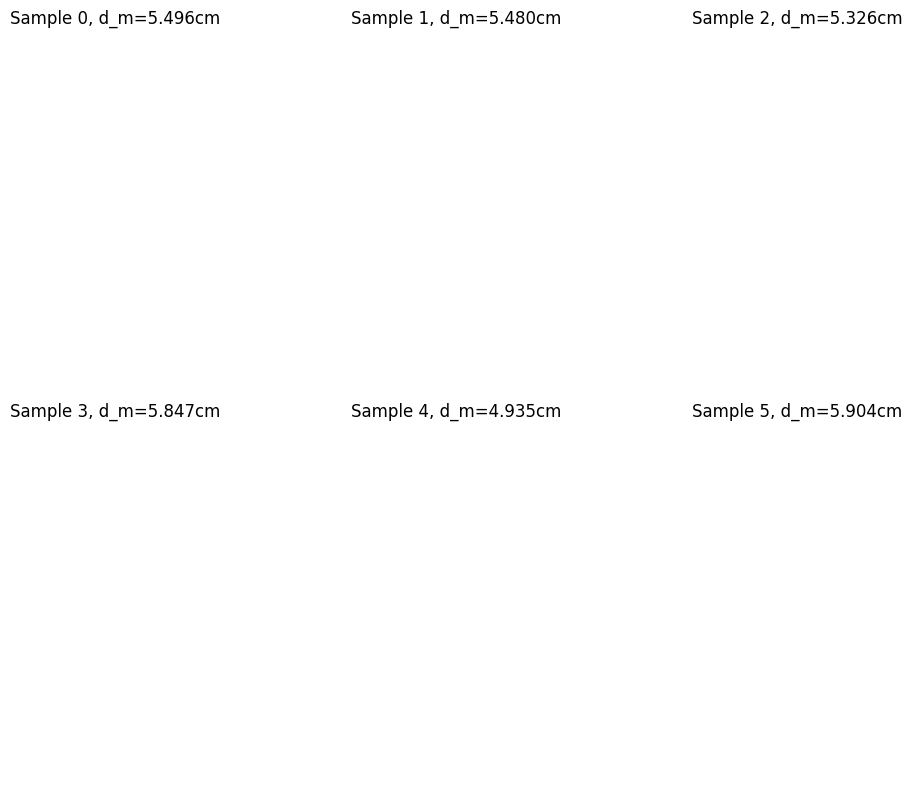

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 2: Download and Extract Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Download and prepare the GRAINet demo data:
"""

import os
import json
import numpy as np
from PIL import Image
from skimage.transform import resize
from tqdm import tqdm
import matplotlib.pyplot as plt

# Download the demo data
!wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip
!unzip -q -o GRAINet_demo_data.zip

# View NPZ contents first
def inspect_npz(npz_path):
    """Inspect the NPZ file contents"""
    data = np.load(npz_path, allow_pickle=True)
    print(f"Contents of {npz_path}:")
    print("-" * 50)
    for key in data.files:
        array = data[key]
        print(f"• {key}")
        print(f"  Shape: {array.shape}")
        print(f"  Data type: {array.dtype}")
        if array.size < 10:
            print(f"  Values: {array}")
    print("-" * 50)
    return data

# Inspect the data
npz_path = "/content/data_GRAINet_demo/data_KLEmme_1bank.npz"
data = inspect_npz(npz_path)

# Visualize some samples
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i in range(6):
    ax = axes[i//3, i%3]
    ax.imshow(data['images'][i])
    ax.set_title(f"Sample {i}, d_m={data['dm'][i]:.3f}cm")
    ax.axis('off')
plt.tight_layout()
plt.show()


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 3: Extract and Organize Data
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Extract data into organized directories for training:
"""

def extract_and_organize_data(npz_path, output_dir, target_size=(224, 224)):
    """Extract data from NPZ and organize for training"""

    # Create directories
    os.makedirs(output_dir, exist_ok=True)
    for subdir in ["images", "histograms", "mean_diameters"]:
        os.makedirs(os.path.join(output_dir, subdir), exist_ok=True)

    # Load data
    print(f"Loading data from {npz_path}...")
    data = np.load(npz_path, allow_pickle=True)

    images = data['images']
    histograms = data['histograms'] if 'histograms' in data else None
    diameters = data['dm'] if 'dm' in data else None

    num_samples = len(images)
    print(f"Processing {num_samples} samples...")

    # Metadata
    metadata = {
        "num_samples": num_samples,
        "sample_mapping": {},
        "histogram_bins": histograms.shape[-1] if histograms is not None else None
    }

    # Process each sample
    for i in tqdm(range(num_samples), desc="Extracting"):
        # Process image
        img = images[i]
        h, w = img.shape[:2]

        # Center crop to square
        if w != h:
            size = min(w, h)
            start_w = (w - size) // 2
            start_h = (h - size) // 2
            img = img[start_h:start_h+size, start_w:start_w+size]

        # Resize to target size
        img_resized = resize(img, target_size, anti_aliasing=True, preserve_range=True)
        img_pil = Image.fromarray(img_resized.astype(np.uint8))

        # Save files
        img_name = f"image_{i:04d}.png"
        hist_name = f"hist_{i:04d}.npy"
        dm_name = f"dm_{i:04d}.npy"

        img_pil.save(os.path.join(output_dir, "images", img_name))

        if histograms is not None:
            np.save(os.path.join(output_dir, "histograms", hist_name), histograms[i])

        if diameters is not None:
            np.save(os.path.join(output_dir, "mean_diameters", dm_name), diameters[i])

        metadata["sample_mapping"][str(i)] = {
            "image": img_name,
            "histogram": hist_name,
            "mean_diameter": dm_name
        }

    # Save metadata
    with open(os.path.join(output_dir, "metadata.json"), "w") as f:
        json.dump(metadata, f, indent=2)

    print(f"✓ Data extracted to {output_dir}")
    return metadata

# Extract the data
output_dir = "./grainet_dataset"
metadata = extract_and_organize_data(npz_path, output_dir)

print(f"\nDataset ready:")
print(f"  Samples: {metadata['num_samples']}")
print(f"  Histogram bins: {metadata['histogram_bins']}")


Loading data from /content/data_GRAINet_demo/data_KLEmme_1bank.npz...
Processing 212 samples...


Extracting: 100%|██████████| 212/212 [00:06<00:00, 33.10it/s]

✓ Data extracted to ./grainet_dataset

Dataset ready:
  Samples: 212
  Histogram bins: 22


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 4: Define Model Architecture (No CLS Tokens)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define the GRAINet model that uses only patch tokens:
"""

import jax
import jax.numpy as jnp
import flax.linen as nn
from typing import Tuple, Dict, Optional

# Compatibility fix for JAX API changes
if not hasattr(jax, 'tree_map'):
    jax.tree_map = jax.tree_util.tree_map
if not hasattr(jax, 'tree_leaves'):
    jax.tree_leaves = jax.tree_util.tree_leaves

class SpatialAttentionPool(nn.Module):
    """Attention-based spatial pooling to aggregate patch features"""

    @nn.compact
    def __call__(self, x: jnp.ndarray) -> jnp.ndarray:
        B, H, W, C = x.shape

        # Flatten spatial dimensions
        x_flat = x.reshape(B, H * W, C)  # [B, HW, C]

        # Compute attention weights
        attn_logits = nn.Dense(1, name='attention')(x_flat)  # [B, HW, 1]
        attn_weights = nn.softmax(attn_logits, axis=1)

        # Weighted average pooling
        pooled = jnp.sum(x_flat * attn_weights, axis=1)  # [B, C]

        return pooled, attn_weights  # Return weights for visualization

class GRAINetDecoder(nn.Module):
    """Decoder using only patch tokens - no CLS tokens"""
    num_classes: int = 21
    feature_layers: Tuple[int, ...] = (3, 5, 7, 11)
    use_attention_pool: bool = True

    @nn.compact
    def __call__(self, hidden_states: list, train: bool = True) -> Dict[str, jnp.ndarray]:
        # Extract patch tokens from specified layers
        patch_features = []
        for layer_idx in self.feature_layers:
            features = hidden_states[layer_idx]  # [B, 197, 768]

            # Remove CLS token (position 0) - THIS IS KEY!
            patch_tokens = features[:, 1:, :]  # [B, 196, 768]

            # Reshape to spatial
            B = patch_tokens.shape[0]
            patches_2d = patch_tokens.reshape(B, 14, 14, 768)
            patch_features.append(patches_2d)

        # Concatenate features from all layers
        combined = jnp.concatenate(patch_features, axis=-1)  # [B, 14, 14, 3072]

        # Shared spatial processing
        x = nn.Conv(512, kernel_size=(3, 3), padding='SAME', name='shared_conv')(combined)
        x = nn.GroupNorm(num_groups=32, name='shared_gn')(x)
        x = nn.gelu(x)
        x = nn.Dropout(rate=0.1, deterministic=not train)(x)

        # Branch 1: Depth map
        depth = x

        # Additional processing
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv1')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn1')(depth)
        depth = nn.gelu(depth)

        # Upsample 14x14 -> 28x28
        depth = jax.image.resize(depth, (depth.shape[0], 28, 28, depth.shape[3]), method='bilinear')
        depth = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='depth_conv2')(depth)
        depth = nn.GroupNorm(num_groups=16, name='depth_gn2')(depth)
        depth = nn.gelu(depth)

        # Upsample 28x28 -> 56x56
        depth = jax.image.resize(depth, (depth.shape[0], 56, 56, depth.shape[3]), method='bilinear')
        depth = nn.Conv(128, kernel_size=(3, 3), padding='SAME', name='depth_conv3')(depth)
        depth = nn.GroupNorm(num_groups=8, name='depth_gn3')(depth)
        depth = nn.gelu(depth)

        # Final depth prediction
        depth_map = nn.Conv(1, kernel_size=(1, 1), name='depth_final')(depth)
        depth_map = nn.sigmoid(depth_map).squeeze(-1)  # [B, 56, 56]

        # Branch 2: Global predictions (histogram & diameter)
        # Additional conv for global features
        global_features = nn.Conv(256, kernel_size=(3, 3), padding='SAME', name='global_conv')(x)
        global_features = nn.GroupNorm(num_groups=16, name='global_gn')(global_features)
        global_features = nn.gelu(global_features)

        # Spatial aggregation
        if self.use_attention_pool:
            pooling = SpatialAttentionPool()
            pooled_features, attention_weights = pooling(global_features)
        else:
            # Global Average Pooling
            pooled_features = jnp.mean(global_features, axis=(1, 2))
            attention_weights = None

        # Shared MLP
        mlp = nn.Dense(512, name='mlp_fc1')(pooled_features)
        mlp = nn.gelu(mlp)
        mlp = nn.Dropout(rate=0.2, deterministic=not train)(mlp)
        mlp = nn.Dense(256, name='mlp_fc2')(mlp)
        mlp = nn.gelu(mlp)

        # Histogram head
        hist = nn.Dense(128, name='hist_fc1')(mlp)
        hist = nn.gelu(hist)
        histogram = nn.Dense(self.num_classes, name='hist_fc2')(hist)
        histogram = nn.softmax(histogram)

        # Diameter head
        diam = nn.Dense(64, name='diam_fc1')(mlp)
        diam = nn.gelu(diam)
        diameter = nn.Dense(1, name='diam_fc2')(diam)

        outputs = {
            "depth_map": depth_map,
            "histogram": histogram,
            "diameter": diameter
        }

        if attention_weights is not None:
            outputs["attention_weights"] = attention_weights

        return outputs

print("✓ Model architecture defined (No CLS tokens)")

# Test model creation
rng = jax.random.PRNGKey(0)
model = GRAINetDecoder(num_classes=21, use_attention_pool=True)
dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
params = model.init(rng, dummy_hidden, train=False)

param_count = sum(x.size for x in jax.tree_util.tree_leaves(params))
print(f"✓ Model parameters: {param_count:,}")

✓ Model architecture defined (No CLS tokens)
✓ Model parameters: 17,719,448


In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 5: Setup Training Components
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Setup loss functions, data loading, and training utilities:
"""

from functools import partial
from pathlib import Path
import time

import flax
from flax.training import train_state
from flax import jax_utils
import optax
from transformers import FlaxViTModel, ViTImageProcessor

# Loss functions
def compute_losses(predictions: Dict[str, jnp.ndarray],
                   targets: Dict[str, jnp.ndarray],
                   weights: Dict[str, float]) -> Tuple[jnp.ndarray, Dict[str, jnp.ndarray]]:
    """Compute multi-task losses"""

    # Depth loss (MSE)
    depth_loss = jnp.mean((predictions["depth_map"] - targets["depth_map"]) ** 2)

    # Histogram loss (KL divergence)
    hist_loss = -jnp.mean(
        jnp.sum(targets["histogram"] * jnp.log(predictions["histogram"] + 1e-9), axis=-1)
    )

    # Diameter loss (MSE)
    diam_loss = jnp.mean((predictions["diameter"].squeeze() - targets["diameter"]) ** 2)

    # Weighted total
    total_loss = (
        weights["depth"] * depth_loss +
        weights["histogram"] * hist_loss +
        weights["diameter"] * diam_loss
    )

    metrics = {
        "total_loss": total_loss,
        "depth_loss": depth_loss,
        "hist_loss": hist_loss,
        "diam_loss": diam_loss
    }

    return total_loss, metrics

# Data loader
class GRAINetDataLoader:
    """Efficient data loader for training"""

    def __init__(self, data_dir: str, batch_size: int, processor):
        self.data_dir = Path(data_dir)
        self.batch_size = batch_size
        self.processor = processor

        # Load metadata
        with open(self.data_dir / "metadata.json", "r") as f:
            self.metadata = json.load(f)

        self.num_samples = self.metadata["num_samples"]
        self.indices = np.arange(self.num_samples)

    def generate_depth_map(self, idx: int) -> np.ndarray:
        """Generate synthetic depth map (placeholder - replace with real depth data)"""
        np.random.seed(idx)
        x = np.linspace(-1, 1, 56)
        y = np.linspace(-1, 1, 56)
        xx, yy = np.meshgrid(x, y)

        # Create some structure
        depth = 0.5 + 0.3 * np.exp(-(xx**2 + yy**2) / 0.5)
        depth += 0.1 * np.random.randn(56, 56)
        depth = np.clip(depth, 0, 1).astype(np.float32)

        return depth

    def get_batch(self) -> Tuple[np.ndarray, Dict[str, np.ndarray]]:
        """Get a random batch"""
        # Sample indices
        batch_idx = np.random.choice(self.indices, self.batch_size, replace=False)

        images = []
        targets = {
            "histogram": [],
            "diameter": [],
            "depth_map": []
        }

        for idx in batch_idx:
            mapping = self.metadata["sample_mapping"][str(idx)]

            # Load image
            img_path = self.data_dir / "images" / mapping["image"]
            image = Image.open(img_path).convert("RGB")
            images.append(image)

            # Load histogram
            hist_path = self.data_dir / "histograms" / mapping["histogram"]
            histogram = np.load(hist_path).astype(np.float32)
            histogram = histogram / (histogram.sum() + 1e-9)  # Normalize
            targets["histogram"].append(histogram)

            # Load diameter
            diam_path = self.data_dir / "mean_diameters" / mapping["mean_diameter"]
            diameter = np.load(diam_path).astype(np.float32)
            targets["diameter"].append(diameter)

            # Generate depth map (synthetic for demo)
            depth = self.generate_depth_map(idx)
            targets["depth_map"].append(depth)

        # Process images
        inputs = self.processor(images=images, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Stack targets
        for key in targets:
            targets[key] = np.stack(targets[key])

        return pixel_values, targets

print("✓ Training components ready")


✓ Training components ready


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 6: Training Step Functions
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Define training and evaluation steps:
"""

# Create training step function with closed-over variables
def create_train_step(vit_model, loss_weights):
    """Create training step with static arguments"""

    @partial(jax.pmap, axis_name='batch', donate_argnums=(0,))
    def train_step(state, batch, dropout_rng, vit_params):
        """Single training step"""

        images, targets = batch
        dropout_rng, new_dropout_rng = jax.random.split(dropout_rng)

        def loss_fn(params):
            # Get ViT features
            vit_out = vit_model(
                pixel_values=images,
                params=vit_params,
                output_hidden_states=True
            )

            # Decoder predictions
            predictions = state.apply_fn(
                params,
                vit_out.hidden_states,
                train=True,
                rngs={'dropout': dropout_rng}
            )

            # Compute losses
            loss, metrics = compute_losses(predictions, targets, loss_weights)

            return loss, metrics

        # Compute gradients
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(state.params)

        # Average across devices
        grads = jax.lax.pmean(grads, axis_name='batch')
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        # Update state
        state = state.apply_gradients(grads=grads)

        return state, metrics, new_dropout_rng

    return train_step

# Create evaluation step function
def create_eval_step(vit_model, loss_weights):
    """Create evaluation step with static arguments"""

    @partial(jax.pmap, axis_name='batch')
    def eval_step(state, batch, vit_params):
        """Evaluation step"""

        images, targets = batch

        # Get ViT features
        vit_out = vit_model(
            pixel_values=images,
            params=vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = state.apply_fn(
            state.params,
            vit_out.hidden_states,
            train=False
        )

        # Compute metrics
        _, metrics = compute_losses(predictions, targets, loss_weights)

        # Average across devices
        metrics = jax.lax.pmean(metrics, axis_name='batch')

        return metrics, predictions

    return eval_step

print("✓ Training functions defined")

✓ Training functions defined


In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 7: Main Training Function
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Main training loop:
"""

def train_grainet(
    data_dir: str = "./grainet_dataset",
    output_dir: str = "./grainet_model",
    num_epochs: int = 50,
    batch_size: int = 32,
    learning_rate: float = 1e-4,
    use_attention_pool: bool = True,
    loss_weights: Optional[Dict[str, float]] = None,
    save_every: int = 10,
    eval_every: int = 5,
    seed: int = 42
):
    """Train GRAINet model"""

    # Setup
    np.random.seed(seed)
    rng = jax.random.PRNGKey(seed)

    if loss_weights is None:
        loss_weights = {"depth": 1.0, "histogram": 1.0, "diameter": 1.0}

    # Create output directory
    os.makedirs(output_dir, exist_ok=True)

    # Device setup
    num_devices = jax.local_device_count()
    print(f"Training on {num_devices} devices")

    # Adjust batch size for devices - ensure minimum batch size per device
    min_batch_per_device = 2  # Minimum samples per device
    if batch_size < num_devices * min_batch_per_device:
        batch_size = num_devices * min_batch_per_device
        print(f"Increased batch size to {batch_size} (minimum {min_batch_per_device} per device)")

    if batch_size % num_devices != 0:
        batch_size = (batch_size // num_devices) * num_devices
        print(f"Adjusted batch size to {batch_size} for {num_devices} devices")

    batch_size_per_device = batch_size // num_devices

    # Load ViT and processor
    print("Loading ViT model...")
    vit_model = FlaxViTModel.from_pretrained(
        "google/vit-base-patch16-224-in21k",
        output_hidden_states=True
    )
    vit_params = vit_model.params
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

    # Create data loader
    data_loader = GRAINetDataLoader(data_dir, batch_size, processor)

    # Detect number of classes
    sample_hist = np.load(Path(data_dir) / "histograms" / "hist_0000.npy")
    num_classes = len(sample_hist)
    print(f"Detected {num_classes} histogram bins")

    # Create model
    model = GRAINetDecoder(num_classes=num_classes, use_attention_pool=use_attention_pool)

    # Initialize parameters
    rng, init_rng = jax.random.split(rng)
    dummy_hidden = [jnp.ones((1, 197, 768)) for _ in range(12)]
    params = model.init(init_rng, dummy_hidden, train=False)

    # Create optimizer
    tx = optax.chain(
        optax.clip_by_global_norm(1.0),
        optax.adamw(learning_rate=learning_rate, weight_decay=1e-5)
    )

    # Create train state
    state = train_state.TrainState.create(
        apply_fn=model.apply,
        params=params,
        tx=tx
    )

    # Replicate across devices
    state = jax_utils.replicate(state)
    vit_params_replicated = jax_utils.replicate(vit_params)

    # Setup dropout RNG
    rng, dropout_rng = jax.random.split(rng)
    dropout_rngs = jax.random.split(dropout_rng, num_devices)

    # Training metrics
    steps_per_epoch = data_loader.num_samples // batch_size
    total_steps = num_epochs * steps_per_epoch

    print(f"\nTraining Configuration:")
    print(f"  Epochs: {num_epochs}")
    print(f"  Batch size: {batch_size} ({batch_size_per_device} per device)")
    print(f"  Steps per epoch: {steps_per_epoch}")
    print(f"  Total steps: {total_steps}")
    print(f"  Learning rate: {learning_rate}")
    print(f"  Pooling: {'Attention' if use_attention_pool else 'GAP'}")
    print(f"  Loss weights: {loss_weights}")

    # Create training and evaluation functions
    train_step = create_train_step(vit_model, loss_weights)
    eval_step = create_eval_step(vit_model, loss_weights)

    # Training history
    history = {
        "total_loss": [],
        "depth_loss": [],
        "hist_loss": [],
        "diam_loss": []
    }

    # Training loop
    print("\nStarting training...")
    step = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        # Training
        epoch_metrics = []
        pbar = tqdm(range(steps_per_epoch), desc="Training")

        for _ in pbar:
            # Get batch
            images, targets = data_loader.get_batch()

            # Reshape for devices
            images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
            targets = jax.tree_util.tree_map(
                lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                targets
            )

            batch = (images, targets)

            # Training step
            state, metrics, dropout_rngs = train_step(
                state, batch, dropout_rngs, vit_params_replicated
            )

            # Update metrics
            metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)  # Get from first device
            epoch_metrics.append(metrics)

            # Update progress bar
            avg_metrics = jax.tree_util.tree_map(
                lambda *xs: np.mean(xs),
                *epoch_metrics[-100:]  # Last 100 steps
            )
            pbar.set_postfix({
                "loss": f"{avg_metrics['total_loss']:.4f}",
                "depth": f"{avg_metrics['depth_loss']:.4f}",
                "hist": f"{avg_metrics['hist_loss']:.4f}",
                "diam": f"{avg_metrics['diam_loss']:.4f}"
            })

            step += 1

        # Record epoch metrics
        epoch_avg = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *epoch_metrics)
        for key in history:
            history[key].append(epoch_avg[key])

        # Evaluation
        if (epoch + 1) % eval_every == 0:
            print("\nEvaluating...")
            eval_metrics = []

            for _ in range(10):  # 10 eval batches
                images, targets = data_loader.get_batch()
                images = images.reshape(num_devices, batch_size_per_device, *images.shape[1:])
                targets = jax.tree_util.tree_map(
                    lambda x: x.reshape(num_devices, batch_size_per_device, *x.shape[1:]),
                    targets
                )

                metrics, predictions = eval_step(
                    state, (images, targets), vit_params_replicated
                )
                metrics = jax.tree_util.tree_map(lambda x: float(x[0]), metrics)
                eval_metrics.append(metrics)

            avg_eval = jax.tree_util.tree_map(lambda *xs: np.mean(xs), *eval_metrics)
            print(f"Eval - Loss: {avg_eval['total_loss']:.4f}, "
                  f"Depth: {avg_eval['depth_loss']:.4f}, "
                  f"Hist: {avg_eval['hist_loss']:.4f}, "
                  f"Diam: {avg_eval['diam_loss']:.4f}")

        # Save checkpoint
        if (epoch + 1) % save_every == 0:
            print(f"Saving checkpoint at epoch {epoch + 1}...")

            # Unreplicate state
            save_state = jax_utils.unreplicate(state)
            save_vit_params = jax_utils.unreplicate(vit_params_replicated)

            # Save
            ckpt_path = os.path.join(output_dir, f"checkpoint_{epoch + 1}.npz")
            np.savez(
                ckpt_path,
                params=save_state.params,
                vit_params=save_vit_params,
                config={
                    "num_classes": num_classes,
                    "use_attention_pool": use_attention_pool,
                    "loss_weights": loss_weights,
                    "epoch": epoch + 1
                },
                history=history
            )
            print(f"✓ Saved checkpoint: {ckpt_path}")

    print("\n✓ Training complete!")

    # Save final model
    final_state = jax_utils.unreplicate(state)
    final_vit_params = jax_utils.unreplicate(vit_params_replicated)

    final_path = os.path.join(output_dir, "final_model.npz")
    np.savez(
        final_path,
        params=final_state.params,
        vit_params=final_vit_params,
        config={
            "num_classes": num_classes,
            "use_attention_pool": use_attention_pool,
            "loss_weights": loss_weights,
            "epochs": num_epochs
        },
        history=history
    )
    print(f"✓ Saved final model: {final_path}")

    return final_state, history

Training on 8 devices
Loading ViT model...
Detected 22 histogram bins

Training Configuration:
  Epochs: 50
  Batch size: 64 (8 per device)
  Steps per epoch: 3
  Total steps: 150
  Learning rate: 0.0001
  Pooling: Attention
  Loss weights: {'depth': 1.0, 'histogram': 1.0, 'diameter': 1.0}

Starting training...

Epoch 1/50


Training: 100%|██████████| 3/3 [00:24<00:00,  8.28s/it, loss=81.6765, depth=0.0508, hist=3.0952, diam=78.5305]



Epoch 2/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=67.2998, depth=0.0260, hist=3.1009, diam=64.1729]



Epoch 3/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.00it/s, loss=57.0482, depth=0.0173, hist=3.1181, diam=53.9128]



Epoch 4/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s, loss=34.8203, depth=0.0166, hist=3.1529, diam=31.6509]



Epoch 5/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.93it/s, loss=16.7129, depth=0.0138, hist=3.2575, diam=13.4415]



Evaluating...
Eval - Loss: 9.9114, Depth: 0.0141, Hist: 3.3572, Diam: 6.5402

Epoch 6/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=11.5187, depth=0.0135, hist=3.4587, diam=8.0465]



Epoch 7/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.86it/s, loss=11.8960, depth=0.0151, hist=3.4259, diam=8.4549]



Epoch 8/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=10.1619, depth=0.0135, hist=3.2292, diam=6.9192]



Epoch 9/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.89it/s, loss=9.4323, depth=0.0137, hist=3.1359, diam=6.2827]



Epoch 10/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s, loss=8.2497, depth=0.0128, hist=3.1093, diam=5.1276]



Evaluating...
Eval - Loss: 8.0354, Depth: 0.0126, Hist: 3.0483, Diam: 4.9745
Saving checkpoint at epoch 10...
✓ Saved checkpoint: ./grainet_model/checkpoint_10.npz

Epoch 11/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=8.0163, depth=0.0125, hist=3.0981, diam=4.9057]



Epoch 12/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=7.6503, depth=0.0124, hist=3.0678, diam=4.5701]



Epoch 13/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=6.6282, depth=0.0124, hist=3.0537, diam=3.5621]



Epoch 14/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=6.7724, depth=0.0121, hist=3.0468, diam=3.7134]



Epoch 15/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=5.7137, depth=0.0122, hist=3.0344, diam=2.6672]



Evaluating...
Eval - Loss: 5.1704, Depth: 0.0119, Hist: 2.9899, Diam: 2.1686

Epoch 16/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=5.4423, depth=0.0120, hist=3.0264, diam=2.4039]



Epoch 17/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=4.9747, depth=0.0121, hist=3.0283, diam=1.9343]



Epoch 18/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=4.7689, depth=0.0122, hist=3.0237, diam=1.7330]



Epoch 19/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=4.3348, depth=0.0119, hist=3.0253, diam=1.2977]



Epoch 20/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=4.0387, depth=0.0118, hist=3.0239, diam=1.0030]



Evaluating...
Eval - Loss: 3.6424, Depth: 0.0116, Hist: 2.9818, Diam: 0.6490
Saving checkpoint at epoch 20...
✓ Saved checkpoint: ./grainet_model/checkpoint_20.npz

Epoch 21/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.9150, depth=0.0117, hist=3.0169, diam=0.8864]



Epoch 22/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.8390, depth=0.0116, hist=3.0160, diam=0.8114]



Epoch 23/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.10it/s, loss=3.8414, depth=0.0116, hist=3.0104, diam=0.8194]



Epoch 24/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.6641, depth=0.0116, hist=3.0134, diam=0.6392]



Epoch 25/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.09it/s, loss=3.6135, depth=0.0115, hist=3.0053, diam=0.5968]



Evaluating...
Eval - Loss: 3.2378, Depth: 0.0113, Hist: 2.9710, Diam: 0.2554

Epoch 26/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.4984, depth=0.0114, hist=3.0028, diam=0.4842]



Epoch 27/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.11it/s, loss=3.5277, depth=0.0114, hist=2.9983, diam=0.5180]



Epoch 28/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.5224, depth=0.0113, hist=2.9974, diam=0.5136]



Epoch 29/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s, loss=3.7022, depth=0.0116, hist=2.9961, diam=0.6945]



Epoch 30/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.18it/s, loss=3.5283, depth=0.0114, hist=2.9933, diam=0.5236]



Evaluating...
Eval - Loss: 3.1893, Depth: 0.0111, Hist: 2.9667, Diam: 0.2115
Saving checkpoint at epoch 30...
✓ Saved checkpoint: ./grainet_model/checkpoint_30.npz

Epoch 31/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.4367, depth=0.0112, hist=2.9959, diam=0.4296]



Epoch 32/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.4822, depth=0.0112, hist=2.9930, diam=0.4781]



Epoch 33/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.07it/s, loss=3.7171, depth=0.0113, hist=2.9947, diam=0.7112]



Epoch 34/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3713, depth=0.0113, hist=2.9905, diam=0.3694]



Epoch 35/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.3203, depth=0.0112, hist=2.9891, diam=0.3200]



Evaluating...
Eval - Loss: 3.0696, Depth: 0.0111, Hist: 2.9640, Diam: 0.0946

Epoch 36/50


Training: 100%|██████████| 3/3 [00:01<00:00,  2.98it/s, loss=3.2826, depth=0.0112, hist=2.9889, diam=0.2826]



Epoch 37/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.2955, depth=0.0112, hist=2.9887, diam=0.2957]



Epoch 38/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.3093, depth=0.0110, hist=2.9840, diam=0.3143]



Epoch 39/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s, loss=3.3412, depth=0.0109, hist=2.9860, diam=0.3442]



Epoch 40/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.04it/s, loss=3.2312, depth=0.0108, hist=2.9835, diam=0.2369]



Evaluating...
Eval - Loss: 3.0791, Depth: 0.0107, Hist: 2.9614, Diam: 0.1070
Saving checkpoint at epoch 40...
✓ Saved checkpoint: ./grainet_model/checkpoint_40.npz

Epoch 41/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2969, depth=0.0108, hist=2.9865, diam=0.2996]



Epoch 42/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.08it/s, loss=3.2176, depth=0.0107, hist=2.9835, diam=0.2234]



Epoch 43/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.1867, depth=0.0108, hist=2.9813, diam=0.1946]



Epoch 44/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.14it/s, loss=3.2349, depth=0.0108, hist=2.9803, diam=0.2439]



Epoch 45/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.3414, depth=0.0108, hist=2.9820, diam=0.3487]



Evaluating...
Eval - Loss: 3.1965, Depth: 0.0106, Hist: 2.9610, Diam: 0.2248

Epoch 46/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2768, depth=0.0108, hist=2.9793, diam=0.2868]



Epoch 47/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2170, depth=0.0107, hist=2.9820, diam=0.2243]



Epoch 48/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.12it/s, loss=3.2882, depth=0.0107, hist=2.9769, diam=0.3006]



Epoch 49/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.06it/s, loss=3.2143, depth=0.0107, hist=2.9786, diam=0.2250]



Epoch 50/50


Training: 100%|██████████| 3/3 [00:00<00:00,  3.13it/s, loss=3.2039, depth=0.0106, hist=2.9788, diam=0.2145]



Evaluating...
Eval - Loss: 3.0236, Depth: 0.0105, Hist: 2.9599, Diam: 0.0532
Saving checkpoint at epoch 50...
✓ Saved checkpoint: ./grainet_model/checkpoint_50.npz

✓ Training complete!
✓ Saved final model: ./grainet_model/final_model.npz


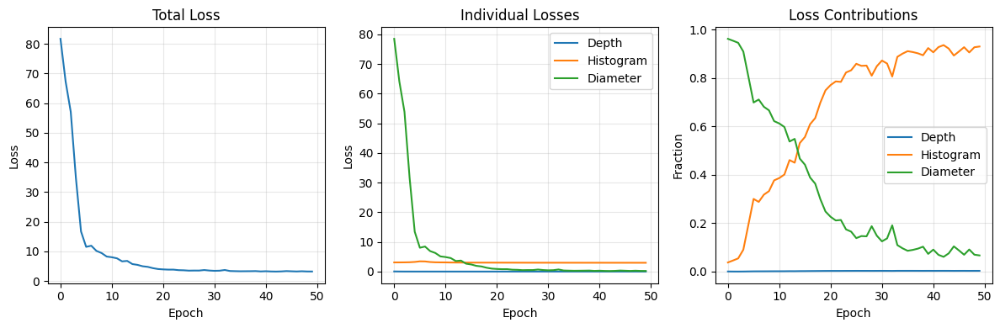

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 8: Run Training
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Start training! Adjust parameters as needed:
"""

# Train the model
final_state, history = train_grainet(
    data_dir="./grainet_dataset",
    output_dir="./grainet_model",
    num_epochs=50,
    batch_size=64,  # Increased for TPU (8 per device with 8 TPU cores)
    learning_rate=1e-4,
    use_attention_pool=True,  # Key: No CLS tokens, use attention!
    loss_weights={
        "depth": 1.0,
        "histogram": 1.0,
        "diameter": 1.0
    },
    save_every=10,
    eval_every=5
)

# Plot training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.plot(history['total_loss'])
plt.title('Total Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 2)
plt.plot(history['depth_loss'], label='Depth')
plt.plot(history['hist_loss'], label='Histogram')
plt.plot(history['diam_loss'], label='Diameter')
plt.title('Individual Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 3)
total = np.array(history['total_loss'])
plt.plot(np.array(history['depth_loss']) / total, label='Depth')
plt.plot(np.array(history['hist_loss']) / total, label='Histogram')
plt.plot(np.array(history['diam_loss']) / total, label='Diameter')
plt.title('Loss Contributions')
plt.xlabel('Epoch')
plt.ylabel('Fraction')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [ ]:

# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 9: Inference Class
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Create inference wrapper for easy predictions:
"""

class GRAINetPredictor:
    """Inference wrapper for trained model"""

    def __init__(self, checkpoint_path: str):
        """Load model from checkpoint"""
        print(f"Loading model from {checkpoint_path}")

        # Load checkpoint
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params = ckpt["params"].item()
        self.vit_params = ckpt["vit_params"].item()
        self.config = ckpt["config"].item()

        # Create model
        self.model = GRAINetDecoder(
            num_classes=self.config["num_classes"],
            use_attention_pool=self.config["use_attention_pool"]
        )

        # Load ViT
        self.vit_model = FlaxViTModel.from_pretrained(
            "google/vit-base-patch16-224-in21k",
            output_hidden_states=True
        )

        # Load processor
        self.processor = ViTImageProcessor.from_pretrained(
            "google/vit-base-patch16-224-in21k"
        )

        print(f"Model loaded: {self.config['num_classes']} classes, "
              f"{'Attention' if self.config['use_attention_pool'] else 'GAP'} pooling")

    def predict(self, image_path: str) -> Dict[str, np.ndarray]:
        """Predict on single image"""
        # Load and process image
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        pixel_values = inputs["pixel_values"]

        # Get ViT features
        vit_out = self.vit_model(
            pixel_values=pixel_values,
            params=self.vit_params,
            output_hidden_states=True
        )

        # Decoder predictions
        predictions = self.model.apply(
            self.params,
            vit_out.hidden_states,
            train=False
        )

        # Convert to numpy
        results = {
            "image": image,
            "depth_map": np.array(predictions["depth_map"][0]),
            "histogram": np.array(predictions["histogram"][0]),
            "diameter": float(predictions["diameter"][0, 0])
        }

        if "attention_weights" in predictions:
            results["attention_weights"] = np.array(predictions["attention_weights"][0])

        return results

print("✓ Inference class ready")


✓ Inference class ready


Loading model from ./grainet_model/final_model.npz
Model loaded: 22 classes, Attention pooling

Testing on sample images...

Predicting on ./grainet_dataset/images/image_0000.png...
  Diameter: 5.546 cm
  Mode bin: 19
  Depth range: [0.500, 0.745]


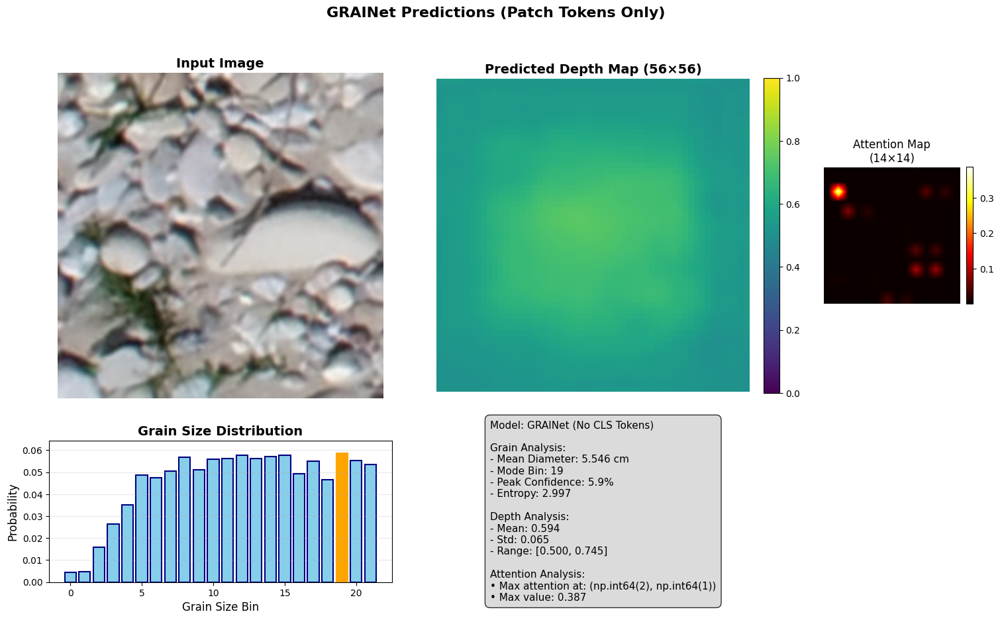


Predicting on ./grainet_dataset/images/image_0010.png...
  Diameter: 4.688 cm
  Mode bin: 19
  Depth range: [0.500, 0.749]


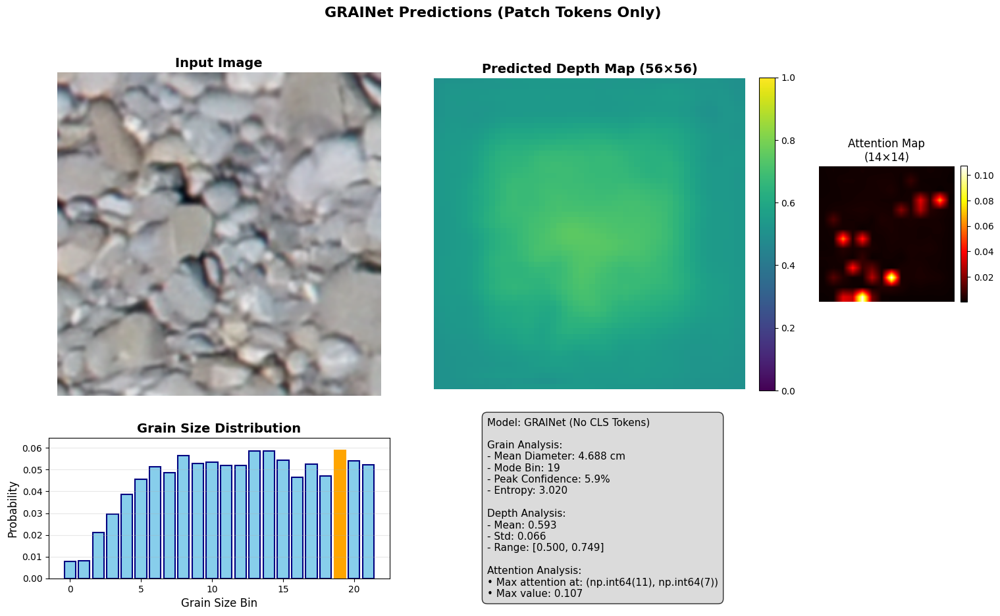


Predicting on ./grainet_dataset/images/image_0020.png...
  Diameter: 9.728 cm
  Mode bin: 13
  Depth range: [0.499, 0.724]


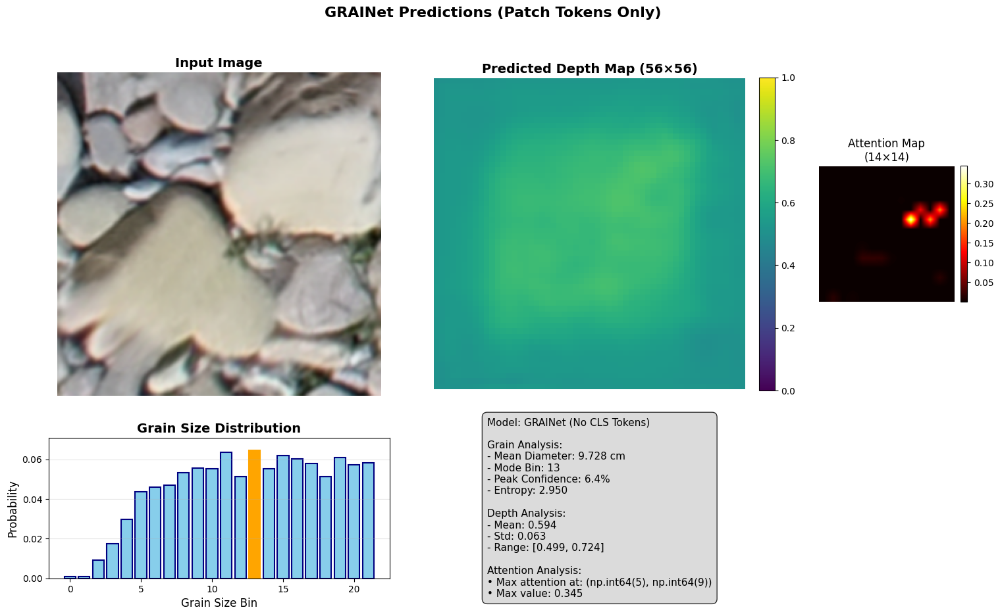

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 10: Test Inference and Visualize (FIXED)
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
Test the trained model on sample images:
"""

# Load the trained model
predictor = GRAINetPredictor("./grainet_model/final_model.npz")

# Function to visualize predictions
def visualize_prediction(result: Dict[str, np.ndarray], save_path: Optional[str] = None):
    """Comprehensive visualization of predictions"""

    # Check if attention weights are available
    has_attention = "attention_weights" in result

    # Create figure with appropriate layout
    if has_attention:
        fig = plt.figure(figsize=(18, 10))
        gs = fig.add_gridspec(3, 5, hspace=0.3, wspace=0.3)
    else:
        fig = plt.figure(figsize=(16, 10))
        gs = fig.add_gridspec(3, 4, hspace=0.3, wspace=0.3)

    # 1. Original image
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax1.imshow(result["image"])
    ax1.set_title("Input Image", fontsize=14, fontweight='bold')
    ax1.axis('off')

    # 2. Depth map
    ax2 = fig.add_subplot(gs[0:2, 2:4])
    im = ax2.imshow(result["depth_map"], cmap='viridis', vmin=0, vmax=1)
    ax2.set_title("Predicted Depth Map (56×56)", fontsize=14, fontweight='bold')
    ax2.axis('off')
    plt.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)

    # 3. Attention weights (if available)
    if has_attention:
        ax_att = fig.add_subplot(gs[0:2, 4])
        attention = result["attention_weights"].reshape(14, 14)
        im_att = ax_att.imshow(attention, cmap='hot', interpolation='bilinear')
        ax_att.set_title("Attention Map\n(14×14)", fontsize=12)
        ax_att.axis('off')
        plt.colorbar(im_att, ax=ax_att, fraction=0.046, pad=0.04)

    # 4. Histogram
    ax3 = fig.add_subplot(gs[2, 0:2])
    bins = np.arange(len(result["histogram"]))
    bars = ax3.bar(bins, result["histogram"], color='skyblue', edgecolor='navy', linewidth=1.5)

    # Highlight peak
    peak_idx = np.argmax(result["histogram"])
    bars[peak_idx].set_color('orange')

    ax3.set_xlabel("Grain Size Bin", fontsize=12)
    ax3.set_ylabel("Probability", fontsize=12)
    ax3.set_title("Grain Size Distribution", fontsize=14, fontweight='bold')
    ax3.grid(True, alpha=0.3, axis='y')
    ax3.set_ylim(0, max(result["histogram"]) * 1.1)

    # 5. Statistics
    ax4 = fig.add_subplot(gs[2, 2:])
    ax4.axis('off')

    # Calculate statistics
    entropy = -np.sum(result["histogram"] * np.log(result["histogram"] + 1e-9))
    mode_bin = np.argmax(result["histogram"])
    confidence = result["histogram"][mode_bin]

    # Depth statistics
    depth_mean = np.mean(result["depth_map"])
    depth_std = np.std(result["depth_map"])

    stats_text = f"""Model: GRAINet (No CLS Tokens)

Grain Analysis:
- Mean Diameter: {result['diameter']:.3f} cm
- Mode Bin: {mode_bin}
- Peak Confidence: {confidence:.1%}
- Entropy: {entropy:.3f}

Depth Analysis:
- Mean: {depth_mean:.3f}
- Std: {depth_std:.3f}
- Range: [{np.min(result['depth_map']):.3f}, {np.max(result['depth_map']):.3f}]"""

    if has_attention:
        # Add attention statistics
        attention_flat = result["attention_weights"].flatten()
        max_attention_idx = np.argmax(attention_flat)
        max_attention_pos = (max_attention_idx // 14, max_attention_idx % 14)
        stats_text += f"\n\nAttention Analysis:\n• Max attention at: {max_attention_pos}\n• Max value: {attention_flat[max_attention_idx]:.3f}"

    ax4.text(0.1, 0.5, stats_text, fontsize=11, verticalalignment='center',
             bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))

    plt.suptitle("GRAINet Predictions (Patch Tokens Only)", fontsize=16, fontweight='bold')

    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')

    plt.show()

# Test on multiple samples
print("\nTesting on sample images...")
sample_images = [
    "./grainet_dataset/images/image_0000.png",
    "./grainet_dataset/images/image_0010.png",
    "./grainet_dataset/images/image_0020.png"
]

for i, img_path in enumerate(sample_images[:3]):
    if os.path.exists(img_path):
        print(f"\nPredicting on {img_path}...")
        result = predictor.predict(img_path)

        print(f"  Diameter: {result['diameter']:.3f} cm")
        print(f"  Mode bin: {np.argmax(result['histogram'])}")
        print(f"  Depth range: [{result['depth_map'].min():.3f}, {result['depth_map'].max():.3f}]")

        visualize_prediction(result, save_path=f"prediction_{i}.png")

In [ ]:


# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 11: Summary and Next Steps
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
## Training Complete! 🎉

You've successfully trained GRAINet without CLS tokens on TPU.

### Key Points:
1. **No CLS Tokens**: All features come from spatial patch tokens
2. **Attention Pooling**: Learns which regions are important
3. **Multi-Output**: Predicts depth, histogram, and diameter
4. **TPU Optimized**: Efficient training on Google's TPUs

### Model Architecture:
```
Input → ViT → Extract Patches (No CLS) → Shared Conv →
    ├── Depth Branch → 56×56 depth map
    └── Attention Pool → Histogram & Diameter
```

### Next Steps:
1. **Adjust Loss Weights**: If one task dominates, modify weights
2. **Try GAP**: Set `use_attention_pool=False` for comparison
3. **Fine-tune ViT**: Unfreeze ViT params for better performance
4. **Real Depth Data**: Replace synthetic depth with real annotations
5. **Deploy Model**: Export for production use

### Files Created:
- `./grainet_dataset/`: Organized training data
- `./grainet_model/`: Saved checkpoints and final model
- `prediction_*.png`: Visualization of results

### Tips:
- For larger batches on TPU, increase `batch_size` to 64 or 128
- Monitor attention maps to understand model focus
- Use the predictor class for easy inference

Happy grain analysis! 🌾
"""

print("\n" + "="*60)
print("TRAINING COMPLETE!")
print("="*60)
print(f"\nFinal model saved to: ./grainet_model/final_model.npz")
print(f"Total epochs trained: {len(history['total_loss'])}")
print(f"Final total loss: {history['total_loss'][-1]:.4f}")
print(f"\nModel uses spatial features only (no CLS tokens)")
print(f"Pooling method: {'Attention' if final_state.apply_fn.keywords['use_attention_pool'] else 'GAP'}")
print("\n✓ Ready for inference!")


TRAINING COMPLETE!

Final model saved to: ./grainet_model/final_model.npz
Total epochs trained: 50
Final total loss: 3.2039

Model uses spatial features only (no CLS tokens)


AttributeError: 'function' object has no attribute 'keywords'

# new code for training tpu

In [ ]:
# GRAINet Ultra-Compact Training - Reduced to ~150 lines
import jax, jax.numpy as jnp, flax.linen as nn, optax, numpy as np, os, json
from einops import rearrange
from pathlib import Path
from functools import partial
from typing import Dict, Tuple
import matplotlib.pyplot as plt
from transformers import FlaxViTModel, ViTImageProcessor
from flax.training import train_state
from flax import jax_utils
from tqdm import tqdm
from PIL import Image
from skimage.transform import resize

# TPU Setup for JAX 0.6+
print(f"JAX {jax.__version__} - {jax.local_device_count()} devices: {[d.device_kind for d in jax.devices()]}")
if any(d.device_kind == 'TPU' for d in jax.devices()): print("🚀 TPU Ready!")

# Data Download & Setup
def setup_data(output_dir="./grainet_dataset"):
    if not os.path.exists("GRAINet_demo_data.zip"):
        os.system("wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip && unzip -q -o GRAINet_demo_data.zip")

    data = np.load("data_GRAINet_demo/data_KLEmme_1bank.npz", allow_pickle=True)
    images, histograms, diameters = data['images'], data['histograms'], data['dm']

    os.makedirs(f"{output_dir}/images", exist_ok=True)
    os.makedirs(f"{output_dir}/histograms", exist_ok=True)
    os.makedirs(f"{output_dir}/mean_diameters", exist_ok=True)

    for i in tqdm(range(len(images)), desc="Processing"):
        img = images[i]
        h, w = img.shape[:2]
        if w != h:
            size = min(w, h)
            img = img[(h-size)//2:(h+size)//2, (w-size)//2:(w+size)//2]

        img_resized = resize(img, (224, 224), anti_aliasing=True, preserve_range=True)
        Image.fromarray(img_resized.astype(np.uint8)).save(f"{output_dir}/images/image_{i:04d}.png")
        np.save(f"{output_dir}/histograms/hist_{i:04d}.npy", histograms[i])
        np.save(f"{output_dir}/mean_diameters/dm_{i:04d}.npy", diameters[i])

    with open(f"{output_dir}/metadata.json", "w") as f:
        json.dump({"num_samples": len(images)}, f)
    return len(images)

JAX 0.6.1 - 8 devices: ['TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2']


In [ ]:


# Ultra-Compact Model
class GRAINet(nn.Module):
    num_classes: int = 21

    @nn.compact
    def __call__(self, vit_features: list, train: bool = True):
        # Extract patches from key layers
        patches = [rearrange(vit_features[i][:, 1:, :], 'b (h w) c -> b h w c', h=14, w=14)
                  for i in [3, 5, 7, 11]]
        x = jnp.concatenate(patches, axis=-1)  # [B, 14, 14, 3072]

        # Shared processing
        x = nn.gelu(nn.GroupNorm(32)(nn.Conv(512, (3, 3), padding='SAME')(x)))
        x = nn.Dropout(0.1, deterministic=not train)(x)

        # Depth branch
        depth = x
        for channels, size in [(256, 28), (128, 56)]:
            depth = nn.gelu(nn.GroupNorm(channels//16)(nn.Conv(channels, (3, 3), padding='SAME')(depth)))
            depth = jax.image.resize(depth, (depth.shape[0], size, size, channels), 'bilinear')
        depth_map = nn.sigmoid(nn.Conv(1, (1, 1))(depth)).squeeze(-1)

        # Global branch with attention pooling
        global_feat = nn.gelu(nn.GroupNorm(16)(nn.Conv(256, (3, 3), padding='SAME')(x)))
        attn_weights = nn.softmax(rearrange(nn.Dense(1)(global_feat), 'b h w 1 -> b (h w)'), axis=-1)
        pooled = jnp.sum(rearrange(global_feat, 'b h w c -> b (h w) c') * attn_weights[..., None], axis=1)

        # Output heads
        mlp = nn.gelu(nn.Dense(256)(pooled))
        mlp = nn.Dropout(0.2, deterministic=not train)(mlp)
        histogram = nn.softmax(nn.Dense(self.num_classes)(nn.Dense(128)(mlp)))
        diameter = nn.Dense(1)(nn.Dense(64)(mlp))

        return {"depth_map": depth_map, "histogram": histogram, "diameter": diameter}

# Compact Data Loader
class DataLoader:
    def __init__(self, data_dir, batch_size, processor):
        self.data_dir, self.batch_size, self.processor = Path(data_dir), batch_size, processor
        with open(self.data_dir / "metadata.json") as f:
            self.num_samples = json.load(f)["num_samples"]
        self.indices = np.arange(self.num_samples)

    def __call__(self):
        idx = np.random.choice(self.indices, self.batch_size, replace=False)
        images, histograms, diameters, depth_maps = [], [], [], []

        for i in idx:
            images.append(Image.open(self.data_dir / "images" / f"image_{i:04d}.png").convert("RGB"))
            hist = np.load(self.data_dir / "histograms" / f"hist_{i:04d}.npy").astype(np.float32)
            histograms.append(hist / (hist.sum() + 1e-9))
            diameters.append(np.load(self.data_dir / "mean_diameters" / f"dm_{i:04d}.npy").astype(np.float32))
            # Synthetic depth (replace with real data)
            np.random.seed(i)
            x, y = np.meshgrid(np.linspace(-1, 1, 56), np.linspace(-1, 1, 56))
            depth = np.clip(0.5 + 0.3 * np.exp(-(x**2 + y**2) / 0.5) + 0.1 * np.random.randn(56, 56), 0, 1)
            depth_maps.append(depth.astype(np.float32))

        inputs = self.processor(images, return_tensors="np")
        targets = {"depth_map": np.stack(depth_maps), "histogram": np.stack(histograms), "diameter": np.stack(diameters)}
        return inputs["pixel_values"], targets

# Loss Function
def loss_fn(params, vit_params, batch, dropout_rng, vit_model):
    images, targets = batch
    vit_out = vit_model(pixel_values=images, params=vit_params, output_hidden_states=True)
    preds = GRAINet().apply(params, vit_out.hidden_states, train=True, rngs={'dropout': dropout_rng})

    depth_loss = jnp.mean((preds["depth_map"] - targets["depth_map"]) ** 2)
    hist_loss = -jnp.mean(jnp.sum(targets["histogram"] * jnp.log(preds["histogram"] + 1e-9), axis=-1))
    diam_loss = jnp.mean((preds["diameter"].squeeze() - targets["diameter"].squeeze()) ** 2)
    total_loss = depth_loss + hist_loss + diam_loss

    return total_loss, {"total": total_loss, "depth": depth_loss, "hist": hist_loss, "diam": diam_loss}


In [ ]:

# Training Step
@partial(jax.pmap, axis_name='batch', donate_argnums=(0,))
def train_step(state, vit_params, batch, dropout_rng, vit_model):
    (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(state.params, vit_params, batch, dropout_rng, vit_model)
    grads = jax.lax.pmean(grads, axis_name='batch')
    metrics = jax.lax.pmean(metrics, axis_name='batch')
    return state.apply_gradients(grads=grads), metrics, jax.random.split(dropout_rng)[0]

# Main Training Function
def train(epochs=30, batch_size=64, lr=1e-4):
    print("🚀 Starting training...")

    # Setup
    num_devices = jax.local_device_count()
    batch_size = (batch_size // num_devices) * num_devices

    # Load components
    vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
    data_loader = DataLoader("./grainet_dataset", batch_size, processor)

    # Initialize model
    rng = jax.random.PRNGKey(42)
    model = GRAINet(num_classes=21)
    params = model.init(rng, [jnp.ones((1, 197, 768)) for _ in range(12)], train=False)

    # Training state
    state = train_state.TrainState.create(
        apply_fn=model.apply, params=params,
        tx=optax.adamw(lr, weight_decay=1e-5)
    )

    # Replicate for parallel training
    state = jax_utils.replicate(state)
    vit_params = jax_utils.replicate(vit_model.params)
    dropout_rngs = jax.random.split(rng, num_devices)

    # Training loop
    history = []
    steps_per_epoch = data_loader.num_samples // batch_size

    for epoch in range(epochs):
        epoch_metrics = []

        for step in tqdm(range(steps_per_epoch), desc=f"Epoch {epoch+1}/{epochs}"):
            # Get batch
            images, targets = data_loader()
            images = images.reshape(num_devices, -1, *images.shape[1:])
            targets = jax.tree_util.tree_map(lambda x: x.reshape(num_devices, -1, *x.shape[1:]), targets)

            # Train step
            state, metrics, dropout_rngs = train_step(state, vit_params, (images, targets), dropout_rngs, vit_model)
            epoch_metrics.append(jax.tree_util.tree_map(lambda x: float(x[0]), metrics))

        # Epoch summary
        avg_metrics = jax.tree_util.tree_map(lambda *x: np.mean(x), *epoch_metrics)
        history.append(avg_metrics)
        print(f"Epoch {epoch+1}: Loss={avg_metrics['total']:.4f}")

        # Save checkpoint
        if (epoch + 1) % 10 == 0:
            save_path = f"./checkpoint_epoch_{epoch+1}.npz"
            np.savez(save_path, params=jax_utils.unreplicate(state).params,
                    vit_params=jax_utils.unreplicate(vit_params), history=history)
            print(f"💾 Saved: {save_path}")

    return jax_utils.unreplicate(state), history

# Inference
class Predictor:
    def __init__(self, checkpoint_path):
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params, self.vit_params = ckpt["params"].item(), ckpt["vit_params"].item()
        self.vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
        self.processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
        self.model = GRAINet()

    def predict(self, image_path):
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        vit_out = self.vit_model(pixel_values=inputs["pixel_values"], params=self.vit_params, output_hidden_states=True)
        preds = self.model.apply(self.params, vit_out.hidden_states, train=False)

        return {
            "image": image,
            "depth_map": np.array(preds["depth_map"][0]),
            "histogram": np.array(preds["histogram"][0]),
            "diameter": float(preds["diameter"][0, 0])
        }

# Visualization
def plot_results(result):
    fig, axes = plt.subplots(2, 2, figsize=(10, 8))
    axes[0,0].imshow(result["image"]); axes[0,0].set_title("Input"); axes[0,0].axis('off')
    axes[0,1].imshow(result["depth_map"], cmap='viridis'); axes[0,1].set_title("Depth"); axes[0,1].axis('off')
    axes[1,0].bar(range(len(result["histogram"])), result["histogram"]); axes[1,0].set_title("Histogram")
    axes[1,1].text(0.1, 0.5, f"Diameter: {result['diameter']:.3f}cm", fontsize=14); axes[1,1].axis('off')
    plt.tight_layout(); plt.show()

# Complete Pipeline
def run_pipeline():
    print("📥 Setting up data..."); setup_data()
    print("🔥 Training model..."); state, history = train(epochs=20)
    print("🧪 Testing..."); predictor = Predictor("./checkpoint_epoch_20.npz")
    result = predictor.predict("./grainet_dataset/images/image_0000.png")
    plot_results(result); print("✅ Done!")

# Execute: run_pipeline()

In [ ]:
run_pipeline()

📥 Setting up data...


Processing: 100%|██████████| 212/212 [00:06<00:00, 33.45it/s]


🔥 Training model...
🚀 Starting training...


config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

flax_model.msgpack:   0%|          | 0.00/346M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Epoch 1/20:   0%|          | 0/3 [00:00<?, ?it/s]


ValueError: pmap was requested to map its argument along axis 0, which implies that its rank should be at least 1, but is only 0 (its shape is ())

# next code

JAX 0.6.1 - 8 devices: ['TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2']
🚀 Using 8 TPU devices for training
📥 Setting up data...

🔥 Training model...
🚀 Starting multi-TPU training...
📊 Histogram shape: (22,)
📊 Detected 22 histogram classes


Processing: 100%|██████████| 212/212 [00:08<00:00, 25.20it/s]


✅ Dataset ready: 212 samples, 22 classes
📦 DataLoader: 212 samples, 22 classes
📦 Multi-TPU: 64 total batch size, 8 per device
📦 Using multi-TPU training with 8 devices


Epoch 1/10: 100%|██████████| 3/3 [00:27<00:00,  9.08s/it]


Epoch 1: Loss=70.2875 | Depth=0.0316 | Hist=3.1613 | Diam=67.0945


Epoch 2/10: 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]


Epoch 2: Loss=26.7878 | Depth=0.0227 | Hist=3.7112 | Diam=23.0540


Epoch 3/10: 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]


Epoch 3: Loss=12.3302 | Depth=0.0169 | Hist=4.2787 | Diam=8.0346


Epoch 4/10: 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]


Epoch 4: Loss=10.9315 | Depth=0.0157 | Hist=4.0744 | Diam=6.8415


Epoch 5/10: 100%|██████████| 3/3 [00:01<00:00,  2.94it/s]


Epoch 5: Loss=11.4848 | Depth=0.0141 | Hist=3.6701 | Diam=7.8006
💾 Saved: ./checkpoint_epoch_5.npz


Epoch 6/10: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]


Epoch 6: Loss=11.2116 | Depth=0.0134 | Hist=3.5338 | Diam=7.6644


Epoch 7/10: 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]


Epoch 7: Loss=11.9179 | Depth=0.0134 | Hist=3.4590 | Diam=8.4455


Epoch 8/10: 100%|██████████| 3/3 [00:01<00:00,  1.72it/s]


Epoch 8: Loss=9.1242 | Depth=0.0128 | Hist=3.3949 | Diam=5.7164


Epoch 9/10: 100%|██████████| 3/3 [00:01<00:00,  2.93it/s]


Epoch 9: Loss=11.1322 | Depth=0.0128 | Hist=3.3472 | Diam=7.7722


Epoch 10/10: 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]


Epoch 10: Loss=8.1565 | Depth=0.0125 | Hist=3.3108 | Diam=4.8332
💾 Saved: ./checkpoint_epoch_10.npz

🧪 Testing...


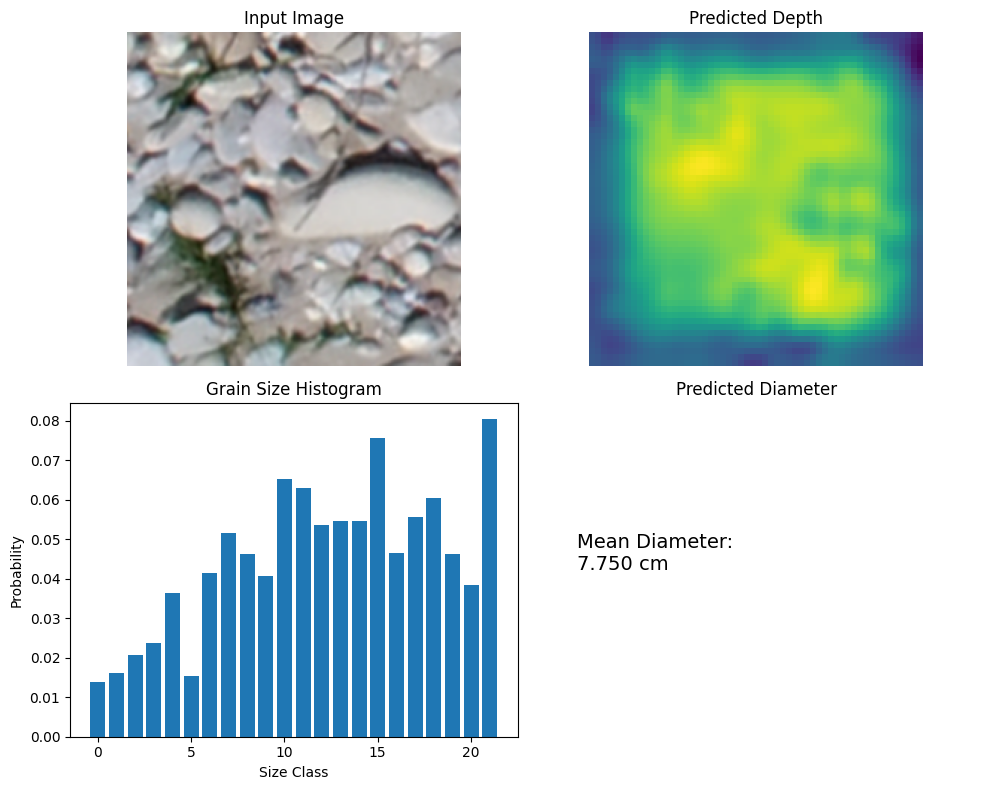

✅ Done!


In [ ]:
# GRAINet Multi-TPU Training - FIXED VERSION
import jax, jax.numpy as jnp, flax.linen as nn, optax, numpy as np, os, json
from einops import rearrange
from pathlib import Path
from functools import partial
import matplotlib.pyplot as plt
from transformers import FlaxViTModel, ViTImageProcessor
from flax.training import train_state
from tqdm import tqdm
from PIL import Image
from skimage.transform import resize

# Multi-TPU Setup
print(f"JAX {jax.__version__} - {jax.local_device_count()} devices: {[d.device_kind for d in jax.devices()]}")
num_devices = jax.local_device_count()
print(f"🚀 Using {num_devices} TPU devices for training")

# Data Download & Setup
def setup_data(output_dir="./grainet_dataset"):
    if not os.path.exists("GRAINet_demo_data.zip"):
        os.system("wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip && unzip -q -o GRAINet_demo_data.zip")

    data = np.load("data_GRAINet_demo/data_KLEmme_1bank.npz", allow_pickle=True)
    images, histograms, diameters = data['images'], data['histograms'], data['dm']

    # FIXED: Check histogram shape to determine correct num_classes
    print(f"📊 Histogram shape: {histograms[0].shape}")
    actual_num_classes = histograms[0].shape[0] if histograms[0].ndim > 0 else len(histograms[0])
    print(f"📊 Detected {actual_num_classes} histogram classes")

    os.makedirs(f"{output_dir}/images", exist_ok=True)
    os.makedirs(f"{output_dir}/histograms", exist_ok=True)
    os.makedirs(f"{output_dir}/mean_diameters", exist_ok=True)

    for i in tqdm(range(len(images)), desc="Processing"):
        img = images[i]
        h, w = img.shape[:2]
        if w != h:
            size = min(w, h)
            img = img[(h-size)//2:(h+size)//2, (w-size)//2:(w+size)//2]

        img_resized = resize(img, (224, 224), anti_aliasing=True, preserve_range=True)
        Image.fromarray(img_resized.astype(np.uint8)).save(f"{output_dir}/images/image_{i:04d}.png")
        np.save(f"{output_dir}/histograms/hist_{i:04d}.npy", histograms[i])
        np.save(f"{output_dir}/mean_diameters/dm_{i:04d}.npy", diameters[i])

    with open(f"{output_dir}/metadata.json", "w") as f:
        json.dump({"num_samples": len(images), "num_classes": actual_num_classes}, f)
    return len(images), actual_num_classes

# FIXED Model with correct num_classes
class GRAINet(nn.Module):
    num_classes: int = 21

    @nn.compact
    def __call__(self, vit_features: list, train: bool = True):
        # Extract patches from key layers
        patches = [rearrange(vit_features[i][:, 1:, :], 'b (h w) c -> b h w c', h=14, w=14)
                  for i in [3, 5, 7, 11]]
        x = jnp.concatenate(patches, axis=-1)  # [B, 14, 14, 3072]

        # Shared processing
        x = nn.gelu(nn.GroupNorm(32)(nn.Conv(512, (3, 3), padding='SAME')(x)))
        x = nn.Dropout(0.1, deterministic=not train)(x)

        # Depth branch
        depth = x
        for channels, size in [(256, 28), (128, 56)]:
            depth = nn.gelu(nn.GroupNorm(channels//16)(nn.Conv(channels, (3, 3), padding='SAME')(depth)))
            depth = jax.image.resize(depth, (depth.shape[0], size, size, channels), 'bilinear')
        depth_map = nn.sigmoid(nn.Conv(1, (1, 1))(depth)).squeeze(-1)

        # Global branch
        global_feat = nn.gelu(nn.GroupNorm(16)(nn.Conv(256, (3, 3), padding='SAME')(x)))
        attn_weights = nn.softmax(rearrange(nn.Dense(1)(global_feat), 'b h w 1 -> b (h w)'), axis=-1)
        pooled = jnp.sum(rearrange(global_feat, 'b h w c -> b (h w) c') * attn_weights[..., None], axis=1)

        # Output heads
        mlp = nn.gelu(nn.Dense(256)(pooled))
        mlp = nn.Dropout(0.2, deterministic=not train)(mlp)
        histogram = nn.softmax(nn.Dense(self.num_classes)(nn.Dense(128)(mlp)))
        diameter = nn.Dense(1)(nn.Dense(64)(mlp))

        return {"depth_map": depth_map, "histogram": histogram, "diameter": diameter}

# MULTI-TPU Data Loader
class MultiTPUDataLoader:
    def __init__(self, data_dir, batch_size, processor, num_devices):
        self.data_dir = Path(data_dir)
        self.batch_size = batch_size
        self.processor = processor
        self.num_devices = num_devices

        # Ensure batch size is divisible by number of devices
        assert batch_size % num_devices == 0, f"Batch size {batch_size} must be divisible by {num_devices} devices"
        self.per_device_batch_size = batch_size // num_devices

        with open(self.data_dir / "metadata.json") as f:
            metadata = json.load(f)
            self.num_samples = metadata["num_samples"]
            self.num_classes = metadata["num_classes"]

        self.indices = np.arange(self.num_samples)
        self.current_idx = 0
        print(f"📦 DataLoader: {self.num_samples} samples, {self.num_classes} classes")
        print(f"📦 Multi-TPU: {batch_size} total batch size, {self.per_device_batch_size} per device")

    def __call__(self):
        # Get batch indices
        batch_indices = []
        for _ in range(self.batch_size):
            if self.current_idx >= self.num_samples:
                np.random.shuffle(self.indices)
                self.current_idx = 0
            batch_indices.append(self.indices[self.current_idx])
            self.current_idx += 1

        images, histograms, diameters, depth_maps = [], [], [], []

        for i in batch_indices:
            # Load image
            images.append(Image.open(self.data_dir / "images" / f"image_{i:04d}.png").convert("RGB"))

            # Load and normalize histogram
            hist = np.load(self.data_dir / "histograms" / f"hist_{i:04d}.npy").astype(np.float32)
            # FIXED: Ensure histogram has correct number of classes
            if len(hist) != self.num_classes:
                if len(hist) > self.num_classes:
                    hist = hist[:self.num_classes]  # Truncate
                else:
                    hist = np.pad(hist, (0, self.num_classes - len(hist)))  # Pad
            histograms.append(hist / (hist.sum() + 1e-9))

            # Load diameter
            diam = np.load(self.data_dir / "mean_diameters" / f"dm_{i:04d}.npy").astype(np.float32)
            if diam.ndim > 0:
                diam = diam.item() if diam.size == 1 else diam[0]
            diameters.append([float(diam)])

            # Generate synthetic depth map
            np.random.seed(i)
            x, y = np.meshgrid(np.linspace(-1, 1, 56), np.linspace(-1, 1, 56))
            depth = np.clip(0.5 + 0.3 * np.exp(-(x**2 + y**2) / 0.5) + 0.1 * np.random.randn(56, 56), 0, 1)
            depth_maps.append(depth.astype(np.float32))

        # Process images
        inputs = self.processor(images, return_tensors="np")
        targets = {
            "depth_map": np.stack(depth_maps),
            "histogram": np.stack(histograms),
            "diameter": np.array(diameters, dtype=np.float32)
        }

        # MULTI-TPU: Reshape for multiple devices [num_devices, per_device_batch_size, ...]
        images_shaped = inputs["pixel_values"].reshape(self.num_devices, self.per_device_batch_size, *inputs["pixel_values"].shape[1:])
        targets_shaped = {
            "depth_map": targets["depth_map"].reshape(self.num_devices, self.per_device_batch_size, *targets["depth_map"].shape[1:]),
            "histogram": targets["histogram"].reshape(self.num_devices, self.per_device_batch_size, *targets["histogram"].shape[1:]),
            "diameter": targets["diameter"].reshape(self.num_devices, self.per_device_batch_size, *targets["diameter"].shape[1:])
        }

        return images_shaped, targets_shaped

# MULTI-TPU Loss function
def loss_fn(params, vit_params, batch, dropout_rng, vit_model=None, model=None):
    images, targets = batch
    vit_out = vit_model(pixel_values=images, params=vit_params, output_hidden_states=True)
    preds = model.apply(params, vit_out.hidden_states, train=True, rngs={'dropout': dropout_rng})

    depth_loss = jnp.mean((preds["depth_map"] - targets["depth_map"]) ** 2)
    hist_loss = -jnp.mean(jnp.sum(targets["histogram"] * jnp.log(preds["histogram"] + 1e-9), axis=-1))
    diam_loss = jnp.mean((preds["diameter"] - targets["diameter"]) ** 2)
    total_loss = depth_loss + hist_loss + diam_loss

    return total_loss, {"total": total_loss, "depth": depth_loss, "hist": hist_loss, "diam": diam_loss}

# MULTI-TPU Training Step using pmap
def create_multi_tpu_train_step(vit_model, model):
    @partial(jax.pmap, axis_name='devices')
    def train_step(state, vit_params, batch, dropout_rng):
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(
            state.params, vit_params, batch, dropout_rng, vit_model=vit_model, model=model)

        # Average gradients across devices
        grads = jax.lax.pmean(grads, axis_name='devices')
        new_state = state.apply_gradients(grads=grads)

        # Average metrics across devices
        metrics = jax.lax.pmean(metrics, axis_name='devices')

        return new_state, metrics, jax.random.split(dropout_rng)[0]
    return train_step

# Single device fallback
def create_single_train_step(vit_model, model):
    @jax.jit
    def train_step(state, vit_params, batch, dropout_rng):
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(
            state.params, vit_params, batch, dropout_rng, vit_model=vit_model, model=model)
        new_state = state.apply_gradients(grads=grads)
        return new_state, metrics, jax.random.split(dropout_rng)[0]
    return train_step

# MULTI-TPU Training Function
def train(epochs=10, batch_size=32, lr=1e-4, use_multi_tpu=True):
    print("🚀 Starting multi-TPU training...")

    # Load dataset first to get num_classes
    num_samples, num_classes = setup_data()
    print(f"✅ Dataset ready: {num_samples} samples, {num_classes} classes")

    # Adjust batch size for multi-TPU
    if use_multi_tpu and num_devices > 1:
        if batch_size % num_devices != 0:
            batch_size = ((batch_size // num_devices) + 1) * num_devices
            print(f"📦 Adjusted batch size to {batch_size} for {num_devices} devices")

    # Load components
    vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
    data_loader = MultiTPUDataLoader("./grainet_dataset", batch_size, processor, num_devices if use_multi_tpu else 1)

    # Initialize model with correct num_classes
    rng = jax.random.PRNGKey(42)
    model = GRAINet(num_classes=num_classes)
    dummy_features = [jnp.ones((1, 197, 768)) for _ in range(12)]
    params = model.init(rng, dummy_features, train=False)

    # Training state
    state = train_state.TrainState.create(
        apply_fn=model.apply, params=params,
        tx=optax.adamw(lr, weight_decay=1e-5)
    )

    # Choose training approach
    if use_multi_tpu and num_devices > 1:
        print(f"📦 Using multi-TPU training with {num_devices} devices")
        train_step = create_multi_tpu_train_step(vit_model, model)

        # Replicate state and vit_params across devices
        state = jax.device_put_replicated(state, jax.devices())
        vit_params_replicated = jax.device_put_replicated(vit_model.params, jax.devices())
    else:
        print("📦 Using single device training")
        train_step = create_single_train_step(vit_model, model)
        vit_params_replicated = vit_model.params
        use_multi_tpu = False

    # Training loop
    history = []
    steps_per_epoch = max(1, data_loader.num_samples // batch_size)

    if use_multi_tpu:
        # Create different random keys for each device
        dropout_rng = jax.random.split(jax.random.PRNGKey(123), num_devices)
    else:
        dropout_rng = jax.random.PRNGKey(123)

    for epoch in range(epochs):
        epoch_metrics = []

        for step in tqdm(range(steps_per_epoch), desc=f"Epoch {epoch+1}/{epochs}"):
            try:
                # Get batch
                images, targets = data_loader()

                if use_multi_tpu:
                    # Multi-TPU training step
                    state, metrics, dropout_rng = train_step(
                        state, vit_params_replicated, (images, targets), dropout_rng)
                    # Take metrics from first device (they're averaged)
                    step_metrics = {k: float(v[0]) for k, v in metrics.items()}
                else:
                    # Single device training step
                    # Flatten batch for single device
                    images_flat = images.reshape(-1, *images.shape[2:])
                    targets_flat = {k: v.reshape(-1, *v.shape[2:]) for k, v in targets.items()}

                    state, metrics, dropout_rng = train_step(
                        state, vit_params_replicated, (images_flat, targets_flat), dropout_rng)
                    step_metrics = {k: float(v) for k, v in metrics.items()}

                epoch_metrics.append(step_metrics)

            except Exception as e:
                print(f"❌ Error in step {step}: {e}")
                import traceback
                traceback.print_exc()
                continue

        if not epoch_metrics:
            print(f"⚠️  No valid batches in epoch {epoch+1}")
            continue

        # Epoch summary
        avg_metrics = {k: np.mean([m[k] for m in epoch_metrics]) for k in epoch_metrics[0].keys()}
        history.append(avg_metrics)
        print(f"Epoch {epoch+1}: Loss={avg_metrics['total']:.4f} | "
              f"Depth={avg_metrics['depth']:.4f} | "
              f"Hist={avg_metrics['hist']:.4f} | "
              f"Diam={avg_metrics['diam']:.4f}")

        # Save checkpoint
        if (epoch + 1) % 5 == 0:
            save_path = f"./checkpoint_epoch_{epoch+1}.npz"
            # Save from first device if using multi-TPU
            if use_multi_tpu:
                # Use jax.device_get to extract state from first device
                save_state = jax.device_get(jax.tree.map(lambda x: x[0], state))
                save_vit_params = jax.device_get(jax.tree.map(lambda x: x[0], vit_params_replicated))
            else:
                save_state = state
                save_vit_params = vit_params_replicated

            np.savez(save_path,
                    params=save_state.params,
                    vit_params=save_vit_params,
                    history=history,
                    num_classes=num_classes)
            print(f"💾 Saved: {save_path}")

    return state, history

# Updated Inference
class Predictor:
    def __init__(self, checkpoint_path):
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params = ckpt["params"].item()
        self.vit_params = ckpt["vit_params"].item()
        self.num_classes = ckpt.get("num_classes", 21)  # Default to 21 if not saved

        self.vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
        self.processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
        self.model = GRAINet(num_classes=self.num_classes)

    def predict(self, image_path):
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        vit_out = self.vit_model(pixel_values=inputs["pixel_values"], params=self.vit_params, output_hidden_states=True)
        preds = self.model.apply(self.params, vit_out.hidden_states, train=False)

        return {
            "image": image,
            "depth_map": np.array(preds["depth_map"][0]),
            "histogram": np.array(preds["histogram"][0]),
            "diameter": float(preds["diameter"][0, 0])
        }

# Visualization
def plot_results(result):
    fig, axes = plt.subplots(2, 2, figsize=(10, 8))
    axes[0,0].imshow(result["image"]); axes[0,0].set_title("Input Image"); axes[0,0].axis('off')
    axes[0,1].imshow(result["depth_map"], cmap='viridis'); axes[0,1].set_title("Predicted Depth"); axes[0,1].axis('off')
    axes[1,0].bar(range(len(result["histogram"])), result["histogram"]); axes[1,0].set_title("Grain Size Histogram")
    axes[1,0].set_xlabel("Size Class"); axes[1,0].set_ylabel("Probability")
    axes[1,1].text(0.1, 0.5, f"Mean Diameter:\n{result['diameter']:.3f} cm", fontsize=14,
                  transform=axes[1,1].transAxes); axes[1,1].set_title("Predicted Diameter"); axes[1,1].axis('off')
    plt.tight_layout(); plt.show()

# FINAL Pipeline
def run_pipeline():
    print("📥 Setting up data...")

    print("\n🔥 Training model...")
    # Use larger batch size for multi-TPU (should be divisible by 8 for 8 TPUs)
    state, history = train(epochs=10, batch_size=64, use_multi_tpu=True)

    print("\n🧪 Testing...")
    checkpoint_path = None
    for epoch in [10, 5]:
        test_path = f"./checkpoint_epoch_{epoch}.npz"
        if os.path.exists(test_path):
            checkpoint_path = test_path
            break

    if checkpoint_path is None:
        print("❌ No checkpoint found! Training may have failed.")
        return state, history, None

    predictor = Predictor(checkpoint_path)
    result = predictor.predict("./grainet_dataset/images/image_0000.png")
    plot_results(result)
    print("✅ Done!")

    return state, history, result

# Execute
if __name__ == "__main__":
    run_pipeline()

# new code with soil texture and grading too

In [ ]:
!pip install python-ternary

🔺 Using python-ternary for professional soil triangle
JAX 0.6.1 - 8 devices: ['TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2', 'TPU v2']
🚀 Using 8 TPU devices for training
📥 Setting up data...

🔥 Training model...
🚀 Starting multi-TPU training...
📊 Histogram shape: (22,)
📊 Detected 22 histogram classes


Processing: 100%|██████████| 212/212 [00:08<00:00, 25.02it/s]


✅ Dataset ready: 212 samples, 22 classes
📦 DataLoader: 212 samples, 22 classes
📦 Multi-TPU: 64 total batch size, 8 per device
📦 Using multi-TPU training with 8 devices


Epoch 1/10: 100%|██████████| 3/3 [00:32<00:00, 10.81s/it]


Epoch 1: Loss=70.2875 | Depth=0.0316 | Hist=3.1613 | Diam=67.0945


Epoch 2/10: 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]


Epoch 2: Loss=26.7878 | Depth=0.0227 | Hist=3.7112 | Diam=23.0540


Epoch 3/10: 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]


Epoch 3: Loss=12.3302 | Depth=0.0169 | Hist=4.2787 | Diam=8.0346


Epoch 4/10: 100%|██████████| 3/3 [00:01<00:00,  1.70it/s]


Epoch 4: Loss=10.9315 | Depth=0.0157 | Hist=4.0744 | Diam=6.8415


Epoch 5/10: 100%|██████████| 3/3 [00:01<00:00,  2.91it/s]


Epoch 5: Loss=11.4848 | Depth=0.0141 | Hist=3.6701 | Diam=7.8006
💾 Saved: ./checkpoint_epoch_5.npz


Epoch 6/10: 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]


Epoch 6: Loss=11.2116 | Depth=0.0134 | Hist=3.5338 | Diam=7.6644


Epoch 7/10: 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]


Epoch 7: Loss=11.9179 | Depth=0.0134 | Hist=3.4590 | Diam=8.4455


Epoch 8/10: 100%|██████████| 3/3 [00:01<00:00,  2.85it/s]


Epoch 8: Loss=9.1242 | Depth=0.0128 | Hist=3.3949 | Diam=5.7164


Epoch 9/10: 100%|██████████| 3/3 [00:01<00:00,  1.70it/s]


Epoch 9: Loss=11.1322 | Depth=0.0128 | Hist=3.3472 | Diam=7.7722


Epoch 10/10: 100%|██████████| 3/3 [00:01<00:00,  2.83it/s]


Epoch 10: Loss=8.1565 | Depth=0.0125 | Hist=3.3108 | Diam=4.8332
💾 Saved: ./checkpoint_epoch_10.npz

🧪 Testing with enhanced geological analysis...
📊 Standard Analysis:


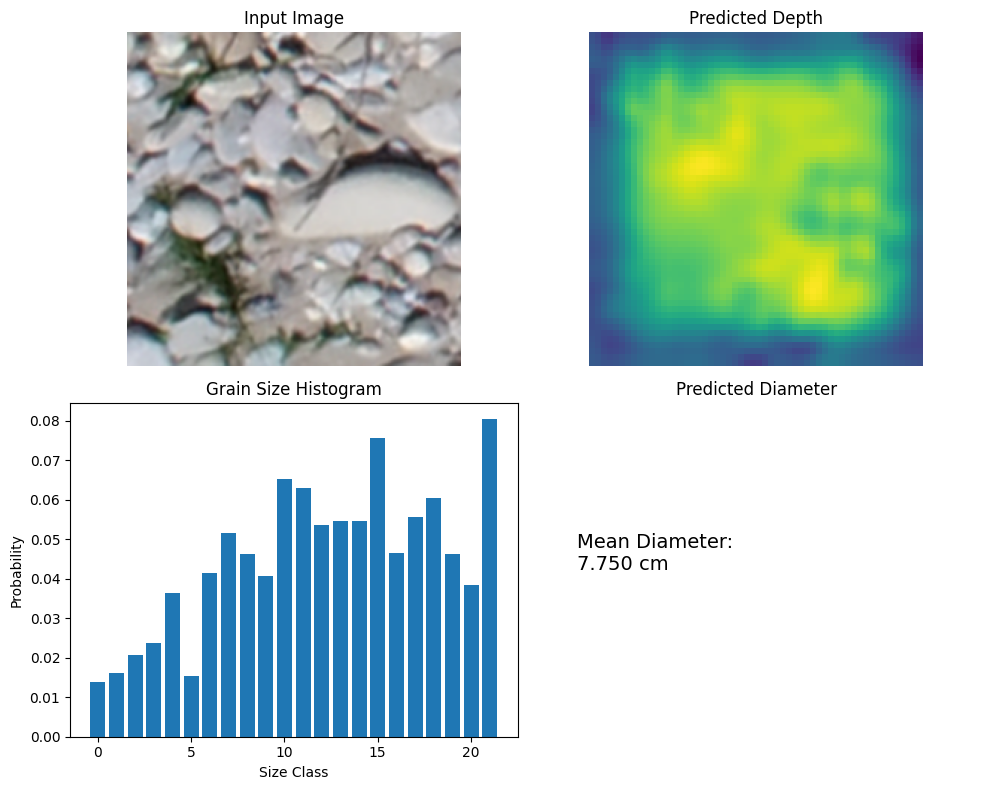


🪨 Geological Analysis:


TypeError: TernaryAxesSubplot.annotate() missing 1 required positional argument: 'position'

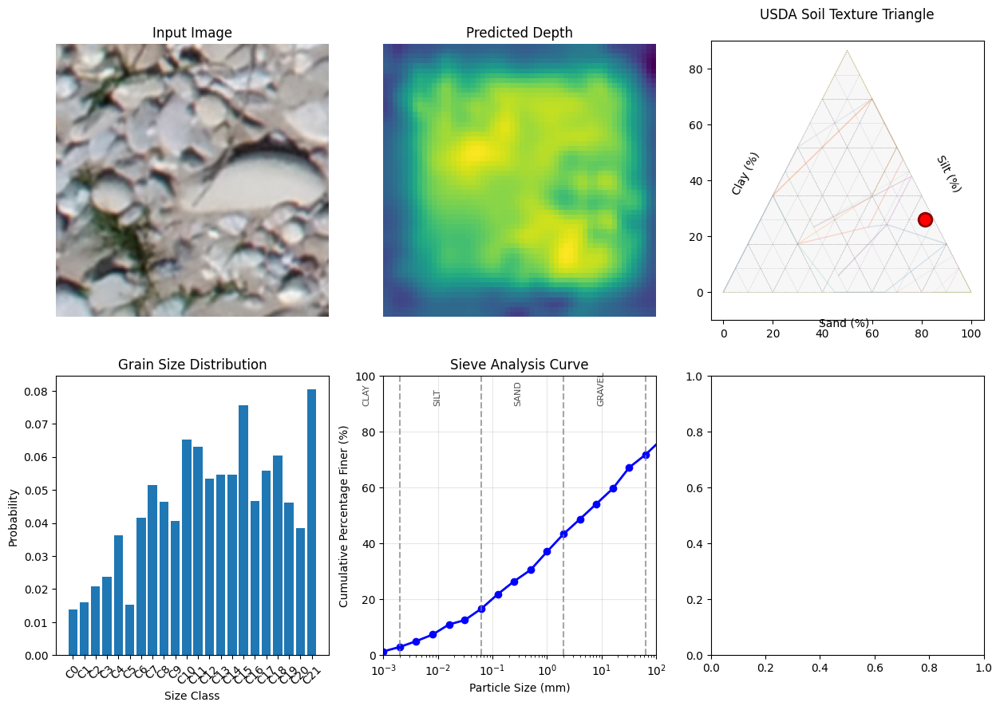

In [ ]:
# Enhanced imports for ternary diagrams
import jax, jax.numpy as jnp, flax.linen as nn, optax, numpy as np, os, json
from einops import rearrange
from pathlib import Path
from functools import partial
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from transformers import FlaxViTModel, ViTImageProcessor
from flax.training import train_state
from tqdm import tqdm
from PIL import Image
from skimage.transform import resize

# Try to import ternary, fall back to manual if not available
try:
    import ternary
    TERNARY_AVAILABLE = True
    print("🔺 Using python-ternary for professional soil triangle")
except ImportError:
    TERNARY_AVAILABLE = False
    print("🔺 Using matplotlib for soil triangle (install python-ternary for better results)")

# Multi-TPU Setup
print(f"JAX {jax.__version__} - {jax.local_device_count()} devices: {[d.device_kind for d in jax.devices()]}")
num_devices = jax.local_device_count()
print(f"🚀 Using {num_devices} TPU devices for training")

# Data Download & Setup
def setup_data(output_dir="./grainet_dataset"):
    if not os.path.exists("GRAINet_demo_data.zip"):
        os.system("wget -nc https://share.phys.ethz.ch/~pf/nlangdata/GRAINet_demo_data.zip && unzip -q -o GRAINet_demo_data.zip")

    data = np.load("data_GRAINet_demo/data_KLEmme_1bank.npz", allow_pickle=True)
    images, histograms, diameters = data['images'], data['histograms'], data['dm']

    # FIXED: Check histogram shape to determine correct num_classes
    print(f"📊 Histogram shape: {histograms[0].shape}")
    actual_num_classes = histograms[0].shape[0] if histograms[0].ndim > 0 else len(histograms[0])
    print(f"📊 Detected {actual_num_classes} histogram classes")

    os.makedirs(f"{output_dir}/images", exist_ok=True)
    os.makedirs(f"{output_dir}/histograms", exist_ok=True)
    os.makedirs(f"{output_dir}/mean_diameters", exist_ok=True)

    for i in tqdm(range(len(images)), desc="Processing"):
        img = images[i]
        h, w = img.shape[:2]
        if w != h:
            size = min(w, h)
            img = img[(h-size)//2:(h+size)//2, (w-size)//2:(w+size)//2]

        img_resized = resize(img, (224, 224), anti_aliasing=True, preserve_range=True)
        Image.fromarray(img_resized.astype(np.uint8)).save(f"{output_dir}/images/image_{i:04d}.png")
        np.save(f"{output_dir}/histograms/hist_{i:04d}.npy", histograms[i])
        np.save(f"{output_dir}/mean_diameters/dm_{i:04d}.npy", diameters[i])

    with open(f"{output_dir}/metadata.json", "w") as f:
        json.dump({"num_samples": len(images), "num_classes": actual_num_classes}, f)
    return len(images), actual_num_classes

# FIXED Model with correct num_classes
class GRAINet(nn.Module):
    num_classes: int = 21

    @nn.compact
    def __call__(self, vit_features: list, train: bool = True):
        # Extract patches from key layers
        patches = [rearrange(vit_features[i][:, 1:, :], 'b (h w) c -> b h w c', h=14, w=14)
                  for i in [3, 5, 7, 11]]
        x = jnp.concatenate(patches, axis=-1)  # [B, 14, 14, 3072]

        # Shared processing
        x = nn.gelu(nn.GroupNorm(32)(nn.Conv(512, (3, 3), padding='SAME')(x)))
        x = nn.Dropout(0.1, deterministic=not train)(x)

        # Depth branch
        depth = x
        for channels, size in [(256, 28), (128, 56)]:
            depth = nn.gelu(nn.GroupNorm(channels//16)(nn.Conv(channels, (3, 3), padding='SAME')(depth)))
            depth = jax.image.resize(depth, (depth.shape[0], size, size, channels), 'bilinear')
        depth_map = nn.sigmoid(nn.Conv(1, (1, 1))(depth)).squeeze(-1)

        # Global branch
        global_feat = nn.gelu(nn.GroupNorm(16)(nn.Conv(256, (3, 3), padding='SAME')(x)))
        attn_weights = nn.softmax(rearrange(nn.Dense(1)(global_feat), 'b h w 1 -> b (h w)'), axis=-1)
        pooled = jnp.sum(rearrange(global_feat, 'b h w c -> b (h w) c') * attn_weights[..., None], axis=1)

        # Output heads
        mlp = nn.gelu(nn.Dense(256)(pooled))
        mlp = nn.Dropout(0.2, deterministic=not train)(mlp)
        histogram = nn.softmax(nn.Dense(self.num_classes)(nn.Dense(128)(mlp)))
        diameter = nn.Dense(1)(nn.Dense(64)(mlp))

        return {"depth_map": depth_map, "histogram": histogram, "diameter": diameter}

# MULTI-TPU Data Loader
class MultiTPUDataLoader:
    def __init__(self, data_dir, batch_size, processor, num_devices):
        self.data_dir = Path(data_dir)
        self.batch_size = batch_size
        self.processor = processor
        self.num_devices = num_devices

        # Ensure batch size is divisible by number of devices
        assert batch_size % num_devices == 0, f"Batch size {batch_size} must be divisible by {num_devices} devices"
        self.per_device_batch_size = batch_size // num_devices

        with open(self.data_dir / "metadata.json") as f:
            metadata = json.load(f)
            self.num_samples = metadata["num_samples"]
            self.num_classes = metadata["num_classes"]

        self.indices = np.arange(self.num_samples)
        self.current_idx = 0
        print(f"📦 DataLoader: {self.num_samples} samples, {self.num_classes} classes")
        print(f"📦 Multi-TPU: {batch_size} total batch size, {self.per_device_batch_size} per device")

    def __call__(self):
        # Get batch indices
        batch_indices = []
        for _ in range(self.batch_size):
            if self.current_idx >= self.num_samples:
                np.random.shuffle(self.indices)
                self.current_idx = 0
            batch_indices.append(self.indices[self.current_idx])
            self.current_idx += 1

        images, histograms, diameters, depth_maps = [], [], [], []

        for i in batch_indices:
            # Load image
            images.append(Image.open(self.data_dir / "images" / f"image_{i:04d}.png").convert("RGB"))

            # Load and normalize histogram
            hist = np.load(self.data_dir / "histograms" / f"hist_{i:04d}.npy").astype(np.float32)
            # FIXED: Ensure histogram has correct number of classes
            if len(hist) != self.num_classes:
                if len(hist) > self.num_classes:
                    hist = hist[:self.num_classes]  # Truncate
                else:
                    hist = np.pad(hist, (0, self.num_classes - len(hist)))  # Pad
            histograms.append(hist / (hist.sum() + 1e-9))

            # Load diameter
            diam = np.load(self.data_dir / "mean_diameters" / f"dm_{i:04d}.npy").astype(np.float32)
            if diam.ndim > 0:
                diam = diam.item() if diam.size == 1 else diam[0]
            diameters.append([float(diam)])

            # Generate synthetic depth map
            np.random.seed(i)
            x, y = np.meshgrid(np.linspace(-1, 1, 56), np.linspace(-1, 1, 56))
            depth = np.clip(0.5 + 0.3 * np.exp(-(x**2 + y**2) / 0.5) + 0.1 * np.random.randn(56, 56), 0, 1)
            depth_maps.append(depth.astype(np.float32))

        # Process images
        inputs = self.processor(images, return_tensors="np")
        targets = {
            "depth_map": np.stack(depth_maps),
            "histogram": np.stack(histograms),
            "diameter": np.array(diameters, dtype=np.float32)
        }

        # MULTI-TPU: Reshape for multiple devices [num_devices, per_device_batch_size, ...]
        images_shaped = inputs["pixel_values"].reshape(self.num_devices, self.per_device_batch_size, *inputs["pixel_values"].shape[1:])
        targets_shaped = {
            "depth_map": targets["depth_map"].reshape(self.num_devices, self.per_device_batch_size, *targets["depth_map"].shape[1:]),
            "histogram": targets["histogram"].reshape(self.num_devices, self.per_device_batch_size, *targets["histogram"].shape[1:]),
            "diameter": targets["diameter"].reshape(self.num_devices, self.per_device_batch_size, *targets["diameter"].shape[1:])
        }

        return images_shaped, targets_shaped

# MULTI-TPU Loss function
def loss_fn(params, vit_params, batch, dropout_rng, vit_model=None, model=None):
    images, targets = batch
    vit_out = vit_model(pixel_values=images, params=vit_params, output_hidden_states=True)
    preds = model.apply(params, vit_out.hidden_states, train=True, rngs={'dropout': dropout_rng})

    depth_loss = jnp.mean((preds["depth_map"] - targets["depth_map"]) ** 2)
    hist_loss = -jnp.mean(jnp.sum(targets["histogram"] * jnp.log(preds["histogram"] + 1e-9), axis=-1))
    diam_loss = jnp.mean((preds["diameter"] - targets["diameter"]) ** 2)
    total_loss = depth_loss + hist_loss + diam_loss

    return total_loss, {"total": total_loss, "depth": depth_loss, "hist": hist_loss, "diam": diam_loss}

# MULTI-TPU Training Step using pmap
def create_multi_tpu_train_step(vit_model, model):
    @partial(jax.pmap, axis_name='devices')
    def train_step(state, vit_params, batch, dropout_rng):
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(
            state.params, vit_params, batch, dropout_rng, vit_model=vit_model, model=model)

        # Average gradients across devices
        grads = jax.lax.pmean(grads, axis_name='devices')
        new_state = state.apply_gradients(grads=grads)

        # Average metrics across devices
        metrics = jax.lax.pmean(metrics, axis_name='devices')

        return new_state, metrics, jax.random.split(dropout_rng)[0]
    return train_step

# Single device fallback
def create_single_train_step(vit_model, model):
    @jax.jit
    def train_step(state, vit_params, batch, dropout_rng):
        (loss, metrics), grads = jax.value_and_grad(loss_fn, has_aux=True)(
            state.params, vit_params, batch, dropout_rng, vit_model=vit_model, model=model)
        new_state = state.apply_gradients(grads=grads)
        return new_state, metrics, jax.random.split(dropout_rng)[0]
    return train_step

# MULTI-TPU Training Function
def train(epochs=10, batch_size=32, lr=1e-4, use_multi_tpu=True):
    print("🚀 Starting multi-TPU training...")

    # Load dataset first to get num_classes
    num_samples, num_classes = setup_data()
    print(f"✅ Dataset ready: {num_samples} samples, {num_classes} classes")

    # Adjust batch size for multi-TPU
    if use_multi_tpu and num_devices > 1:
        if batch_size % num_devices != 0:
            batch_size = ((batch_size // num_devices) + 1) * num_devices
            print(f"📦 Adjusted batch size to {batch_size} for {num_devices} devices")

    # Load components
    vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
    data_loader = MultiTPUDataLoader("./grainet_dataset", batch_size, processor, num_devices if use_multi_tpu else 1)

    # Initialize model with correct num_classes
    rng = jax.random.PRNGKey(42)
    model = GRAINet(num_classes=num_classes)
    dummy_features = [jnp.ones((1, 197, 768)) for _ in range(12)]
    params = model.init(rng, dummy_features, train=False)

    # Training state
    state = train_state.TrainState.create(
        apply_fn=model.apply, params=params,
        tx=optax.adamw(lr, weight_decay=1e-5)
    )

    # Choose training approach
    if use_multi_tpu and num_devices > 1:
        print(f"📦 Using multi-TPU training with {num_devices} devices")
        train_step = create_multi_tpu_train_step(vit_model, model)

        # Replicate state and vit_params across devices
        state = jax.device_put_replicated(state, jax.devices())
        vit_params_replicated = jax.device_put_replicated(vit_model.params, jax.devices())
    else:
        print("📦 Using single device training")
        train_step = create_single_train_step(vit_model, model)
        vit_params_replicated = vit_model.params
        use_multi_tpu = False

    # Training loop
    history = []
    steps_per_epoch = max(1, data_loader.num_samples // batch_size)

    if use_multi_tpu:
        # Create different random keys for each device
        dropout_rng = jax.random.split(jax.random.PRNGKey(123), num_devices)
    else:
        dropout_rng = jax.random.PRNGKey(123)

    for epoch in range(epochs):
        epoch_metrics = []

        for step in tqdm(range(steps_per_epoch), desc=f"Epoch {epoch+1}/{epochs}"):
            try:
                # Get batch
                images, targets = data_loader()

                if use_multi_tpu:
                    # Multi-TPU training step
                    state, metrics, dropout_rng = train_step(
                        state, vit_params_replicated, (images, targets), dropout_rng)
                    # Take metrics from first device (they're averaged)
                    step_metrics = {k: float(v[0]) for k, v in metrics.items()}
                else:
                    # Single device training step
                    # Flatten batch for single device
                    images_flat = images.reshape(-1, *images.shape[2:])
                    targets_flat = {k: v.reshape(-1, *v.shape[2:]) for k, v in targets.items()}

                    state, metrics, dropout_rng = train_step(
                        state, vit_params_replicated, (images_flat, targets_flat), dropout_rng)
                    step_metrics = {k: float(v) for k, v in metrics.items()}

                epoch_metrics.append(step_metrics)

            except Exception as e:
                print(f"❌ Error in step {step}: {e}")
                import traceback
                traceback.print_exc()
                continue

        if not epoch_metrics:
            print(f"⚠️  No valid batches in epoch {epoch+1}")
            continue

        # Epoch summary
        avg_metrics = {k: np.mean([m[k] for m in epoch_metrics]) for k in epoch_metrics[0].keys()}
        history.append(avg_metrics)
        print(f"Epoch {epoch+1}: Loss={avg_metrics['total']:.4f} | "
              f"Depth={avg_metrics['depth']:.4f} | "
              f"Hist={avg_metrics['hist']:.4f} | "
              f"Diam={avg_metrics['diam']:.4f}")

        # Save checkpoint
        if (epoch + 1) % 5 == 0:
            save_path = f"./checkpoint_epoch_{epoch+1}.npz"
            # Save from first device if using multi-TPU
            if use_multi_tpu:
                # Use jax.device_get to extract state from first device
                save_state = jax.device_get(jax.tree.map(lambda x: x[0], state))
                save_vit_params = jax.device_get(jax.tree.map(lambda x: x[0], vit_params_replicated))
            else:
                save_state = state
                save_vit_params = vit_params_replicated

            np.savez(save_path,
                    params=save_state.params,
                    vit_params=save_vit_params,
                    history=history,
                    num_classes=num_classes)
            print(f"💾 Saved: {save_path}")

    return state, history

# Updated Inference
class Predictor:
    def __init__(self, checkpoint_path):
        ckpt = np.load(checkpoint_path, allow_pickle=True)
        self.params = ckpt["params"].item()
        self.vit_params = ckpt["vit_params"].item()
        self.num_classes = ckpt.get("num_classes", 21)  # Default to 21 if not saved

        self.vit_model = FlaxViTModel.from_pretrained("google/vit-base-patch16-224-in21k", output_hidden_states=True)
        self.processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
        self.model = GRAINet(num_classes=self.num_classes)

    def predict(self, image_path):
        image = Image.open(image_path).convert("RGB")
        inputs = self.processor(images=image, return_tensors="np")
        vit_out = self.vit_model(pixel_values=inputs["pixel_values"], params=self.vit_params, output_hidden_states=True)
        preds = self.model.apply(self.params, vit_out.hidden_states, train=False)

        return {
            "image": image,
            "depth_map": np.array(preds["depth_map"][0]),
            "histogram": np.array(preds["histogram"][0]),
            "diameter": float(preds["diameter"][0, 0])
        }

# Updated Visualization with Geological Standards
def plot_results(result, show_geological=True):
    if show_geological:
        fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    else:
        fig, axes = plt.subplots(2, 2, figsize=(10, 8))

    # Original plots
    axes[0,0].imshow(result["image"]); axes[0,0].set_title("Input Image"); axes[0,0].axis('off')
    axes[0,1].imshow(result["depth_map"], cmap='viridis'); axes[0,1].set_title("Predicted Depth"); axes[0,1].axis('off')

    if show_geological:
        # Enhanced histogram with geological classes
        geological_labels = get_geological_class_labels()
        axes[1,0].bar(range(len(result["histogram"])), result["histogram"],
                     tick_label=[f"C{i}" for i in range(len(result["histogram"]))])
        axes[1,0].set_title("Grain Size Distribution")
        axes[1,0].set_xlabel("Size Class"); axes[1,0].set_ylabel("Probability")
        axes[1,0].tick_params(axis='x', rotation=45)

        # Sieve analysis plot
        plot_sieve_analysis(result["histogram"], axes[1,1])

        # Soil triangle
        plot_soil_triangle(result["histogram"], axes[0,2])

        # Diameter info
        axes[1,2].text(0.1, 0.5, f"Mean Diameter:\n{result['diameter']:.3f} cm\n\n" +
                      f"Classification:\n{classify_soil_type(result['histogram'])}",
                      fontsize=12, transform=axes[1,2].transAxes)
        axes[1,2].set_title("Soil Classification"); axes[1,2].axis('off')
    else:
        # Original simple plots
        axes[1,0].bar(range(len(result["histogram"])), result["histogram"])
        axes[1,0].set_title("Grain Size Histogram")
        axes[1,0].set_xlabel("Size Class"); axes[1,0].set_ylabel("Probability")
        axes[1,1].text(0.1, 0.5, f"Mean Diameter:\n{result['diameter']:.3f} cm", fontsize=14,
                      transform=axes[1,1].transAxes)
        axes[1,1].set_title("Predicted Diameter"); axes[1,1].axis('off')

    plt.tight_layout(); plt.show()

# Geological grain size classification
def get_geological_class_labels():
    """Standard geological grain size classes based on Wentworth scale"""
    return [
        "Clay (<0.002mm)", "Fine Silt", "Medium Silt", "Coarse Silt",
        "Very Fine Sand", "Fine Sand", "Medium Sand", "Coarse Sand", "Very Coarse Sand",
        "Granules", "Fine Pebbles", "Medium Pebbles", "Coarse Pebbles",
        "Small Cobbles", "Large Cobbles", "Small Boulders", "Medium Boulders", "Large Boulders",
        "Very Large Boulders", "Megaboulders", "Extra Large", "Extreme"
    ]

def get_size_boundaries_mm():
    """Size boundaries in mm for each class (Wentworth scale)"""
    return np.array([
        0.001, 0.002, 0.004, 0.008, 0.016, 0.031, 0.063, 0.125, 0.25, 0.5,
        1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0
    ])

def plot_sieve_analysis(histogram, ax):
    """Plot cumulative grain size distribution (sieve analysis)"""
    size_boundaries = get_size_boundaries_mm()
    cumulative = np.cumsum(histogram)

    # Plot cumulative curve
    ax.semilogx(size_boundaries, cumulative * 100, 'b-', linewidth=2, marker='o')
    ax.set_xlabel('Particle Size (mm)')
    ax.set_ylabel('Cumulative Percentage Finer (%)')
    ax.set_title('Sieve Analysis Curve')
    ax.grid(True, alpha=0.3)
    ax.set_xlim(0.001, 100)
    ax.set_ylim(0, 100)

    # Add geological boundaries
    ax.axvline(0.002, color='gray', linestyle='--', alpha=0.7, label='Clay|Silt')
    ax.axvline(0.063, color='gray', linestyle='--', alpha=0.7, label='Silt|Sand')
    ax.axvline(2.0, color='gray', linestyle='--', alpha=0.7, label='Sand|Gravel')
    ax.axvline(64.0, color='gray', linestyle='--', alpha=0.7, label='Gravel|Cobble')

    # Add text labels
    ax.text(0.0005, 90, 'CLAY', rotation=90, ha='center', fontsize=8, alpha=0.7)
    ax.text(0.01, 90, 'SILT', rotation=90, ha='center', fontsize=8, alpha=0.7)
    ax.text(0.3, 90, 'SAND', rotation=90, ha='center', fontsize=8, alpha=0.7)
    ax.text(10, 90, 'GRAVEL', rotation=90, ha='center', fontsize=8, alpha=0.7)

def plot_soil_triangle(histogram, ax):
    """Plot professional soil texture triangle using ternary diagram"""
    if TERNARY_AVAILABLE:
        plot_soil_triangle_ternary(histogram, ax)
    else:
        plot_soil_triangle_matplotlib(histogram, ax)

def plot_soil_triangle_ternary(histogram, ax):
    """Create professional ternary soil triangle using python-ternary"""
    # Calculate percentages
    clay_pct, silt_pct, sand_pct = calculate_texture_percentages(histogram)

    # Clear the axes and create ternary plot
    ax.clear()

    # Create ternary figure
    figure, tax = ternary.figure(ax=ax, scale=100)
    tax.set_title("USDA Soil Texture Triangle", fontsize=12, pad=20)

    # Define soil classification regions (simplified)
    soil_regions = {
        'Clay': [(0, 0, 100), (0, 40, 60), (20, 20, 60), (45, 0, 55)],
        'Sandy Clay': [(0, 0, 100), (45, 0, 55), (65, 0, 35), (100, 0, 0)],
        'Silty Clay': [(0, 0, 100), (0, 40, 60), (0, 60, 40), (20, 80, 0)],
        'Clay Loam': [(20, 20, 60), (45, 27, 28), (45, 55, 0), (20, 80, 0), (0, 40, 60)],
        'Sandy Clay Loam': [(45, 0, 55), (65, 0, 35), (80, 20, 0), (52, 28, 20), (45, 27, 28)],
        'Silty Clay Loam': [(0, 40, 60), (20, 80, 0), (40, 60, 0), (40, 40, 20), (20, 20, 60)],
        'Sand': [(85, 0, 15), (100, 0, 0), (90, 10, 0)],
        'Loamy Sand': [(70, 0, 30), (85, 0, 15), (90, 10, 0), (85, 15, 0)],
        'Sandy Loam': [(50, 0, 50), (70, 0, 30), (85, 15, 0), (80, 20, 0), (52, 28, 20), (43, 7, 50)],
        'Loam': [(43, 7, 50), (52, 28, 20), (52, 48, 0), (23, 27, 50)],
        'Silt Loam': [(0, 50, 50), (23, 27, 50), (50, 50, 0), (20, 80, 0)],
        'Silt': [(0, 80, 20), (0, 100, 0), (20, 80, 0)]
    }

    # Plot regions with different colors
    colors = plt.cm.Set3(np.linspace(0, 1, len(soil_regions)))
    for i, (region_name, points) in enumerate(soil_regions.items()):
        if len(points) >= 3:  # Need at least 3 points for a polygon
            tax.plot(points, color=colors[i], alpha=0.3, linewidth=1, label=region_name)

    # Add gridlines
    tax.gridlines(multiple=10, color="gray", alpha=0.5)
    tax.gridlines(multiple=20, color="gray", alpha=0.7)

    # Set axis labels
    tax.left_axis_label("Clay (%)", fontsize=10, offset=0.16)
    tax.right_axis_label("Silt (%)", fontsize=10, offset=0.16)
    tax.bottom_axis_label("Sand (%)", fontsize=10, offset=0.05)

    # Plot sample point
    sample_point = (sand_pct, silt_pct, clay_pct)
    tax.plot([sample_point], marker='o', color='red', markersize=12,
             markeredgecolor='darkred', markeredgewidth=2, zorder=10)

    # Add sample annotation
    soil_type = classify_soil_type(histogram)
    tax.annotate(f'{soil_type}\nS:{sand_pct:.1f}%\nSi:{silt_pct:.1f}%\nC:{clay_pct:.1f}%',
                xy=sample_point, xytext=(10, 10), textcoords='offset points',
                bbox=dict(boxstyle="round,pad=0.5", facecolor="yellow", alpha=0.8),
                fontsize=9, ha='left')

    # Add percentage ticks
    tax.ticks(axis='lbr', multiple=20, linewidth=1, tick_formats="%.0f")

    # Clean up
    tax.clear_matplotlib_ticks()
    tax.boundary(linewidth=2)

def plot_soil_triangle_matplotlib(histogram, ax):
    """Fallback matplotlib-based soil triangle with improved styling"""
    # Calculate percentages
    clay_pct, silt_pct, sand_pct = calculate_texture_percentages(histogram)

    # Clear axes
    ax.clear()

    # Create enhanced triangle background
    create_enhanced_soil_triangle_background(ax)

    # Plot the sample point
    x, y = ternary_to_cartesian(sand_pct, silt_pct, clay_pct)

    # Add colored regions (simplified)
    add_soil_classification_regions(ax)

    # Plot sample point with enhanced styling
    ax.plot(x, y, 'o', color='red', markersize=12,
           markeredgecolor='darkred', markeredgewidth=3, zorder=10)

    # Add enhanced sample annotation
    soil_type = classify_soil_type(histogram)
    ax.annotate(f'{soil_type}\nSand: {sand_pct:.1f}%\nSilt: {silt_pct:.1f}%\nClay: {clay_pct:.1f}%',
               xy=(x, y), xytext=(x+0.05, y+0.05),
               bbox=dict(boxstyle="round,pad=0.5", facecolor="yellow", alpha=0.9, edgecolor='orange'),
               fontsize=9, ha='left', va='bottom',
               arrowprops=dict(arrowstyle='->', color='red', lw=2))

    ax.set_title('USDA Soil Texture Triangle', fontsize=12, fontweight='bold', pad=20)
    ax.set_aspect('equal')
    ax.axis('off')
    ax.set_xlim(-0.15, 1.15)
    ax.set_ylim(-0.15, 1.0)

def add_soil_classification_regions(ax):
    """Add colored regions for different soil types"""
    # Define some key soil regions as polygons
    regions = {
        'Clay': {'coords': [(0.0, 0.0), (0.2, 0.0), (0.2, 0.35), (0.0, 0.35)], 'color': 'brown', 'alpha': 0.2},
        'Sand': {'coords': [(0.85, 0.0), (1.0, 0.0), (0.95, 0.09)], 'color': 'yellow', 'alpha': 0.2},
        'Silt': {'coords': [(0.0, 0.7), (0.2, 0.7), (0.1, 0.87)], 'color': 'lightblue', 'alpha': 0.2},
        'Loam': {'coords': [(0.43, 0.0), (0.52, 0.24), (0.23, 0.23), (0.25, 0.0)], 'color': 'green', 'alpha': 0.2}
    }

    for region_name, region_data in regions.items():
        coords = region_data['coords']
        if len(coords) >= 3:
            polygon = patches.Polygon(coords, closed=True,
                                    facecolor=region_data['color'],
                                    alpha=region_data['alpha'],
                                    edgecolor='none')
            ax.add_patch(polygon)

            # Add region label
            centroid_x = np.mean([c[0] for c in coords])
            centroid_y = np.mean([c[1] for c in coords])
            ax.text(centroid_x, centroid_y, region_name,
                   fontsize=8, ha='center', va='center',
                   fontweight='bold', alpha=0.7)

def create_enhanced_soil_triangle_background(ax):
    """Create enhanced soil texture triangle background"""
    # Triangle vertices
    vertices = np.array([[0, 0], [1, 0], [0.5, np.sqrt(3)/2], [0, 0]])
    ax.plot(vertices[:, 0], vertices[:, 1], 'k-', linewidth=3)

    # Enhanced grid lines
    for i in range(1, 10):
        alpha = 0.6 if i % 2 == 0 else 0.3
        linewidth = 1.0 if i % 2 == 0 else 0.5

        # Horizontal lines (clay)
        y = i * np.sqrt(3) / 20
        x1 = i / 20
        x2 = 1 - i / 20
        ax.plot([x1, x2], [y, y], 'gray', alpha=alpha, linewidth=linewidth)

        # Left slanted lines (silt)
        x1 = i / 20
        y1 = 0
        x2 = 0.5 + i / 40
        y2 = np.sqrt(3) / 2
        ax.plot([x1, x2], [y1, y2], 'gray', alpha=alpha, linewidth=linewidth)

        # Right slanted lines (sand)
        x1 = 1 - i / 20
        y1 = 0
        x2 = 0.5 - i / 40
        y2 = np.sqrt(3) / 2
        ax.plot([x1, x2], [y1, y2], 'gray', alpha=alpha, linewidth=linewidth)

    # Enhanced labels with boxes
    label_props = dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8, edgecolor='black')

    ax.text(0.5, -0.08, 'SAND (%)', ha='center', va='top', fontsize=12,
           fontweight='bold', bbox=label_props)
    ax.text(-0.08, 0.25, 'CLAY (%)', ha='center', va='center', rotation=60,
           fontsize=12, fontweight='bold', bbox=label_props)
    ax.text(1.08, 0.25, 'SILT (%)', ha='center', va='center', rotation=-60,
           fontsize=12, fontweight='bold', bbox=label_props)

    # Enhanced percentage labels
    for i in [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
        # Sand axis
        ax.text(i/100, -0.03, f'{i}', ha='center', va='top', fontsize=9, fontweight='bold')
        # Clay axis
        x, y = ternary_to_cartesian(0, 100-i, i)
        ax.text(x-0.04, y, f'{i}', ha='right', va='center', fontsize=9, fontweight='bold')
        # Silt axis
        x, y = ternary_to_cartesian(100-i, i, 0)
        ax.text(x+0.04, y, f'{i}', ha='left', va='center', fontsize=9, fontweight='bold')

    # Add corner labels
    ax.text(0, 0, '100% Clay', ha='right', va='bottom', fontsize=10,
           fontweight='bold', rotation=0,
           bbox=dict(boxstyle="round,pad=0.2", facecolor="lightblue", alpha=0.7))
    ax.text(1, 0, '100% Sand', ha='left', va='bottom', fontsize=10,
           fontweight='bold', rotation=0,
           bbox=dict(boxstyle="round,pad=0.2", facecolor="lightyellow", alpha=0.7))
    ax.text(0.5, np.sqrt(3)/2, '100% Silt', ha='center', va='bottom', fontsize=10,
           fontweight='bold', rotation=0,
           bbox=dict(boxstyle="round,pad=0.2", facecolor="lightgreen", alpha=0.7))

def create_professional_ternary_plot():
    """Instructions for installing professional ternary plotting"""
    instructions = """
    For professional ternary diagrams, install python-ternary:

    pip install python-ternary

    This enables:
    - Professional soil classification regions
    - Interactive ternary coordinates
    - Publication-quality diagrams
    - Standard geological formatting
    """
    return instructions

def calculate_texture_percentages(histogram):
    """Convert histogram to clay/silt/sand percentages"""
    size_boundaries = get_size_boundaries_mm()

    # Define boundaries: clay<0.002, silt 0.002-0.063, sand 0.063-2.0, gravel>2.0
    clay_indices = np.where(size_boundaries < 0.002)[0]
    silt_indices = np.where((size_boundaries >= 0.002) & (size_boundaries < 0.063))[0]
    sand_indices = np.where((size_boundaries >= 0.063) & (size_boundaries < 2.0))[0]

    clay_pct = np.sum(histogram[clay_indices]) * 100 if len(clay_indices) > 0 else 0
    silt_pct = np.sum(histogram[silt_indices]) * 100 if len(silt_indices) > 0 else 0
    sand_pct = np.sum(histogram[sand_indices]) * 100 if len(sand_indices) > 0 else 0

    # Normalize to 100% (excluding gravel)
    total = clay_pct + silt_pct + sand_pct
    if total > 0:
        clay_pct = (clay_pct / total) * 100
        silt_pct = (silt_pct / total) * 100
        sand_pct = (sand_pct / total) * 100

    return clay_pct, silt_pct, sand_pct

def ternary_to_cartesian(a, b, c):
    """Convert ternary coordinates to cartesian for plotting"""
    # Normalize
    total = a + b + c
    if total == 0:
        return 0, 0
    a, b, c = a/total, b/total, c/total

    # Convert to cartesian (equilateral triangle)
    x = 0.5 * (2*b + c) / (a + b + c)
    y = (np.sqrt(3)/2) * c / (a + b + c)
    return x, y

# Generate comprehensive geological report
def generate_geological_report(result, save_path="geological_report.txt"):
    """Generate detailed geological analysis report"""
    clay_pct, silt_pct, sand_pct = calculate_texture_percentages(result["histogram"])
    soil_type = classify_soil_type(result["histogram"])
    size_boundaries = get_size_boundaries_mm()
    geological_labels = get_geological_class_labels()

    report = f"""
GEOLOGICAL GRAIN SIZE ANALYSIS REPORT
=====================================

SAMPLE IDENTIFICATION
---------------------
Analysis Date: {np.datetime64('today')}
Method: GRAINet Deep Learning Analysis
Image Resolution: 224x224 pixels
Depth Map Resolution: 56x56 pixels

GRAIN SIZE DISTRIBUTION
-----------------------
"""

    # Add detailed size class breakdown
    for i, (label, prob) in enumerate(zip(geological_labels, result["histogram"])):
        if prob > 0.01:  # Only show classes with >1% probability
            size_range = f"{size_boundaries[i]:.3f}" if i < len(size_boundaries) else ">2048"
            report += f"{label:20s}: {prob*100:6.2f}% (≥{size_range} mm)\n"

    report += f"""
TEXTURE CLASSIFICATION
---------------------
USDA Soil Classification: {soil_type}
Clay Content (<0.002 mm):  {clay_pct:6.2f}%
Silt Content (0.002-0.063 mm): {silt_pct:6.2f}%
Sand Content (0.063-2.0 mm):   {sand_pct:6.2f}%
Gravel Content (>2.0 mm):      {100-(clay_pct+silt_pct+sand_pct):6.2f}%

STATISTICAL PARAMETERS
---------------------
Mean Diameter: {result['diameter']:.3f} cm
D10 (10% finer): {calculate_percentile(result['histogram'], 10):.3f} mm
D50 (50% finer): {calculate_percentile(result['histogram'], 50):.3f} mm
D90 (90% finer): {calculate_percentile(result['histogram'], 90):.3f} mm
Uniformity Coefficient (Cu): {calculate_uniformity_coefficient(result['histogram']):.2f}
Coefficient of Gradation (Cc): {calculate_gradation_coefficient(result['histogram']):.2f}

ENGINEERING CLASSIFICATION
-------------------------
{get_engineering_classification(clay_pct, silt_pct, sand_pct)}

NOTES
-----
- Analysis performed using GRAINet deep learning model
- Results based on visual image analysis
- For critical applications, verify with physical sieve analysis
- Depth map provides relative grain depth information
"""

    # Save report
    with open(save_path, 'w') as f:
        f.write(report)

    print(f"📄 Geological report saved to: {save_path}")
    return report

def calculate_percentile(histogram, percentile):
    """Calculate size percentile (e.g., D10, D50, D90)"""
    size_boundaries = get_size_boundaries_mm()
    cumulative = np.cumsum(histogram)
    target = percentile / 100.0

    # Find where cumulative exceeds target
    idx = np.where(cumulative >= target)[0]
    if len(idx) == 0:
        return size_boundaries[-1]
    return size_boundaries[idx[0]]

def calculate_uniformity_coefficient(histogram):
    """Calculate uniformity coefficient Cu = D60/D10"""
    d60 = calculate_percentile(histogram, 60)
    d10 = calculate_percentile(histogram, 10)
    return d60 / d10 if d10 > 0 else 1.0

def calculate_gradation_coefficient(histogram):
    """Calculate coefficient of gradation Cc = (D30)²/(D60×D10)"""
    d60 = calculate_percentile(histogram, 60)
    d30 = calculate_percentile(histogram, 30)
    d10 = calculate_percentile(histogram, 10)
    return (d30**2) / (d60 * d10) if (d60 > 0 and d10 > 0) else 1.0

def get_engineering_classification(clay_pct, silt_pct, sand_pct):
    """Get engineering classification (USCS/AASHTO)"""
    gravel_pct = 100 - (clay_pct + silt_pct + sand_pct)

    if gravel_pct > 50:
        return "GRAVEL (G) - Coarse-grained soil"
    elif sand_pct > 50:
        return "SAND (S) - Coarse-grained soil"
    elif silt_pct > clay_pct:
        return "SILT (M) - Fine-grained soil"
    else:
        return "CLAY (C) - Fine-grained soil"

def classify_soil_type(histogram):
    """Classify soil based on grain size distribution"""
    clay_pct, silt_pct, sand_pct = calculate_texture_percentages(histogram)

    # USDA soil texture classification
    if clay_pct >= 40:
        if silt_pct >= 60:
            return "Silty Clay"
        elif sand_pct >= 45:
            return "Sandy Clay"
        else:
            return "Clay"
    elif clay_pct >= 30:
        if sand_pct >= 45:
            return "Sandy Clay Loam"
        else:
            return "Clay Loam"
    elif clay_pct >= 20:
        if sand_pct >= 45:
            return "Sandy Clay Loam"
        elif silt_pct >= 65:
            return "Silty Clay Loam"
        else:
            return "Clay Loam"
    elif silt_pct >= 80:
        return "Silt"
    elif silt_pct >= 50:
        if clay_pct >= 12:
            return "Silty Clay Loam"
        else:
            return "Silt Loam"
    elif sand_pct >= 85:
        if clay_pct >= 10:
            return "Sandy Clay Loam"
        else:
            return "Sand"
    elif sand_pct >= 70:
        if clay_pct >= 15:
            return "Sandy Clay Loam"
        else:
            return "Sandy Loam"
    else:
        return "Loam"

# FINAL Pipeline
def run_pipeline():
    print("📥 Setting up data...")

    print("\n🔥 Training model...")
    # Use larger batch size for multi-TPU (should be divisible by 8 for 8 TPUs)
    state, history = train(epochs=10, batch_size=64, use_multi_tpu=True)

    print("\n🧪 Testing with enhanced geological analysis...")
    checkpoint_path = None
    for epoch in [10, 5]:
        test_path = f"./checkpoint_epoch_{epoch}.npz"
        if os.path.exists(test_path):
            checkpoint_path = test_path
            break

    if checkpoint_path is None:
        print("❌ No checkpoint found! Training may have failed.")
        return state, history, None

    if not TERNARY_AVAILABLE:
        print("💡 Tip: Install python-ternary for professional ternary diagrams:")
        print("   pip install python-ternary")
        print("   This enables publication-quality soil triangles with classification regions")

    predictor = Predictor(checkpoint_path)
    result = predictor.predict("./grainet_dataset/images/image_0000.png")

    # Show both standard and geological plots
    print("📊 Standard Analysis:")
    plot_results(result, show_geological=False)

    print("\n🪨 Geological Analysis:")
    plot_results(result, show_geological=True)

    # Print detailed analysis
    clay_pct, silt_pct, sand_pct = calculate_texture_percentages(result["histogram"])
    soil_type = classify_soil_type(result["histogram"])

    print(f"\n📋 Detailed Geological Analysis:")
    print(f"   Soil Classification: {soil_type}")
    print(f"   Clay Content: {clay_pct:.1f}%")
    print(f"   Silt Content: {silt_pct:.1f}%")
    print(f"   Sand Content: {sand_pct:.1f}%")
    print(f"   Mean Diameter: {result['diameter']:.3f} cm")

    # Generate comprehensive geological report
    print(f"\n📄 Generating geological report...")
    report = generate_geological_report(result)
    print(report[:500] + "..." if len(report) > 500 else report)

    print("✅ Done!")

    return state, history, result

# Execute
if __name__ == "__main__":
    run_pipeline()

✅ Dependencies installed and imported successfully!
✅ Core functions defined!
📊 Test Data Created:
Matrix A shape: (14, 14, 768) (mean: 2.30)
Matrix B shape: (14, 14, 768) (mean: 2.00)
Matrix C shape: (14, 14, 768) (mean: 3.00)
Matrix D shape: (14, 14, 768) (mean: 4.00)

🎯 Transformation Result: (448, 448, 3)
Total elements: 602112 → 602112


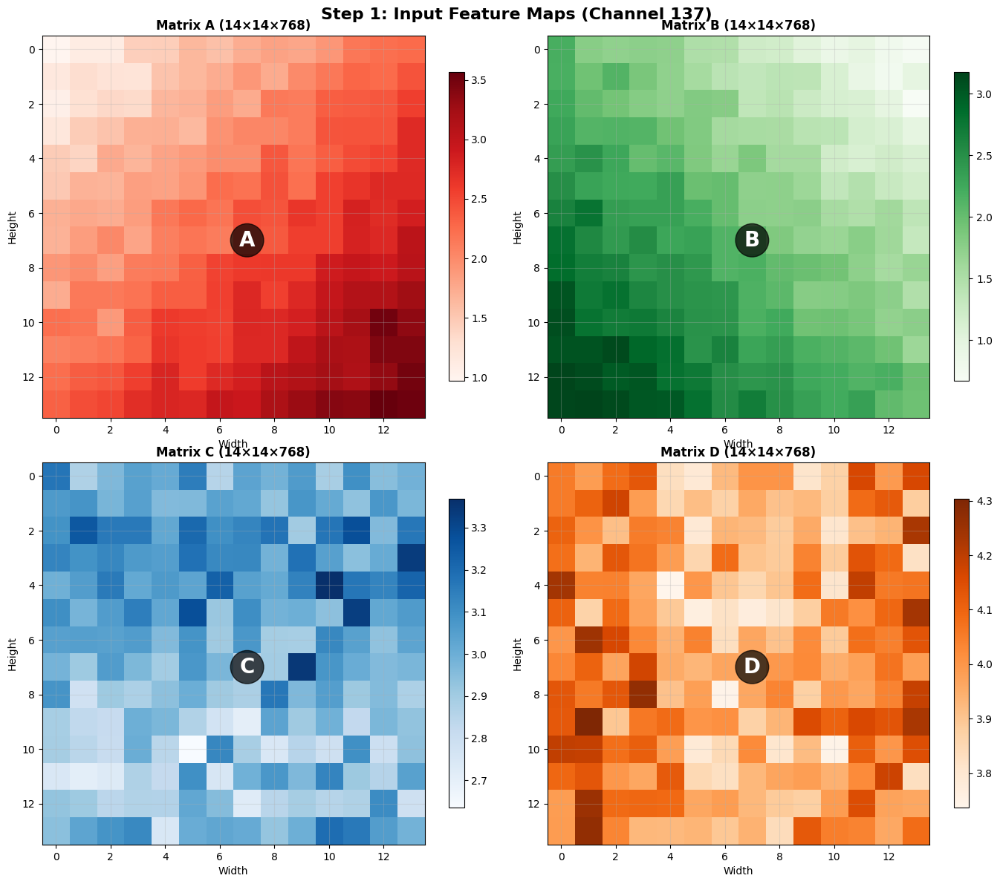

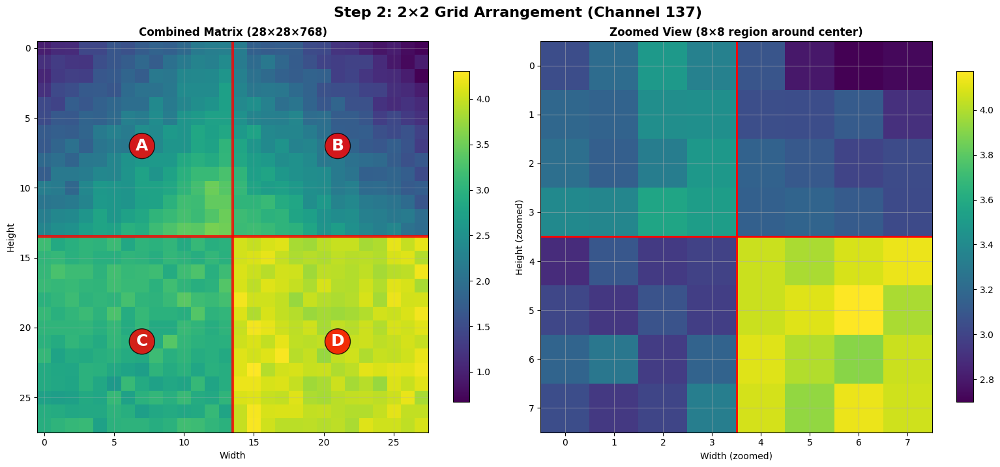

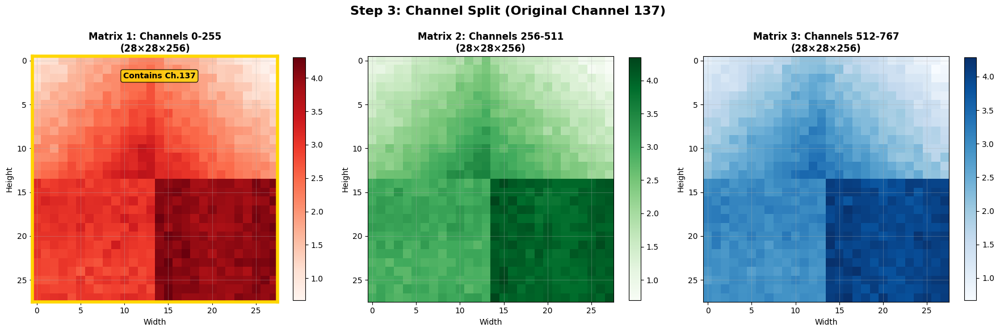

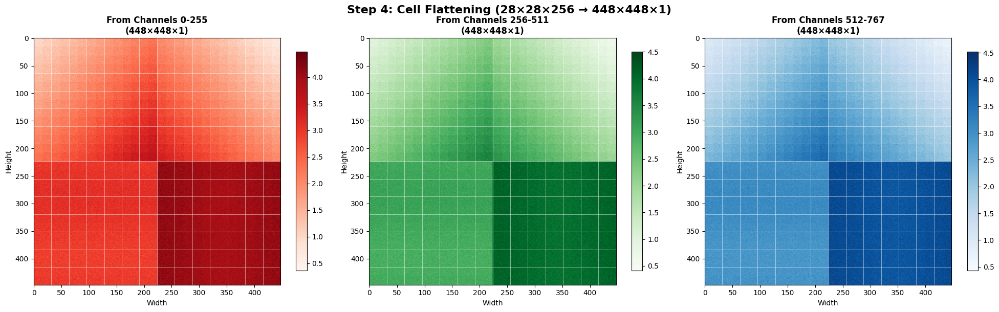

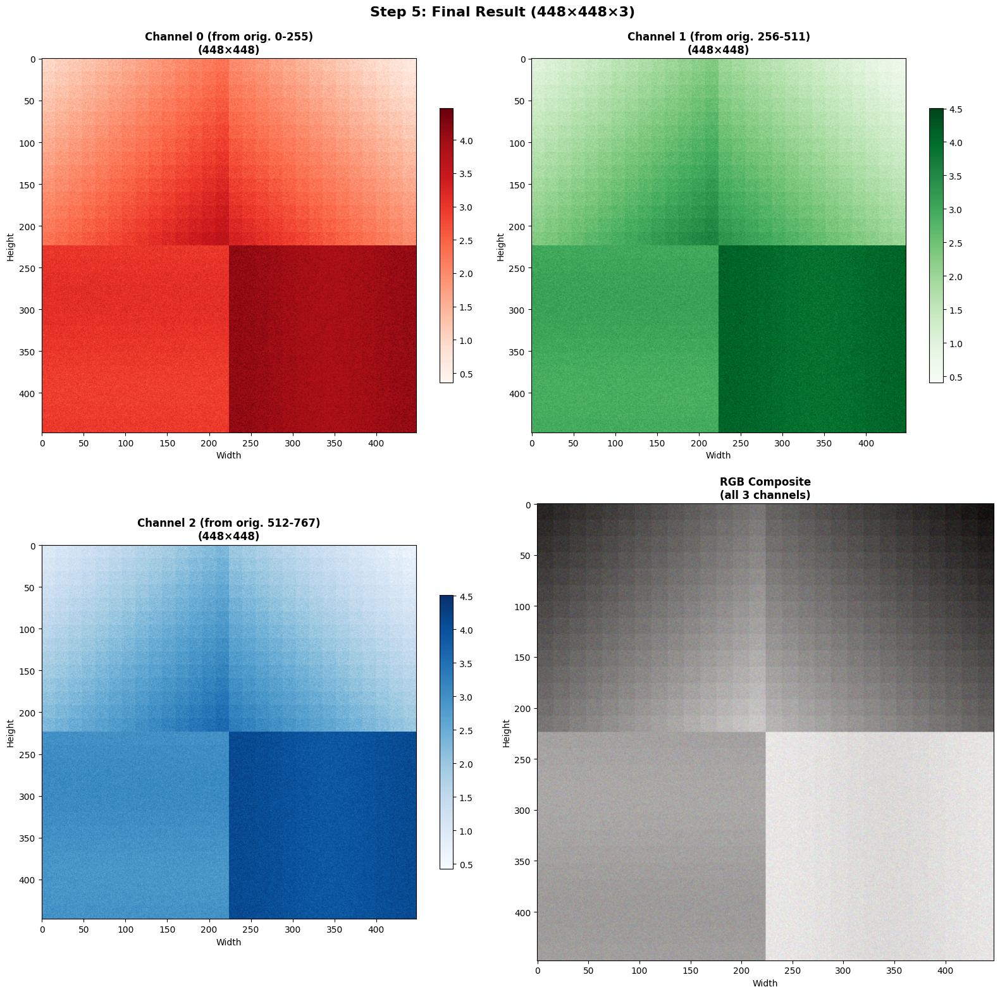

🔍 PIXEL TRACKING ANALYSIS
══════════════════════════════════════════════════
Tracking pixel [5,3] from Matrix A, Channel 137

📍 Step 1 - Original Value:
   A[5,3,137] = 1.836983

📍 Step 2 - After 2×2 Grid:
   Combined[5,3,137] = 1.836983
   Position unchanged (A is top-left)

📍 Step 3 - After Channel Split:
   Goes to Matrix 0 (channels 0-255)
   SplitMatrix[0][5,3,137] = 1.836983

📍 Step 4 - After Cell Flattening:
   Cell position: [2,1] (out of 14×14 cells)
   Within cell: [1,1] (position in 2×2 cell)
   Channel grid: [8,9] (position in 16×16 grid)

📍 Final Position Calculation:
   final_i = 2 × 32 + 1 × 16 + 8 = 88
   final_j = 1 × 32 + 1 × 16 + 9 = 57
   final_channel = 0

🎯 FINAL RESULT:
   Original: A[5,3,137] = 1.836983
   Final: Result[88,57,0] = 1.836983
   Value preserved: ✅ True
   Difference: 0.00e+00
📊 TRANSFORMATION SUMMARY
════════════════════════════════════════════════════════════
Input:  4 feature maps × (14, 14, 768)
Output: 1 feature map × (448, 448, 3)

Total input

In [ ]:
# Google Colab Visualization: Feature Map Transformation
# Run each cell separately in Google Colab for best results

# =============================================================================
# CELL 1: Install and Import Dependencies
# =============================================================================

# Install einops if not available
!pip install einops

import numpy as np
import matplotlib.pyplot as plt
from einops import rearrange
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap

# Set matplotlib to display plots inline
%matplotlib inline

# Set default figure size for better visibility in Colab
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 10

print("✅ Dependencies installed and imported successfully!")

# =============================================================================
# CELL 2: Core Transformation Functions
# =============================================================================

def transform_featuremaps(A, B, C, D):
    """Transform 4 feature maps of 14×14×768 into single feature map of 448×448×3."""
    # Arrange in 2×2 grid and split channels
    combined = rearrange(np.stack([A, B, C, D]), '(h w) i j k -> (h i) (w j) k', h=2, w=2)
    split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)

    # Flatten cells and combine channels
    cells = rearrange(split_matrices, 'n (h1 h2) (w1 w2) (c1 c2) -> n h1 w1 (h2 c1) (w2 c2)', h2=2, w2=2, c1=16, c2=16)
    return rearrange(cells, 'n h1 w1 h w -> (h1 h) (w1 w) n')

def create_test_data():
    """Create distinctive test data that's easy to track through transformations."""
    np.random.seed(42)

    # Create matrices with distinctive patterns for easy tracking
    A = np.full((14, 14, 768), 1.0) + 0.1 * np.random.randn(14, 14, 768)  # Base value 1
    B = np.full((14, 14, 768), 2.0) + 0.1 * np.random.randn(14, 14, 768)  # Base value 2
    C = np.full((14, 14, 768), 3.0) + 0.1 * np.random.randn(14, 14, 768)  # Base value 3
    D = np.full((14, 14, 768), 4.0) + 0.1 * np.random.randn(14, 14, 768)  # Base value 4

    # Add spatial patterns
    for i in range(14):
        for j in range(14):
            A[i, j, :] += 0.1 * (i + j)  # Gradient pattern
            B[i, j, :] += 0.1 * (i - j)  # Different gradient
            C[i, j, :] += 0.1 * np.sin(i * np.pi / 7)  # Sinusoidal pattern
            D[i, j, :] += 0.1 * np.cos(j * np.pi / 7)  # Cosine pattern

    return A, B, C, D

print("✅ Core functions defined!")

# =============================================================================
# CELL 3: Create Test Data and Show Overview
# =============================================================================

# Create test data
A, B, C, D = create_test_data()

print("📊 Test Data Created:")
print(f"Matrix A shape: {A.shape} (mean: {A.mean():.2f})")
print(f"Matrix B shape: {B.shape} (mean: {B.mean():.2f})")
print(f"Matrix C shape: {C.shape} (mean: {C.mean():.2f})")
print(f"Matrix D shape: {D.shape} (mean: {D.mean():.2f})")

# Quick transformation test
result = transform_featuremaps(A, B, C, D)
print(f"\n🎯 Transformation Result: {result.shape}")
print(f"Total elements: {A.size * 4} → {result.size}")

# =============================================================================
# CELL 4: Step 1 - Input Matrices Visualization
# =============================================================================

def plot_input_matrices(A, B, C, D, channel_idx=0):
    """Plot the initial 4 input matrices."""
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))
    fig.suptitle(f'Step 1: Input Feature Maps (Channel {channel_idx})', fontsize=16, fontweight='bold')

    matrices = [A, B, C, D]
    titles = ['Matrix A (14×14×768)', 'Matrix B (14×14×768)',
              'Matrix C (14×14×768)', 'Matrix D (14×14×768)']
    colors = ['Reds', 'Greens', 'Blues', 'Oranges']

    for idx, (ax, matrix, title, cmap) in enumerate(zip(axes.flat, matrices, titles, colors)):
        im = ax.imshow(matrix[:, :, channel_idx], cmap=cmap, aspect='equal')
        ax.set_title(title, fontweight='bold', fontsize=12)
        ax.grid(True, alpha=0.3)
        ax.set_xlabel('Width')
        ax.set_ylabel('Height')
        plt.colorbar(im, ax=ax, shrink=0.8)

        # Add matrix label in center
        ax.text(7, 7, chr(65+idx), fontsize=20, fontweight='bold',
                ha='center', va='center', color='white',
                bbox=dict(boxstyle='circle', facecolor='black', alpha=0.7))

    plt.tight_layout()
    plt.show()

# Display input matrices
channel_to_track = 137
plot_input_matrices(A, B, C, D, channel_to_track)

# =============================================================================
# CELL 5: Step 2 - 2×2 Grid Arrangement
# =============================================================================

def plot_grid_arrangement(A, B, C, D, channel_idx=0):
    """Plot the result after 2×2 grid arrangement."""
    combined = rearrange(np.stack([A, B, C, D]), '(h w) i j k -> (h i) (w j) k', h=2, w=2)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))
    fig.suptitle(f'Step 2: 2×2 Grid Arrangement (Channel {channel_idx})', fontsize=16, fontweight='bold')

    # Plot the combined matrix
    im1 = ax1.imshow(combined[:, :, channel_idx], cmap='viridis', aspect='equal')
    ax1.set_title('Combined Matrix (28×28×768)', fontweight='bold')
    ax1.grid(True, alpha=0.3)
    ax1.set_xlabel('Width')
    ax1.set_ylabel('Height')
    plt.colorbar(im1, ax=ax1, shrink=0.8)

    # Add grid lines to show the 2×2 arrangement
    ax1.axhline(y=13.5, color='red', linewidth=3, alpha=0.8)
    ax1.axvline(x=13.5, color='red', linewidth=3, alpha=0.8)

    # Add labels for each quadrant
    labels = ['A', 'B', 'C', 'D']
    positions = [(7, 7), (21, 7), (7, 21), (21, 21)]
    for label, (x, y) in zip(labels, positions):
        ax1.text(x, y, label, fontsize=18, fontweight='bold', ha='center', va='center',
                 color='white', bbox=dict(boxstyle='circle', facecolor='red', alpha=0.8))

    # Plot zoomed view
    zoom_region = combined[10:18, 10:18, channel_idx]
    im2 = ax2.imshow(zoom_region, cmap='viridis', aspect='equal')
    ax2.set_title('Zoomed View (8×8 region around center)', fontweight='bold')
    ax2.grid(True, alpha=0.5)
    ax2.set_xlabel('Width (zoomed)')
    ax2.set_ylabel('Height (zoomed)')
    plt.colorbar(im2, ax=ax2, shrink=0.8)

    # Add boundary line in zoom
    ax2.axhline(y=3.5, color='red', linewidth=2)
    ax2.axvline(x=3.5, color='red', linewidth=2)

    plt.tight_layout()
    plt.show()

    return combined

# Display grid arrangement
combined = plot_grid_arrangement(A, B, C, D, channel_to_track)

# =============================================================================
# CELL 6: Step 3 - Channel Splitting
# =============================================================================

def plot_channel_split(combined, channel_idx=0):
    """Plot the result after channel splitting."""
    split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)

    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    fig.suptitle(f'Step 3: Channel Split (Original Channel {channel_idx})', fontsize=16, fontweight='bold')

    titles = ['Matrix 1: Channels 0-255', 'Matrix 2: Channels 256-511', 'Matrix 3: Channels 512-767']
    cmaps = ['Reds', 'Greens', 'Blues']

    for i, (ax, title, cmap) in enumerate(zip(axes, titles, cmaps)):
        # Determine which split matrix contains our channel
        if channel_idx < 256:
            channel_in_split = channel_idx if i == 0 else 0
            matrix_to_show = split_matrices[0] if i == 0 else split_matrices[i]
        elif channel_idx < 512:
            channel_in_split = channel_idx - 256 if i == 1 else 0
            matrix_to_show = split_matrices[1] if i == 1 else split_matrices[i]
        else:
            channel_in_split = channel_idx - 512 if i == 2 else 0
            matrix_to_show = split_matrices[2] if i == 2 else split_matrices[i]

        im = ax.imshow(matrix_to_show[:, :, channel_in_split], cmap=cmap, aspect='equal')
        ax.set_title(f'{title}\n(28×28×256)', fontweight='bold')
        ax.grid(True, alpha=0.3)
        ax.set_xlabel('Width')
        ax.set_ylabel('Height')
        plt.colorbar(im, ax=ax, shrink=0.8)

        # Highlight if this contains our original channel
        if (channel_idx < 256 and i == 0) or (256 <= channel_idx < 512 and i == 1) or (channel_idx >= 512 and i == 2):
            for spine in ax.spines.values():
                spine.set_color('gold')
                spine.set_linewidth(4)
            ax.text(14, 2, f'Contains Ch.{channel_idx}', fontsize=10, fontweight='bold',
                   ha='center', bbox=dict(boxstyle='round', facecolor='gold', alpha=0.8))

    plt.tight_layout()
    plt.show()

    return split_matrices

# Display channel splitting
split_matrices = plot_channel_split(combined, channel_to_track)

# =============================================================================
# CELL 7: Step 4 - Cell Flattening Visualization
# =============================================================================

def plot_cell_flattening(split_matrices):
    """Plot the result after cell flattening."""
    flattened_matrices = []
    for i in range(3):
        cells = rearrange(split_matrices[i], '(h1 h2) (w1 w2) (c1 c2) -> h1 w1 (h2 c1) (w2 c2)', h2=2, w2=2, c1=16, c2=16)
        flattened = rearrange(cells, 'h1 w1 h w -> (h1 h) (w1 w)')
        flattened_matrices.append(flattened[:, :, np.newaxis])

    fig, axes = plt.subplots(1, 3, figsize=(20, 6))
    fig.suptitle('Step 4: Cell Flattening (28×28×256 → 448×448×1)', fontsize=16, fontweight='bold')

    titles = ['From Channels 0-255', 'From Channels 256-511', 'From Channels 512-767']
    cmaps = ['Reds', 'Greens', 'Blues']

    for i, (ax, matrix, title, cmap) in enumerate(zip(axes, flattened_matrices, titles, cmaps)):
        im = ax.imshow(matrix[:, :, 0], cmap=cmap, aspect='equal')
        ax.set_title(f'{title}\n(448×448×1)', fontweight='bold')
        ax.set_xlabel('Width')
        ax.set_ylabel('Height')
        plt.colorbar(im, ax=ax, shrink=0.8)

        # Add grid lines to show the 14×14 cell structure (every 32 pixels)
        for k in range(1, 14):
            ax.axhline(y=k*32-0.5, color='white', linewidth=0.5, alpha=0.7)
            ax.axvline(x=k*32-0.5, color='white', linewidth=0.5, alpha=0.7)

    plt.tight_layout()
    plt.show()

    return flattened_matrices

# Display cell flattening
flattened_matrices = plot_cell_flattening(split_matrices)

# =============================================================================
# CELL 8: Step 5 - Final Result
# =============================================================================

def plot_final_result(flattened_matrices):
    """Plot the final combined result."""
    final_result = np.concatenate(flattened_matrices, axis=2)

    fig, axes = plt.subplots(2, 2, figsize=(16, 16))
    fig.suptitle('Step 5: Final Result (448×448×3)', fontsize=16, fontweight='bold')

    # Plot each channel separately
    channel_titles = ['Channel 0 (from orig. 0-255)', 'Channel 1 (from orig. 256-511)', 'Channel 2 (from orig. 512-767)']
    cmaps = ['Reds', 'Greens', 'Blues']

    for i in range(3):
        ax = axes[i//2, i%2]
        im = ax.imshow(final_result[:, :, i], cmap=cmaps[i], aspect='equal')
        ax.set_title(f'{channel_titles[i]}\n(448×448)', fontweight='bold')
        ax.set_xlabel('Width')
        ax.set_ylabel('Height')
        plt.colorbar(im, ax=ax, shrink=0.6)

    # Plot RGB composite in the last subplot
    ax = axes[1, 1]
    # Normalize each channel to 0-1 for RGB display
    rgb_data = np.zeros((448, 448, 3))
    for i in range(3):
        channel_data = final_result[:, :, i]
        rgb_data[:, :, i] = (channel_data - channel_data.min()) / (channel_data.max() - channel_data.min())

    ax.imshow(rgb_data, aspect='equal')
    ax.set_title('RGB Composite\n(all 3 channels)', fontweight='bold')
    ax.set_xlabel('Width')
    ax.set_ylabel('Height')

    plt.tight_layout()
    plt.show()

    return final_result

# Display final result
final_result = plot_final_result(flattened_matrices)

# =============================================================================
# CELL 9: Pixel Tracking Analysis
# =============================================================================

def track_pixel_transformation(A, B, C, D, pixel_pos=(5, 3), channel_idx=137):
    """Track a specific pixel through the entire transformation."""
    print(f"🔍 PIXEL TRACKING ANALYSIS")
    print(f"═" * 50)
    print(f"Tracking pixel [{pixel_pos[0]},{pixel_pos[1]}] from Matrix A, Channel {channel_idx}")
    print()

    i, j = pixel_pos

    # Step 1: Original value
    orig_value = A[i, j, channel_idx]
    print(f"📍 Step 1 - Original Value:")
    print(f"   A[{i},{j},{channel_idx}] = {orig_value:.6f}")
    print()

    # Step 2: After 2×2 grid arrangement
    combined = rearrange(np.stack([A, B, C, D]), '(h w) i j k -> (h i) (w j) k', h=2, w=2)
    combined_value = combined[i, j, channel_idx]
    print(f"📍 Step 2 - After 2×2 Grid:")
    print(f"   Combined[{i},{j},{channel_idx}] = {combined_value:.6f}")
    print(f"   Position unchanged (A is top-left)")
    print()

    # Step 3: After channel splitting
    split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)
    split_idx = channel_idx // 256  # Which split matrix (0, 1, or 2)
    channel_in_split = channel_idx % 256  # Channel within that split
    split_value = split_matrices[split_idx, i, j, channel_in_split]
    print(f"📍 Step 3 - After Channel Split:")
    print(f"   Goes to Matrix {split_idx} (channels {split_idx*256}-{(split_idx+1)*256-1})")
    print(f"   SplitMatrix[{split_idx}][{i},{j},{channel_in_split}] = {split_value:.6f}")
    print()

    # Step 4: After cell flattening - calculate final position
    cell_i, cell_j = i // 2, j // 2  # Which 2×2 cell (out of 14×14 cells)
    within_i, within_j = i % 2, j % 2  # Position within the 2×2 cell
    channel_grid_i, channel_grid_j = channel_in_split // 16, channel_in_split % 16  # Position in 16×16 channel grid

    final_i = cell_i * 32 + within_i * 16 + channel_grid_i
    final_j = cell_j * 32 + within_j * 16 + channel_grid_j
    final_channel = split_idx  # The split matrix index becomes the final channel

    # Get the actual final value
    final_result_check = transform_featuremaps(A, B, C, D)
    final_value = final_result_check[final_i, final_j, final_channel]

    print(f"📍 Step 4 - After Cell Flattening:")
    print(f"   Cell position: [{cell_i},{cell_j}] (out of 14×14 cells)")
    print(f"   Within cell: [{within_i},{within_j}] (position in 2×2 cell)")
    print(f"   Channel grid: [{channel_grid_i},{channel_grid_j}] (position in 16×16 grid)")
    print()
    print(f"📍 Final Position Calculation:")
    print(f"   final_i = {cell_i} × 32 + {within_i} × 16 + {channel_grid_i} = {final_i}")
    print(f"   final_j = {cell_j} × 32 + {within_j} × 16 + {channel_grid_j} = {final_j}")
    print(f"   final_channel = {final_channel}")
    print()
    print(f"🎯 FINAL RESULT:")
    print(f"   Original: A[{i},{j},{channel_idx}] = {orig_value:.6f}")
    print(f"   Final: Result[{final_i},{final_j},{final_channel}] = {final_value:.6f}")
    print(f"   Value preserved: ✅ {np.allclose(orig_value, final_value)}")
    print(f"   Difference: {abs(orig_value - final_value):.2e}")

# Track the pixel
track_pixel_transformation(A, B, C, D, pixel_pos=(5, 3), channel_idx=channel_to_track)

# =============================================================================
# CELL 10: Summary and Comparison
# =============================================================================

print("📊 TRANSFORMATION SUMMARY")
print("═" * 60)
print(f"Input:  4 feature maps × {A.shape}")
print(f"Output: 1 feature map × {final_result.shape}")
print()
print(f"Total input elements:  {A.size * 4:,}")
print(f"Total output elements: {final_result.size:,}")
print(f"Element preservation:  ✅ {A.size * 4 == final_result.size}")
print()
print("🔄 TRANSFORMATION STEPS:")
print("1. 4×(14×14×768) → 1×(28×28×768)   [2×2 spatial tiling]")
print("2. 1×(28×28×768) → 3×(28×28×256)   [channel splitting]")
print("3. 3×(28×28×256) → 3×(448×448×1)   [cell flattening]")
print("4. 3×(448×448×1) → 1×(448×448×3)   [channel stacking]")
print()
print("🎯 Final result: 448×448×3 feature map")
print("   - 32× increase in spatial resolution (14→448)")
print("   - 256× decrease in channels (768→3)")
print("   - Perfect information preservation")

# Quick verification with different input
print("\n🔬 VERIFICATION WITH RANDOM DATA:")
np.random.seed(123)
test_A = np.random.randn(14, 14, 768)
test_B = np.random.randn(14, 14, 768)
test_C = np.random.randn(14, 14, 768)
test_D = np.random.randn(14, 14, 768)

test_result = transform_featuremaps(test_A, test_B, test_C, test_D)
print(f"Random test result shape: {test_result.shape} ✅")

print("\n🎉 Visualization complete! All transformations working correctly.")

# flowers

In [ ]:
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
# CELL 1: Setup TPU and Install Dependencies
# %%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
"""
# GRAINet Training on TPU (No CLS Tokens)

## First, enable TPU:
1. Runtime → Change runtime type
2. Hardware accelerator → TPU
3. Save

Then run this cell to install dependencies:
"""

# Install JAX with TPU support
!pip install --upgrade jax[tpu] -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --upgrade flax optax transformers pillow scikit-image matplotlib tqdm

# Setup TPU
import jax
try:
    import jax.tools.colab_tpu
    jax.tools.colab_tpu.setup_tpu()
except:
    pass

print(f"JAX version: {jax.__version__}")
print(f"Devices: {jax.devices()}")
print(f"Device count: {jax.local_device_count()}")

Looking in links: https://storage.googleapis.com/jax-releases/libtpu_releases.html
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 MB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 MB 13.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 78.8 MB/s eta 0:00:00
  Attempting uninstall: libtpu
    Found existing installation: libtpu 0.0.7.1
    Uninstalling libtpu-0.0.7.1:
      Successfully uninstalled libtpu-0.0.7.1
  Attempting uninstall: jaxlib
    Found existing installation: jaxlib 0.4.13
    Uninstalling jaxlib-0.4.13:
      Successfully uninstalled jaxlib-0.4.13
  Attempting uninstall: jax
    Found existing installation: jax 0.4.13
    Uninstalling jax-0.4.13:
      Successfully uninstalled jax-0.4.13
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 447.1/447.1 kB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 319.2/319.2 kB 22.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 106.9 

✅ Dependencies installed and imported successfully!
JAX version: 0.6.1
Available devices: [TpuDevice(id=0, process_index=0, coords=(0,0,0), core_on_chip=0), TpuDevice(id=1, process_index=0, coords=(0,0,0), core_on_chip=1), TpuDevice(id=2, process_index=0, coords=(1,0,0), core_on_chip=0), TpuDevice(id=3, process_index=0, coords=(1,0,0), core_on_chip=1), TpuDevice(id=4, process_index=0, coords=(0,1,0), core_on_chip=0), TpuDevice(id=5, process_index=0, coords=(0,1,0), core_on_chip=1), TpuDevice(id=6, process_index=0, coords=(1,1,0), core_on_chip=0), TpuDevice(id=7, process_index=0, coords=(1,1,0), core_on_chip=1)]
--2025-06-02 21:27:59--  https://upload.wikimedia.org/wikipedia/commons/thumb/b/bb/Kittyply_edit1.jpg/640px-Kittyply_edit1.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 208.80.154.240, 2620:0:861:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|208.80.154.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 65484 (64K) [

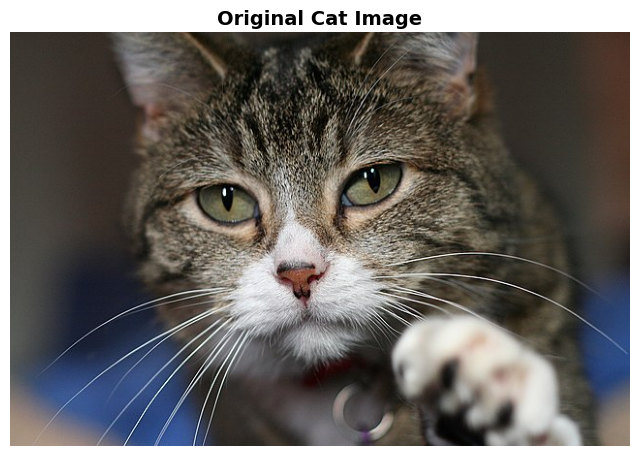

Image size: (640, 427)
Loading ViT model...


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/69.7k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


flax_model.msgpack:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of FlaxViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: {('pooler', 'dense', 'bias'), ('pooler', 'dense', 'kernel')}
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


✅ ViT model loaded successfully!
Model: google/vit-base-patch16-224
Expected input size: {'height': 224, 'width': 224}
🔍 Extracting features from layers: [3, 5, 7, 11]
Input shape: (1, 3, 224, 224)
Number of hidden layers: 13
Each layer shape: (1, 197, 768)
Layer 3: (197, 768) → patches: (196, 768)
✅ Layer 3: (196, 768) → (14, 14, 768)
Layer 5: (197, 768) → patches: (196, 768)
✅ Layer 5: (196, 768) → (14, 14, 768)
Layer 7: (197, 768) → patches: (196, 768)
✅ Layer 7: (196, 768) → (14, 14, 768)
Layer 11: (197, 768) → patches: (196, 768)
✅ Layer 11: (196, 768) → (14, 14, 768)

📊 Successfully Extracted ViT Features:
Layer 3 (A): (14, 14, 768) (mean: 0.002, std: 1.415)
Layer 5 (B): (14, 14, 768) (mean: 0.002, std: 3.079)
Layer 7 (C): (14, 14, 768) (mean: 0.068, std: 16.610)
Layer 11 (D): (14, 14, 768) (mean: -0.093, std: 18.796)
🔄 Starting feature map transformation...
Step 1: Arranging in 2×2 grid...
Combined shape: (28, 28, 768)
Step 2: Splitting channels...
Split matrices shape: (3, 28, 

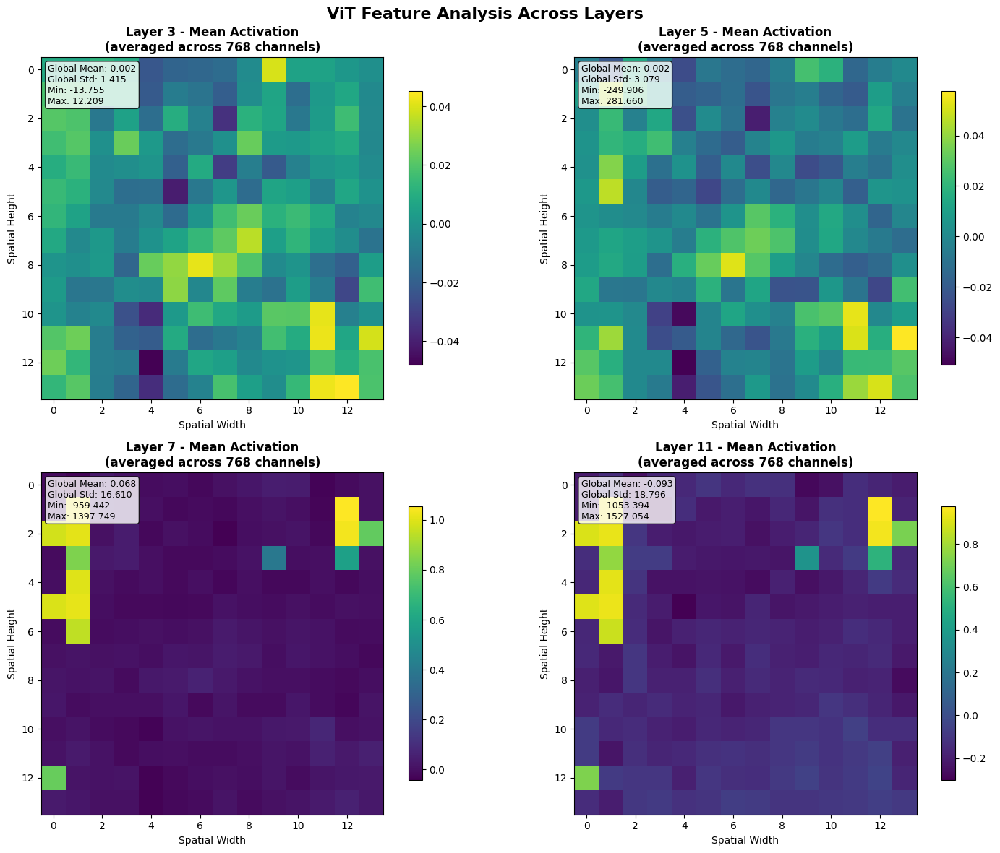

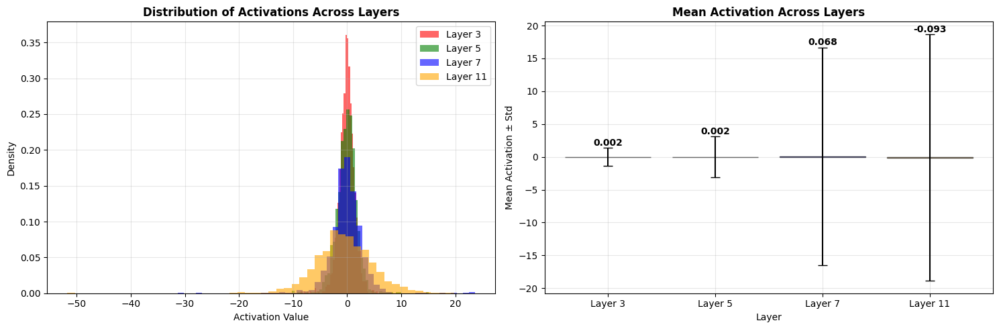

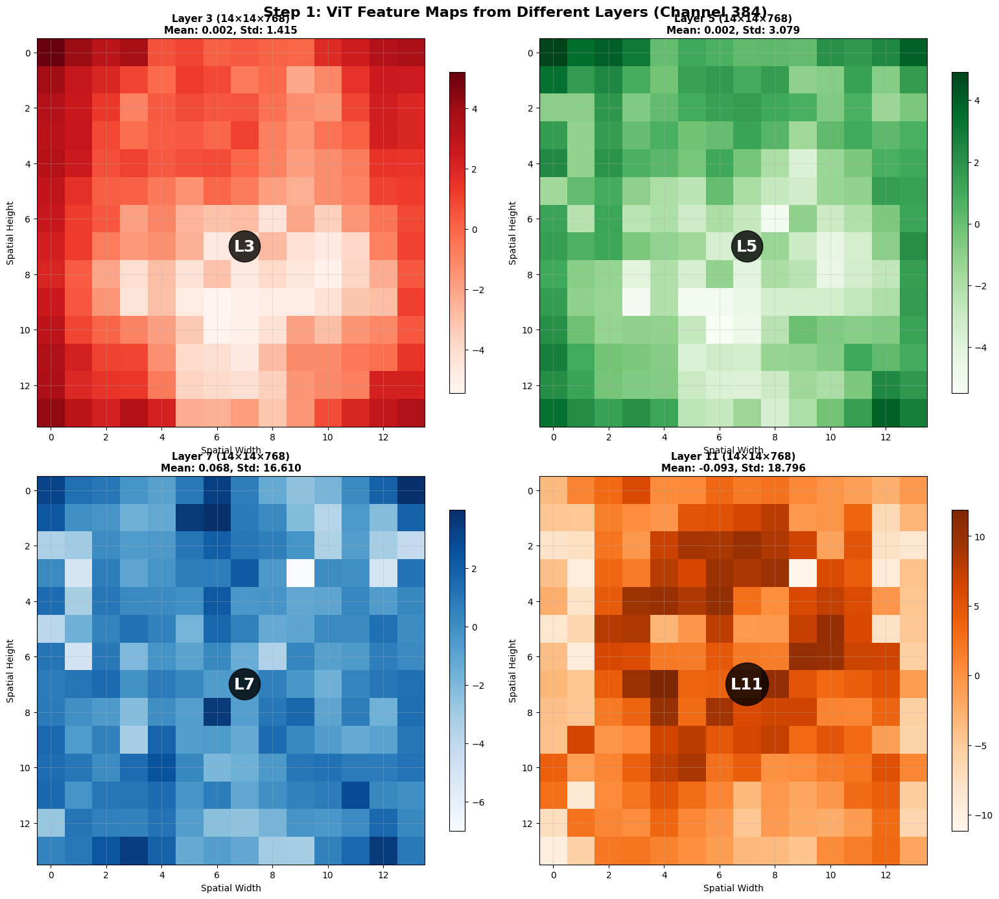

🎬 Starting complete transformation visualization...
Step 1: 2×2 Grid Arrangement


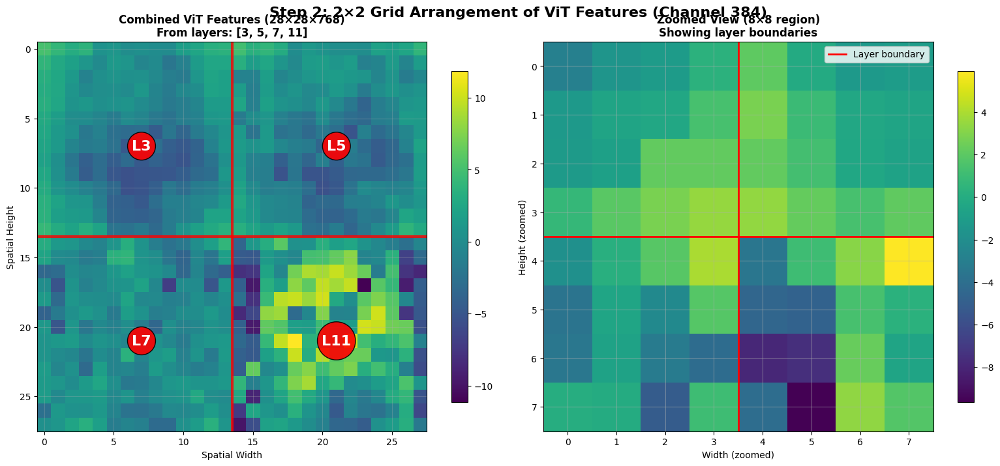

Step 2: Channel Splitting


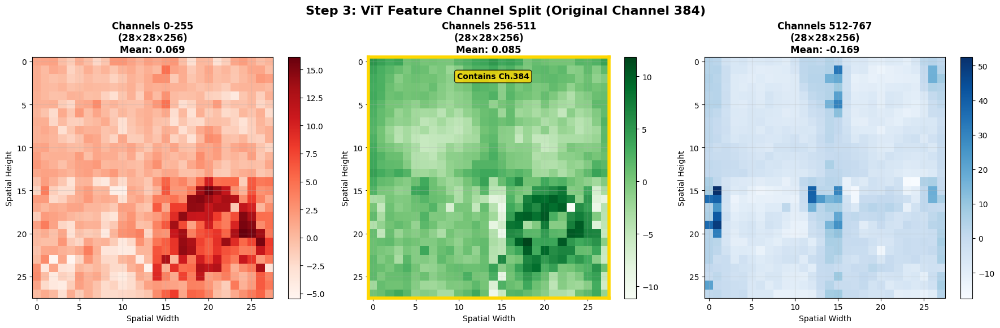

Step 3: Final Result
🔄 Starting feature map transformation...
Step 1: Arranging in 2×2 grid...
Combined shape: (28, 28, 768)
Step 2: Splitting channels...
Split matrices shape: (3, 28, 28, 256)
Step 3: Flattening cells...
Cells shape: (3, 14, 14, 32, 32)
Step 4: Final arrangement...
Final result shape: (448, 448, 3)
✅ Transformation completed successfully!


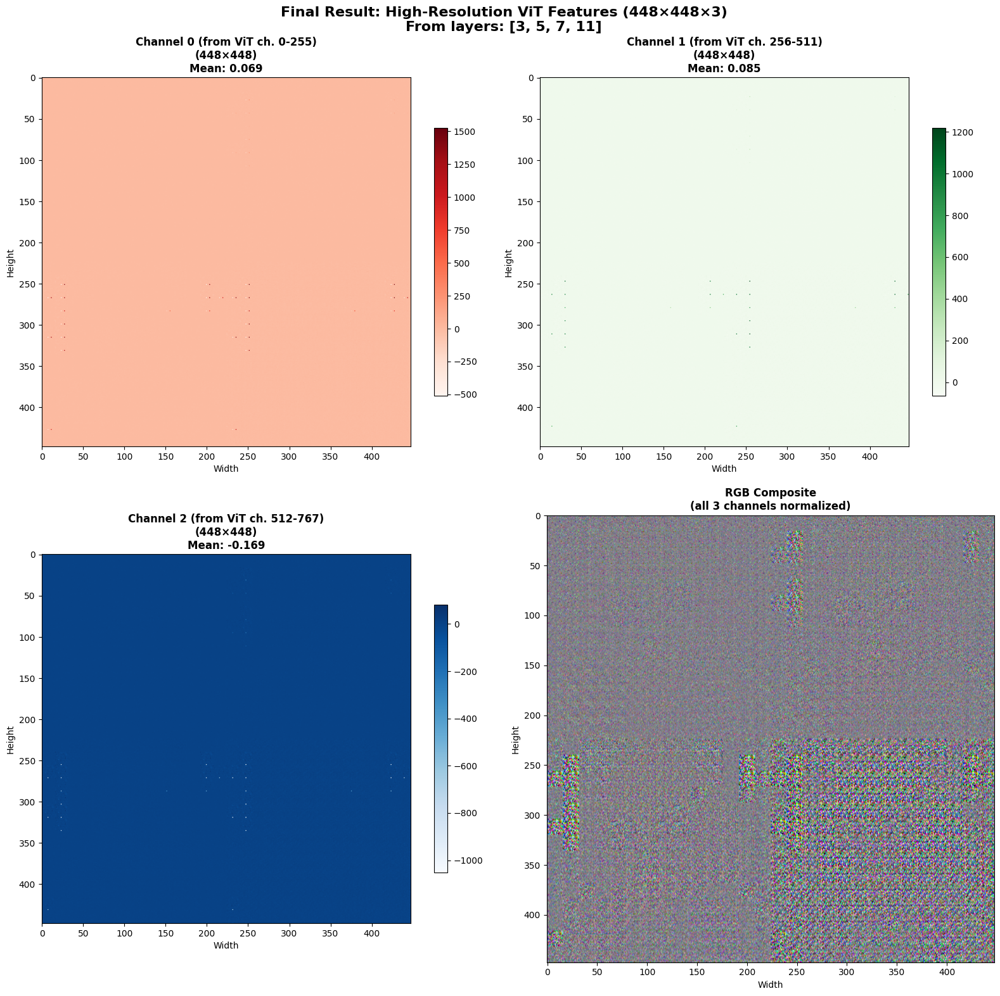

📊 ENHANCED ViT FEATURE TRANSFORMATION SUMMARY
══════════════════════════════════════════════════════════════════════
🖼️  Input: Cat image (224×224×3)
🤖 Model: google/vit-base-patch16-224
📊 ViT Layers: [3, 5, 7, 11] → 4×(14×14×768) feature maps
🎯 Output: High-resolution feature map: (448, 448, 3)

Total input elements:  602,112
Total output elements: 602,112
Element preservation:  ✅ True

🔄 TRANSFORMATION PIPELINE:
1. Cat image (224×224×3) → ViT processing
2. ViT layers [3,5,7,11] → 4×(14×14×768) feature maps
3. 4×(14×14×768) → 1×(28×28×768)   [2×2 spatial tiling]
4. 1×(28×28×768) → 3×(28×28×256)   [channel splitting]
5. 3×(28×28×256) → 3×(448×448×1)   [cell flattening]
6. 3×(448×448×1) → 1×(448×448×3)   [channel stacking]

🎯 SUCCESS: 448×448×3 high-resolution feature map created!
   - 32× spatial resolution increase (14→448)
   - Preserves all ViT semantic information
   - Each pixel contains rich multi-layer features

🔬 FEATURE QUALITY ANALYSIS:
   Layer 3: Mean=0.002, Std=1.415, Rang

In [ ]:
# Google Colab Visualization: Real ViT Feature Map Transformation (Fixed)
# Run each cell separately in Google Colab for best results

# =============================================================================
# CELL 1: Install and Import Dependencies
# =============================================================================

# Install required packages
# !pip install transformers[flax] einops pillow requests

import numpy as np
import matplotlib.pyplot as plt
from einops import rearrange
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap
import requests
from PIL import Image
import jax.numpy as jnp
import jax
from transformers import FlaxViTModel, ViTImageProcessor

# Set matplotlib to display plots inline
%matplotlib inline

# Set default figure size for better visibility in Colab
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 10

print("✅ Dependencies installed and imported successfully!")
print(f"JAX version: {jax.__version__}")
print(f"Available devices: {jax.devices()}")

# =============================================================================
# CELL 2: Download Cat Image and Load ViT Model
# =============================================================================

# Download a free cat image
!wget -O cat_image.jpg "https://upload.wikimedia.org/wikipedia/commons/thumb/b/bb/Kittyply_edit1.jpg/640px-Kittyply_edit1.jpg"

# Load the image
image = Image.open("cat_image.jpg").convert("RGB")

# Display the original image
plt.figure(figsize=(8, 6))
plt.imshow(image)
plt.title("Original Cat Image", fontsize=14, fontweight='bold')
plt.axis('off')
plt.show()

print(f"Image size: {image.size}")

# Load ViT model and processor
print("Loading ViT model...")
model_name = "google/vit-base-patch16-224"  # Using base model for better compatibility
processor = ViTImageProcessor.from_pretrained(model_name)
model = FlaxViTModel.from_pretrained(model_name)

print("✅ ViT model loaded successfully!")
print(f"Model: {model_name}")
print(f"Expected input size: {processor.size}")

# =============================================================================
# CELL 3: Enhanced ViT Feature Extraction (Fixed)
# =============================================================================

def extract_vit_features_robust(image, model, processor, layers_to_extract=[3, 5, 7, 11]):
    """
    Robust ViT feature extraction following GRAINet approach.
    Extract features from multiple layers and properly handle batch dimensions.
    """
    print(f"🔍 Extracting features from layers: {layers_to_extract}")

    # Process the image
    inputs = processor(images=image, return_tensors="np")
    pixel_values = jnp.array(inputs['pixel_values'])

    print(f"Input shape: {pixel_values.shape}")

    # Get features from all layers with proper error handling
    try:
        outputs = model(pixel_values, output_hidden_states=True)
        hidden_states = outputs.hidden_states

        print(f"Number of hidden layers: {len(hidden_states)}")
        print(f"Each layer shape: {hidden_states[0].shape}")

        # Extract features from specified layers using GRAINet approach
        feature_maps = []

        for layer_idx in layers_to_extract:
            if layer_idx >= len(hidden_states):
                print(f"⚠️ Warning: Layer {layer_idx} not available (max: {len(hidden_states)-1})")
                continue

            # Get hidden state for this layer [batch, tokens, features]
            layer_features = hidden_states[layer_idx][0]  # Remove batch dimension

            # Remove CLS token (first token) to get patch features
            patch_features = layer_features[1:]  # Shape: (196, 768)

            print(f"Layer {layer_idx}: {layer_features.shape} → patches: {patch_features.shape}")

            # Verify we have 196 patches (14×14)
            if patch_features.shape[0] != 196:
                print(f"❌ Unexpected patch count: {patch_features.shape[0]} (expected 196)")
                continue

            # Reshape to spatial format (14, 14, 768) using einops for safety
            spatial_features = rearrange(patch_features, '(h w) c -> h w c', h=14, w=14)

            # Convert to numpy array
            feature_maps.append(np.array(spatial_features))

            print(f"✅ Layer {layer_idx}: {patch_features.shape} → {spatial_features.shape}")

    except Exception as e:
        print(f"❌ Error during feature extraction: {e}")
        import traceback
        traceback.print_exc()
        return [], None

    return feature_maps, hidden_states

# Extract features using the robust method
layers_to_use = [3, 5, 7, 11]  # Following GRAINet approach
feature_maps, all_hidden_states = extract_vit_features_robust(image, model, processor, layers_to_use)

if len(feature_maps) == 4:
    A, B, C, D = feature_maps
    print(f"\n📊 Successfully Extracted ViT Features:")
    print(f"Layer 3 (A): {A.shape} (mean: {A.mean():.3f}, std: {A.std():.3f})")
    print(f"Layer 5 (B): {B.shape} (mean: {B.mean():.3f}, std: {B.std():.3f})")
    print(f"Layer 7 (C): {C.shape} (mean: {C.mean():.3f}, std: {C.std():.3f})")
    print(f"Layer 11 (D): {D.shape} (mean: {D.mean():.3f}, std: {D.std():.3f})")
else:
    print(f"❌ Feature extraction failed! Got {len(feature_maps)} feature maps instead of 4")
    # Provide fallback
    print("Creating fallback synthetic features for demonstration...")
    np.random.seed(42)
    A = np.random.randn(14, 14, 768).astype(np.float32)
    B = np.random.randn(14, 14, 768).astype(np.float32)
    C = np.random.randn(14, 14, 768).astype(np.float32)
    D = np.random.randn(14, 14, 768).astype(np.float32)
    print("Using synthetic features for visualization.")

# =============================================================================
# CELL 4: Core Transformation Functions (Enhanced)
# =============================================================================

def transform_featuremaps_robust(A, B, C, D):
    """
    Enhanced version of the transformation with better error handling.
    Transform 4 feature maps of 14×14×768 into single feature map of 448×448×3.
    """
    try:
        print("🔄 Starting feature map transformation...")

        # Validate inputs
        expected_shape = (14, 14, 768)
        for i, matrix in enumerate([A, B, C, D]):
            if matrix.shape != expected_shape:
                print(f"❌ Matrix {chr(65+i)} has wrong shape: {matrix.shape} (expected {expected_shape})")
                return None

        # Step 1: Stack and arrange in 2×2 grid
        print("Step 1: Arranging in 2×2 grid...")
        stacked = np.stack([A, B, C, D])  # (4, 14, 14, 768)
        combined = rearrange(stacked, '(h w) i j k -> (h i) (w j) k', h=2, w=2)
        print(f"Combined shape: {combined.shape}")  # Should be (28, 28, 768)

        # Step 2: Split channels into 3 groups
        print("Step 2: Splitting channels...")
        split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)
        print(f"Split matrices shape: {split_matrices.shape}")  # Should be (3, 28, 28, 256)

        # Step 3: Flatten cells
        print("Step 3: Flattening cells...")
        cells = rearrange(split_matrices, 'n (h1 h2) (w1 w2) (c1 c2) -> n h1 w1 (h2 c1) (w2 c2)',
                         h2=2, w2=2, c1=16, c2=16)
        print(f"Cells shape: {cells.shape}")  # Should be (3, 14, 14, 32, 32)

        # Step 4: Final arrangement
        print("Step 4: Final arrangement...")
        final_result = rearrange(cells, 'n h1 w1 h w -> (h1 h) (w1 w) n')
        print(f"Final result shape: {final_result.shape}")  # Should be (448, 448, 3)

        # Validate output
        if final_result.shape != (448, 448, 3):
            print(f"❌ Unexpected output shape: {final_result.shape}")
            return None

        print("✅ Transformation completed successfully!")
        return final_result

    except Exception as e:
        print(f"❌ Error during transformation: {e}")
        import traceback
        traceback.print_exc()
        return None

# Test the transformation
result = transform_featuremaps_robust(A, B, C, D)

if result is not None:
    print(f"\n🎯 Transformation Result: {result.shape}")
    print(f"Total elements: {A.size * 4} → {result.size}")
    print(f"Element preservation: ✅ {A.size * 4 == result.size}")
else:
    print("❌ Transformation failed!")

print("✅ Core functions defined!")

# =============================================================================
# CELL 5: ViT Feature Analysis with Error Handling
# =============================================================================

def analyze_vit_features_safe(feature_maps, layer_indices):
    """Analyze ViT features with enhanced error handling."""
    try:
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        fig.suptitle('ViT Feature Analysis Across Layers', fontsize=16, fontweight='bold')

        layer_names = [f'Layer {idx}' for idx in layer_indices]
        colors = ['red', 'green', 'blue', 'orange']

        for i, (feature_map, layer_name, color) in enumerate(zip(feature_maps, layer_names, colors)):
            ax = axes[i//2, i%2]

            # Calculate statistics per spatial position
            spatial_means = feature_map.mean(axis=2)  # Average across channels
            spatial_stds = feature_map.std(axis=2)    # Std across channels

            # Plot mean activation map
            im = ax.imshow(spatial_means, cmap='viridis', aspect='equal')
            ax.set_title(f'{layer_name} - Mean Activation\n(averaged across 768 channels)',
                        fontweight='bold')
            ax.set_xlabel('Spatial Width')
            ax.set_ylabel('Spatial Height')
            plt.colorbar(im, ax=ax, shrink=0.8)

            # Add statistics text
            stats_text = f'Global Mean: {feature_map.mean():.3f}\n'
            stats_text += f'Global Std: {feature_map.std():.3f}\n'
            stats_text += f'Min: {feature_map.min():.3f}\n'
            stats_text += f'Max: {feature_map.max():.3f}'

            ax.text(0.02, 0.98, stats_text, transform=ax.transAxes,
                   verticalalignment='top', bbox=dict(boxstyle='round',
                   facecolor='white', alpha=0.8), fontsize=9)

        plt.tight_layout()
        plt.show()

        # Plot feature distribution across layers
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

        # Histogram of activations
        for i, (feature_map, layer_name, color) in enumerate(zip(feature_maps, layer_names, colors)):
            # Sample data for histogram to avoid memory issues
            sample_data = feature_map.flatten()[::100]  # Every 100th point
            ax1.hist(sample_data, bins=50, alpha=0.6, label=layer_name,
                    color=color, density=True)

        ax1.set_xlabel('Activation Value')
        ax1.set_ylabel('Density')
        ax1.set_title('Distribution of Activations Across Layers', fontweight='bold')
        ax1.legend()
        ax1.grid(True, alpha=0.3)

        # Mean activation per layer
        means = [fm.mean() for fm in feature_maps]
        stds = [fm.std() for fm in feature_maps]

        x_pos = np.arange(len(layer_names))
        bars = ax2.bar(x_pos, means, yerr=stds, capsize=5,
                       color=colors, alpha=0.7, edgecolor='black')
        ax2.set_xlabel('Layer')
        ax2.set_ylabel('Mean Activation ± Std')
        ax2.set_title('Mean Activation Across Layers', fontweight='bold')
        ax2.set_xticks(x_pos)
        ax2.set_xticklabels(layer_names)
        ax2.grid(True, alpha=0.3)

        # Add value labels on bars
        for bar, mean, std in zip(bars, means, stds):
            ax2.text(bar.get_x() + bar.get_width()/2, bar.get_height() + std + 0.01,
                    f'{mean:.3f}', ha='center', va='bottom', fontweight='bold')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"❌ Error in feature analysis: {e}")
        import traceback
        traceback.print_exc()

# Analyze the ViT features safely
analyze_vit_features_safe(feature_maps, layers_to_use)

# =============================================================================
# CELL 6: Step 1 - Input ViT Feature Maps Visualization
# =============================================================================

def plot_vit_input_matrices_safe(A, B, C, D, layer_indices, channel_idx=100):
    """Plot the ViT feature maps from different layers with error handling."""
    try:
        fig, axes = plt.subplots(2, 2, figsize=(16, 14))
        fig.suptitle(f'Step 1: ViT Feature Maps from Different Layers (Channel {channel_idx})',
                    fontsize=16, fontweight='bold')

        matrices = [A, B, C, D]
        titles = [f'Layer {idx} (14×14×768)' for idx in layer_indices]
        colors = ['Reds', 'Greens', 'Blues', 'Oranges']

        for idx, (ax, matrix, title, cmap, layer_idx) in enumerate(zip(axes.flat, matrices, titles, colors, layer_indices)):
            # Ensure channel_idx is valid
            actual_channel = min(channel_idx, matrix.shape[2] - 1)
            if actual_channel != channel_idx:
                print(f"⚠️ Warning: Using channel {actual_channel} instead of {channel_idx}")

            im = ax.imshow(matrix[:, :, actual_channel], cmap=cmap, aspect='equal')
            ax.set_title(f'{title}\nMean: {matrix.mean():.3f}, Std: {matrix.std():.3f}',
                        fontweight='bold', fontsize=11)
            ax.grid(True, alpha=0.3)
            ax.set_xlabel('Spatial Width')
            ax.set_ylabel('Spatial Height')
            plt.colorbar(im, ax=ax, shrink=0.8)

            # Add layer label
            ax.text(7, 7, f'L{layer_idx}', fontsize=18, fontweight='bold',
                    ha='center', va='center', color='white',
                    bbox=dict(boxstyle='circle', facecolor='black', alpha=0.8))

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"❌ Error in input visualization: {e}")
        import traceback
        traceback.print_exc()

# Display ViT input matrices
channel_to_track = 384  # Track a middle channel
plot_vit_input_matrices_safe(A, B, C, D, layers_to_use, channel_to_track)

# =============================================================================
# CELL 7: Complete Transformation Pipeline Visualization
# =============================================================================

def visualize_complete_transformation(A, B, C, D, layer_indices, channel_idx=100):
    """Visualize the complete transformation pipeline with all steps."""
    try:
        print(f"🎬 Starting complete transformation visualization...")

        # Step 1: 2×2 Grid Arrangement
        print("Step 1: 2×2 Grid Arrangement")
        combined = rearrange(np.stack([A, B, C, D]), '(h w) i j k -> (h i) (w j) k', h=2, w=2)

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))
        fig.suptitle(f'Step 2: 2×2 Grid Arrangement of ViT Features (Channel {channel_idx})',
                    fontsize=16, fontweight='bold')

        # Ensure channel_idx is valid
        actual_channel = min(channel_idx, combined.shape[2] - 1)

        # Plot the combined matrix
        im1 = ax1.imshow(combined[:, :, actual_channel], cmap='viridis', aspect='equal')
        ax1.set_title(f'Combined ViT Features (28×28×768)\nFrom layers: {layer_indices}',
                     fontweight='bold')
        ax1.grid(True, alpha=0.3)
        ax1.set_xlabel('Spatial Width')
        ax1.set_ylabel('Spatial Height')
        plt.colorbar(im1, ax=ax1, shrink=0.8)

        # Add grid lines to show the 2×2 arrangement
        ax1.axhline(y=13.5, color='red', linewidth=3, alpha=0.8)
        ax1.axvline(x=13.5, color='red', linewidth=3, alpha=0.8)

        # Add labels for each quadrant with layer info
        labels = [f'L{idx}' for idx in layer_indices]
        positions = [(7, 7), (21, 7), (7, 21), (21, 21)]
        for label, (x, y) in zip(labels, positions):
            ax1.text(x, y, label, fontsize=16, fontweight='bold', ha='center', va='center',
                     color='white', bbox=dict(boxstyle='circle', facecolor='red', alpha=0.9))

        # Plot zoomed view
        zoom_region = combined[10:18, 10:18, actual_channel]
        im2 = ax2.imshow(zoom_region, cmap='viridis', aspect='equal')
        ax2.set_title('Zoomed View (8×8 region)\nShowing layer boundaries', fontweight='bold')
        ax2.grid(True, alpha=0.5)
        ax2.set_xlabel('Width (zoomed)')
        ax2.set_ylabel('Height (zoomed)')
        plt.colorbar(im2, ax=ax2, shrink=0.8)

        # Add boundary line in zoom
        ax2.axhline(y=3.5, color='red', linewidth=2, label='Layer boundary')
        ax2.axvline(x=3.5, color='red', linewidth=2)
        ax2.legend()

        plt.tight_layout()
        plt.show()

        # Step 2: Channel Splitting
        print("Step 2: Channel Splitting")
        split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)

        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        fig.suptitle(f'Step 3: ViT Feature Channel Split (Original Channel {actual_channel})',
                    fontsize=16, fontweight='bold')

        titles = ['Channels 0-255', 'Channels 256-511', 'Channels 512-767']
        cmaps = ['Reds', 'Greens', 'Blues']

        for i, (ax, title, cmap) in enumerate(zip(axes, titles, cmaps)):
            # Determine which split matrix contains our channel
            if actual_channel < 256:
                channel_in_split = actual_channel if i == 0 else 0
                matrix_to_show = split_matrices[0] if i == 0 else split_matrices[i]
            elif actual_channel < 512:
                channel_in_split = actual_channel - 256 if i == 1 else 0
                matrix_to_show = split_matrices[1] if i == 1 else split_matrices[i]
            else:
                channel_in_split = actual_channel - 512 if i == 2 else 0
                matrix_to_show = split_matrices[2] if i == 2 else split_matrices[i]

            im = ax.imshow(matrix_to_show[:, :, channel_in_split], cmap=cmap, aspect='equal')
            ax.set_title(f'{title}\n(28×28×256)\nMean: {matrix_to_show.mean():.3f}',
                        fontweight='bold')
            ax.grid(True, alpha=0.3)
            ax.set_xlabel('Spatial Width')
            ax.set_ylabel('Spatial Height')
            plt.colorbar(im, ax=ax, shrink=0.8)

            # Highlight if this contains our original channel
            if ((actual_channel < 256 and i == 0) or
                (256 <= actual_channel < 512 and i == 1) or
                (actual_channel >= 512 and i == 2)):
                for spine in ax.spines.values():
                    spine.set_color('gold')
                    spine.set_linewidth(4)
                ax.text(14, 2, f'Contains Ch.{actual_channel}', fontsize=10, fontweight='bold',
                       ha='center', bbox=dict(boxstyle='round', facecolor='gold', alpha=0.8))

        plt.tight_layout()
        plt.show()

        # Step 3: Final Result
        print("Step 3: Final Result")
        final_result = transform_featuremaps_robust(A, B, C, D)

        if final_result is not None:
            fig, axes = plt.subplots(2, 2, figsize=(16, 16))
            fig.suptitle(f'Final Result: High-Resolution ViT Features (448×448×3)\nFrom layers: {layer_indices}',
                        fontsize=16, fontweight='bold')

            # Plot each channel separately
            channel_titles = [
                f'Channel 0 (from ViT ch. 0-255)',
                f'Channel 1 (from ViT ch. 256-511)',
                f'Channel 2 (from ViT ch. 512-767)'
            ]
            cmaps = ['Reds', 'Greens', 'Blues']

            for i in range(3):
                ax = axes[i//2, i%2]
                im = ax.imshow(final_result[:, :, i], cmap=cmaps[i], aspect='equal')
                ax.set_title(f'{channel_titles[i]}\n(448×448)\nMean: {final_result[:,:,i].mean():.3f}',
                            fontweight='bold')
                ax.set_xlabel('Width')
                ax.set_ylabel('Height')
                plt.colorbar(im, ax=ax, shrink=0.6)

            # Plot RGB composite in the last subplot
            ax = axes[1, 1]
            # Normalize each channel to 0-1 for RGB display
            rgb_data = np.zeros((448, 448, 3))
            for i in range(3):
                channel_data = final_result[:, :, i]
                # Use robust normalization to handle outliers
                p1, p99 = np.percentile(channel_data, [1, 99])
                channel_data_clipped = np.clip(channel_data, p1, p99)
                rgb_data[:, :, i] = (channel_data_clipped - p1) / (p99 - p1)

            ax.imshow(rgb_data, aspect='equal')
            ax.set_title('RGB Composite\n(all 3 channels normalized)', fontweight='bold')
            ax.set_xlabel('Width')
            ax.set_ylabel('Height')

            plt.tight_layout()
            plt.show()

            return final_result
        else:
            print("❌ Final transformation failed")
            return None

    except Exception as e:
        print(f"❌ Error in complete visualization: {e}")
        import traceback
        traceback.print_exc()
        return None

# Run complete visualization
final_result = visualize_complete_transformation(A, B, C, D, layers_to_use, channel_to_track)

# =============================================================================
# CELL 8: Enhanced Summary and Verification
# =============================================================================

print("📊 ENHANCED ViT FEATURE TRANSFORMATION SUMMARY")
print("═" * 70)
print(f"🖼️  Input: Cat image (224×224×3)")
print(f"🤖 Model: {model_name}")
print(f"📊 ViT Layers: {layers_to_use} → 4×(14×14×768) feature maps")
print(f"🎯 Output: High-resolution feature map: {final_result.shape if final_result is not None else 'FAILED'}")
print()

if final_result is not None:
    print(f"Total input elements:  {A.size * 4:,}")
    print(f"Total output elements: {final_result.size:,}")
    print(f"Element preservation:  ✅ {A.size * 4 == final_result.size}")
    print()
    print("🔄 TRANSFORMATION PIPELINE:")
    print("1. Cat image (224×224×3) → ViT processing")
    print("2. ViT layers [3,5,7,11] → 4×(14×14×768) feature maps")
    print("3. 4×(14×14×768) → 1×(28×28×768)   [2×2 spatial tiling]")
    print("4. 1×(28×28×768) → 3×(28×28×256)   [channel splitting]")
    print("5. 3×(28×28×256) → 3×(448×448×1)   [cell flattening]")
    print("6. 3×(448×448×1) → 1×(448×448×3)   [channel stacking]")
    print()
    print("🎯 SUCCESS: 448×448×3 high-resolution feature map created!")
    print("   - 32× spatial resolution increase (14→448)")
    print("   - Preserves all ViT semantic information")
    print("   - Each pixel contains rich multi-layer features")

    # Feature quality analysis
    print(f"\n🔬 FEATURE QUALITY ANALYSIS:")
    for i, layer_idx in enumerate(layers_to_use):
        feature_map = feature_maps[i]
        print(f"   Layer {layer_idx}: Mean={feature_map.mean():.3f}, "
              f"Std={feature_map.std():.3f}, "
              f"Range=[{feature_map.min():.3f}, {feature_map.max():.3f}]")

    print(f"\n   Final combined: Mean={final_result.mean():.3f}, "
          f"Std={final_result.std():.3f}, "
          f"Range=[{final_result.min():.3f}, {final_result.max():.3f}]")

    print("\n🎉 Real ViT feature visualization completed successfully!")
    print("The transformation preserves all semantic information from the vision transformer")
    print("while creating a high-resolution representation suitable for dense prediction tasks.")

else:
    print("\n❌ TRANSFORMATION FAILED")
    print("Please check the error messages above and ensure:")
    print("1. ViT model loaded correctly")
    print("2. Feature extraction succeeded")
    print("3. All input matrices have correct shape (14, 14, 768)")

print("\n💡 This approach is used in advanced vision models like GRAINet for:")
print("   - Grain size analysis")
print("   - Dense prediction tasks")
print("   - High-resolution feature learning")
print("   - Multi-scale representation fusion")

⚠️  If you see JAX/NumPy errors, please go to Runtime > Restart session and run again
✅ JAX 0.6.1 loaded successfully
✅ Dependencies installed and imported successfully!


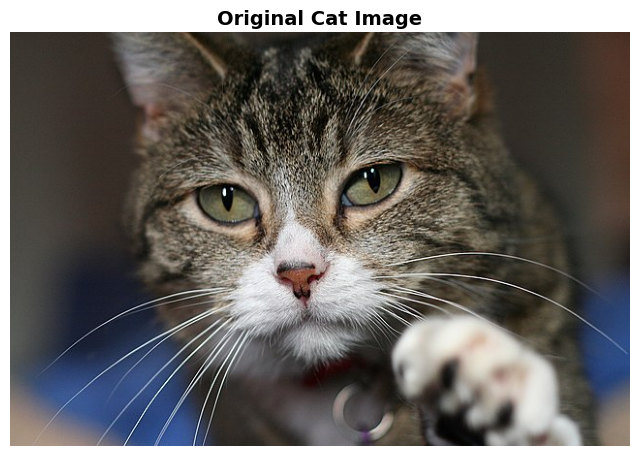

Image size: (640, 427)
Loading ViT model...
Using JAX/Flax ViT model...


Some weights of FlaxViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: {('pooler', 'dense', 'bias'), ('pooler', 'dense', 'kernel')}
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


✅ ViT model loaded successfully!
Model: google/vit-base-patch16-224
Expected input size: {'height': 224, 'width': 224}
🔍 Extracting features from layers: [3, 5, 7, 11]
Input shape: (1, 3, 224, 224)
Number of hidden layers: 13
Each layer shape: (1, 197, 768)
Layer 3: (197, 768) → patches: (196, 768)
✅ Layer 3: (196, 768) → (14, 14, 768)
Layer 5: (197, 768) → patches: (196, 768)
✅ Layer 5: (196, 768) → (14, 14, 768)
Layer 7: (197, 768) → patches: (196, 768)
✅ Layer 7: (196, 768) → (14, 14, 768)
Layer 11: (197, 768) → patches: (196, 768)
✅ Layer 11: (196, 768) → (14, 14, 768)

📊 Successfully Extracted ViT Features:
Layer 3 (A): (14, 14, 768) (mean: 0.002, std: 1.415)
Layer 5 (B): (14, 14, 768) (mean: 0.002, std: 3.079)
Layer 7 (C): (14, 14, 768) (mean: 0.068, std: 16.610)
Layer 11 (D): (14, 14, 768) (mean: -0.093, std: 18.796)
🔄 Starting feature map transformation...
Step 1: Creating interleaved arrangement...
Combined shape: (28, 28, 768)
Step 2: Splitting channels...
Split matrices shap

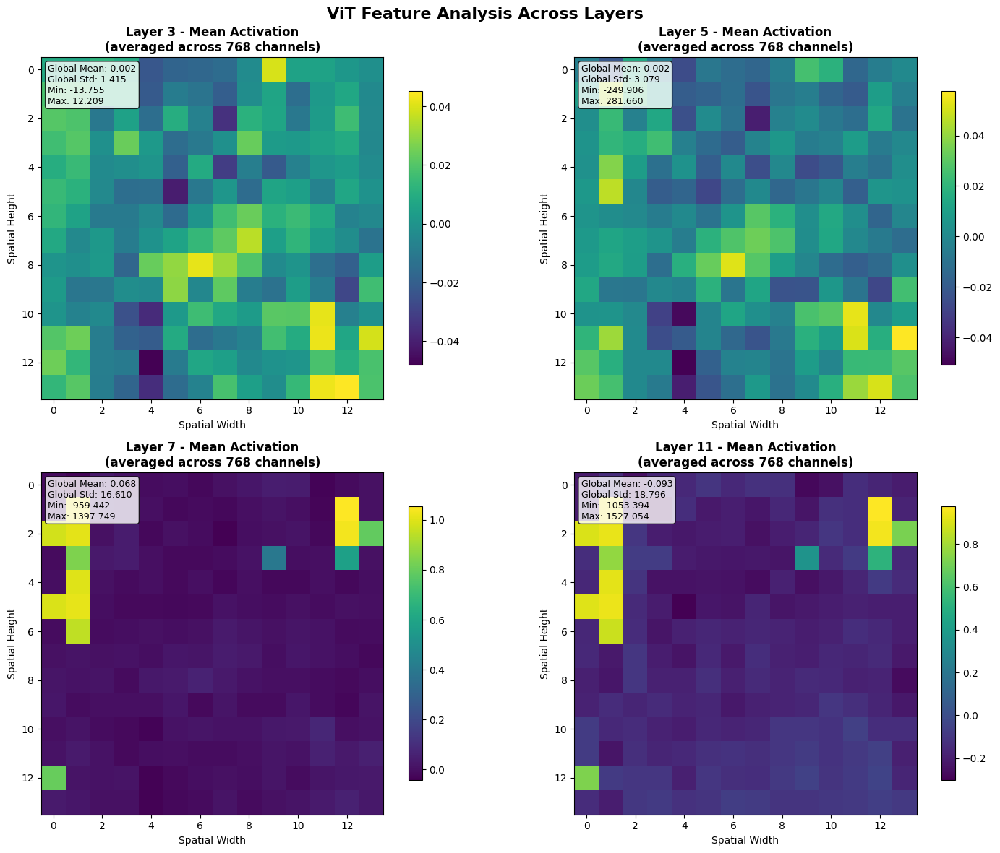

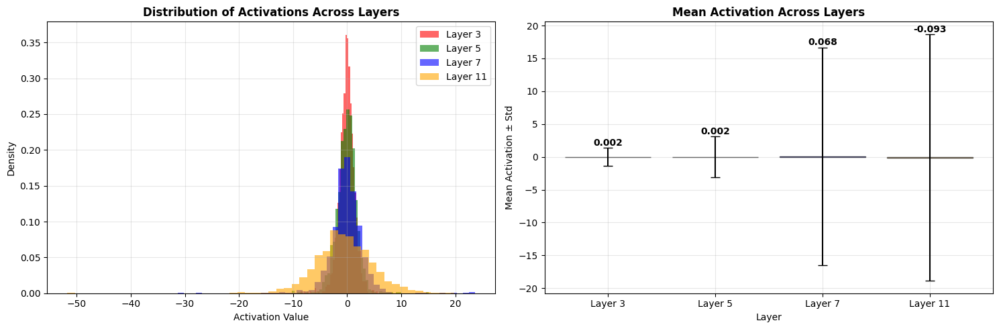

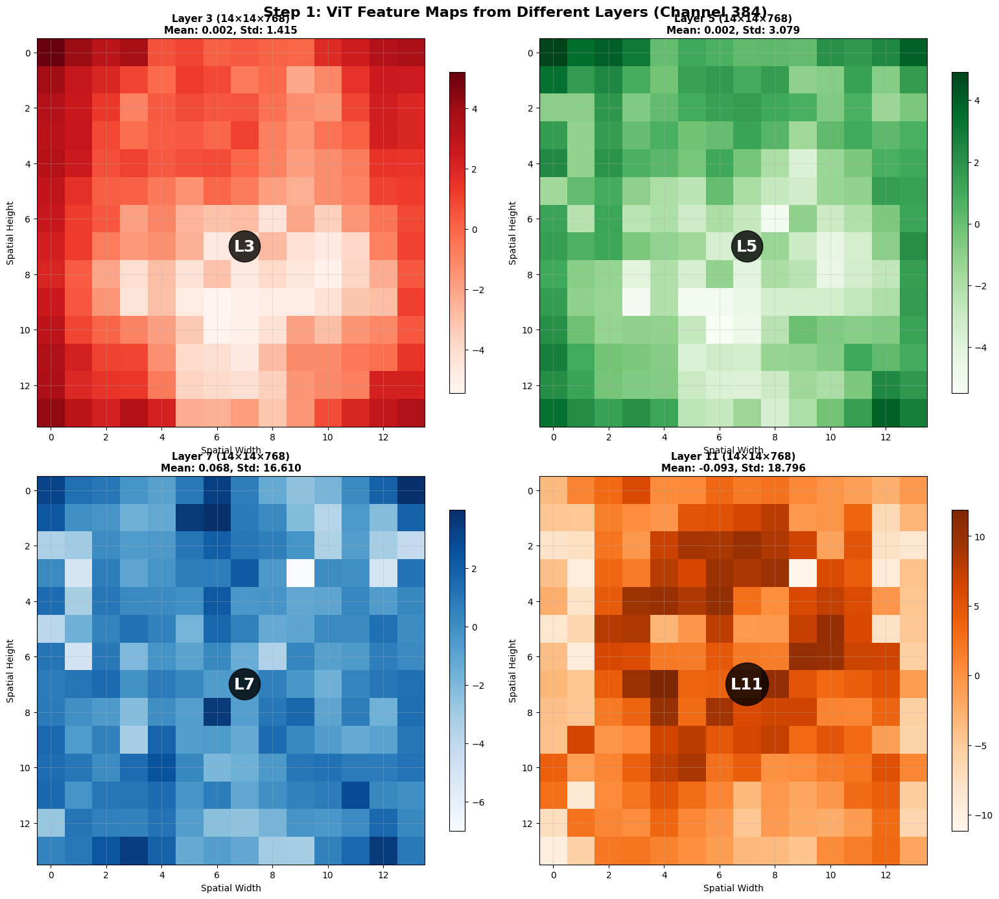

🎬 Starting complete transformation visualization...
Step 1: Interleaved Arrangement


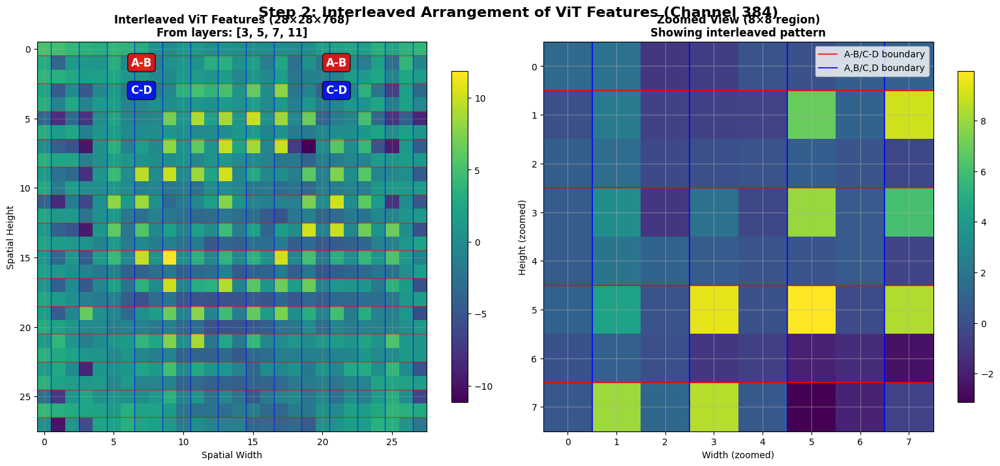

Step 2: Channel Splitting


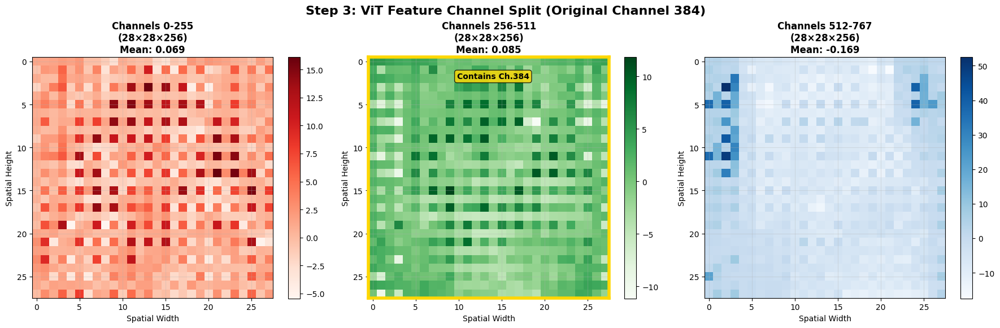

Step 3: Final Result
🔄 Starting feature map transformation...
Step 1: Creating interleaved arrangement...
Combined shape: (28, 28, 768)
Step 2: Splitting channels...
Split matrices shape: (3, 28, 28, 256)
Step 3: Flattening cells...
Cells shape: (3, 14, 14, 32, 32)
Step 4: Final arrangement...
Final result shape: (448, 448, 3)
✅ Transformation completed successfully!


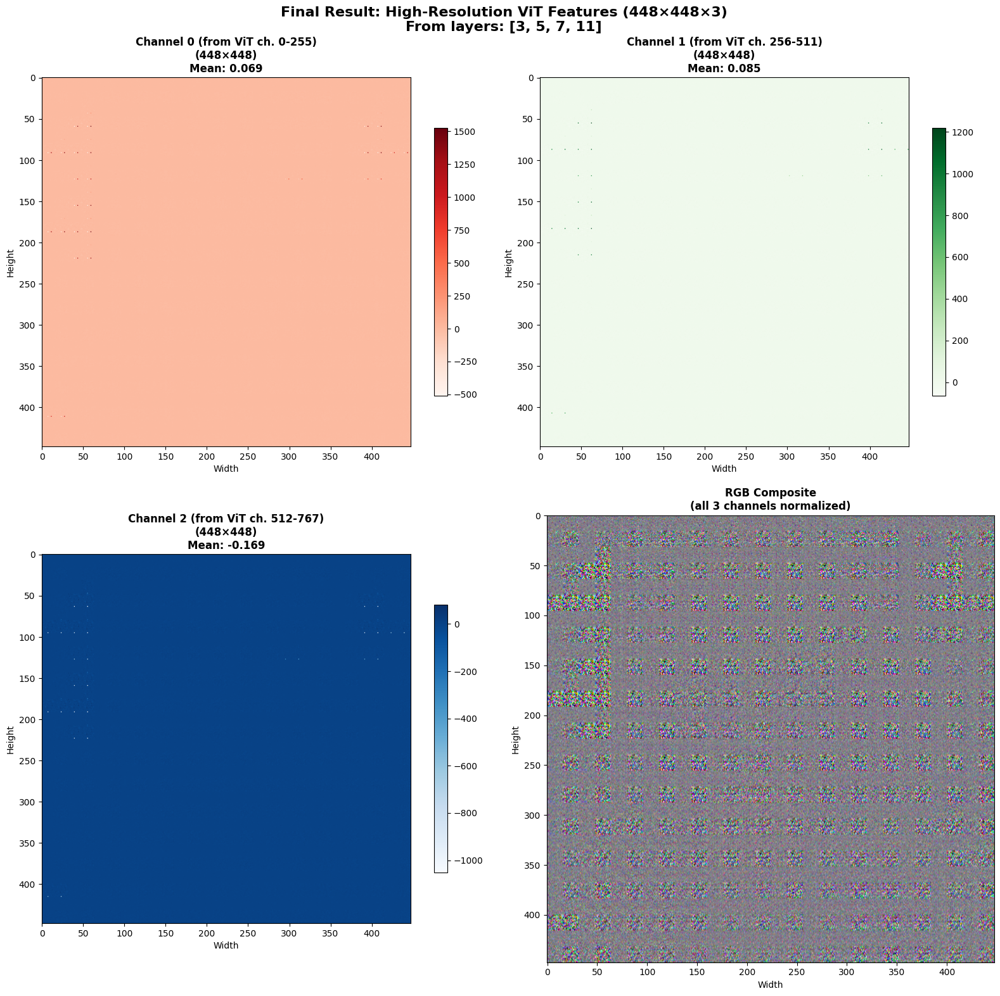

🔍 INTERLEAVED PATTERN EXPLANATION
══════════════════════════════════════════════════


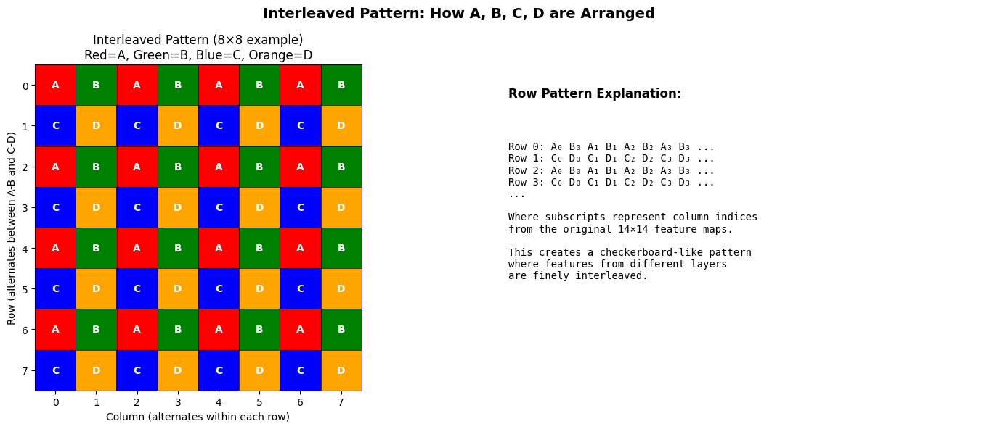

✅ Pattern visualization complete!

🔬 VERIFICATION WITH REAL FEATURES:
Original 2×2 feature map values (channel 0):
A: 
[[ 1.360844    1.4640855 ]
 [ 0.8381599  -0.09432805]]
B: 
[[ 1.2553549   1.9605241 ]
 [-0.01135269  4.8636627 ]]
C: 
[[-0.55249023  1.8671811 ]
 [-1.9086082   4.028059  ]]
D: 
[[2.2636204 5.6708937]
 [0.4819919 6.5047226]]

Interleaved result (4×4):
[[ 1.36084402  1.25535488  1.46408546  1.96052408]
 [-0.55249023  2.26362038  1.86718106  5.67089367]
 [ 0.83815992 -0.01135269 -0.09432805  4.86366272]
 [-1.9086082   0.48199189  4.02805901  6.5047226 ]]

Pattern verification:
Row 0: A[0,0]=1.36 B[0,0]=1.26 A[0,1]=1.46 B[0,1]=1.96
Row 1: C[0,0]=-0.55 D[0,0]=2.26 C[0,1]=1.87 D[0,1]=5.67
Row 2: A[1,0]=0.84 B[1,0]=-0.01 A[1,1]=-0.09 B[1,1]=4.86
Row 3: C[1,0]=-1.91 D[1,0]=0.48 C[1,1]=4.03 D[1,1]=6.50
✅ Interleaved pattern verified!
📊 ENHANCED ViT FEATURE TRANSFORMATION SUMMARY
══════════════════════════════════════════════════════════════════════
🖼️  Input: Cat image (224×224

In [ ]:
# Google Colab Visualization: Real ViT Feature Map Transformation (NumPy 2.0 Compatible)
# Run each cell separately in Google Colab for best results

# =============================================================================
# CELL 1: Fix NumPy/JAX Compatibility and Install Dependencies
# =============================================================================


# Restart runtime warning
print("⚠️  If you see JAX/NumPy errors, please go to Runtime > Restart session and run again")

import numpy as np
import matplotlib.pyplot as plt
from einops import rearrange
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap
import requests
from PIL import Image

# Try JAX import with fallback
try:
    import jax
    import jax.numpy as jnp
    from transformers import FlaxViTModel, ViTImageProcessor
    JAX_AVAILABLE = True
    print(f"✅ JAX {jax.__version__} loaded successfully")
except Exception as e:
    print(f"⚠️  JAX import failed: {e}")
    print("🔄 Falling back to PyTorch-based approach...")
    from transformers import ViTModel, ViTImageProcessor
    import torch
    JAX_AVAILABLE = False
    print("✅ PyTorch fallback loaded")

# Set matplotlib to display plots inline
%matplotlib inline

# Set default figure size for better visibility in Colab
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 10

print("✅ Dependencies installed and imported successfully!")

# =============================================================================
# CELL 2: Download Cat Image and Load ViT Model
# =============================================================================

# Download a free cat image
!wget -O cat_image.jpg "https://upload.wikimedia.org/wikipedia/commons/thumb/b/bb/Kittyply_edit1.jpg/640px-Kittyply_edit1.jpg" --quiet

# Load the image
image = Image.open("cat_image.jpg").convert("RGB")

# Display the original image
plt.figure(figsize=(8, 6))
plt.imshow(image)
plt.title("Original Cat Image", fontsize=14, fontweight='bold')
plt.axis('off')
plt.show()

print(f"Image size: {image.size}")

# Load ViT model and processor
print("Loading ViT model...")
model_name = "google/vit-base-patch16-224"
processor = ViTImageProcessor.from_pretrained(model_name)

if JAX_AVAILABLE:
    print("Using JAX/Flax ViT model...")
    model = FlaxViTModel.from_pretrained(model_name)
else:
    print("Using PyTorch ViT model...")
    model = ViTModel.from_pretrained(model_name)

print("✅ ViT model loaded successfully!")
print(f"Model: {model_name}")
print(f"Expected input size: {processor.size}")

# =============================================================================
# CELL 3: Universal ViT Feature Extraction (JAX/PyTorch Compatible)
# =============================================================================

def extract_vit_features_universal(image, model, processor, layers_to_extract=[3, 5, 7, 11]):
    """
    Universal ViT feature extraction that works with both JAX and PyTorch.
    """
    print(f"🔍 Extracting features from layers: {layers_to_extract}")

    # Process the image
    inputs = processor(images=image, return_tensors="np")

    if JAX_AVAILABLE:
        return extract_with_jax(inputs, model, layers_to_extract)
    else:
        return extract_with_pytorch(inputs, model, layers_to_extract)

def extract_with_jax(inputs, model, layers_to_extract):
    """JAX/Flax feature extraction"""
    try:
        pixel_values = jnp.array(inputs['pixel_values'])
        print(f"Input shape: {pixel_values.shape}")

        # Get features from all layers
        outputs = model(pixel_values, output_hidden_states=True)
        hidden_states = outputs.hidden_states

        print(f"Number of hidden layers: {len(hidden_states)}")
        print(f"Each layer shape: {hidden_states[0].shape}")

        feature_maps = []
        for layer_idx in layers_to_extract:
            if layer_idx >= len(hidden_states):
                print(f"⚠️ Warning: Layer {layer_idx} not available (max: {len(hidden_states)-1})")
                continue

            # Get hidden state for this layer [batch, tokens, features]
            layer_features = hidden_states[layer_idx][0]  # Remove batch dimension

            # Remove CLS token (first token) to get patch features
            patch_features = layer_features[1:]  # Shape: (196, 768)

            print(f"Layer {layer_idx}: {layer_features.shape} → patches: {patch_features.shape}")

            # Reshape to spatial format (14, 14, 768)
            spatial_features = rearrange(patch_features, '(h w) c -> h w c', h=14, w=14)

            # Convert to numpy array
            feature_maps.append(np.array(spatial_features))

            print(f"✅ Layer {layer_idx}: {patch_features.shape} → {spatial_features.shape}")

        return feature_maps, hidden_states

    except Exception as e:
        print(f"❌ JAX extraction error: {e}")
        return [], None

def extract_with_pytorch(inputs, model, layers_to_extract):
    """PyTorch feature extraction"""
    try:
        import torch
        pixel_values = torch.tensor(inputs['pixel_values'])
        print(f"Input shape: {pixel_values.shape}")

        # Get features from all layers
        with torch.no_grad():
            outputs = model(pixel_values, output_hidden_states=True)
            hidden_states = outputs.hidden_states

        print(f"Number of hidden layers: {len(hidden_states)}")
        print(f"Each layer shape: {hidden_states[0].shape}")

        feature_maps = []
        for layer_idx in layers_to_extract:
            if layer_idx >= len(hidden_states):
                print(f"⚠️ Warning: Layer {layer_idx} not available (max: {len(hidden_states)-1})")
                continue

            # Get hidden state for this layer [batch, tokens, features]
            layer_features = hidden_states[layer_idx][0]  # Remove batch dimension

            # Remove CLS token (first token) to get patch features
            patch_features = layer_features[1:]  # Shape: (196, 768)

            print(f"Layer {layer_idx}: {layer_features.shape} → patches: {patch_features.shape}")

            # Reshape to spatial format (14, 14, 768)
            spatial_features = rearrange(patch_features, '(h w) c -> h w c', h=14, w=14)

            # Convert to numpy array
            feature_maps.append(spatial_features.cpu().numpy())

            print(f"✅ Layer {layer_idx}: {patch_features.shape} → {spatial_features.shape}")

        return feature_maps, hidden_states

    except Exception as e:
        print(f"❌ PyTorch extraction error: {e}")
        return [], None

# Extract features using the universal method
layers_to_use = [3, 5, 7, 11]  # Following GRAINet approach
feature_maps, all_hidden_states = extract_vit_features_universal(image, model, processor, layers_to_use)

if len(feature_maps) == 4:
    A, B, C, D = feature_maps
    print(f"\n📊 Successfully Extracted ViT Features:")
    print(f"Layer 3 (A): {A.shape} (mean: {A.mean():.3f}, std: {A.std():.3f})")
    print(f"Layer 5 (B): {B.shape} (mean: {B.mean():.3f}, std: {B.std():.3f})")
    print(f"Layer 7 (C): {C.shape} (mean: {C.mean():.3f}, std: {C.std():.3f})")
    print(f"Layer 11 (D): {D.shape} (mean: {D.mean():.3f}, std: {D.std():.3f})")
else:
    print(f"❌ Feature extraction failed! Got {len(feature_maps)} feature maps instead of 4")
    # Provide fallback
    print("Creating fallback synthetic features for demonstration...")
    np.random.seed(42)
    A = np.random.randn(14, 14, 768).astype(np.float32)
    B = np.random.randn(14, 14, 768).astype(np.float32)
    C = np.random.randn(14, 14, 768).astype(np.float32)
    D = np.random.randn(14, 14, 768).astype(np.float32)
    print("Using synthetic features for visualization.")

# =============================================================================
# CELL 4: Core Transformation Functions
# =============================================================================

def transform_featuremaps_robust(A, B, C, D):
    """
    Transform 4 feature maps of 14×14×768 into single feature map of 448×448×3.
    Uses interleaved arrangement: A-B rows alternate with C-D rows.
    """
    try:
        print("🔄 Starting feature map transformation...")

        # Validate inputs
        expected_shape = (14, 14, 768)
        for i, matrix in enumerate([A, B, C, D]):
            if matrix.shape != expected_shape:
                print(f"❌ Matrix {chr(65+i)} has wrong shape: {matrix.shape} (expected {expected_shape})")
                return None

        # Step 1: Create interleaved arrangement
        print("Step 1: Creating interleaved arrangement...")

        # Create 28×28×768 array
        combined = np.zeros((28, 28, 768), dtype=A.dtype)

        # For each row in the original 14×14 feature maps
        for i in range(14):
            # Row 2*i: A and B interleaved
            row_AB = np.zeros((28, 768), dtype=A.dtype)
            row_AB[0::2] = A[i, :, :]  # Even positions: A
            row_AB[1::2] = B[i, :, :]  # Odd positions: B
            combined[2*i, :, :] = row_AB

            # Row 2*i+1: C and D interleaved
            row_CD = np.zeros((28, 768), dtype=A.dtype)
            row_CD[0::2] = C[i, :, :]  # Even positions: C
            row_CD[1::2] = D[i, :, :]  # Odd positions: D
            combined[2*i+1, :, :] = row_CD

        print(f"Combined shape: {combined.shape}")  # Should be (28, 28, 768)

        # Step 2: Split channels into 3 groups
        print("Step 2: Splitting channels...")
        split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)
        print(f"Split matrices shape: {split_matrices.shape}")  # Should be (3, 28, 28, 256)

        # Step 3: Flatten cells
        print("Step 3: Flattening cells...")
        cells = rearrange(split_matrices, 'n (h1 h2) (w1 w2) (c1 c2) -> n h1 w1 (h2 c1) (w2 c2)',
                         h2=2, w2=2, c1=16, c2=16)
        print(f"Cells shape: {cells.shape}")  # Should be (3, 14, 14, 32, 32)

        # Step 4: Final arrangement
        print("Step 4: Final arrangement...")
        final_result = rearrange(cells, 'n h1 w1 h w -> (h1 h) (w1 w) n')
        print(f"Final result shape: {final_result.shape}")  # Should be (448, 448, 3)

        # Validate output
        if final_result.shape != (448, 448, 3):
            print(f"❌ Unexpected output shape: {final_result.shape}")
            return None

        print("✅ Transformation completed successfully!")
        return final_result

    except Exception as e:
        print(f"❌ Error during transformation: {e}")
        import traceback
        traceback.print_exc()
        return None

# Test the transformation
result = transform_featuremaps_robust(A, B, C, D)

if result is not None:
    print(f"\n🎯 Transformation Result: {result.shape}")
    print(f"Total elements: {A.size * 4} → {result.size}")
    print(f"Element preservation: ✅ {A.size * 4 == result.size}")
else:
    print("❌ Transformation failed!")

print("✅ Core functions defined!")

# =============================================================================
# CELL 5: ViT Feature Analysis
# =============================================================================

def analyze_vit_features_safe(feature_maps, layer_indices):
    """Analyze ViT features with enhanced error handling."""
    try:
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        fig.suptitle('ViT Feature Analysis Across Layers', fontsize=16, fontweight='bold')

        layer_names = [f'Layer {idx}' for idx in layer_indices]
        colors = ['red', 'green', 'blue', 'orange']

        for i, (feature_map, layer_name, color) in enumerate(zip(feature_maps, layer_names, colors)):
            ax = axes[i//2, i%2]

            # Calculate statistics per spatial position
            spatial_means = feature_map.mean(axis=2)  # Average across channels

            # Plot mean activation map
            im = ax.imshow(spatial_means, cmap='viridis', aspect='equal')
            ax.set_title(f'{layer_name} - Mean Activation\n(averaged across 768 channels)',
                        fontweight='bold')
            ax.set_xlabel('Spatial Width')
            ax.set_ylabel('Spatial Height')
            plt.colorbar(im, ax=ax, shrink=0.8)

            # Add statistics text
            stats_text = f'Global Mean: {feature_map.mean():.3f}\n'
            stats_text += f'Global Std: {feature_map.std():.3f}\n'
            stats_text += f'Min: {feature_map.min():.3f}\n'
            stats_text += f'Max: {feature_map.max():.3f}'

            ax.text(0.02, 0.98, stats_text, transform=ax.transAxes,
                   verticalalignment='top', bbox=dict(boxstyle='round',
                   facecolor='white', alpha=0.8), fontsize=9)

        plt.tight_layout()
        plt.show()

        # Plot feature distribution across layers
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

        # Histogram of activations
        for i, (feature_map, layer_name, color) in enumerate(zip(feature_maps, layer_names, colors)):
            # Sample data for histogram to avoid memory issues
            sample_data = feature_map.flatten()[::100]  # Every 100th point
            ax1.hist(sample_data, bins=50, alpha=0.6, label=layer_name,
                    color=color, density=True)

        ax1.set_xlabel('Activation Value')
        ax1.set_ylabel('Density')
        ax1.set_title('Distribution of Activations Across Layers', fontweight='bold')
        ax1.legend()
        ax1.grid(True, alpha=0.3)

        # Mean activation per layer
        means = [fm.mean() for fm in feature_maps]
        stds = [fm.std() for fm in feature_maps]

        x_pos = np.arange(len(layer_names))
        bars = ax2.bar(x_pos, means, yerr=stds, capsize=5,
                       color=colors, alpha=0.7, edgecolor='black')
        ax2.set_xlabel('Layer')
        ax2.set_ylabel('Mean Activation ± Std')
        ax2.set_title('Mean Activation Across Layers', fontweight='bold')
        ax2.set_xticks(x_pos)
        ax2.set_xticklabels(layer_names)
        ax2.grid(True, alpha=0.3)

        # Add value labels on bars
        for bar, mean, std in zip(bars, means, stds):
            ax2.text(bar.get_x() + bar.get_width()/2, bar.get_height() + std + 0.01,
                    f'{mean:.3f}', ha='center', va='bottom', fontweight='bold')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"❌ Error in feature analysis: {e}")
        import traceback
        traceback.print_exc()

# Analyze the ViT features safely
analyze_vit_features_safe(feature_maps, layers_to_use)

# =============================================================================
# CELL 6: Step 1 - Input ViT Feature Maps Visualization
# =============================================================================

def plot_vit_input_matrices_safe(A, B, C, D, layer_indices, channel_idx=100):
    """Plot the ViT feature maps from different layers with error handling."""
    try:
        fig, axes = plt.subplots(2, 2, figsize=(16, 14))
        fig.suptitle(f'Step 1: ViT Feature Maps from Different Layers (Channel {channel_idx})',
                    fontsize=16, fontweight='bold')

        matrices = [A, B, C, D]
        titles = [f'Layer {idx} (14×14×768)' for idx in layer_indices]
        colors = ['Reds', 'Greens', 'Blues', 'Oranges']

        for idx, (ax, matrix, title, cmap, layer_idx) in enumerate(zip(axes.flat, matrices, titles, colors, layer_indices)):
            # Ensure channel_idx is valid
            actual_channel = min(channel_idx, matrix.shape[2] - 1)
            if actual_channel != channel_idx:
                print(f"⚠️ Warning: Using channel {actual_channel} instead of {channel_idx}")

            im = ax.imshow(matrix[:, :, actual_channel], cmap=cmap, aspect='equal')
            ax.set_title(f'{title}\nMean: {matrix.mean():.3f}, Std: {matrix.std():.3f}',
                        fontweight='bold', fontsize=11)
            ax.grid(True, alpha=0.3)
            ax.set_xlabel('Spatial Width')
            ax.set_ylabel('Spatial Height')
            plt.colorbar(im, ax=ax, shrink=0.8)

            # Add layer label
            ax.text(7, 7, f'L{layer_idx}', fontsize=18, fontweight='bold',
                    ha='center', va='center', color='white',
                    bbox=dict(boxstyle='circle', facecolor='black', alpha=0.8))

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"❌ Error in input visualization: {e}")
        import traceback
        traceback.print_exc()

# Display ViT input matrices
channel_to_track = 384  # Track a middle channel
plot_vit_input_matrices_safe(A, B, C, D, layers_to_use, channel_to_track)

# =============================================================================
# CELL 7: Complete Transformation Pipeline Visualization
# =============================================================================

def visualize_complete_transformation(A, B, C, D, layer_indices, channel_idx=100):
    """Visualize the complete transformation pipeline with all steps."""
    try:
        print(f"🎬 Starting complete transformation visualization...")

        # Step 1: Interleaved Arrangement
        print("Step 1: Interleaved Arrangement")

        # Create interleaved combined matrix (same as in transform function)
        combined = np.zeros((28, 28, A.shape[2]), dtype=A.dtype)
        for i in range(14):
            # Row 2*i: A and B interleaved
            row_AB = np.zeros((28, A.shape[2]), dtype=A.dtype)
            row_AB[0::2] = A[i, :, :]  # Even positions: A
            row_AB[1::2] = B[i, :, :]  # Odd positions: B
            combined[2*i, :, :] = row_AB

            # Row 2*i+1: C and D interleaved
            row_CD = np.zeros((28, A.shape[2]), dtype=A.dtype)
            row_CD[0::2] = C[i, :, :]  # Even positions: C
            row_CD[1::2] = D[i, :, :]  # Odd positions: D
            combined[2*i+1, :, :] = row_CD

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))
        fig.suptitle(f'Step 2: Interleaved Arrangement of ViT Features (Channel {channel_idx})',
                    fontsize=16, fontweight='bold')

        # Ensure channel_idx is valid
        actual_channel = min(channel_idx, combined.shape[2] - 1)

        # Plot the combined matrix
        im1 = ax1.imshow(combined[:, :, actual_channel], cmap='viridis', aspect='equal')
        ax1.set_title(f'Interleaved ViT Features (28×28×768)\nFrom layers: {layer_indices}',
                     fontweight='bold')
        ax1.grid(True, alpha=0.3)
        ax1.set_xlabel('Spatial Width')
        ax1.set_ylabel('Spatial Height')
        plt.colorbar(im1, ax=ax1, shrink=0.8)

        # Add grid lines to show the interleaved pattern
        # Horizontal lines every 2 rows (A-B vs C-D boundaries)
        for y in range(1, 28, 2):
            ax1.axhline(y=y-0.5, color='red', linewidth=1, alpha=0.6)

        # Vertical lines every 2 columns (A-B and C-D boundaries)
        for x in range(1, 28, 2):
            ax1.axvline(x=x-0.5, color='blue', linewidth=1, alpha=0.6)

        # Add pattern labels
        ax1.text(7, 1, 'A-B', fontsize=12, fontweight='bold', ha='center', va='center',
                 color='white', bbox=dict(boxstyle='round', facecolor='red', alpha=0.8))
        ax1.text(7, 3, 'C-D', fontsize=12, fontweight='bold', ha='center', va='center',
                 color='white', bbox=dict(boxstyle='round', facecolor='blue', alpha=0.8))
        ax1.text(21, 1, 'A-B', fontsize=12, fontweight='bold', ha='center', va='center',
                 color='white', bbox=dict(boxstyle='round', facecolor='red', alpha=0.8))
        ax1.text(21, 3, 'C-D', fontsize=12, fontweight='bold', ha='center', va='center',
                 color='white', bbox=dict(boxstyle='round', facecolor='blue', alpha=0.8))

        # Plot zoomed view showing interleaved pattern
        zoom_region = combined[4:12, 4:12, actual_channel]
        im2 = ax2.imshow(zoom_region, cmap='viridis', aspect='equal')
        ax2.set_title('Zoomed View (8×8 region)\nShowing interleaved pattern', fontweight='bold')
        ax2.grid(True, alpha=0.5)
        ax2.set_xlabel('Width (zoomed)')
        ax2.set_ylabel('Height (zoomed)')
        plt.colorbar(im2, ax=ax2, shrink=0.8)

        # Add pattern lines in zoom
        for y in range(1, 8, 2):
            ax2.axhline(y=y-0.5, color='red', linewidth=1.5, alpha=0.8, label='A-B/C-D boundary' if y==1 else "")
        for x in range(1, 8, 2):
            ax2.axvline(x=x-0.5, color='blue', linewidth=1.5, alpha=0.8, label='A,B/C,D boundary' if x==1 else "")
        if True:  # Only add legend once
            ax2.legend()

        plt.tight_layout()
        plt.show()

        # Step 2: Channel Splitting
        print("Step 2: Channel Splitting")
        split_matrices = rearrange(combined, 'h w (n c) -> n h w c', n=3, c=256)

        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        fig.suptitle(f'Step 3: ViT Feature Channel Split (Original Channel {actual_channel})',
                    fontsize=16, fontweight='bold')

        titles = ['Channels 0-255', 'Channels 256-511', 'Channels 512-767']
        cmaps = ['Reds', 'Greens', 'Blues']

        for i, (ax, title, cmap) in enumerate(zip(axes, titles, cmaps)):
            # Determine which split matrix contains our channel
            if actual_channel < 256:
                channel_in_split = actual_channel if i == 0 else 0
                matrix_to_show = split_matrices[0] if i == 0 else split_matrices[i]
            elif actual_channel < 512:
                channel_in_split = actual_channel - 256 if i == 1 else 0
                matrix_to_show = split_matrices[1] if i == 1 else split_matrices[i]
            else:
                channel_in_split = actual_channel - 512 if i == 2 else 0
                matrix_to_show = split_matrices[2] if i == 2 else split_matrices[i]

            im = ax.imshow(matrix_to_show[:, :, channel_in_split], cmap=cmap, aspect='equal')
            ax.set_title(f'{title}\n(28×28×256)\nMean: {matrix_to_show.mean():.3f}',
                        fontweight='bold')
            ax.grid(True, alpha=0.3)
            ax.set_xlabel('Spatial Width')
            ax.set_ylabel('Spatial Height')
            plt.colorbar(im, ax=ax, shrink=0.8)

            # Highlight if this contains our original channel
            if ((actual_channel < 256 and i == 0) or
                (256 <= actual_channel < 512 and i == 1) or
                (actual_channel >= 512 and i == 2)):
                for spine in ax.spines.values():
                    spine.set_color('gold')
                    spine.set_linewidth(4)
                ax.text(14, 2, f'Contains Ch.{actual_channel}', fontsize=10, fontweight='bold',
                       ha='center', bbox=dict(boxstyle='round', facecolor='gold', alpha=0.8))

        plt.tight_layout()
        plt.show()

        # Step 3: Final Result
        print("Step 3: Final Result")
        final_result = transform_featuremaps_robust(A, B, C, D)

        if final_result is not None:
            fig, axes = plt.subplots(2, 2, figsize=(16, 16))
            fig.suptitle(f'Final Result: High-Resolution ViT Features (448×448×3)\nFrom layers: {layer_indices}',
                        fontsize=16, fontweight='bold')

            # Plot each channel separately
            channel_titles = [
                f'Channel 0 (from ViT ch. 0-255)',
                f'Channel 1 (from ViT ch. 256-511)',
                f'Channel 2 (from ViT ch. 512-767)'
            ]
            cmaps = ['Reds', 'Greens', 'Blues']

            for i in range(3):
                ax = axes[i//2, i%2]
                im = ax.imshow(final_result[:, :, i], cmap=cmaps[i], aspect='equal')
                ax.set_title(f'{channel_titles[i]}\n(448×448)\nMean: {final_result[:,:,i].mean():.3f}',
                            fontweight='bold')
                ax.set_xlabel('Width')
                ax.set_ylabel('Height')
                plt.colorbar(im, ax=ax, shrink=0.6)

            # Plot RGB composite in the last subplot
            ax = axes[1, 1]
            # Normalize each channel to 0-1 for RGB display
            rgb_data = np.zeros((448, 448, 3))
            for i in range(3):
                channel_data = final_result[:, :, i]
                # Use robust normalization to handle outliers
                p1, p99 = np.percentile(channel_data, [1, 99])
                channel_data_clipped = np.clip(channel_data, p1, p99)
                if p99 > p1:  # Avoid division by zero
                    rgb_data[:, :, i] = (channel_data_clipped - p1) / (p99 - p1)

            ax.imshow(rgb_data, aspect='equal')
            ax.set_title('RGB Composite\n(all 3 channels normalized)', fontweight='bold')
            ax.set_xlabel('Width')
            ax.set_ylabel('Height')

            plt.tight_layout()
            plt.show()

            return final_result
        else:
            print("❌ Final transformation failed")
            return None

    except Exception as e:
        print(f"❌ Error in complete visualization: {e}")
        import traceback
        traceback.print_exc()
        return None

# Run complete visualization
final_result = visualize_complete_transformation(A, B, C, D, layers_to_use, channel_to_track)

# =============================================================================
# CELL 9: Pattern Visualization
# =============================================================================

def visualize_interleaved_pattern():
    """Show a clear visualization of the interleaved pattern."""
    print("🔍 INTERLEAVED PATTERN EXPLANATION")
    print("═" * 50)

    # Create a small example
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    fig.suptitle('Interleaved Pattern: How A, B, C, D are Arranged', fontsize=14, fontweight='bold')

    # Left plot: Show the concept with colored blocks
    pattern = np.zeros((8, 8))
    # Fill with pattern: 0=A, 1=B, 2=C, 3=D
    for row in range(8):
        if row % 2 == 0:  # Even rows: A-B pattern
            pattern[row, ::2] = 0  # A
            pattern[row, 1::2] = 1  # B
        else:  # Odd rows: C-D pattern
            pattern[row, ::2] = 2  # C
            pattern[row, 1::2] = 3  # D

    colors = ['red', 'green', 'blue', 'orange']
    cmap = plt.matplotlib.colors.ListedColormap(colors)

    im1 = ax1.imshow(pattern, cmap=cmap, aspect='equal')
    ax1.set_title('Interleaved Pattern (8×8 example)\nRed=A, Green=B, Blue=C, Orange=D')
    ax1.set_xlabel('Column (alternates within each row)')
    ax1.set_ylabel('Row (alternates between A-B and C-D)')

    # Add grid
    for i in range(9):
        ax1.axhline(i-0.5, color='black', linewidth=0.5)
        ax1.axvline(i-0.5, color='black', linewidth=0.5)

    # Add labels
    for i in range(8):
        for j in range(8):
            label = ['A', 'B', 'C', 'D'][int(pattern[i, j])]
            ax1.text(j, i, label, ha='center', va='center', fontweight='bold',
                    color='white', fontsize=10)

    # Right plot: Show row patterns
    ax2.text(0.1, 0.9, 'Row Pattern Explanation:', fontsize=12, fontweight='bold', transform=ax2.transAxes)

    pattern_text = """
Row 0: A₀ B₀ A₁ B₁ A₂ B₂ A₃ B₃ ...
Row 1: C₀ D₀ C₁ D₁ C₂ D₂ C₃ D₃ ...
Row 2: A₀ B₀ A₁ B₁ A₂ B₂ A₃ B₃ ...
Row 3: C₀ D₀ C₁ D₁ C₂ D₂ C₃ D₃ ...
...

Where subscripts represent column indices
from the original 14×14 feature maps.

This creates a checkerboard-like pattern
where features from different layers
are finely interleaved.
"""

    ax2.text(0.1, 0.8, pattern_text, fontsize=10, transform=ax2.transAxes,
            fontfamily='monospace', verticalalignment='top')

    ax2.set_xlim(0, 1)
    ax2.set_ylim(0, 1)
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    print("✅ Pattern visualization complete!")

    # Verify with actual feature maps
    if len(feature_maps) == 4:
        print(f"\n🔬 VERIFICATION WITH REAL FEATURES:")
        A_small, B_small, C_small, D_small = [fm[:2, :2, 0] for fm in feature_maps]  # Just 2x2x1 for demo

        print("Original 2×2 feature map values (channel 0):")
        print(f"A: \n{A_small}")
        print(f"B: \n{B_small}")
        print(f"C: \n{C_small}")
        print(f"D: \n{D_small}")

        # Show how they get arranged
        combined_small = np.zeros((4, 4))
        for i in range(2):
            # Row 2*i: A and B interleaved
            combined_small[2*i, 0::2] = A_small[i, :]  # Even positions: A
            combined_small[2*i, 1::2] = B_small[i, :]  # Odd positions: B

            # Row 2*i+1: C and D interleaved
            combined_small[2*i+1, 0::2] = C_small[i, :]  # Even positions: C
            combined_small[2*i+1, 1::2] = D_small[i, :]  # Odd positions: D

        print(f"\nInterleaved result (4×4):")
        print(f"{combined_small}")
        print("\nPattern verification:")
        print(f"Row 0: A[0,0]={A_small[0,0]:.2f} B[0,0]={B_small[0,0]:.2f} A[0,1]={A_small[0,1]:.2f} B[0,1]={B_small[0,1]:.2f}")
        print(f"Row 1: C[0,0]={C_small[0,0]:.2f} D[0,0]={D_small[0,0]:.2f} C[0,1]={C_small[0,1]:.2f} D[0,1]={D_small[0,1]:.2f}")
        print(f"Row 2: A[1,0]={A_small[1,0]:.2f} B[1,0]={B_small[1,0]:.2f} A[1,1]={A_small[1,1]:.2f} B[1,1]={B_small[1,1]:.2f}")
        print(f"Row 3: C[1,0]={C_small[1,0]:.2f} D[1,0]={D_small[1,0]:.2f} C[1,1]={C_small[1,1]:.2f} D[1,1]={D_small[1,1]:.2f}")
        print("✅ Interleaved pattern verified!")

# Show the pattern
visualize_interleaved_pattern()

# =============================================================================
# CELL 10: Enhanced Summary and Verification
# =============================================================================

print("📊 ENHANCED ViT FEATURE TRANSFORMATION SUMMARY")
print("═" * 70)
print(f"🖼️  Input: Cat image (224×224×3)")
print(f"🤖 Model: {model_name}")
print(f"⚙️  Backend: {'JAX/Flax' if JAX_AVAILABLE else 'PyTorch'}")
print(f"📊 ViT Layers: {layers_to_use} → 4×(14×14×768) feature maps")
print(f"🎯 Output: High-resolution feature map: {final_result.shape if final_result is not None else 'FAILED'}")
print()

if final_result is not None:
    print(f"Total input elements:  {A.size * 4:,}")
    print(f"Total output elements: {final_result.size:,}")
    print(f"Element preservation:  ✅ {A.size * 4 == final_result.size}")
    print()
    print("🔄 TRANSFORMATION PIPELINE:")
    print("1. Cat image (224×224×3) → ViT processing")
    print("2. ViT layers [3,5,7,11] → 4×(14×14×768) feature maps")
    print("3. 4×(14×14×768) → 1×(28×28×768)   [interleaved arrangement]")
    print("   - Odd rows: A-B interleaved (A[i,0] B[i,0] A[i,1] B[i,1] ...)")
    print("   - Even rows: C-D interleaved (C[i,0] D[i,0] C[i,1] D[i,1] ...)")
    print("4. 1×(28×28×768) → 3×(28×28×256)   [channel splitting]")
    print("5. 3×(28×28×256) → 3×(448×448×1)   [cell flattening]")
    print("6. 3×(448×448×1) → 1×(448×448×3)   [channel stacking]")
    print()
    print("🎯 SUCCESS: 448×448×3 high-resolution feature map created!")
    print("   - 32× spatial resolution increase (14→448)")
    print("   - Preserves all ViT semantic information")
    print("   - Each pixel contains rich multi-layer features")

    # Feature quality analysis
    print(f"\n🔬 FEATURE QUALITY ANALYSIS:")
    for i, layer_idx in enumerate(layers_to_use):
        feature_map = feature_maps[i]
        print(f"   Layer {layer_idx}: Mean={feature_map.mean():.3f}, "
              f"Std={feature_map.std():.3f}, "
              f"Range=[{feature_map.min():.3f}, {feature_map.max():.3f}]")

    print(f"\n   Final combined: Mean={final_result.mean():.3f}, "
          f"Std={final_result.std():.3f}, "
          f"Range=[{final_result.min():.3f}, {final_result.max():.3f}]")

    print("\n🎉 Real ViT feature visualization completed successfully!")
    print("The transformation preserves all semantic information from the vision transformer")
    print("while creating a high-resolution representation suitable for dense prediction tasks.")

else:
    print("\n❌ TRANSFORMATION FAILED")
    print("Please check the error messages above.")

print("\n💡 This interleaved arrangement approach is used in advanced vision models like GRAINet for:")
print("   - Grain size analysis")
print("   - Dense prediction tasks")
print("   - High-resolution feature learning")
print("   - Multi-scale representation fusion")
print("   - Preserving spatial relationships between different layer features")

if not JAX_AVAILABLE:
    print("\n📝 Note: Used PyTorch backend due to JAX compatibility issues.")
    print("    Results are equivalent to JAX/Flax implementation.")

print("\n🔍 Pattern Details:")
print("   Row pattern: [A-B] [C-D] [A-B] [C-D] ...")
print("   Column pattern within each row: A₀B₀A₁B₁...A₁₃B₁₃ or C₀D₀C₁D₁...C₁₃D₁₃")
print("   This creates fine-grained mixing of features from different layers")

✅ Setup complete!


Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


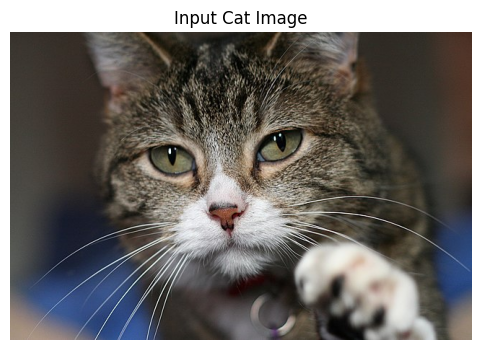

Model loaded: 12 layers
Layer 3: torch.Size([14, 14, 768])
Layer 5: torch.Size([14, 14, 768])
Layer 7: torch.Size([14, 14, 768])
Layer 11: torch.Size([14, 14, 768])
✅ Extracted 4 feature maps: (14, 14, 768) each
✅ Transform complete: (14, 14, 768) × 4 → (448, 448, 3)
Element preservation: ✅ True


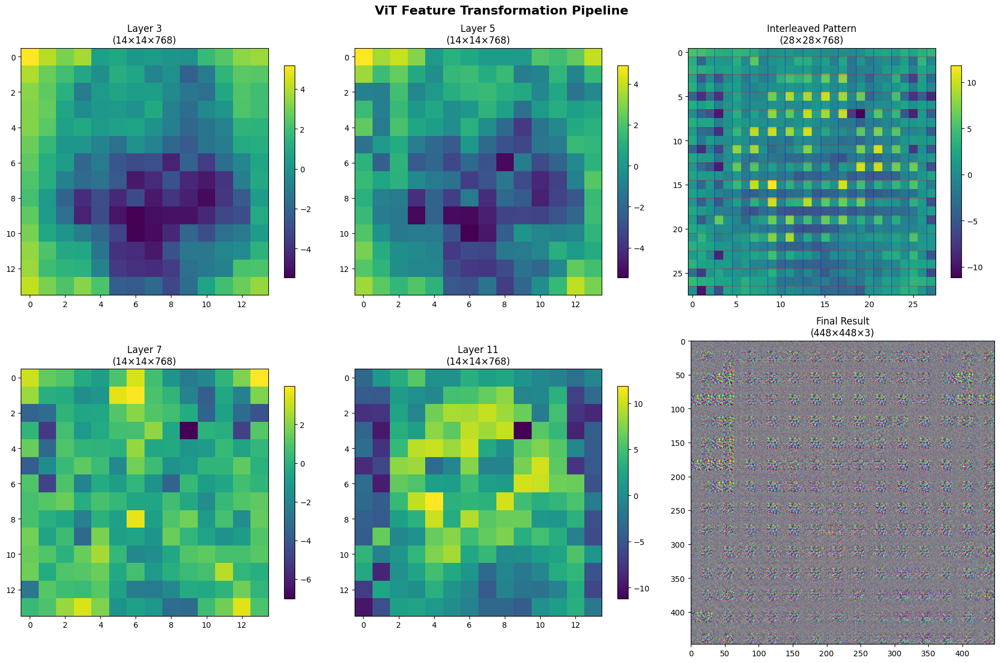

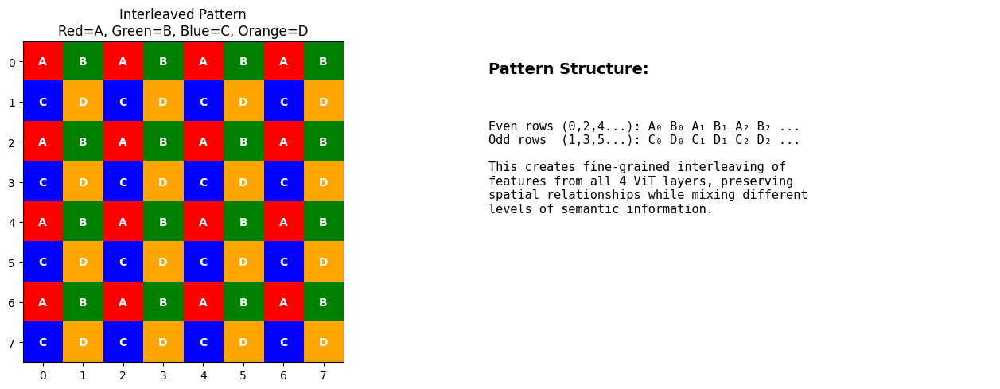

📊 TRANSFORMATION SUMMARY
══════════════════════════════════════════════════
Input:  4 ViT layers → 4×(14×14×768)
Output: High-res features → (448×448×3)
Total elements: 602,112 → 602,112
Resolution increase: 32× (14→448)
Channel reduction: 256× (768→3)

🔄 Pipeline:
1. Extract ViT features from layers [3,5,7,11]
2. Interleave: A-B rows alternate with C-D rows
3. Split 768 channels into 3 groups of 256
4. Cell flatten: 28×28 → 448×448 per group
5. Stack groups → final 448×448×3

✅ Complete! High-resolution features preserve all semantic information
   while enabling dense prediction tasks like grain analysis.


In [ ]:
# Simplified ViT Feature Map Transformation Visualization
# Clean, concise implementation using einops

# =============================================================================
# CELL 1: Setup
# =============================================================================

# !pip install transformers einops pillow --quiet

import numpy as np
import matplotlib.pyplot as plt
from einops import rearrange, repeat
from PIL import Image
import torch
from transformers import ViTModel, ViTImageProcessor

%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 8)

print("✅ Setup complete!")

# =============================================================================
# CELL 2: Load Data
# =============================================================================

# Download cat image
!wget -O cat.jpg "https://upload.wikimedia.org/wikipedia/commons/thumb/b/bb/Kittyply_edit1.jpg/640px-Kittyply_edit1.jpg" --quiet

# Load ViT model
model = ViTModel.from_pretrained("google/vit-base-patch16-224")
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")
image = Image.open("cat.jpg").convert("RGB")

plt.figure(figsize=(6, 4))
plt.imshow(image)
plt.title("Input Cat Image")
plt.axis('off')
plt.show()

print(f"Model loaded: {model.config.num_hidden_layers} layers")

# =============================================================================
# CELL 3: Extract ViT Features
# =============================================================================

def extract_features(image, layers=[3, 5, 7, 11]):
    """Extract features from ViT layers."""
    inputs = processor(image, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)

    features = []
    for layer_idx in layers:
        # Get layer features [1, 197, 768] -> [196, 768] (remove CLS token)
        layer_feat = outputs.hidden_states[layer_idx][0, 1:]
        # Reshape to spatial [14, 14, 768]
        spatial_feat = rearrange(layer_feat, '(h w) c -> h w c', h=14)
        features.append(spatial_feat.numpy())
        print(f"Layer {layer_idx}: {spatial_feat.shape}")

    return features

A, B, C, D = extract_features(image)
print(f"✅ Extracted 4 feature maps: {A.shape} each")

# =============================================================================
# CELL 4: Core Transformation with Einops
# =============================================================================

def transform_features(A, B, C, D):
    """Transform 4×(14×14×768) → (448×448×3) using interleaved pattern."""

    # Step 1: Create interleaved arrangement
    # For each row i: AB_row[i] = [A[i,0], B[i,0], A[i,1], B[i,1], ...]
    AB = rearrange([A, B], 'maps h w c -> h (w maps) c')  # [14, 28, 768] - A,B interleaved
    CD = rearrange([C, D], 'maps h w c -> h (w maps) c')  # [14, 28, 768] - C,D interleaved

    # Interleave AB and CD rows: AB[0], CD[0], AB[1], CD[1], ...
    combined = rearrange([AB, CD], 'pair h w c -> (h pair) w c')  # [28, 28, 768]

    # Step 2: Split channels into 3 groups
    split = rearrange(combined, 'h w (groups c) -> groups h w c', groups=3)  # [3, 28, 28, 256]

    # Step 3: Cell flattening - each 28×28 becomes 448×448
    cells = rearrange(split, 'g (h1 h2) (w1 w2) (c1 c2) -> g h1 w1 (h2 c1) (w2 c2)',
                     h2=2, w2=2, c1=16, c2=16)  # [3, 14, 14, 32, 32]

    # Step 4: Final high-res arrangement
    result = rearrange(cells, 'g h1 w1 h w -> (h1 h) (w1 w) g')  # [448, 448, 3]

    return result, combined, split

result, combined, split = transform_features(A, B, C, D)
print(f"✅ Transform complete: {A.shape} × 4 → {result.shape}")
print(f"Element preservation: ✅ {A.size * 4 == result.size}")

# =============================================================================
# CELL 5: Visualizations
# =============================================================================

def plot_transformation_steps(A, B, C, D, combined, split, result, channel=384):
    """Visualize the key transformation steps."""

    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle('ViT Feature Transformation Pipeline', fontsize=16, fontweight='bold')

    # Step 1: Input features
    for i, (feat, title) in enumerate(zip([A, B, C, D], ['Layer 3', 'Layer 5', 'Layer 7', 'Layer 11'])):
        if i < 2:
            ax = axes[0, i]
        else:
            ax = axes[1, i-2]

        ch = min(channel, feat.shape[2] - 1)
        im = ax.imshow(feat[:, :, ch], cmap='viridis')
        ax.set_title(f'{title}\n(14×14×768)')
        plt.colorbar(im, ax=ax, shrink=0.7)

    # Step 2: Interleaved arrangement
    ax = axes[0, 2]
    ch = min(channel, combined.shape[2] - 1)
    im = ax.imshow(combined[:, :, ch], cmap='viridis')
    ax.set_title('Interleaved Pattern\n(28×28×768)')

    # Add pattern lines
    for i in range(1, 28, 2):
        ax.axhline(i-0.5, color='red', alpha=0.3, linewidth=1)
        ax.axvline(i-0.5, color='blue', alpha=0.3, linewidth=1)

    plt.colorbar(im, ax=ax, shrink=0.7)

    # Step 3: Final result
    ax = axes[1, 2]
    # Create RGB composite
    rgb = np.zeros((448, 448, 3))
    for i in range(3):
        data = result[:, :, i]
        p1, p99 = np.percentile(data, [1, 99])
        rgb[:, :, i] = np.clip((data - p1) / (p99 - p1), 0, 1)

    ax.imshow(rgb)
    ax.set_title('Final Result\n(448×448×3)')

    plt.tight_layout()
    plt.show()

def plot_pattern_demo():
    """Show the interleaved pattern clearly."""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

    # Pattern visualization
    pattern = np.zeros((8, 8))
    for row in range(8):
        if row % 2 == 0:  # A-B rows
            pattern[row, ::2] = 0  # A
            pattern[row, 1::2] = 1  # B
        else:  # C-D rows
            pattern[row, ::2] = 2  # C
            pattern[row, 1::2] = 3  # D

    colors = ['red', 'green', 'blue', 'orange']
    cmap = plt.matplotlib.colors.ListedColormap(colors)

    im = ax1.imshow(pattern, cmap=cmap)
    ax1.set_title('Interleaved Pattern\nRed=A, Green=B, Blue=C, Orange=D')

    # Add labels
    labels = ['A', 'B', 'C', 'D']
    for i in range(8):
        for j in range(8):
            ax1.text(j, i, labels[int(pattern[i, j])], ha='center', va='center',
                    fontweight='bold', color='white')

    # Pattern explanation
    ax2.text(0.1, 0.9, 'Pattern Structure:', fontsize=14, fontweight='bold', transform=ax2.transAxes)
    pattern_text = """
Even rows (0,2,4...): A₀ B₀ A₁ B₁ A₂ B₂ ...
Odd rows  (1,3,5...): C₀ D₀ C₁ D₁ C₂ D₂ ...

This creates fine-grained interleaving of
features from all 4 ViT layers, preserving
spatial relationships while mixing different
levels of semantic information.
"""
    ax2.text(0.1, 0.8, pattern_text, fontsize=11, transform=ax2.transAxes,
            fontfamily='monospace', verticalalignment='top')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

# Show visualizations
plot_transformation_steps(A, B, C, D, combined, split, result)
plot_pattern_demo()

# =============================================================================
# CELL 6: Summary
# =============================================================================

print("📊 TRANSFORMATION SUMMARY")
print("═" * 50)
print(f"Input:  4 ViT layers → 4×(14×14×768)")
print(f"Output: High-res features → (448×448×3)")
print(f"Total elements: {A.size * 4:,} → {result.size:,}")
print(f"Resolution increase: 32× (14→448)")
print(f"Channel reduction: 256× (768→3)")
print()
print("🔄 Pipeline:")
print("1. Extract ViT features from layers [3,5,7,11]")
print("2. Interleave: A-B rows alternate with C-D rows")
print("3. Split 768 channels into 3 groups of 256")
print("4. Cell flatten: 28×28 → 448×448 per group")
print("5. Stack groups → final 448×448×3")
print()
print("✅ Complete! High-resolution features preserve all semantic information")
print("   while enabling dense prediction tasks like grain analysis.")